# Analyse of equivalent width

- author : Sylvie Dagoret-Campagne
- affiliation : IJCLab/IN2P3/CNES, DESC-LSST fullmember, behalf AuxTel Teal VERA C. Rubin observatory
- 
- creation date : April 6th  2022
- last update : 


### Configuration Hb :

    


- **kernel anaconda3_auxtel** at CC or **python 3** locally

# Imports

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LogNorm
import pandas as pd

import matplotlib.ticker                         # here's where the formatter is
import os
import re
import pandas as pd

plt.rcParams["figure.figsize"] = (16,4)
plt.rcParams["axes.labelsize"] = 'xx-large'
plt.rcParams['axes.titlesize'] = 'xx-large'
plt.rcParams['xtick.labelsize']= 'xx-large'
plt.rcParams['ytick.labelsize']= 'xx-large'

In [2]:
import matplotlib.colors as colors
import matplotlib.cm as cmx
import matplotlib.gridspec as gridspec
from matplotlib.patches import Rectangle

from mpl_toolkits.axes_grid1.inset_locator import inset_axes

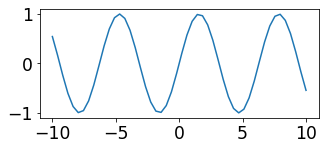

In [3]:
fig=plt.figure(figsize=(5,2))
ax=fig.add_subplot(1,1,1)
X=np.linspace(-10,10,50)
Y=np.sin(X)
ax.plot(X,Y)
plt.show()               

In [4]:
import matplotlib.offsetbox
props = dict(boxstyle='round',edgecolor="w",facecolor="w", alpha=0.5)

In [5]:
from datetime import datetime,date

In [6]:
#pip install fpdf
#from fpdf import FPDF

import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages

In [7]:
today = date.today()
string_date=today.strftime("%Y-%m-%d")

In [8]:
string_date

'2022-04-09'

In [9]:
from iminuit import Minuit
import iminuit

In [10]:
iminuit.__version__

'2.11.2'

In [11]:
from astropy.io import fits
from spectractor import parameters
from spectractor.extractor.extractor import Spectractor
from spectractor.extractor.spectrum import Spectrum, detect_lines
from spectractor.extractor.spectrum import *
#from spectractor.extractor.spectroscopy import Lines, Line ,HALPHA, HBETA, O2_1, H2O_1,H2O_2
from spectractor.extractor.spectroscopy import Lines, Line ,HALPHA, HBETA, HGAMMA, HDELTA,HEPSILON,O2_1,O2B  ,H2O_1, ATMOSPHERIC_LINES
from spectractor.config import load_config
from spectractor import parameters
from spectractor.extractor.images import *
from scipy import ndimage, misc
from scipy.interpolate import interp1d

In [12]:
H2O_2 = Line(960, atmospheric=True, label=r'$H_2 O$', label_pos=[0.007, 0.02],width_bounds=[5, 30])  # libradtran paper fig.3, broad line

In [13]:
import requests
from requests.adapters import HTTPAdapter
from requests.packages.urllib3.util.retry import Retry

In [14]:
from time import sleep

In [15]:
from astropy.time import Time
import astropy.units as u

# Function

In [16]:
def file_tag_forsorting(filename):
    # m=re.findall('^Cor_holo4_003_.*([0-9][0-9][0-9][0-9]-[0-9][0-9]-[0-9][0-9]_.*)[.]fits$',filename)
    m = re.findall('^exposure_.*([0-9][0-9][0-9][0-9][0-9])_postisrccd.*', filename)
    if len(m)>0:
        return m[0]
    else:
        return None


In [17]:
def subdir_tag_forsorting(subdir):
    # m=re.findall('^Cor_holo4_003_.*([0-9][0-9][0-9][0-9]-[0-9][0-9]-[0-9][0-9]_.*)[.]fits$',filename)
    m = re.findall('.*([0-9][0-9][0-9][0-9][0-9])$', subdir)
    if len(m)>0:
        return m[0]
    else:
        return None


In [18]:
file_tag_forsorting('exposure_2022031600330_postisrccd.fits')

'00330'

In [19]:
subdir_tag_forsorting('2022031600330')

'00330'

# Config

In [20]:
# path index for each month
DATE="20220317"

In [21]:
version="v5.0"

In [22]:
# Choose the config filename

list_of_spectractorconfigfiles= ["auxtel_configA.ini","auxtel_configB.ini","auxtel_configC.ini","auxtel_configD.ini","auxtel_configE.ini","auxtel_configF.ini","auxtel_configG.ini","auxtel_configHb.ini"]
config_idx =7
configfilename= os.path.join("./config",list_of_spectractorconfigfiles[config_idx])
configdir = (list_of_spectractorconfigfiles[config_idx].split("_")[-1]).split(".") [0]


In [23]:
configdir 

'configHb'

# Path

In [24]:
HOSTCC=False

In [25]:
# Set path depending on which computer running (according HOSTCC)
if HOSTCC:
    path_auxtel="/sps/lsst/groups/auxtel"
    path_spectractor=os.path.join(path_auxtel,"softs/github/desc/Spectractor")
    path_spectractor_config=os.path.join(path_spectractor,"config")
    path_images=os.path.join(path_auxtel,"data/2022/holo/"+DATE)
    path_output_spectractor=os.path.join(path_auxtel,"data/2022/OutputSpectractor/holo/"+configdir+"/"+DATE)
    
else:
    #path_auxtel="/Users/dagoret/DATA/AuxTelData2021"
    path_auxtel="/Users/sylvie/DATA/AuxTelDATA2022"
    #path_spectractor=os.path.join(path_auxtel,"/users/dagoret/MacOSX/github/LSST/Spectractor")
    path_spectractor=os.path.join(path_auxtel,"/Users/sylvie/MacOSX/GitHub/LSST/Spectractor")
    path_spectractor_config=os.path.join(path_spectractor,"config")
    #path_images=os.path.join(path_auxtel,"holo/quickLookExp_v2/"+DATE)
    path_images=os.path.join(path_auxtel,"holo/"+DATE)
    path_output_spectractor=os.path.join(path_auxtel,"OutputSpectractor/holo/"+configdir+"/"+DATE)
    #path_output_spectractor=os.path.join(path_auxtel,"holo/OutputSpectractor/"+DATE)
    

In [26]:
path_output_spectractor

'/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317'

In [27]:
! ls -l $path_output_spectractor

total 0
drwxrws---  4 sylvie  staff  128 Apr  4 17:54 2022031700237
drwxrws---  4 sylvie  staff  128 Apr  4 20:16 2022031700238
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700244
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700245
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700251
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700252
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700258
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700259
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700265
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700266
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700272
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700273
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700279
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700280
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700286
drwxrws---  4 sylvie  staff  128 Apr  5 17:25 2022031700287
drwxrws---  4 sylvie  staff  128

In [28]:
# standard configuration for spectractor
#config = os.path.join(path_spectractor_config,"auxtel.ini")
#config=os.path.join("./config",configfilename)
config=configfilename
print(f">>>>> Spectractor configuration filename : {configfilename}")

>>>>> Spectractor configuration filename : ./config/auxtel_configHb.ini


## Logbook for file selection

In [29]:
# Logbook for scan data
filename_logbook='logbooks/auxtelholologbook_'+DATE+'_'+ version+'.csv'

In [30]:
df=pd.read_csv(filename_logbook,index_col=0)

In [31]:
pd.set_option('display.max_rows', None)

In [32]:
df

,index,date,path,file,num,object,filter,disperser,airmass,exposure,...,temperature,humidity,windspd,Obj-posXpix,Obj-posYpix,Dx,Dy,skip,run,quality
0,0,2022-03-18T00:51:03.112,/sps/lsst/groups/auxtel/data/2022/holo/20220317,exposure_2022031700237_postisrccd.fits,237,mu. Col,empty_1,holo4_003,1.114069,20.0,...,8.9,48.0,9.4,NaN,NaN,NaN,NaN,,NaN,NaN
1,1,2022-03-18T00:51:36.190,/sps/lsst/groups/auxtel/data/2022/holo/20220317,exposure_2022031700238_postisrccd.fits,238,mu. Col,empty_1,holo4_003,1.115188,20.0,...,8.9,48.0,9.4,NaN,NaN,NaN,NaN,,NaN,NaN
2,2,2022-03-18T00:54:30.463,/sps/lsst/groups/auxtel/data/2022/holo/20220317,exposure_2022031700244_postisrccd.fits,244,mu. Col,empty_1,holo4_003,1.121178,20.0,...,8.9,49.0,8.7,NaN,NaN,NaN,NaN,,NaN,NaN
3,3,2022-03-18T00:55:03.377,/sps/lsst/groups/auxtel/data/2022/holo/20220317,exposure_2022031700245_postisrccd.fits,245,mu. Col,empty_1,holo4_003,1.122325,20.0,...,8.8,49.0,7.5,NaN,NaN,NaN,NaN,,NaN,NaN
4,4,2022-03-18T00:58:01.707,/sps/lsst/groups/auxtel/data/2022/holo/20220317,exposure_2022031700251_postisrccd.fits,251,mu. Col,empty_1,holo4_003,1.128693,20.0,...,8.9,50.0,10.2,NaN,NaN,NaN,NaN,,NaN,NaN
5,5,2022-03-18T00:58:34.835,/sps/lsst/groups/auxtel/data/2022/holo/20220317,exposure_2022031700252_postisrccd.fits,252,mu. Col,empty_1,holo4_003,1.129892,20.0,...,8.9,50.0,10.2,NaN,NaN,NaN,NaN,,NaN,NaN
6,6,2022-03-18T01:01:32.859,/sps/lsst/groups/auxtel/data/2022/holo/20220317,exposure_2022031700258_postisrccd.fits,258,mu. Col,empty_1,holo4_003,1.136492,20.0,...,8.9,53.0,10.1,NaN,NaN,NaN,NaN,,NaN,NaN
7,7,2022-03-18T01:02:05.775,/sps/lsst/groups/auxtel/data/2022/holo/20220317,exposure_2022031700259_postisrccd.fits,259,mu. Col,empty_1,holo4_003,1.137732,20.0,...,8.9,52.0,10.4,NaN,NaN,NaN,NaN,,NaN,NaN
8,8,2022-03-18T01:05:03.839,/sps/lsst/groups/auxtel/data/2022/holo/20220317,exposure_2022031700265_postisrccd.fits,265,mu. Col,empty_1,holo4_003,1.144579,20.0,...,8.9,53.0,10.5,NaN,NaN,NaN,NaN,,NaN,NaN
9,9,2022-03-18T01:05:36.766,/sps/lsst/groups/auxtel/data/2022/holo/20220317,exposure_2022031700266_postisrccd.fits,266,mu. Col,empty_1,holo4_003,1.145874,20.0,...,8.9,53.0,10.5,NaN,NaN,NaN,NaN,,NaN,NaN


## Selection of input files

In [33]:
# Do not consider flag
#df_good=df[df["quality"]==1]

In [34]:
df_good=df
df_good["quality"] = 1

In [35]:
for spectra_file in df_good["file"]:
    print(spectra_file)

exposure_2022031700237_postisrccd.fits
exposure_2022031700238_postisrccd.fits
exposure_2022031700244_postisrccd.fits
exposure_2022031700245_postisrccd.fits
exposure_2022031700251_postisrccd.fits
exposure_2022031700252_postisrccd.fits
exposure_2022031700258_postisrccd.fits
exposure_2022031700259_postisrccd.fits
exposure_2022031700265_postisrccd.fits
exposure_2022031700266_postisrccd.fits
exposure_2022031700272_postisrccd.fits
exposure_2022031700273_postisrccd.fits
exposure_2022031700279_postisrccd.fits
exposure_2022031700280_postisrccd.fits
exposure_2022031700286_postisrccd.fits
exposure_2022031700287_postisrccd.fits
exposure_2022031700293_postisrccd.fits
exposure_2022031700294_postisrccd.fits
exposure_2022031700300_postisrccd.fits
exposure_2022031700301_postisrccd.fits
exposure_2022031700309_postisrccd.fits
exposure_2022031700310_postisrccd.fits
exposure_2022031700316_postisrccd.fits
exposure_2022031700317_postisrccd.fits
exposure_2022031700323_postisrccd.fits
exposure_2022031700324_po

## Selection of Spectractor output files

In [36]:
# total number of exposures
NBEXP=0
# total number of exposures without dir
NBEXPNODIR=0
# total number of exposures with dir
NBEXPWTHDIR=0
# total number of exposures with plots
NBEXPWTHPLT=0
# total number of exposures with spectra
NBEXPWTHSPEC=0

# list of exposures
LISTNUM=[]
# list of exposure without dir (not run spectraction)
LISTNUMNODIR=[]
# list of exposure with dir (spectraction has been run)
LISTNUMWTHDIR=[]
# list of exposures with plots (Spectractor has run up to some point)
LISTNUMWTHPLOTS=[]
# list of exposures with spectraction output (Spectractor has completed)
LISTNUMWTHSPECTR=[]

# list of selected spectra path
List_of_spectra_path=[]

In [37]:
list_of_files=os.listdir(path_output_spectractor)
list_of_files=sorted(list_of_files)


print("list of subdir found ",list_of_files)

for subdir in list_of_files:
    
    
    #tag = file_tag_forsorting(subdir)
    tag = subdir_tag_forsorting(subdir)
    
        
    print(tag)    
    #if tag is not None and int(tag)<317:
    #    continue
    if tag is None :
        continue
  
    
    
    fulldir=os.path.join(path_output_spectractor,subdir)



    if not os.path.isdir(fulldir):
        
        print("---------------------------------------------")
        print(subdir," \t  ",tag)
        print("{} is not a directory".format(subdir))
        

        NBEXPNODIR+=1


    else:

        
        print("---------------------------------------------")
        print(subdir," \t  ",tag)
        print("{} is a directory".format(subdir))

        tagname=subdir_tag_forsorting(subdir)
        print("tagname= {}".format(tagname))
        #targetname=file_target(subdir)
        #print("targetname= {}".format(targetname))
        



        NBEXP += 1
        LISTNUM.append(tagname)



        dir_plots=os.path.join(fulldir,"plots")
        dir_spectration = os.path.join(fulldir, "basespec")

        flag_empty1 = True
        flag_empty2 = True


        if os.path.isdir(dir_plots):
            if any(os.scandir(dir_plots)):
                print("dir_plots is not empty")
                NBEXPWTHPLT+=1
                LISTNUMWTHPLOTS.append(tagname)
                flag_empty1 = False

            else:
                print("dir_plots is empty")


        if os.path.isdir(dir_spectration):
            if any(os.scandir(dir_spectration)):
                print("dir_spectration is not empty")
                NBEXPWTHSPEC+=1
                LISTNUMWTHSPECTR.append(tagname)
                flag_empty2 = False
                List_of_spectra_path.append(dir_spectration)

            else:
                print("dir_spectration is empty")

        if flag_empty1 and flag_empty2 :
            NBEXPNODIR+=1
            LISTNUMNODIR.append(tagname)
        else:
            NBEXPWTHDIR += 1
            LISTNUMWTHDIR.append(tagname)



print("-----------------------------------------------------------------")


#LISTNUM=sorted(LISTNUM)
#LISTNUMNODIR=sorted(LISTNUMNODIR)
#LISTNUMWTHDIR=sorted(LISTNUMWTHDIR)
#LISTNUMWTHPLOTS=sorted(LISTNUMWTHPLOTS)
#LISTNUMWTHSPECTR=sorted(LISTNUMWTHSPECTR)
List_of_spectra_path=sorted(List_of_spectra_path)

print("Full list of Exposures : .......................{}".format(LISTNUM))
print("Full list of Exposures without output dir: .....{}".format(LISTNUMNODIR))
print("Full list of Exposures with output dir: ....... {}".format(LISTNUMWTHDIR))
print("Full list of Exposures with output plots: ..... {}".format(LISTNUMWTHPLOTS))
print("Full list of Exposures with output spectra: ....{}".format(LISTNUMWTHSPECTR))




print("Total number of exposures : .....................{}".format(NBEXP))
print("Total number of exposures without dir : .........{}".format(NBEXPNODIR))
print("Total number of exposures with dir :.............{}".format(NBEXPWTHDIR))
print("Total number of exposures with plots : ..........{}".format(NBEXPWTHPLT))
print("Total number of exposures with spectra: .........{}".format(NBEXPWTHSPEC))


list of subdir found  ['2022031700237', '2022031700238', '2022031700244', '2022031700245', '2022031700251', '2022031700252', '2022031700258', '2022031700259', '2022031700265', '2022031700266', '2022031700272', '2022031700273', '2022031700279', '2022031700280', '2022031700286', '2022031700287', '2022031700293', '2022031700294', '2022031700300', '2022031700301', '2022031700309', '2022031700310', '2022031700316', '2022031700317', '2022031700323', '2022031700324', '2022031700330', '2022031700331', '2022031700337', '2022031700338', '2022031700344', '2022031700345', '2022031700351', '2022031700352', '2022031700358', '2022031700359', '2022031700365', '2022031700366', '2022031700372', '2022031700373', '2022031700379', '2022031700380', '2022031700386', '2022031700387', '2022031700393', '2022031700394', '2022031700400', '2022031700401', '2022031700407', '2022031700408', '2022031700414', '2022031700415', '2022031700421', '2022031700422', '2022031700428', '2022031700429', '2022031700435', '2022031

In [38]:
#dir_spectra="outputs_reprocess"
print(List_of_spectra_path)

['/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700238/basespec', '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec', '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700245/basespec', '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700251/basespec', '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700252/basespec', '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700265/basespec', '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700272/basespec', '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700273/basespec', '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700279/basespec', '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700286/

In [39]:
config

'./config/auxtel_configHb.ini'

## Extraction of spectra

In [40]:
all_files_spectra = []
all_files_spectrogram = []
all_files_lines = []
all_files_table = []

# loop on topdir
for dir_spectra in List_of_spectra_path:
    for filename in os.listdir(dir_spectra):
        if re.search("_spectrum.fits$",filename):
            the_file_spectrum=os.path.join(dir_spectra,filename)
            all_files_spectra.append(the_file_spectrum)
            the_file_spectrogram=the_file_spectrum.replace("_spectrum","_spectrogram")
            all_files_spectrogram.append(the_file_spectrogram)
            the_file_lines=the_file_spectrum.replace("_spectrum.fits","_lines.csv")
            all_files_lines.append(the_file_lines)
            the_file_table=the_file_spectrum.replace("_spectrum.fits","_table.csv")
            all_files_table.append(the_file_table)
    

In [41]:
all_files_spectra[:3]

['/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700238/basespec/exposure_2022031700238_postisrccd_spectrum.fits',
 '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits',
 '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700245/basespec/exposure_2022031700245_postisrccd_spectrum.fits']

In [42]:
all_files_spectrogram[:3]

['/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700238/basespec/exposure_2022031700238_postisrccd_spectrogram.fits',
 '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrogram.fits',
 '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700245/basespec/exposure_2022031700245_postisrccd_spectrogram.fits']

In [43]:
all_files_lines[:3]

['/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700238/basespec/exposure_2022031700238_postisrccd_lines.csv',
 '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_lines.csv',
 '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700245/basespec/exposure_2022031700245_postisrccd_lines.csv']

In [44]:
all_files_table[:3] 

['/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700238/basespec/exposure_2022031700238_postisrccd_table.csv',
 '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_table.csv',
 '/Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700245/basespec/exposure_2022031700245_postisrccd_table.csv']

## Selection of good spectra

In [45]:
all_good_spectra_spectrum_files = sorted(all_files_spectra)

In [46]:
N=len(all_good_spectra_spectrum_files)

# wavelength bin colors
jet = plt.get_cmap('jet')
cNorm = colors.Normalize(vmin=0, vmax=N)
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
all_colors = scalarMap.to_rgba(np.arange(N), alpha=1)

## All Spectra

0 ) exposure_2022031700238_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700238/basespec/exposure_2022031700238_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:51:22.049
set expo to 20.0
set airmass to 1.11557476948966
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1753951396614214
set dec to -32.3064444444444
set hour_angle to 30.8762989508295
set temperature to 8.9
set pressure to 743.45
set humidity to 48.0
set lambda_ref to 626.6801216985461
set parallactic_angle to 93.8012496664173
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC COO_ERR_MAJA ... PM_ERR_MAJA PM_ERR_MINA PM_ERR_ANGLE  Z_VALUE  SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                         mas      ...   mas / yr    mas / yr      deg                                
--------- ------------- ------------- ------- -------- --------

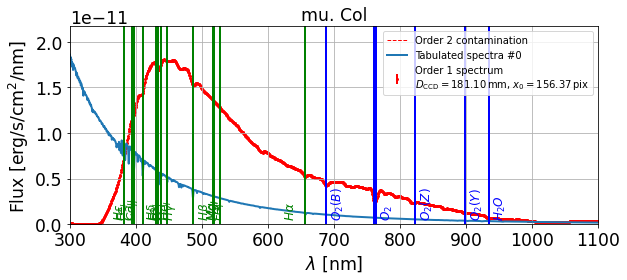

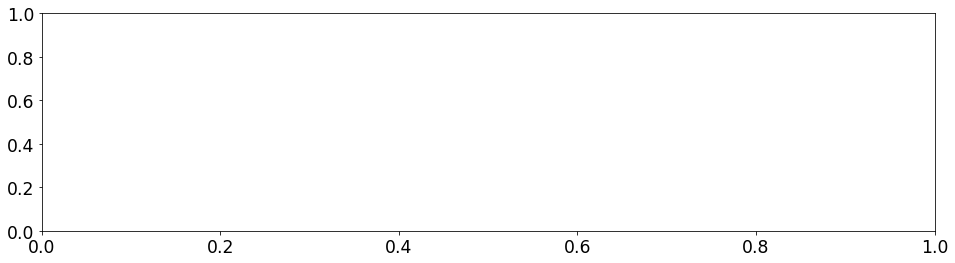

1 ) exposure_2022031700244_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:54:16.312
set expo to 20.0
set airmass to 1.121576965054115
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1741806116248446
set dec to -32.3064444444444
set hour_angle to 31.60492174100415
set temperature to 8.9
set pressure to 743.45
set humidity to 49.0
set lambda_ref to 626.883564656571
set parallactic_angle to 94.10618686949074
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_2 PM_ERR_MINA_2 PM_ERR_ANGLE_2 Z_VALUE_2 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr      mas / yr        deg                                 
--------- ------------- ------------- ------- -------- ... ------------- --

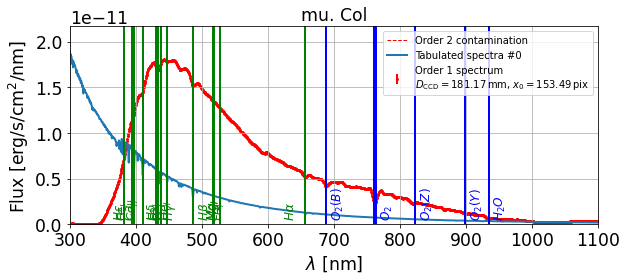

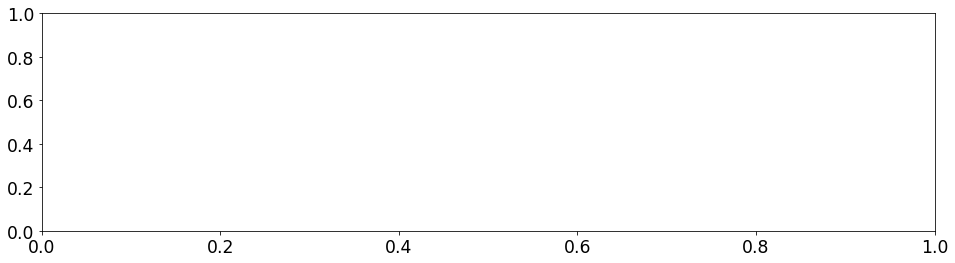

2 ) exposure_2022031700245_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700245/basespec/exposure_2022031700245_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:54:49.235
set expo to 20.0
set airmass to 1.12272698054768
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1736210434249555
set dec to -32.3064444444444
set hour_angle to 31.7419273199217
set temperature to 8.8
set pressure to 743.4
set humidity to 49.0
set lambda_ref to 626.0378655266279
set parallactic_angle to 94.16305953909519
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_3 PM_ERR_MINA_3 PM_ERR_ANGLE_3 Z_VALUE_3 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr      mas / yr        deg                                 
--------- ------------- ------------- ------- -------- ... ------------- ----

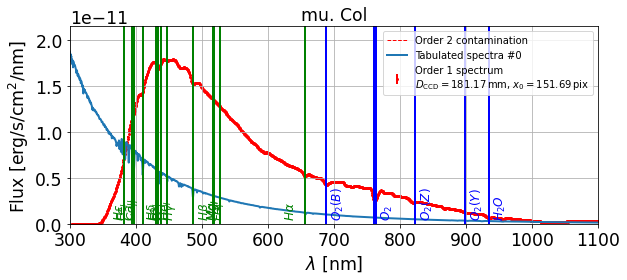

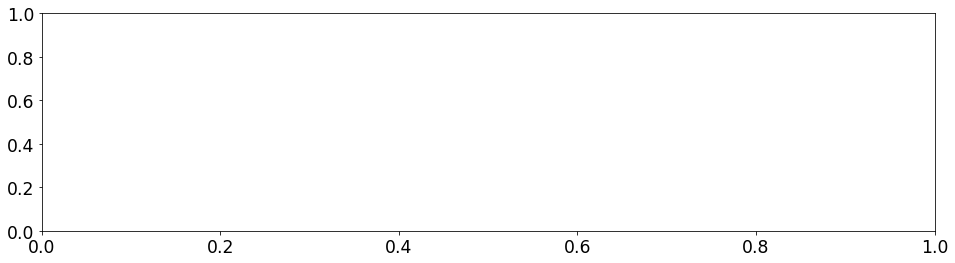

3 ) exposure_2022031700251_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700251/basespec/exposure_2022031700251_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:57:47.565
set expo to 20.0
set airmass to 1.12910731186445
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1713060449152569
set dec to -32.3064444444444
set hour_angle to 32.4876824869983
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.4911208542796
set parallactic_angle to 94.47019502924495
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_4 PM_ERR_MINA_4 PM_ERR_ANGLE_4 Z_VALUE_4 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr      mas / yr        deg                                 
--------- ------------- ------------- ------- -------- ... ------------- ----

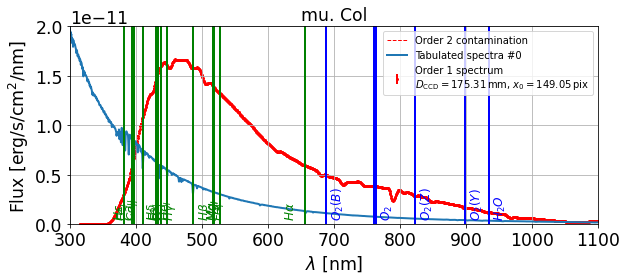

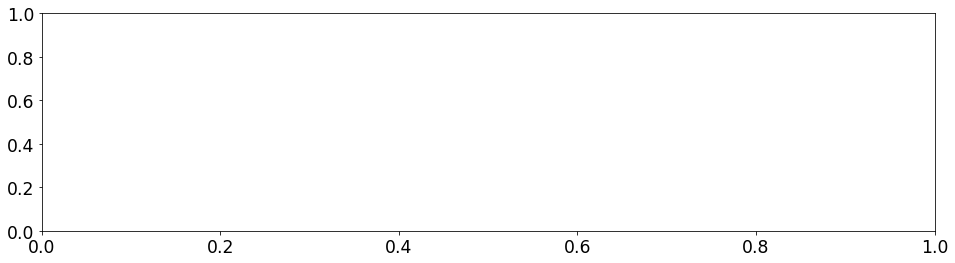

4 ) exposure_2022031700252_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700252/basespec/exposure_2022031700252_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:58:20.709
set expo to 20.0
set airmass to 1.130309156823195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.169943439836599
set dec to -32.3064444444444
set hour_angle to 32.6255240863161
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.2751365569749
set parallactic_angle to 94.52653019757676
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_5 PM_ERR_MINA_5 PM_ERR_ANGLE_5 Z_VALUE_5 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr      mas / yr        deg                                 
--------- ------------- ------------- ------- -------- ... ------------- ----

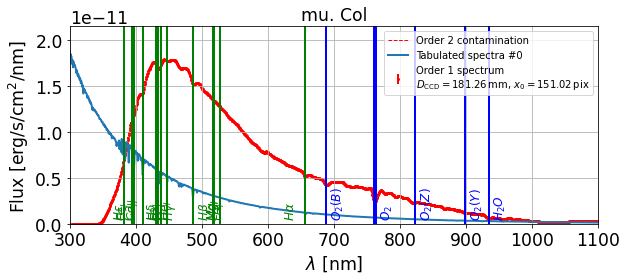

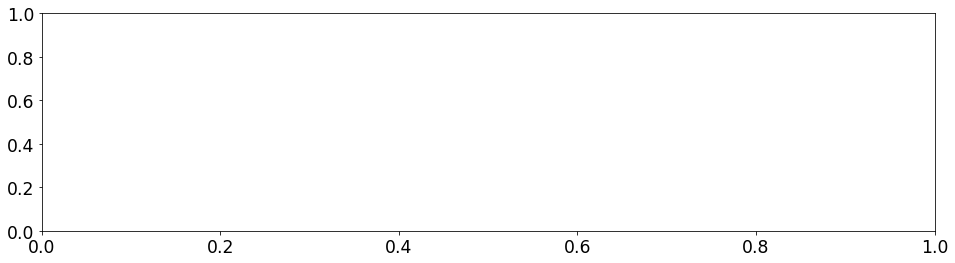

5 ) exposure_2022031700265_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700265/basespec/exposure_2022031700265_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:04:49.716
set expo to 20.0
set airmass to 1.14502998698828
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1680537967029804
set dec to -32.3064444444444
set hour_angle to 34.25103021292454
set temperature to 8.9
set pressure to 743.3
set humidity to 53.0
set lambda_ref to 626.5383418087131
set parallactic_angle to 95.18153718788132
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_6 PM_ERR_MINA_6 PM_ERR_ANGLE_6 Z_VALUE_6 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr      mas / yr        deg                                 
--------- ------------- ------------- ------- -------- ... ------------- ---

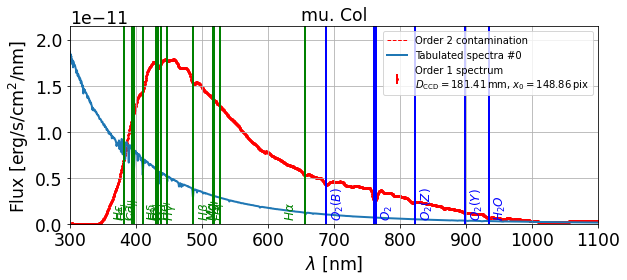

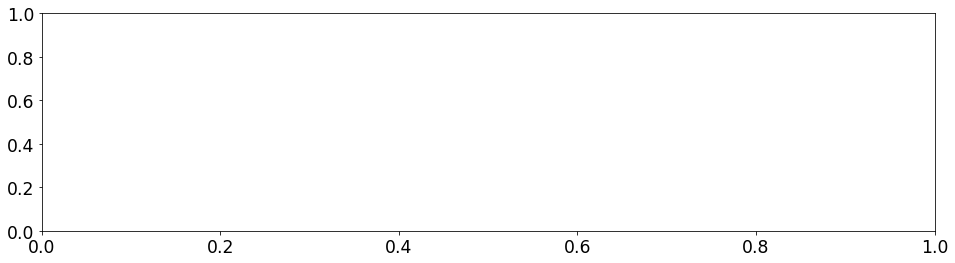

6 ) exposure_2022031700272_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700272/basespec/exposure_2022031700272_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:08:18.080
set expo to 20.0
set airmass to 1.1533391050821
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.165620392992809
set dec to -32.3064444444444
set hour_angle to 35.12228883044955
set temperature to 8.9
set pressure to 743.3
set humidity to 51.0
set lambda_ref to 626.067912732114
set parallactic_angle to 95.52618006847594
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_7 PM_ERR_MINA_7 PM_ERR_ANGLE_7 Z_VALUE_7 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr      mas / yr        deg                                 
--------- ------------- ------------- ------- -------- ... ------------- ------

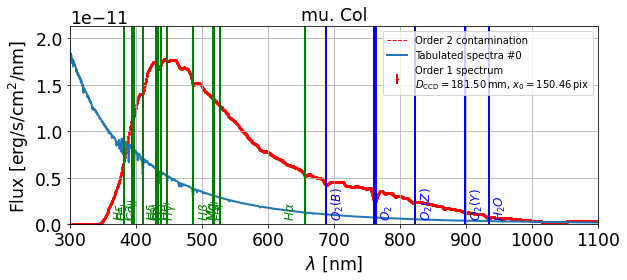

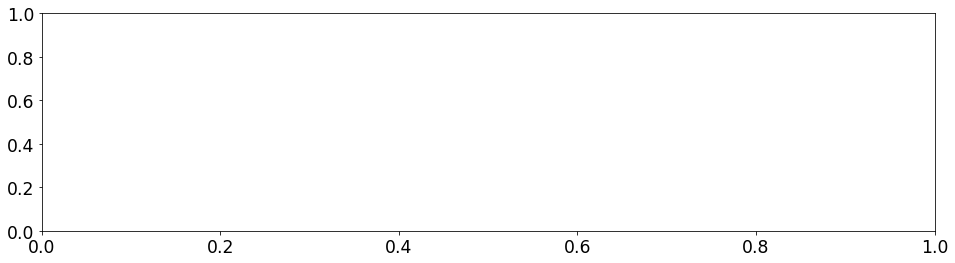

7 ) exposure_2022031700273_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700273/basespec/exposure_2022031700273_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:08:50.992
set expo to 20.0
set airmass to 1.154683255421995
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1687630065527601
set dec to -32.3064444444444
set hour_angle to 35.26034049072464
set temperature to 8.9
set pressure to 743.35
set humidity to 51.0
set lambda_ref to 626.2488273411835
set parallactic_angle to 95.58041503368928
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_8 PM_ERR_MINA_8 PM_ERR_ANGLE_8 Z_VALUE_8 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr      mas / yr        deg                                 
--------- ------------- ------------- ------- -------- ... ------------- -

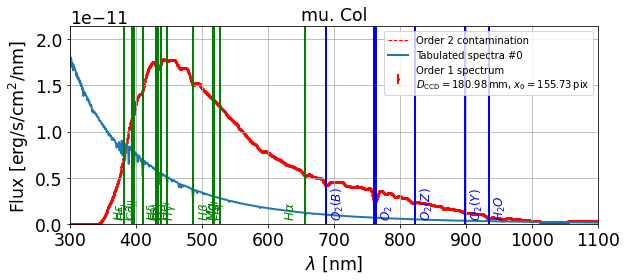

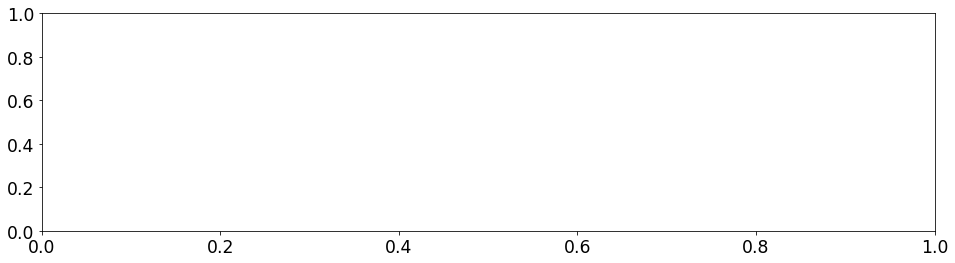

8 ) exposure_2022031700279_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700279/basespec/exposure_2022031700279_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:11:46.031
set expo to 20.0
set airmass to 1.16193866550813
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1650200479066801
set dec to -32.3064444444444
set hour_angle to 35.99118130784399
set temperature to 8.9
set pressure to 743.4
set humidity to 53.0
set lambda_ref to 625.9517855761172
set parallactic_angle to 95.86593376321808
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_9 PM_ERR_MINA_9 PM_ERR_ANGLE_9 Z_VALUE_9 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr      mas / yr        deg                                 
--------- ------------- ------------- ------- -------- ... ------------- ---

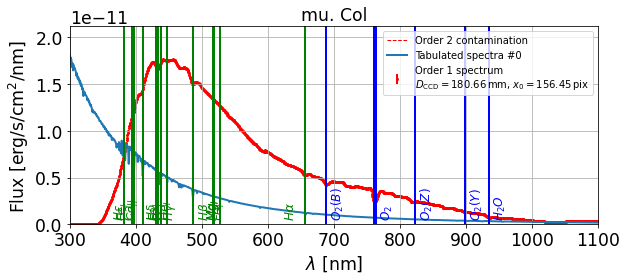

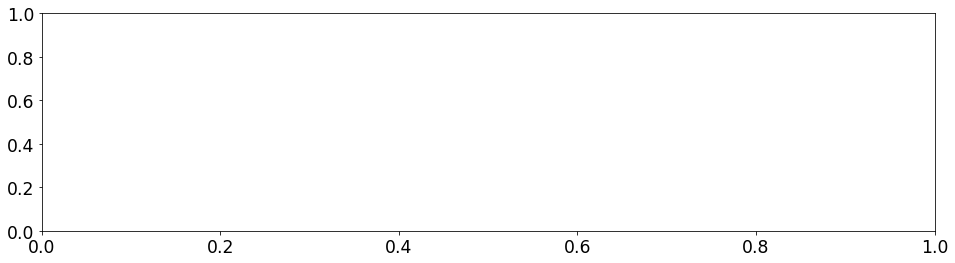

9 ) exposure_2022031700286_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700286/basespec/exposure_2022031700286_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:15:18.583
set expo to 20.0
set airmass to 1.17105276018288
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1604530597215738
set dec to -32.3064444444444
set hour_angle to 36.87993052247099
set temperature to 8.9
set pressure to 743.45
set humidity to 54.0
set lambda_ref to 626.415954438991
set parallactic_angle to 96.20974235390722
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_10 PM_ERR_MINA_10 PM_ERR_ANGLE_10 Z_VALUE_10 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ---------

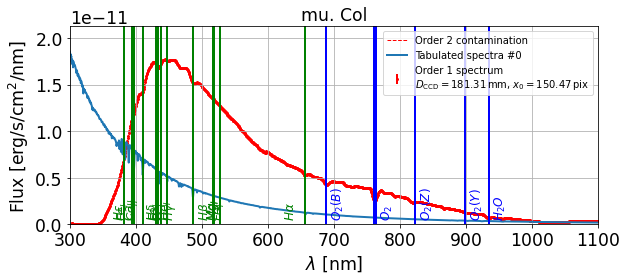

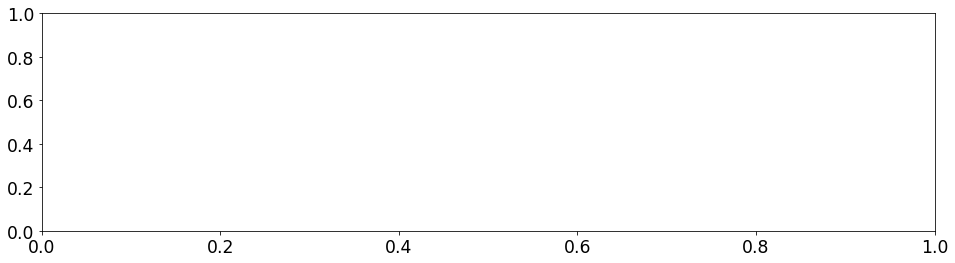

10 ) exposure_2022031700293_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700293/basespec/exposure_2022031700293_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:18:45.526
set expo to 20.0
set airmass to 1.18024864471996
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.161506254140246
set dec to -32.3064444444444
set hour_angle to 37.74449227926539
set temperature to 9.0
set pressure to 743.45
set humidity to 53.0
set lambda_ref to 626.2661772674467
set parallactic_angle to 96.54092631927332
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_11 PM_ERR_MINA_11 PM_ERR_ANGLE_11 Z_VALUE_11 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... --------

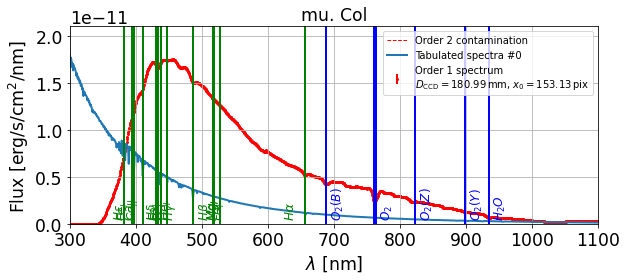

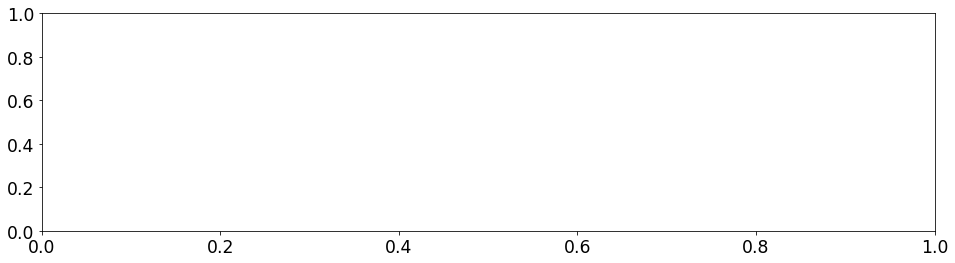

11 ) exposure_2022031700300_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700300/basespec/exposure_2022031700300_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:22:16.238
set expo to 20.0
set airmass to 1.189962402398665
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1600582040885921
set dec to -32.3064444444444
set hour_angle to 38.6257061937975
set temperature to 8.9
set pressure to 743.4
set humidity to 56.0
set lambda_ref to 626.2915574183227
set parallactic_angle to 96.875483029922
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_12 PM_ERR_MINA_12 PM_ERR_ANGLE_12 Z_VALUE_12 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ----------

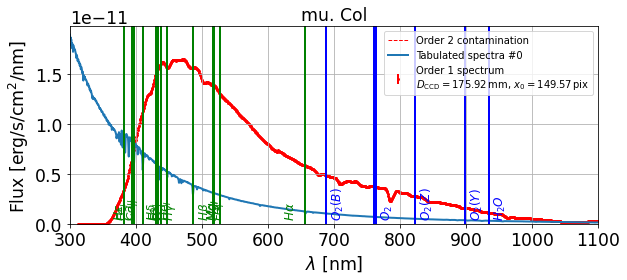

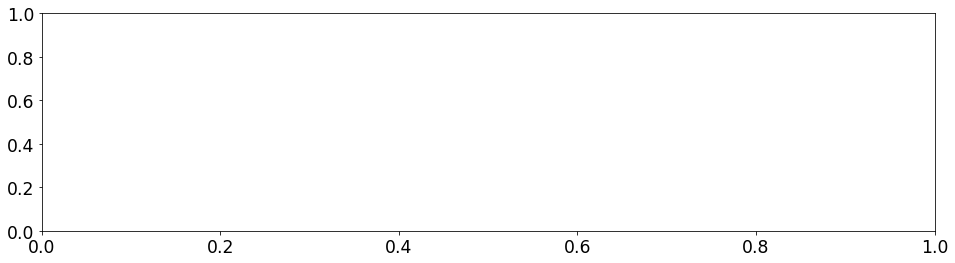

12 ) exposure_2022031700301_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700301/basespec/exposure_2022031700301_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:22:49.144
set expo to 20.0
set airmass to 1.191505368069865
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1585750124351514
set dec to -32.3064444444444
set hour_angle to 38.76271209839639
set temperature to 9.0
set pressure to 743.45
set humidity to 56.0
set lambda_ref to 626.4868452630084
set parallactic_angle to 96.92724413418016
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_13 PM_ERR_MINA_13 PM_ERR_ANGLE_13 Z_VALUE_13 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ------

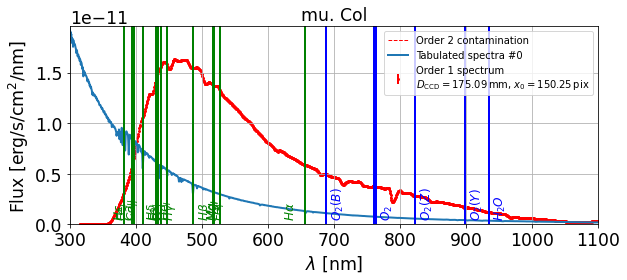

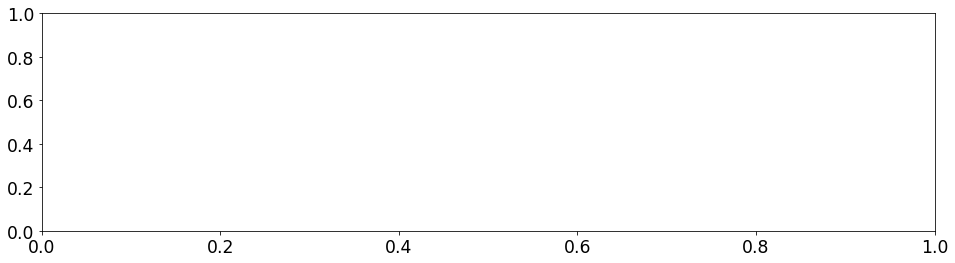

13 ) exposure_2022031700310_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700310/basespec/exposure_2022031700310_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:43:57.837
set expo to 20.0
set airmass to 1.25822658979951
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476502374643685
set dec to -32.3064444444444
set hour_angle to 44.06414790775874
set temperature to 8.8
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 626.6251269515418
set parallactic_angle to 98.88882683561982
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_14 PM_ERR_MINA_14 PM_ERR_ANGLE_14 Z_VALUE_14 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

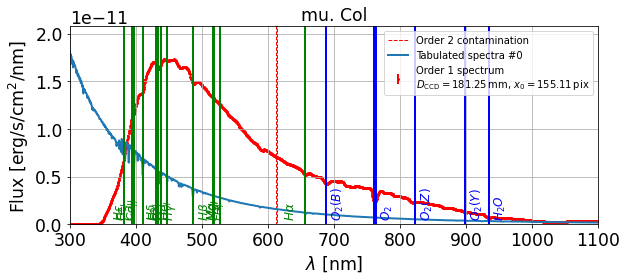

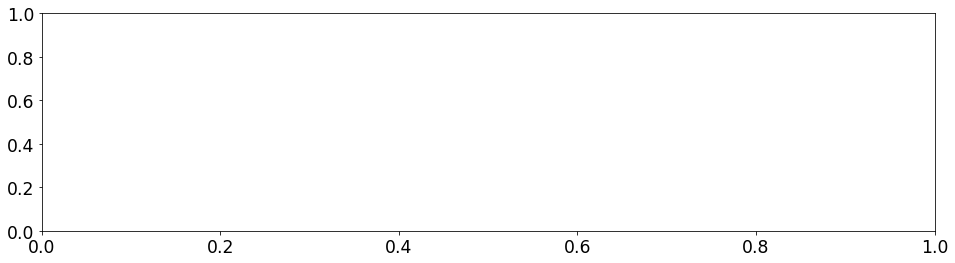

14 ) exposure_2022031700316_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700316/basespec/exposure_2022031700316_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:46:52.361
set expo to 20.0
set airmass to 1.26858445121286
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476350630254128
set dec to -32.3064444444444
set hour_angle to 44.79438636254909
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 627.6256863262817
set parallactic_angle to 99.15414320783184
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_15 PM_ERR_MINA_15 PM_ERR_ANGLE_15 Z_VALUE_15 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

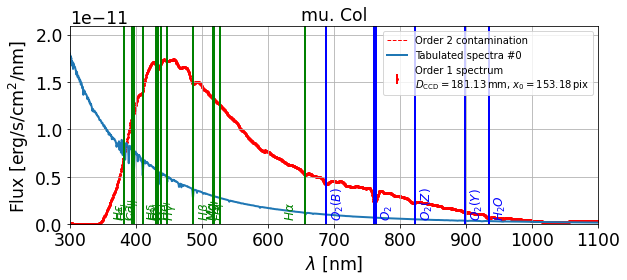

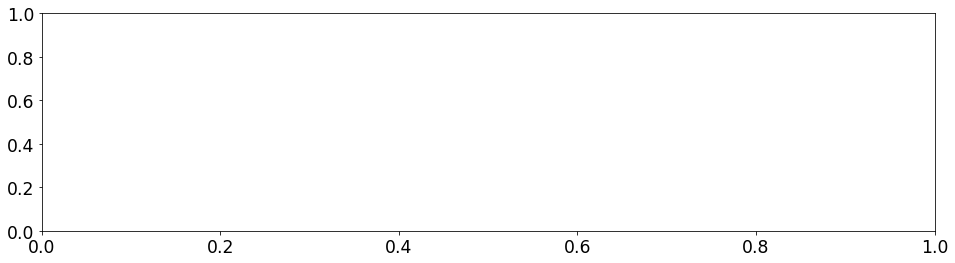

15 ) exposure_2022031700317_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700317/basespec/exposure_2022031700317_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:47:25.256
set expo to 20.0
set airmass to 1.27056341471374
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1466645118411156
set dec to -32.3064444444444
set hour_angle to 44.9315970155517
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 625.7408027741238
set parallactic_angle to 99.2038979478238
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_16 PM_ERR_MINA_16 PM_ERR_ANGLE_16 Z_VALUE_16 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ---------

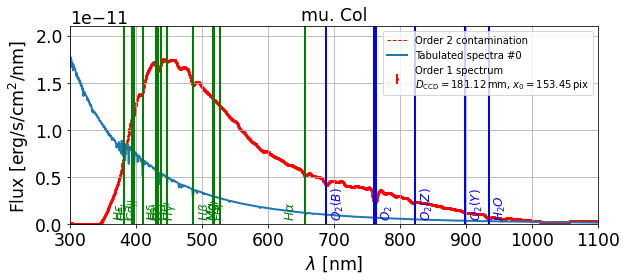

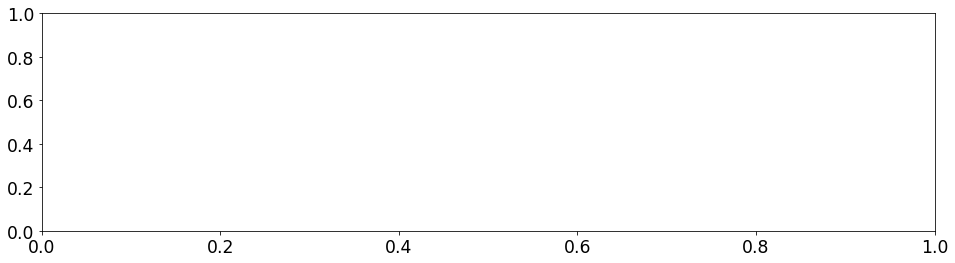

16 ) exposure_2022031700330_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700330/basespec/exposure_2022031700330_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:53:46.736
set expo to 20.0
set airmass to 1.294394244363805
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1444547716136137
set dec to -32.3064444444444
set hour_angle to 46.52581667330039
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.9120383005036
set parallactic_angle to 99.77999069166285
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_17 PM_ERR_MINA_17 PM_ERR_ANGLE_17 Z_VALUE_17 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

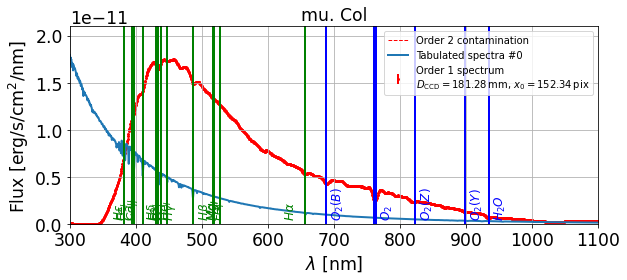

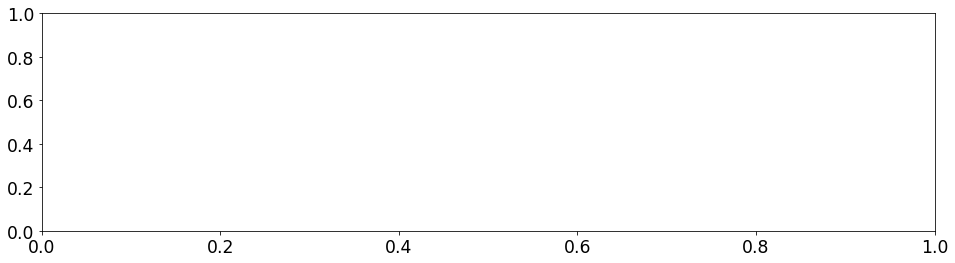

17 ) exposure_2022031700331_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700331/basespec/exposure_2022031700331_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:54:19.724
set expo to 20.0
set airmass to 1.29652271576687
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1441648974084375
set dec to -32.3064444444444
set hour_angle to 46.6628171725209
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.7462807078947
set parallactic_angle to 99.82934304254884
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_18 PM_ERR_MINA_18 PM_ERR_ANGLE_18 Z_VALUE_18 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ---------

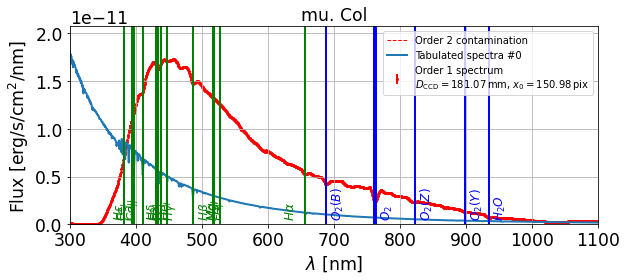

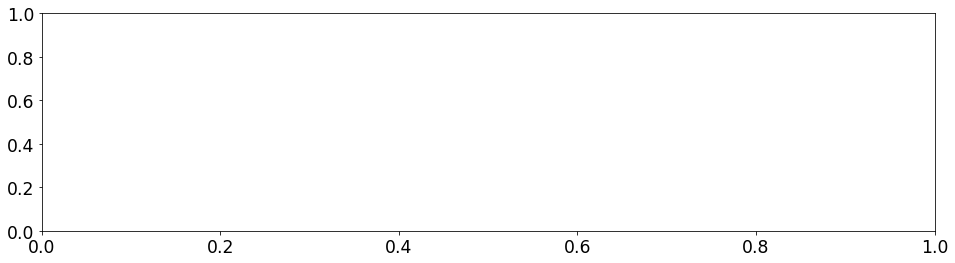

18 ) exposure_2022031700338_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700338/basespec/exposure_2022031700338_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:57:49.306
set expo to 20.0
set airmass to 1.31035777011874
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1437462230173573
set dec to -32.3064444444444
set hour_angle to 47.53898537176394
set temperature to 8.7
set pressure to 743.45
set humidity to 57.0
set lambda_ref to 628.9551099539515
set parallactic_angle to 100.14447493807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_19 PM_ERR_MINA_19 PM_ERR_ANGLE_19 Z_VALUE_19 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ---------

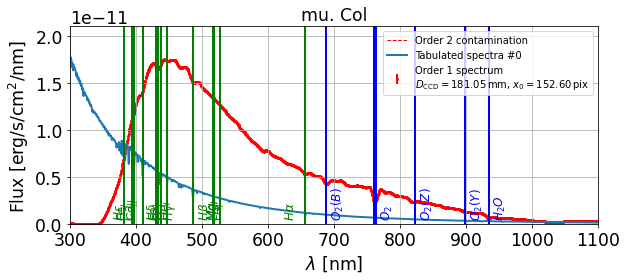

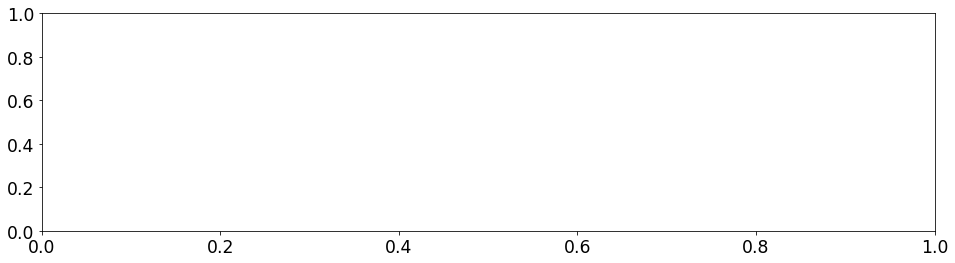

19 ) exposure_2022031700345_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700345/basespec/exposure_2022031700345_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:01:19.196
set expo to 20.0
set airmass to 1.324716687989025
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1392710710370809
set dec to -32.3064444444444
set hour_angle to 48.4163008821963
set temperature to 8.6
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 626.8625000130343
set parallactic_angle to 100.4592627484374
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_20 PM_ERR_MINA_20 PM_ERR_ANGLE_20 Z_VALUE_20 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

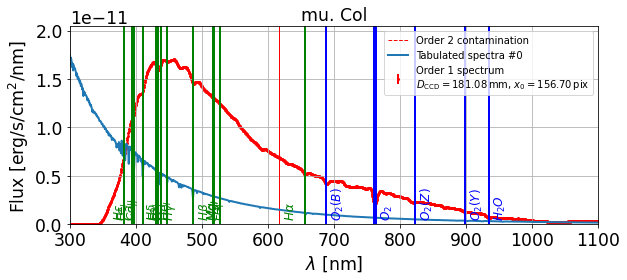

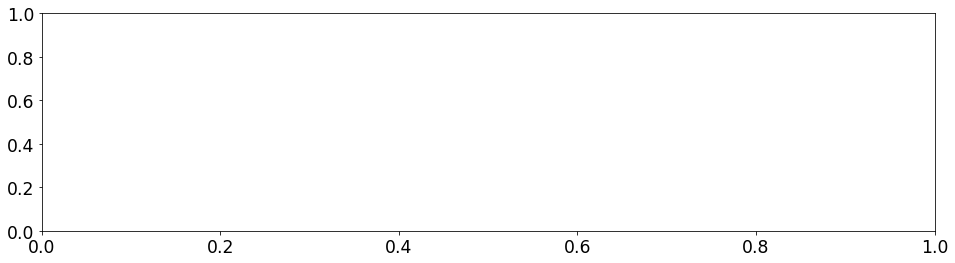

20 ) exposure_2022031700351_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700351/basespec/exposure_2022031700351_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:04:16.794
set expo to 20.0
set airmass to 1.33727547076682
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1388486262435704
set dec to -32.3064444444444
set hour_angle to 49.15879882143194
set temperature to 8.5
set pressure to 743.45
set humidity to 58.0
set lambda_ref to 628.5424256920012
set parallactic_angle to 100.7251843777299
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_21 PM_ERR_MINA_21 PM_ERR_ANGLE_21 Z_VALUE_21 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

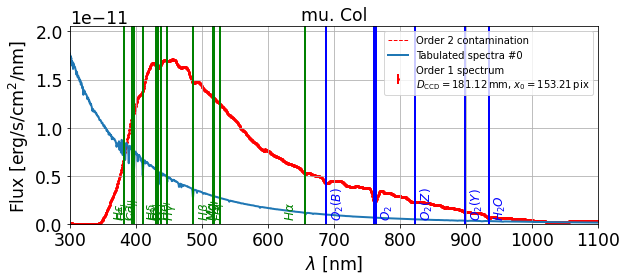

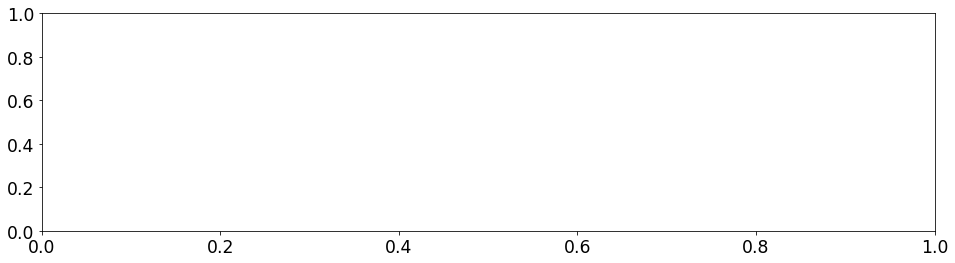

21 ) exposure_2022031700352_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700352/basespec/exposure_2022031700352_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:04:49.712
set expo to 20.0
set airmass to 1.33963651479802
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1368681187146323
set dec to -32.3064444444444
set hour_angle to 49.29580448438519
set temperature to 8.5
set pressure to 743.35
set humidity to 58.0
set lambda_ref to 628.2086674961155
set parallactic_angle to 100.7742095756281
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_22 PM_ERR_MINA_22 PM_ERR_ANGLE_22 Z_VALUE_22 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

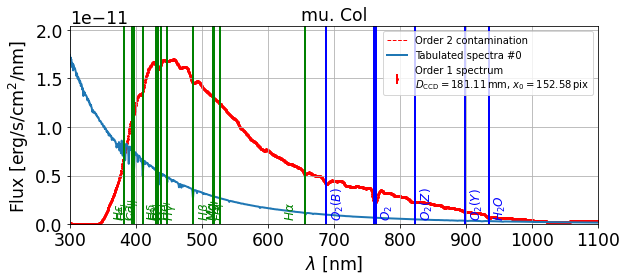

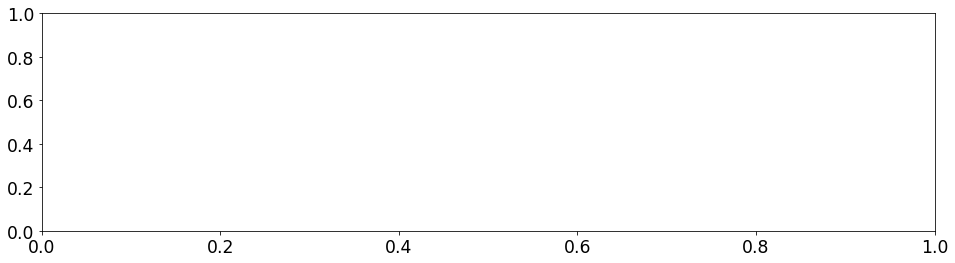

22 ) exposure_2022031700358_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700358/basespec/exposure_2022031700358_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:07:49.074
set expo to 20.0
set airmass to 1.352787300037425
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1331931685876357
set dec to -32.3064444444444
set hour_angle to 50.04587365708529
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 627.9591693143808
set parallactic_angle to 101.0424069948098
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_23 PM_ERR_MINA_23 PM_ERR_ANGLE_23 Z_VALUE_23 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

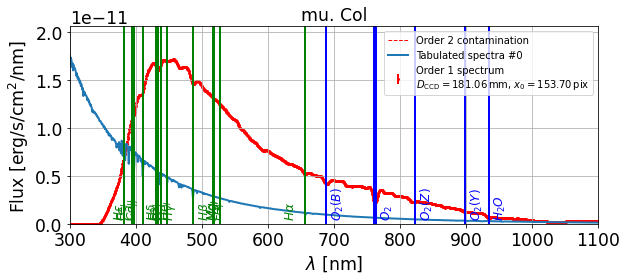

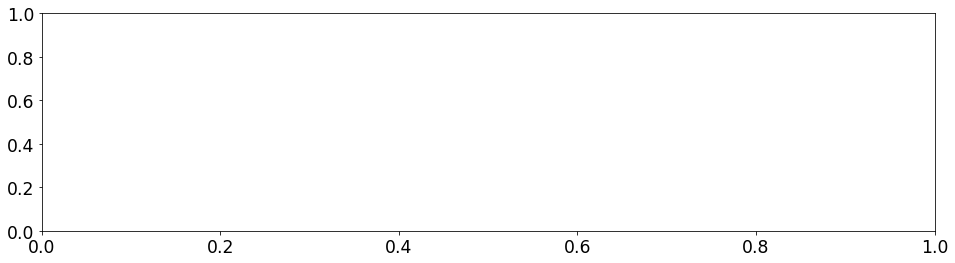

23 ) exposure_2022031700365_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700365/basespec/exposure_2022031700365_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:11:20.051
set expo to 20.0
set airmass to 1.368765631503195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1336440841342464
set dec to -32.3064444444444
set hour_angle to 50.92719907664954
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 622.7051672626101
set parallactic_angle to 101.357174452077
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_24 PM_ERR_MINA_24 PM_ERR_ANGLE_24 Z_VALUE_24 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... --------

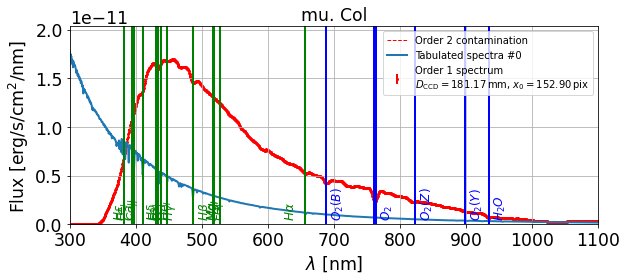

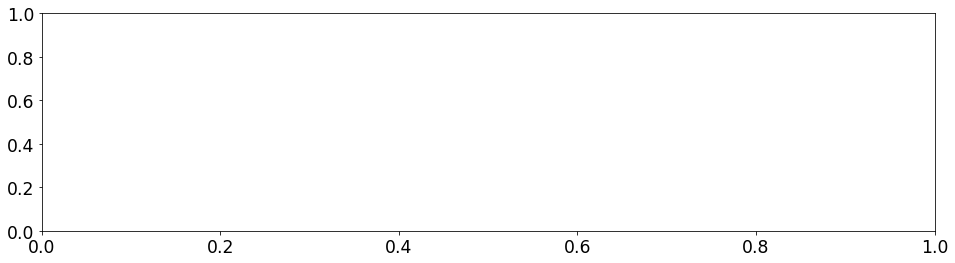

24 ) exposure_2022031700366_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700366/basespec/exposure_2022031700366_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:11:53.006
set expo to 20.0
set airmass to 1.371319339871885
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1369079175197151
set dec to -32.3064444444444
set hour_angle to 51.06504024257939
set temperature to 8.4
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 629.1845159477502
set parallactic_angle to 101.4063764649771
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_25 PM_ERR_MINA_25 PM_ERR_ANGLE_25 Z_VALUE_25 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ------

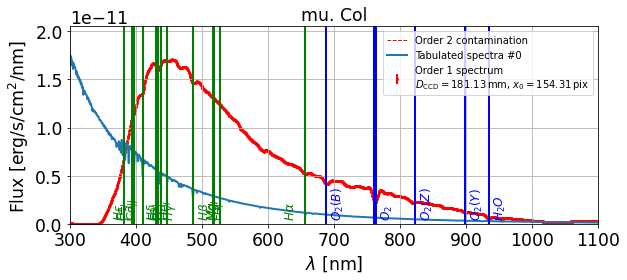

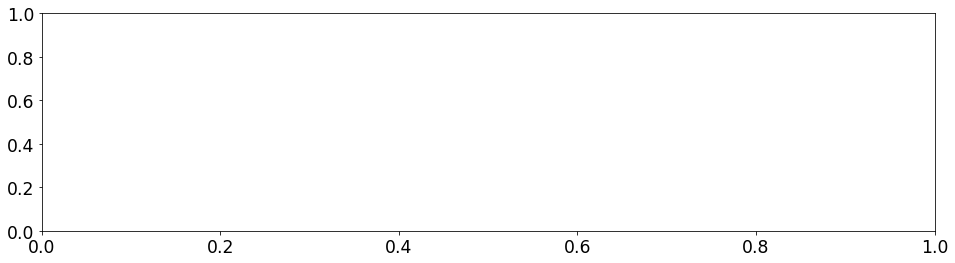

25 ) exposure_2022031700372_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700372/basespec/exposure_2022031700372_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:14:46.798
set expo to 20.0
set airmass to 1.38501167017706
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1310814762516916
set dec to -32.3064444444444
set hour_angle to 51.79156958975715
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.5245232921197
set parallactic_angle to 101.6656129875546
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_26 PM_ERR_MINA_26 PM_ERR_ANGLE_26 Z_VALUE_26 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

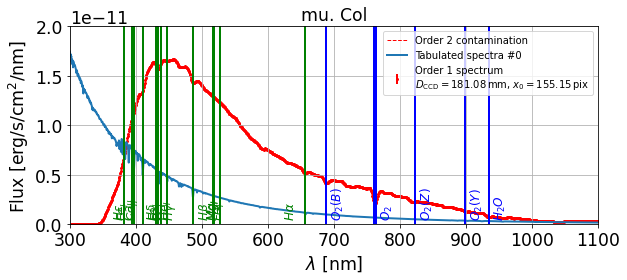

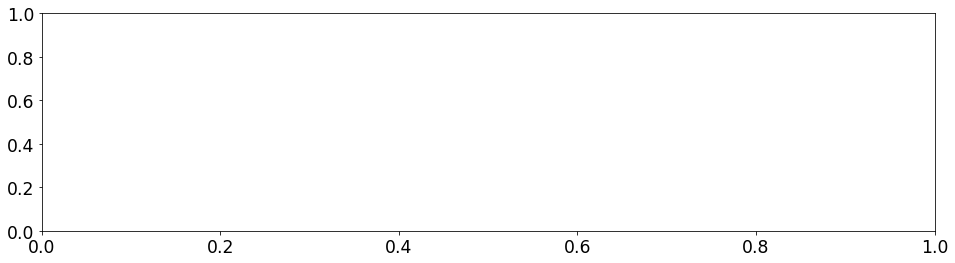

26 ) exposure_2022031700373_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700373/basespec/exposure_2022031700373_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:15:19.743
set expo to 20.0
set airmass to 1.387649936190795
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1317245037126307
set dec to -32.3064444444444
set hour_angle to 51.92878009828319
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.9968889639981
set parallactic_angle to 101.7145568247823
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_27 PM_ERR_MINA_27 PM_ERR_ANGLE_27 Z_VALUE_27 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ------

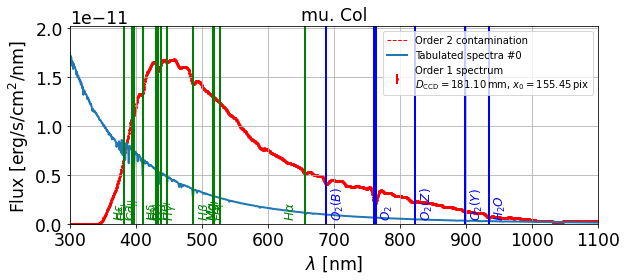

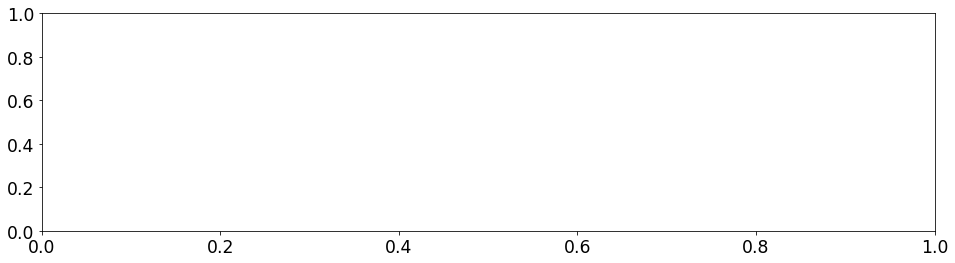

27 ) exposure_2022031700380_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700380/basespec/exposure_2022031700380_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:33:33.012
set expo to 20.0
set airmass to 1.48452422171666
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1197628273916148
set dec to -32.3064444444444
set hour_angle to 56.49902324990354
set temperature to 8.0
set pressure to 743.35
set humidity to 63.0
set lambda_ref to 628.5888123380201
set parallactic_angle to 103.3450343494105
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_28 PM_ERR_MINA_28 PM_ERR_ANGLE_28 Z_VALUE_28 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

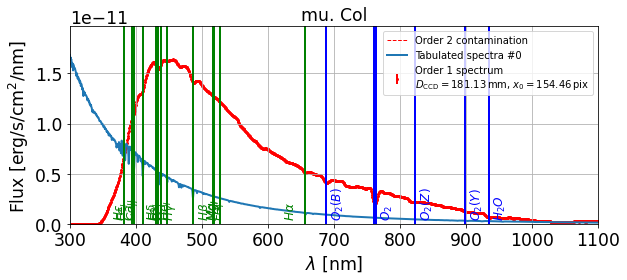

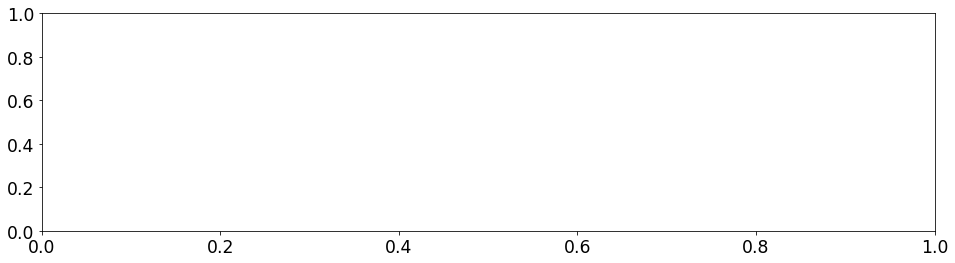

28 ) exposure_2022031700386_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700386/basespec/exposure_2022031700386_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:36:30.874
set expo to 20.0
set airmass to 1.50213593383469
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1172584274998106
set dec to -32.3064444444444
set hour_angle to 57.24247377715349
set temperature to 8.1
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 633.8101508297243
set parallactic_angle to 103.6108187575918
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_29 PM_ERR_MINA_29 PM_ERR_ANGLE_29 Z_VALUE_29 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

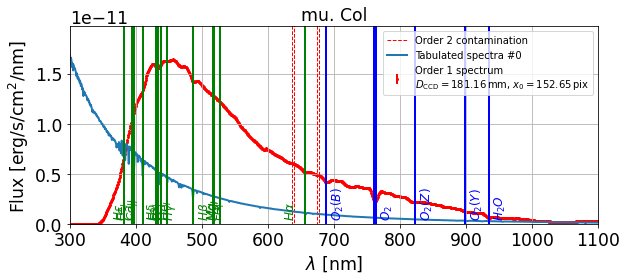

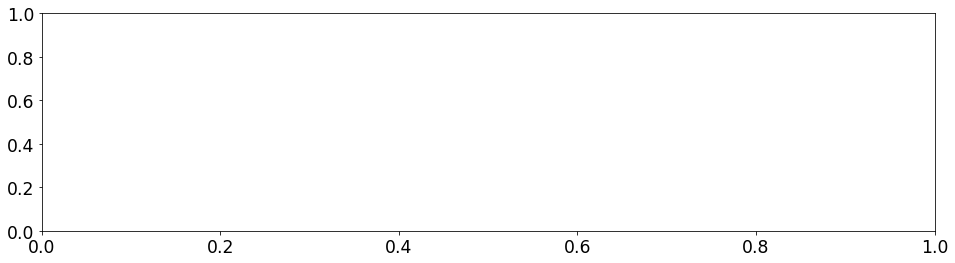

29 ) exposure_2022031700387_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700387/basespec/exposure_2022031700387_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:37:03.815
set expo to 20.0
set airmass to 1.50545657928364
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1211335036558286
set dec to -32.3064444444444
set hour_angle to 57.37947904087095
set temperature to 8.1
set pressure to 743.35
set humidity to 64.0
set lambda_ref to 628.2172036981787
set parallactic_angle to 103.6598297048832
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_30 PM_ERR_MINA_30 PM_ERR_ANGLE_30 Z_VALUE_30 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

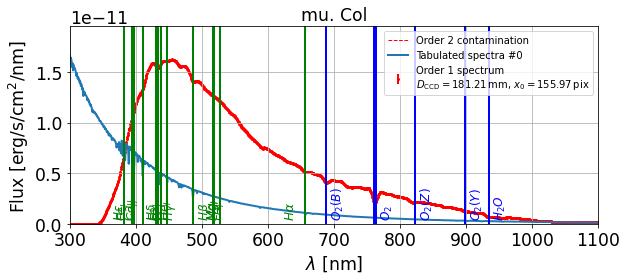

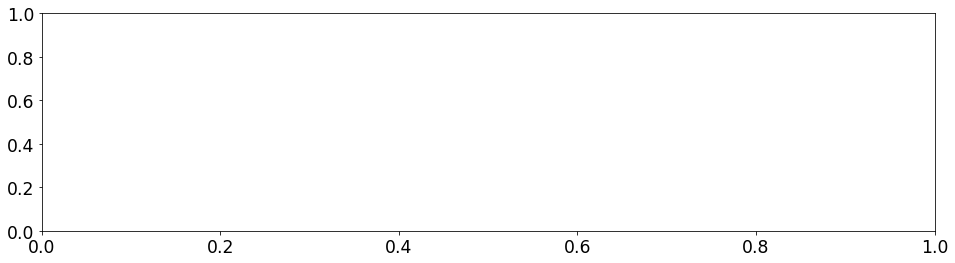

30 ) exposure_2022031700393_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700393/basespec/exposure_2022031700393_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:40:00.839
set expo to 20.0
set airmass to 1.523657512515415
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1177429780701742
set dec to -32.3064444444444
set hour_angle to 58.11949120092164
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.3577400172557
set parallactic_angle to 103.9247454603291
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_31 PM_ERR_MINA_31 PM_ERR_ANGLE_31 Z_VALUE_31 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

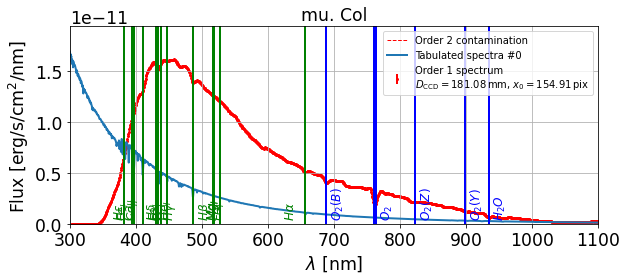

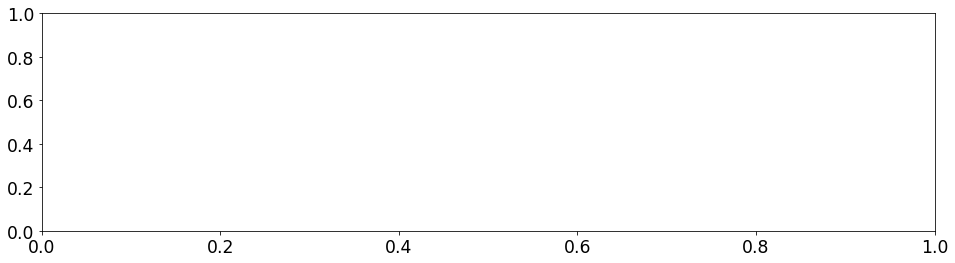

31 ) exposure_2022031700394_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700394/basespec/exposure_2022031700394_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:40:33.787
set expo to 20.0
set airmass to 1.527114954027915
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1169167488860146
set dec to -32.3064444444444
set hour_angle to 58.25733391386269
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.7847433714671
set parallactic_angle to 103.9741296646409
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_32 PM_ERR_MINA_32 PM_ERR_ANGLE_32 Z_VALUE_32 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

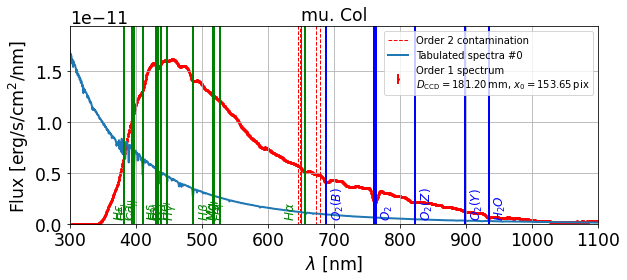

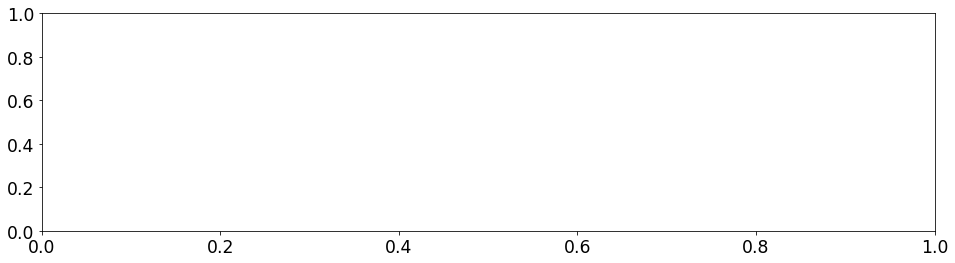

32 ) exposure_2022031700401_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700401/basespec/exposure_2022031700401_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:44:05.105
set expo to 20.0
set airmass to 1.54976447202586
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1144055844584487
set dec to -32.3064444444444
set hour_angle to 59.14046723526914
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 629.2826348266267
set parallactic_angle to 104.2908413745483
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_33 PM_ERR_MINA_33 PM_ERR_ANGLE_33 Z_VALUE_33 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------

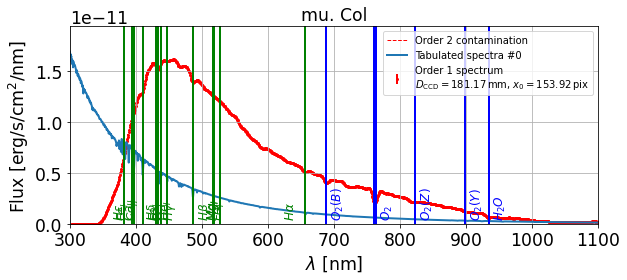

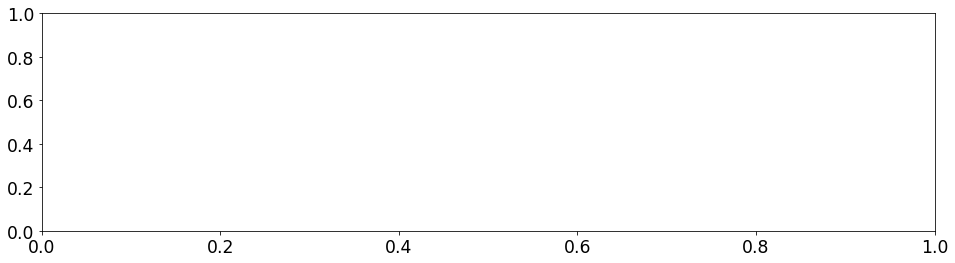

33 ) exposure_2022031700407_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700407/basespec/exposure_2022031700407_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:47:02.835
set expo to 20.0
set airmass to 1.56951976624838
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.113192412444726
set dec to -32.3064444444444
set hour_angle to 59.88301895711849
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 623.392411114623
set parallactic_angle to 104.5576025273592
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_34 PM_ERR_MINA_34 PM_ERR_ANGLE_34 Z_VALUE_34 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ----------

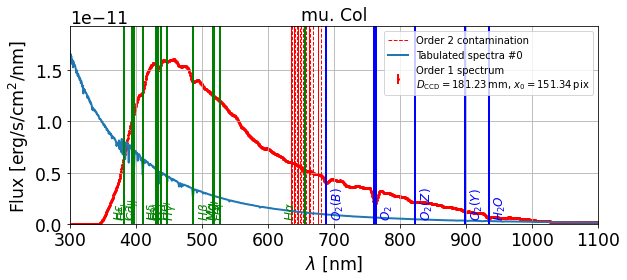

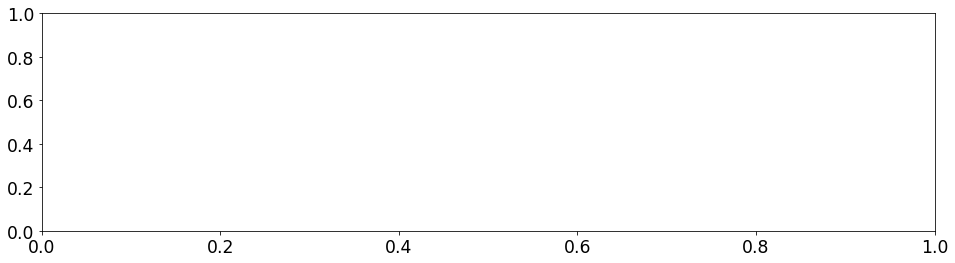

34 ) exposure_2022031700408_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700408/basespec/exposure_2022031700408_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:47:35.769
set expo to 20.0
set airmass to 1.573248011911855
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1127873058479127
set dec to -32.3064444444444
set hour_angle to 60.02106934614464
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 624.3168639615992
set parallactic_angle to 104.6072480488688
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_35 PM_ERR_MINA_35 PM_ERR_ANGLE_35 Z_VALUE_35 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ------

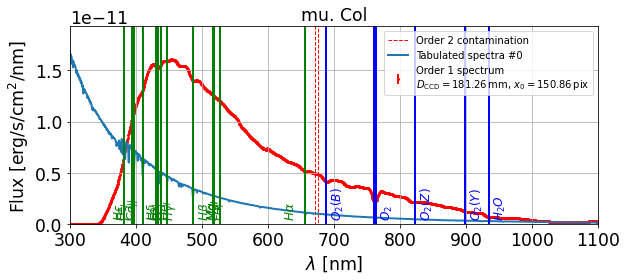

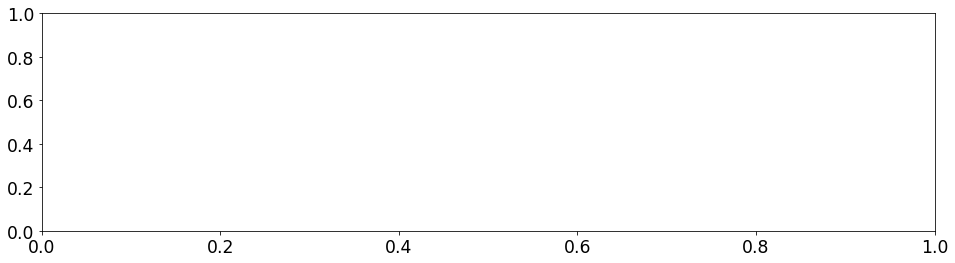

35 ) exposure_2022031700414_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700414/basespec/exposure_2022031700414_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:50:38.306
set expo to 20.0
set airmass to 1.594345273370295
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1038057563272595
set dec to -32.3064444444444
set hour_angle to 60.78322641711044
set temperature to 8.0
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 625.6140852852044
set parallactic_angle to 104.8816435668321
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_36 PM_ERR_MINA_36 PM_ERR_ANGLE_36 Z_VALUE_36 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ------

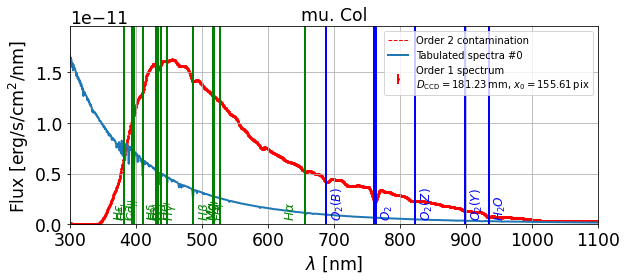

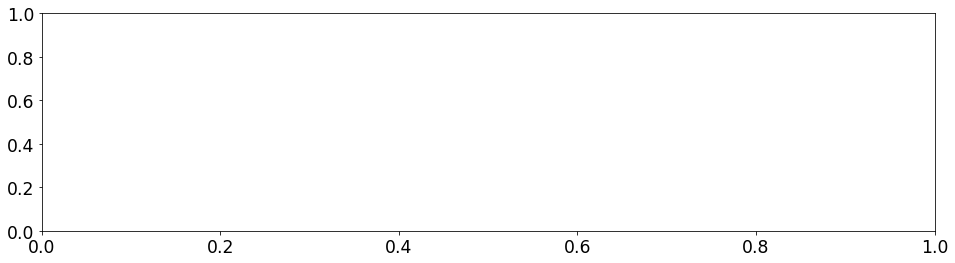

36 ) exposure_2022031700421_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700421/basespec/exposure_2022031700421_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:08:41.573
set expo to 20.0
set airmass to 1.73594131895663
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09058150608401207
set dec to -32.3064444444444
set hour_angle to 65.3119392087705
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 631.9889212287092
set parallactic_angle to 106.5252810168807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_37 PM_ERR_MINA_37 PM_ERR_ANGLE_37 Z_VALUE_37 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... --------

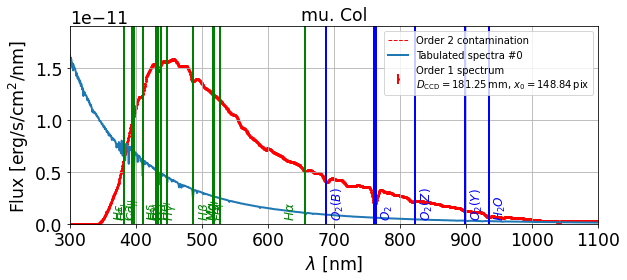

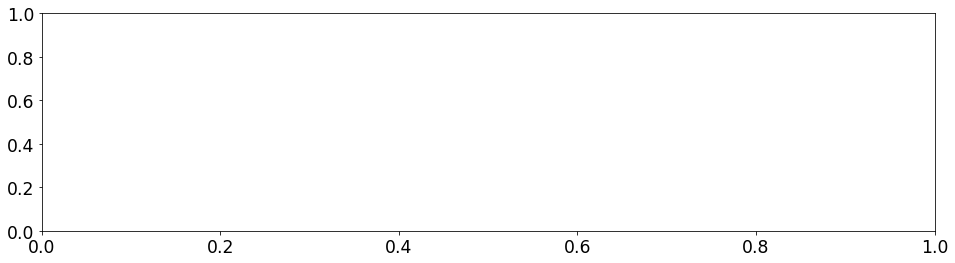

37 ) exposure_2022031700422_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700422/basespec/exposure_2022031700422_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:09:14.484
set expo to 20.0
set airmass to 1.740715384660955
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09733707671582016
set dec to -32.3064444444444
set hour_angle to 65.44894264967655
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 625.9596270530473
set parallactic_angle to 106.5754178018598
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_38 PM_ERR_MINA_38 PM_ERR_ANGLE_38 Z_VALUE_38 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ------

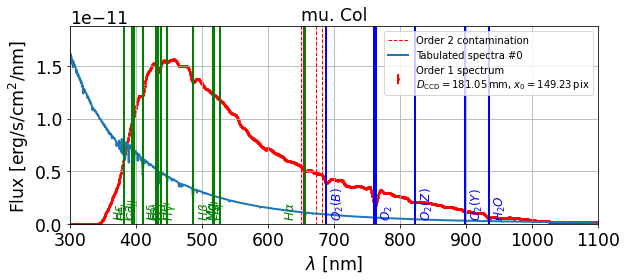

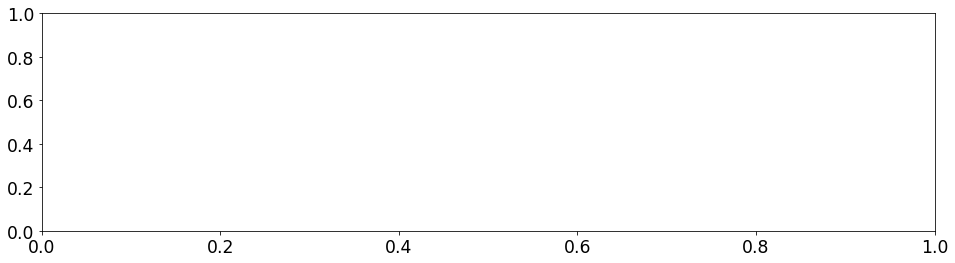

38 ) exposure_2022031700428_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700428/basespec/exposure_2022031700428_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:12:54.310
set expo to 20.0
set airmass to 2.129245852899135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.143944791309082
set dec to -87.4721944444444
set hour_angle to -155.5929780702915
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 686.0625390317258
set parallactic_angle to -156.1678055894986
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_39 PM_ERR_MINA_39 PM_ERR_ANGLE_39 Z_VALUE_39 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ---

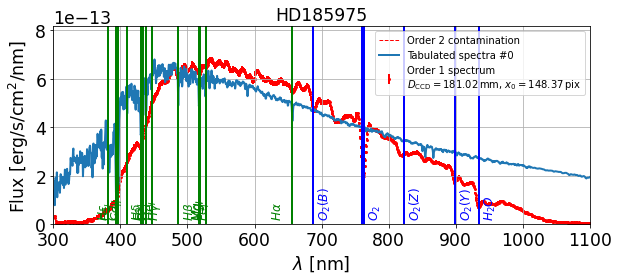

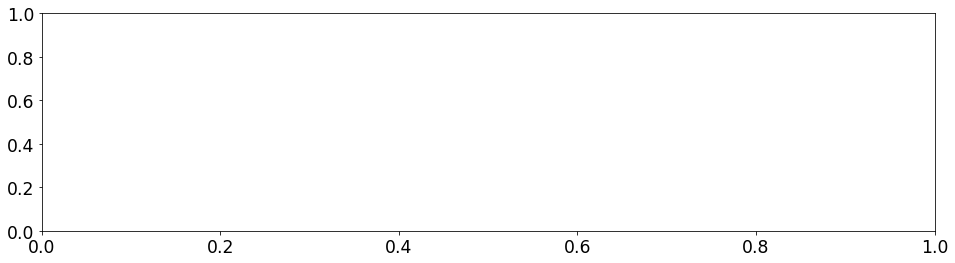

39 ) exposure_2022031700429_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700429/basespec/exposure_2022031700429_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:13:27.208
set expo to 20.0
set airmass to 2.1290679262036
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09887590360164929
set dec to -87.4721944444444
set hour_angle to -155.455137691263
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 636.4362643500099
set parallactic_angle to -156.0330469936088
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_40 PM_ERR_MINA_40 PM_ERR_ANGLE_40 Z_VALUE_40 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ----

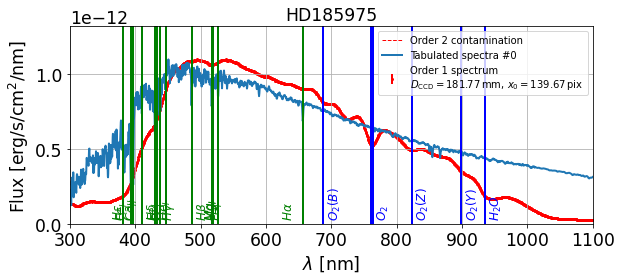

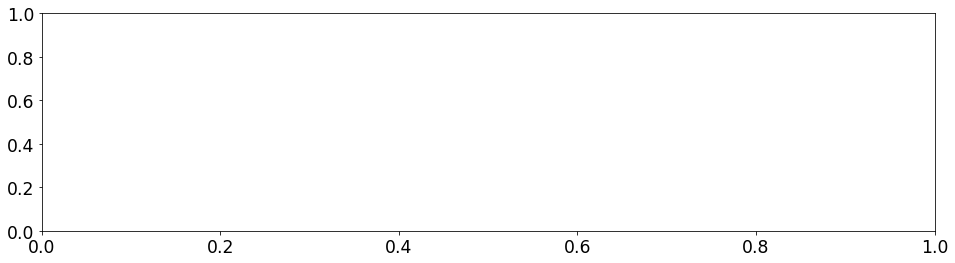

40 ) exposure_2022031700435_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700435/basespec/exposure_2022031700435_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:17:06.794
set expo to 20.0
set airmass to 1.81309435755974
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09210139501009447
set dec to -32.3064444444444
set hour_angle to 67.42354300312304
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 626.8738274489511
set parallactic_angle to 107.3011935159837
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_41 PM_ERR_MINA_41 PM_ERR_ANGLE_41 Z_VALUE_41 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ------

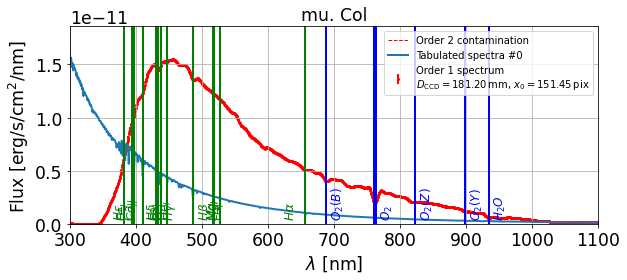

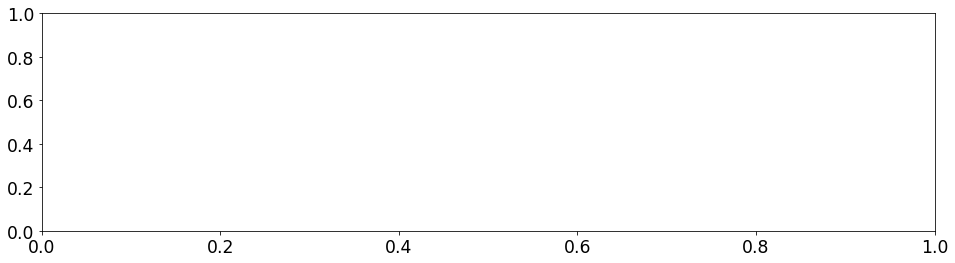

41 ) exposure_2022031700436_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700436/basespec/exposure_2022031700436_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:17:39.779
set expo to 20.0
set airmass to 1.818418067455135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.08344429603447075
set dec to -32.3064444444444
set hour_angle to 67.56159248336594
set temperature to 7.7
set pressure to 743.4
set humidity to 63.0
set lambda_ref to 632.4252252976918
set parallactic_angle to 107.3521665962106
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_42 PM_ERR_MINA_42 PM_ERR_ANGLE_42 Z_VALUE_42 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ------

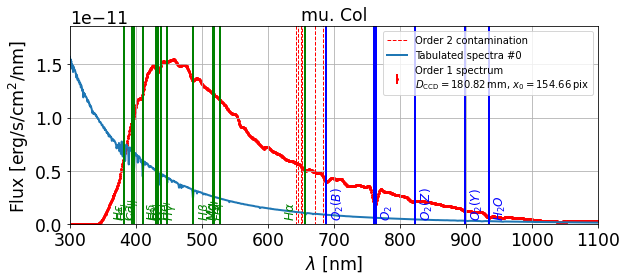

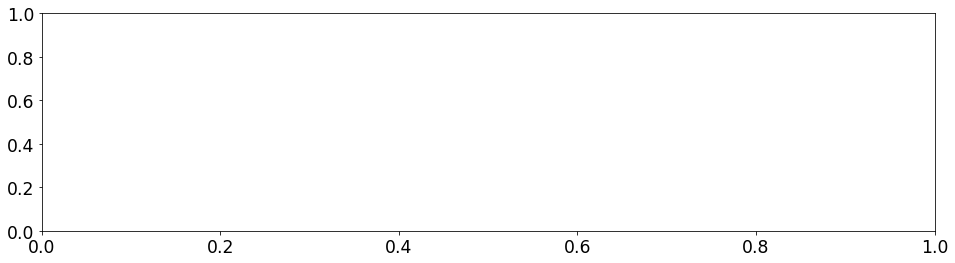

42 ) exposure_2022031700442_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700442/basespec/exposure_2022031700442_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:21:26.873
set expo to 20.0
set airmass to 1.856070090955285
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.06347269052355019
set dec to -32.3064444444444
set hour_angle to 68.51099093135984
set temperature to 7.8
set pressure to 743.4
set humidity to 62.0
set lambda_ref to 630.0633085655397
set parallactic_angle to 107.7035936917225
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_43 PM_ERR_MINA_43 PM_ERR_ANGLE_43 Z_VALUE_43 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ------

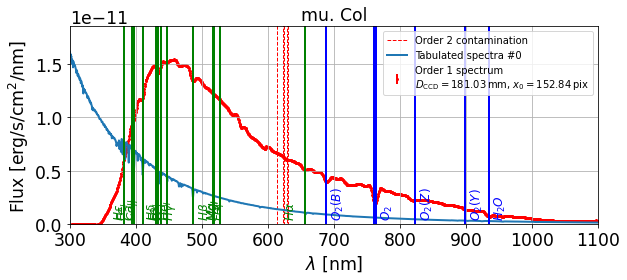

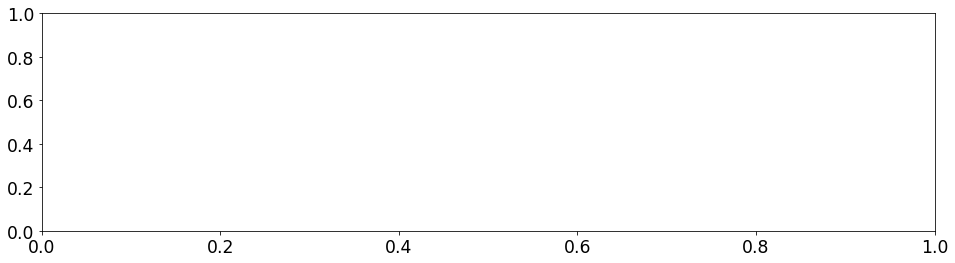

43 ) exposure_2022031700443_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700443/basespec/exposure_2022031700443_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:21:59.878
set expo to 20.0
set airmass to 1.861691550345225
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.0769189759908508
set dec to -32.3064444444444
set hour_angle to 68.64883074724754
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 633.3015467495994
set parallactic_angle to 107.7547458765076
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_44 PM_ERR_MINA_44 PM_ERR_ANGLE_44 Z_VALUE_44 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... ------

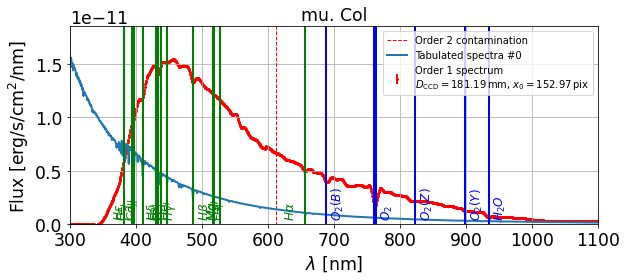

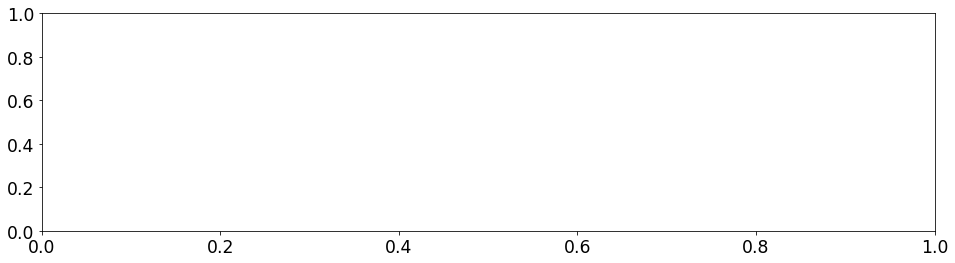

In [47]:
parameters.DISPLAY=True
FLAG_ORDER2 = True



infos = []
all_lambdas=[]
all_data=[]
all_data_err=[]

if FLAG_ORDER2:
    all_lambdas_order2=[]
    all_data_order2=[]
    all_data_err_order2=[]
    
    
all_num=[]
all_figs = []

idx=0
for fullfilename in all_good_spectra_spectrum_files:
    
    filename = os.path.basename(fullfilename)
    print(idx,")",filename," ",fullfilename)
    
    
    fig=plt.figure(figsize=(16,4))
    ax1 = fig.add_subplot(1, 2, 1)
    
    filename= os.path.basename(fullfilename)
    tag=file_tag_forsorting(filename.split(".")[0])
    all_num.append(tag)
    
   
     
    s=Spectrum(fullfilename, config=config,fast_load=False)
    label=filename.split('.')[0]+" "
    #s.plot_spectrum(ax=ax1,force_lines=True,label=label)
    s.plot_spectrum(ax=ax1,force_lines=True)
    
    all_lambdas.append(s.lambdas)
    all_data.append(s.data)
    all_data_err.append(s.err)
    
    if FLAG_ORDER2:
        all_lambdas_order2.append(s.lambdas_order2)
        all_data_order2.append(s.data_order2)
        all_data_err_order2.append(s.err_order2)
    
    ax2 = fig.add_subplot(1, 2, 2)
    
    fullfilename2=all_files_spectrogram[idx]
    
    s.load_spectrogram(fullfilename2)
    s.plot_spectrogram(ax=ax2,scale="log")
    
    
    infos.append([idx,tag,s.target.label,s.date_obs,s.airmass,s.temperature,s.pressure,s.humidity])
    
    
    plt.show()
    all_figs.append(fig)
    
    idx+=1
    

## View one spectrum

1 ) exposure_2022031700244_postisrccd_spectrum.fits   /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:54:16.312
set expo to 20.0
set airmass to 1.121576965054115
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1741806116248446
set dec to -32.3064444444444
set hour_angle to 31.60492174100415
set temperature to 8.9
set pressure to 743.45
set humidity to 49.0
set lambda_ref to 626.883564656571
set parallactic_angle to 94.10618686949074
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_45 PM_ERR_MINA_45 PM_ERR_ANGLE_45 Z_VALUE_45 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... --------

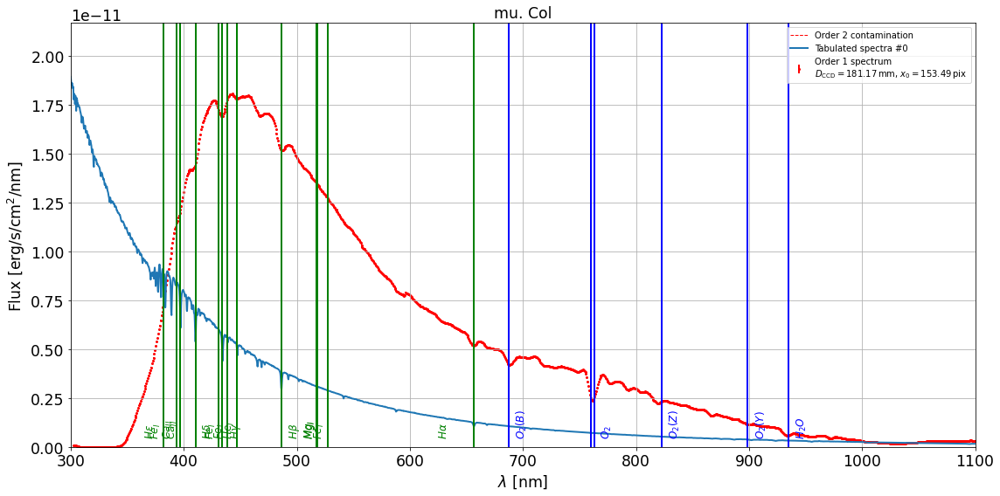

In [48]:
idx=1

fullfilename = all_good_spectra_spectrum_files[idx]
    
filename = os.path.basename(fullfilename)
print(idx,")",filename," ",fullfilename)
    
    
fig=plt.figure(figsize=(16,8))
ax1 = fig.add_subplot(1, 1, 1)
    
filename= os.path.basename(fullfilename)
tag=file_tag_forsorting(filename.split(".")[0])
all_num.append(tag)
    
   
     
s=Spectrum(fullfilename, config=config,fast_load=False)
label=filename.split('.')[0]+" "
#s.plot_spectrum(ax=ax1,force_lines=True,label=label)
s.plot_spectrum(ax=ax1,force_lines=True)
    
plt.show()
    

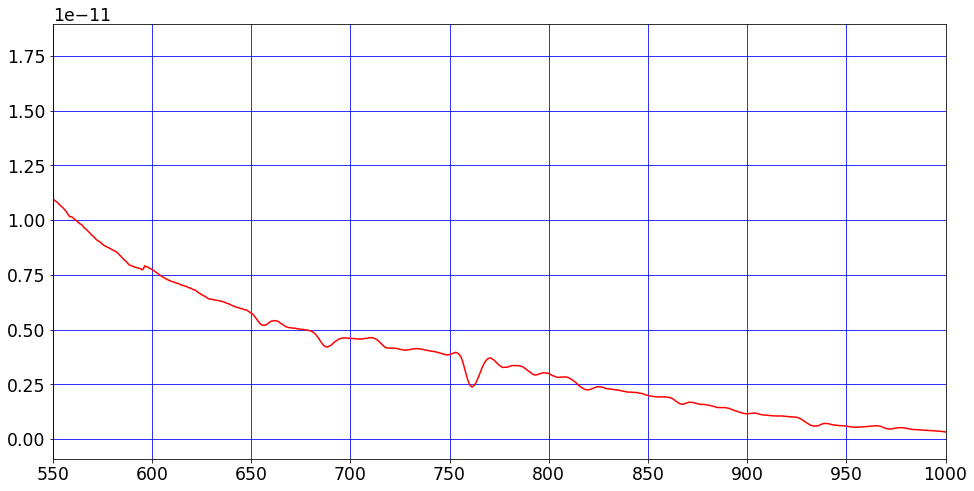

In [49]:
fig=plt.figure(figsize=(16,8))
ax1 = fig.add_subplot(1, 1, 1)
ax1.plot(all_lambdas[idx],all_data[idx],'r-')
ax1.set_xlim(550,1000)
ax1.grid(b=True, which='major', color='b', linestyle='-')
ax1.grid(b=True, which='minor', color='grey', linestyle='-')


## Info

In [50]:
df_infos=pd.DataFrame(infos,columns=["idx","num","object","date_obs","airmass","temperature","pressure","humidity"])

In [51]:
df_infos.set_index('idx',inplace=True)

In [52]:
all_reftime=[ (Time(tt)-Time( df_infos["date_obs"].values[0])).to_value(u.hr) for tt in df_infos["date_obs"].values ]

In [53]:
all_reftime=np.array(all_reftime)

In [54]:
df_infos["reftime"]=all_reftime

In [55]:
df_infos["eqw_h2o"] = np.nan
df_infos["eqw_h2o_2"] = np.nan
df_infos["eqw_h2o_3"] = np.nan
df_infos["eqw_o2"] = np.nan
df_infos["eqw_o2b"] = np.nan
df_infos["eqw_halpha"] = np.nan
df_infos["eqw_hbeta"] = np.nan
df_infos["eqw_hgamma"] = np.nan

#df_infos["eqw_o2_spec"] = np.nan

In [56]:
df_infos

,num,object,date_obs,airmass,temperature,pressure,humidity,reftime,eqw_h2o,eqw_h2o_2,eqw_h2o_3,eqw_o2,eqw_o2b,eqw_halpha,eqw_hbeta,eqw_hgamma
idx,,,,,,,,,,,,,,,,
0,00238,mu. Col,2022-03-18T00:51:22.049,1.115575,8.9,743.45,48.0,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,00244,mu. Col,2022-03-18T00:54:16.312,1.121577,8.9,743.45,49.0,0.048406,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,00245,mu. Col,2022-03-18T00:54:49.235,1.122727,8.8,743.40,49.0,0.057552,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,00251,mu. Col,2022-03-18T00:57:47.565,1.129107,8.9,743.40,50.0,0.107088,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,00252,mu. Col,2022-03-18T00:58:20.709,1.130309,8.9,743.40,50.0,0.116294,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,00265,mu. Col,2022-03-18T01:04:49.716,1.145030,8.9,743.30,53.0,0.224352,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,00272,mu. Col,2022-03-18T01:08:18.080,1.153339,8.9,743.30,51.0,0.282231,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,00273,mu. Col,2022-03-18T01:08:50.992,1.154683,8.9,743.35,51.0,0.291373,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,00279,mu. Col,2022-03-18T01:11:46.031,1.161939,8.9,743.40,53.0,0.339995,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [57]:
NN = len(df_infos)

## Equivalent width

In [58]:
from astropy import units as u
from astropy.visualization import quantity_support

quantity_support()  # for getting units on the axes below  

<astropy.visualization.units.quantity_support.<locals>.MplQuantityConverter at 0x7f979f732310>

In [59]:
from specutils import Spectrum1D
from specutils.fitting import fit_generic_continuum,fit_continuum
from specutils import SpectralRegion
from specutils.analysis import equivalent_width
from astropy.modeling import models
from specutils.manipulation import extract_region

In [60]:
IDXSEL=1
filename_SEL=all_good_spectra_spectrum_files[IDXSEL]
filename_spectrogram_SEL=filename_SEL.replace("_spectrum","_spectrogram")
fullfilename_SEL = os.path.join(dir_spectra,filename_SEL)
fullfilename_spectrogram_SEL = fullfilename_SEL.replace("_spectrum","_spectrogram")
thetitle=str(IDXSEL)+") "+filename_SEL

In [61]:
s=Spectrum(fullfilename_SEL, config=config)
s.load_spectrogram(fullfilename_spectrogram_SEL) 

set date_obs to 2022-03-18T00:54:16.312
set expo to 20.0
set airmass to 1.121576965054115
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1741806116248446
set dec to -32.3064444444444
set hour_angle to 31.60492174100415
set temperature to 8.9
set pressure to 743.45
set humidity to 49.0
set lambda_ref to 626.883564656571
set parallactic_angle to 94.10618686949074
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_46 PM_ERR_MINA_46 PM_ERR_ANGLE_46 Z_VALUE_46 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -------------- --------------- ---------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...          0.095          0.110              90  0.0003640                1


In [62]:
lines = Lines([O2_1,H2O_1,H2O_2],atmospheric_lines=True, redshift=0, emission_spectrum=False)

In [63]:
s.lines = lines

In [64]:
lambdas = np.arange(300,1000,1)
fwhm_func = interp1d(lambdas, 0.01 * lambdas)

In [65]:
#global_chisq = detect_lines(lines, s.lambdas, s.data, s.err, fwhm_func=fwhm_func)

In [66]:
lamb = 10*s.lambdas * u.AA 
flux = s.data * u.Unit('erg cm-2 s-1 AA-1')/10. 
fluxerr = s.err * u.Unit('erg cm-2 s-1 AA-1')/10. 
spec = Spectrum1D(spectral_axis=lamb, flux=flux)
specerr = Spectrum1D(spectral_axis=lamb, flux=fluxerr)

In [67]:
def ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=None,ax2=None):
    """
    """
       # line central position        
    wlline0 = np.average([wlminline.value,wlmaxline.value])
    
    # region used to fit bacgroud        
    sub_region = SpectralRegion(wlmin , wlmax)
    # line region to remove background
    line_region = SpectralRegion(wlminline , wlmaxline)
    
    # region where one extract the spectrum
    sub_spectrum = extract_region(spec, sub_region)
    
    # initialisaition of linear model
    g_init = models.Linear1D(slope=0,intercept=1e-12)
    
    # fit on sub-spectrum
    g1_fit = fit_generic_continuum(sub_spectrum,model=g_init,exclude_regions=[line_region])
    # fit by keeping the whole spectrum , but fitting on hte relevant part of the spectrum
    g2_fit = fit_continuum(spec,model=g_init,window=sub_region,exclude_regions=[line_region])
    
    
    y_continuum_fitted1 = g1_fit(sub_spectrum.spectral_axis)
    y_continuum_fitted2 = g2_fit(spec.spectral_axis)
    
    # normalize the spectrum
    cont_norm_spec = spec/ y_continuum_fitted2 
    
    
    # work with inset
    idx_inset0 = np.where(np.logical_and(spec.spectral_axis>wlminline , spec.spectral_axis<wlmaxline))[0]
    idx_inset1 = np.where(np.logical_and(spec.spectral_axis>wlmin , spec.spectral_axis<wlmax))[0]
    
    
    wl_inset0 = spec.spectral_axis[idx_inset0]
    wl_inset1 = spec.spectral_axis[idx_inset1]
    
    fluxratio_inset0 = 1-cont_norm_spec.flux[idx_inset0]
    fluxratio_inset1 = 1-cont_norm_spec.flux[idx_inset1]
    
    # compute equivalent width by integration of (1-fluxratio(wl)) dwl
    eqw3 = np.trapz(fluxratio_inset0,wl_inset0)
    
    
    eqw1=equivalent_width(cont_norm_spec, regions=line_region) 
    eqw2=equivalent_width(cont_norm_spec, regions=sub_region)  
    
    
    if flag_plot:
        
        YMIN=spec.flux.min()
        YMAX=1.2*spec.flux.max()
        
        eqw_str1="$Eqw_1$ = {:2.2f} $\AA$ ".format(eqw1.value)
        eqw_str2="$Eqw_2$ = {:2.2f} $\AA$ ".format(eqw2.value)
        eqw_str3="$Eqw_3$ = {:2.2f} $\AA$ ".format(eqw3.value)
    
    
        eqw_str='\n'.join((
        r'{}'.format(eqw_str1),
        r'{}'.format(eqw_str2),
        r'{}'.format(eqw_str3)))
        
        if ax1==None: 
            f, ax1 = plt.subplots(figsize=(8,4))
            
        ax1.plot(spec.spectral_axis, spec.flux,'k-')  
        ax1.plot(sub_spectrum.spectral_axis, y_continuum_fitted1,'r-.',label="fit region")  
        ax1.plot(spec.spectral_axis, y_continuum_fitted2,'b:',label="extrapolated fit continuum")  
        ax1.set_title("Local continuum fitting")  
        ax1.grid(True)  
        ax1.legend()
        ax1.axvline(wlminline,color='r')
        ax1.axvline(wlmaxline,color="r")
        ax1.axvline(wlmin,color='g')
        ax1.axvline(wlmax,color="g")
        ax1.set_ylim(YMIN,YMAX)
        
        
        if ax2==None:
            f, ax2 = plt.subplots(figsize=(8,4)) 
            
            
        ax2.plot(spec.spectral_axis, cont_norm_spec.flux,'k-')  
        ax2.set_title("Equivalent width")  
        ax2.grid(True)  
        ax2.legend()
        ax2.axvline(wlminline,color='r')
        ax2.axvline(wlmaxline,color="r")
        ax2.axvline(wlmin,color='g')
        ax2.axvline(wlmax,color="g")
        ax2.set_ylim(0,2)
        if wlline0 > 7000:
            ax2.text(0.05, 0.3, eqw_str, transform=ax2.transAxes, fontsize=12,verticalalignment='top', bbox=props)
        else:
            ax2.text(0.55, 0.3, eqw_str, transform=ax2.transAxes, fontsize=12,verticalalignment='top', bbox=props)
                    
        
        # plot insert  on right figure
        if wlline0 > 7000:
            loc=2
        else:
            loc=1
        
        axins = inset_axes(ax2,
                    width="42%", # width = 30% of parent_bbox
                    height="42%", # height : 1 inch
                    loc=loc)
        axins.plot(spec.spectral_axis[idx_inset1], cont_norm_spec.flux[idx_inset1],'b-')
        axins.plot(spec.spectral_axis[idx_inset0], cont_norm_spec.flux[idx_inset0],'r-o')
        
        #axins.plot(wl_inset1, fluxratio_inset1,'b-')
        #axins.plot(wl_inset0, fluxratio_inset0,'r-o')
            
        
        axins.grid()
        
        
        
        # plot insert  on right figure
        if wlline0 > 7000:
            loc=3
        else:
            loc=4
        
        axins1 = inset_axes(ax1,
                    width="30%", # width = 30% of parent_bbox
                    height="30%", # height : 1 inch
                    loc=loc)
        axins1.plot(spec.spectral_axis[idx_inset1], cont_norm_spec.flux[idx_inset1],'b-')
        axins1.plot(spec.spectral_axis[idx_inset0], cont_norm_spec.flux[idx_inset0],'r-o')
        
        #axins.plot(wl_inset1, fluxratio_inset1,'b-')
        #axins.plot(wl_inset0, fluxratio_inset0,'r-o')
            
        
        axins1.grid()
        
        
        
        
        
        
        
        
    return eqw1.value,eqw2.value,eqw3.value     

    

In [68]:
def ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=None,ax2=None):
    """
    
    ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True)
    
    - input :
    
    
    - output :
    
    """
    # line central position        
    wlline0 = np.average([wlminline.value,wlmaxline.value])
    
    # region used to fit bacgroud        
    sub_region = SpectralRegion(wlmin , wlmax)
    # line region to remove background
    line_region = SpectralRegion(wlminline , wlmaxline)
    
    # region where one extract the spectrum
    sub_spectrum = extract_region(spec, sub_region)
    
    # initialisaition of linear model
    g_init = models.Linear1D(slope=0,intercept=1e-12)
    
    # fit on sub-spectrum
    g1_fit = fit_generic_continuum(sub_spectrum,model=g_init,exclude_regions=[line_region])
    # fit by keeping the whole spectrum , but fitting on hte relevant part of the spectrum
    g2_fit = fit_continuum(spec,model=g_init,window=sub_region,exclude_regions=[line_region])
    
    
    y_continuum_fitted1 = g1_fit(sub_spectrum.spectral_axis)
    y_continuum_fitted2 = g2_fit(spec.spectral_axis)
    
    # normalize the spectrum
    cont_norm_spec = spec/ y_continuum_fitted2 
    
    eqw1=equivalent_width(cont_norm_spec, regions=line_region) 
    eqw2=equivalent_width(cont_norm_spec, regions=sub_region)  
    
    
    if flag_plot:
        
        YMIN=spec.flux.min()
        YMAX=1.2*spec.flux.max()
        
        eqw_str1="$Eqw_1$ = {:2.2f} $\AA$ ".format(eqw1.value)
        eqw_str2="$Eqw_2$ = {:2.2f} $\AA$ ".format(eqw2.value)
    
    
        eqw_str='\n'.join((
        r'{}'.format(eqw_str1),
        r'{}'.format(eqw_str2)))
        
        if ax1==None: 
            f, ax1 = plt.subplots(figsize=(8,4))
            
        ax1.plot(spec.spectral_axis, spec.flux,'k-')  
        ax1.plot(sub_spectrum.spectral_axis, y_continuum_fitted1,'r-.',label="fit region")  
        ax1.plot(spec.spectral_axis, y_continuum_fitted2,'b:',label="extrapolated fit continuum")  
        ax1.set_title("Local continuum fitting")  
        ax1.grid(True)  
        ax1.legend()
        ax1.axvline(wlminline,color='r')
        ax1.axvline(wlmaxline,color="r")
        ax1.axvline(wlmin,color='g')
        ax1.axvline(wlmax,color="g")
        ax1.set_ylim(YMIN,YMAX)
        
        
        if ax2==None:
            f, ax2 = plt.subplots(figsize=(8,4)) 
            
            
        ax2.plot(spec.spectral_axis, cont_norm_spec.flux,'k-')  
        ax2.set_title("Equivalent width")  
        ax2.grid(True)  
        ax2.legend()
        ax2.axvline(wlminline,color='r')
        ax2.axvline(wlmaxline,color="r")
        ax2.axvline(wlmin,color='g')
        ax2.axvline(wlmax,color="g")
        ax2.set_ylim(0,2)
        if wlline0 > 7000:
            ax2.text(0.05, 0.3, eqw_str, transform=ax2.transAxes, fontsize=12,verticalalignment='top', bbox=props)
        else:
            ax2.text(0.55, 0.3, eqw_str, transform=ax2.transAxes, fontsize=12,verticalalignment='top', bbox=props)
            
            
        idx_inset0 = np.where(np.logical_and(spec.spectral_axis>wlminline , spec.spectral_axis<wlmaxline))[0]
        idx_inset1 = np.where(np.logical_and(spec.spectral_axis>wlmin , spec.spectral_axis<wlmax))[0]
        
       
        if wlline0 > 7000:
            loc=4
        else:
            loc=2
        
        axins = inset_axes(ax2,
                    width="42%", # width = 30% of parent_bbox
                    height="42%", # height : 1 inch
                    loc=loc)
        axins.plot(spec.spectral_axis[idx_inset1], cont_norm_spec.flux[idx_inset1],'b-')
        axins.plot(spec.spectral_axis[idx_inset0], cont_norm_spec.flux[idx_inset0],'r-o')
        axins.grid()
        
        
    return eqw1.value,eqw2.value     


In [69]:
def ComputeMyEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=20,flag_plot=True,ax1=None,ax2=None):
    """
    
    ComputeEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline)
    
    - input :
    
    
    - output :
    
    """
    
    # line central position        
    wlline0 = np.average([wlminline.value,wlmaxline.value])
    
    # region used to fit bacgroud        
    sub_region = SpectralRegion(wlmin , wlmax)
    # line region to remove background
    line_region = SpectralRegion(wlminline , wlmaxline)
         
    
    # region used to fit bacgroud        
    sub_region = SpectralRegion(wlmin , wlmax)
    # line region to remove background
    line_region = SpectralRegion(wlminline , wlmaxline)
    
    # region where one extract the spectrum
    sub_spectrum = extract_region(spec, sub_region)
    
    # initialisaition of linear model
    g_init = models.Linear1D(slope=0,intercept=1e-12)
    
    # fit on sub-spectrum
    g1_fit = fit_generic_continuum(sub_spectrum,model=g_init,exclude_regions=[line_region])
    # fit by keeping the whole spectrum , but fitting on hte relevant part of the spectrum
    g2_fit = fit_continuum(spec,model=g_init,window=sub_region,exclude_regions=[line_region])
    
    
    y_continuum_fitted1 = g1_fit(sub_spectrum.spectral_axis)
    y_continuum_fitted2 = g2_fit(spec.spectral_axis)
    
    # normalize the spectrum
    cont_norm_spec = spec/ y_continuum_fitted2 
       
    eqw10=equivalent_width(cont_norm_spec, regions=line_region).value 
    eqw20=equivalent_width(cont_norm_spec, regions=sub_region).value 
    
    
    
    
    # work with inset
    idx_inset0 = np.where(np.logical_and(spec.spectral_axis>wlminline , spec.spectral_axis<wlmaxline))[0]
    idx_inset1 = np.where(np.logical_and(spec.spectral_axis>wlmin , spec.spectral_axis<wlmax))[0]
    
    
    wl_inset0 = spec.spectral_axis[idx_inset0]
    wl_inset1 = spec.spectral_axis[idx_inset1]
    
    fluxratio_inset0 = 1-cont_norm_spec.flux[idx_inset0]
    fluxratio_inset1 = 1-cont_norm_spec.flux[idx_inset1]
    
    # compute equivalent width by integration of (1-fluxratio(wl)) dwl
    eqw30 = np.trapz(fluxratio_inset0,wl_inset0)
    
    
    
       
    # Bootstrap
    
    
    eqw1_set=np.zeros(NN)
    eqw2_set=np.zeros(NN)
    eqw3_set=np.zeros(NN)
    
    
    size=len(specerr.flux)
    
    # loop on trials 
    for idx in np.arange(NN):
        
        # random generator for errors
        s = np.random.normal(0, 1, size)
        
        # new flux
        newspec = Spectrum1D(spectral_axis=spec.spectral_axis, flux=spec.flux+specerr.flux*s)
              
    
        # region where one extract the spectrum
        sub_spectrum = extract_region(newspec, sub_region)
    
        # initialisaition of linear model
        g_init = models.Linear1D(slope=0,intercept=1e-12)
    
        # fit on sub-spectrum
        g1_fit = fit_generic_continuum(sub_spectrum,model=g_init,exclude_regions=[line_region])
        # fit by keeping the whole spectrum , but fitting on hte relevant part of the spectrum
        g2_fit = fit_continuum(newspec,model=g_init,window=sub_region,exclude_regions=[line_region])
    
    
        y_continuum_fitted1 = g1_fit(sub_spectrum.spectral_axis)
        y_continuum_fitted2 = g2_fit(newspec.spectral_axis)
    
        # normalize the spectrum
        cont_norm_spec = newspec/ y_continuum_fitted2 
    
    
        eqw1_b=equivalent_width(cont_norm_spec, regions=line_region) 
        eqw2_b=equivalent_width(cont_norm_spec, regions=sub_region) 
        
        
        eqw1_set[idx]=eqw1_b.value
        eqw2_set[idx]=eqw2_b.value
        
        # work with inset
        idx_inset0 = np.where(np.logical_and(newspec.spectral_axis>wlminline , newspec.spectral_axis<wlmaxline))[0]
        idx_inset1 = np.where(np.logical_and(newspec.spectral_axis>wlmin , newspec.spectral_axis<wlmax))[0]
    
    
        wl_inset0 = newspec.spectral_axis[idx_inset0]
        wl_inset1 = newspec.spectral_axis[idx_inset1]
    
        fluxratio_inset0 = 1-cont_norm_spec.flux[idx_inset0]
        fluxratio_inset1 = 1-cont_norm_spec.flux[idx_inset1]
    
        # compute equivalent width by integration of (1-fluxratio(wl)) dwl
        eqw3_b = np.trapz(fluxratio_inset0,wl_inset0)
        eqw3_set[idx]=eqw3_b.value
        
     
    eqw1_std=eqw1_set.std()
    eqw2_std=eqw2_set.std()
    eqw3_std=eqw3_set.std()
    
    
    if flag_plot:
        
        YMIN=spec.flux.min()
        YMAX=1.2*spec.flux.max()
        
        eqw_str1="$Eqw_1$ = {:2.2f} $\pm$ {:2.2f} $\AA$ ".format(eqw10,eqw1_std)
        eqw_str2="$Eqw_2$ = {:2.2f} $\pm$ {:2.2f} $\AA$ ".format(eqw20,eqw2_std)
        eqw_str3="$Eqw_3$ = {:2.2f} $\pm$ {:2.2f} $\AA$ ".format(eqw30,eqw3_std)
    
    
        eqw_str='\n'.join((
        r'{}'.format(eqw_str1),
        r'{}'.format(eqw_str2),
        r'{}'.format(eqw_str3)))
        
        if ax1==None: 
            f, ax1 = plt.subplots(figsize=(8,4))
            
        ax1.plot(spec.spectral_axis, spec.flux,'k-')  
        ax1.plot(sub_spectrum.spectral_axis, y_continuum_fitted1,'r-.',label="fit region")  
        ax1.plot(spec.spectral_axis, y_continuum_fitted2,'b:',label="extrapolated fit continuum")  
        ax1.set_title("Local continuum fitting")  
        ax1.grid(True)  
        ax1.legend()
        ax1.axvline(wlminline,color='r')
        ax1.axvline(wlmaxline,color="r")
        ax1.axvline(wlmin,color='g')
        ax1.axvline(wlmax,color="g")
        ax1.set_ylim(YMIN,YMAX)
        
        
        if ax2==None:
            f, ax2 = plt.subplots(figsize=(8,4)) 
            
            
        ax2.plot(spec.spectral_axis, cont_norm_spec.flux,'k-')  
        ax2.set_title("Equivalent width")  
        ax2.grid(True)  
        ax2.legend()
        ax2.axvline(wlminline,color='r')
        ax2.axvline(wlmaxline,color="r")
        ax2.axvline(wlmin,color='g')
        ax2.axvline(wlmax,color="g")
        ax2.set_ylim(0,2)
        
        if wlline0 > 7000:
            ax2.text(0.05, 0.3, eqw_str, transform=ax2.transAxes, fontsize=12,verticalalignment='top', bbox=props)
        else:
            ax2.text(0.55, 0.3, eqw_str, transform=ax2.transAxes, fontsize=12,verticalalignment='top', bbox=props)
        
        
               
        
    return eqw10,eqw20,eqw30,eqw1_set,eqw2_set,eqw3_set      


In [70]:
def ComputeEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=20,flag_plot=True,ax1=None,ax2=None):
    """
    
    ComputeMyEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline)
    
    - input :
    
    
    - output :
    
    """
    
    # line central position        
    wlline0 = np.average([wlminline.value,wlmaxline.value])
    
    # region used to fit bacgroud        
    sub_region = SpectralRegion(wlmin , wlmax)
    # line region to remove background
    line_region = SpectralRegion(wlminline , wlmaxline)
         
    
    # region used to fit bacgroud        
    sub_region = SpectralRegion(wlmin , wlmax)
    # line region to remove background
    line_region = SpectralRegion(wlminline , wlmaxline)
    
    # region where one extract the spectrum
    sub_spectrum = extract_region(spec, sub_region)
    
    # initialisaition of linear model
    g_init = models.Linear1D(slope=0,intercept=1e-12)
    
    # fit on sub-spectrum
    g1_fit = fit_generic_continuum(sub_spectrum,model=g_init,exclude_regions=[line_region])
    # fit by keeping the whole spectrum , but fitting on hte relevant part of the spectrum
    g2_fit = fit_continuum(spec,model=g_init,window=sub_region,exclude_regions=[line_region])
    
    
    y_continuum_fitted1 = g1_fit(sub_spectrum.spectral_axis)
    y_continuum_fitted2 = g2_fit(spec.spectral_axis)
    
    # normalize the spectrum
    cont_norm_spec = spec/ y_continuum_fitted2 
       
    eqw10=equivalent_width(cont_norm_spec, regions=line_region).value 
    eqw20=equivalent_width(cont_norm_spec, regions=sub_region).value 
       
    # Bootstrap
    
    
    eqw1_set=np.zeros(NN)
    eqw2_set=np.zeros(NN)
    size=len(specerr.flux)
    
    # loop on trials 
    for idx in np.arange(NN):
        
        # random generator for errors
        s = np.random.normal(0, 1, size)
        
        # new flux
        newspec = Spectrum1D(spectral_axis=spec.spectral_axis, flux=spec.flux+specerr.flux*s)
              
    
        # region where one extract the spectrum
        sub_spectrum = extract_region(newspec, sub_region)
    
        # initialisaition of linear model
        g_init = models.Linear1D(slope=0,intercept=1e-12)
    
        # fit on sub-spectrum
        g1_fit = fit_generic_continuum(sub_spectrum,model=g_init,exclude_regions=[line_region])
        # fit by keeping the whole spectrum , but fitting on hte relevant part of the spectrum
        g2_fit = fit_continuum(newspec,model=g_init,window=sub_region,exclude_regions=[line_region])
    
    
        y_continuum_fitted1 = g1_fit(sub_spectrum.spectral_axis)
        y_continuum_fitted2 = g2_fit(newspec.spectral_axis)
    
        # normalize the spectrum
        cont_norm_spec = newspec/ y_continuum_fitted2 
    
    
        eqw1_b=equivalent_width(cont_norm_spec, regions=line_region) 
        eqw2_b=equivalent_width(cont_norm_spec, regions=sub_region) 
        
        
        eqw1_set[idx]=eqw1_b.value
        eqw2_set[idx]=eqw2_b.value
        
     
    eqw1_std=eqw1_set.std()
    eqw2_std=eqw2_set.std()
    
    
    if flag_plot:
        
        YMIN=spec.flux.min()
        YMAX=1.2*spec.flux.max()
        
        eqw_str1="$Eqw_1$ = {:2.2f} $\pm$ {:2.2f} $\AA$ ".format(eqw10,eqw1_std)
        eqw_str2="$Eqw_2$ = {:2.2f} $\pm$ {:2.2f} $\AA$ ".format(eqw20,eqw2_std)
    
    
        eqw_str='\n'.join((
        r'{}'.format(eqw_str1),
        r'{}'.format(eqw_str2)))
        
        if ax1==None: 
            f, ax1 = plt.subplots(figsize=(8,4))
            
        ax1.plot(spec.spectral_axis, spec.flux,'k-')  
        ax1.plot(sub_spectrum.spectral_axis, y_continuum_fitted1,'r-.',label="fit region")  
        ax1.plot(spec.spectral_axis, y_continuum_fitted2,'b:',label="extrapolated fit continuum")  
        ax1.set_title("Local continuum fitting")  
        ax1.grid(True)  
        ax1.legend()
        ax1.axvline(wlminline,color='r')
        ax1.axvline(wlmaxline,color="r")
        ax1.axvline(wlmin,color='g')
        ax1.axvline(wlmax,color="g")
        ax1.set_ylim(YMIN,YMAX)
        
        
        if ax2==None:
            f, ax2 = plt.subplots(figsize=(8,4)) 
            
            
        ax2.plot(spec.spectral_axis, cont_norm_spec.flux,'k-')  
        ax2.set_title("Equivalent width")  
        ax2.grid(True)  
        ax2.legend()
        ax2.axvline(wlminline,color='r')
        ax2.axvline(wlmaxline,color="r")
        ax2.axvline(wlmin,color='g')
        ax2.axvline(wlmax,color="g")
        ax2.set_ylim(0,2)
        
        if wlline0 > 7000:
            ax2.text(0.05, 0.3, eqw_str, transform=ax2.transAxes, fontsize=12,verticalalignment='top', bbox=props)
        else:
            ax2.text(0.55, 0.3, eqw_str, transform=ax2.transAxes, fontsize=12,verticalalignment='top', bbox=props)
        
        if wlline0 > 7000:
            loc=2
        else:
            loc=1
            
        idx_inset0 = np.where(np.logical_and(spec.spectral_axis>wlminline , spec.spectral_axis<wlmaxline))[0]
        idx_inset1 = np.where(np.logical_and(spec.spectral_axis>wlmin , spec.spectral_axis<wlmax))[0]
        
        axins = inset_axes(ax2,
                    width="42%", # width = 30% of parent_bbox
                    height="42%", # height : 1 inch
                    loc=loc)
        axins.plot(spec.spectral_axis[idx_inset1], cont_norm_spec.flux[idx_inset1],'b-')
        axins.plot(spec.spectral_axis[idx_inset0], cont_norm_spec.flux[idx_inset0],'r-o')
        axins.grid()
     
               
        
    return eqw10,eqw20,eqw1_set,eqw2_set     


## Setup boundaries for equivalent width

### O2 line

In [71]:
wlmin=10*(O2_1.wavelength-30)*u.AA
wlmax=10*(O2_1.wavelength+30)*u.AA
wlminline=10*(O2_1.wavelength-7)*u.AA
wlmaxline=10*(O2_1.wavelength+9)*u.AA

In [72]:
wlmin_o2 = wlmin
wlmax_o2 = wlmax
wlminline_o2 = wlminline
wlmaxline_o2 = wlmaxline

2022-04-09 19:06:16  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

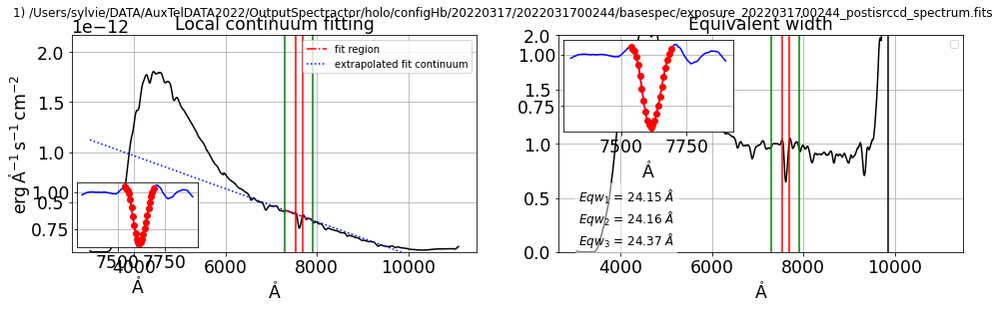

In [73]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
#eq1,eq2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
eq1,eq2,eq3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

2022-04-09 19:06:17  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

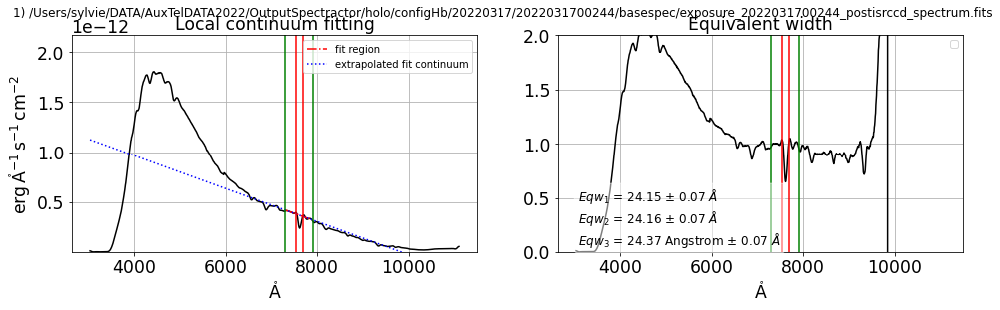

In [74]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
eqw10,eqw20,eqw30,eq1_set,eq2_set,eq3_set=ComputeMyEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=30,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

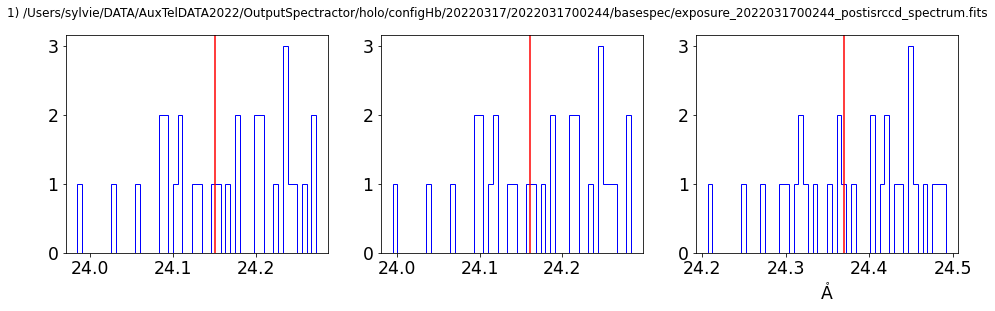

In [75]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 3, 1)
ax1.hist(eq1_set,bins=50,histtype='step',color='b');
ax1.axvline(eqw10,color='r')
ax2 = fig.add_subplot(1, 3, 2)
ax2.hist(eq2_set,bins=50,histtype='step',color="b");
ax2.axvline(eqw20,color='r')
ax3 = fig.add_subplot(1, 3, 3)
ax3.hist(eq3_set,bins=50,histtype='step',color="b");
ax3.axvline(eqw30,color='r')
plt.suptitle(thetitle)

In [76]:
eqw_o2_err=eq3_set.std()
eqw_o2_err

0.07347747728382382

### O2B Line

In [77]:
wlmin=10*(O2B.wavelength-30)*u.AA
wlmax=10*(O2B.wavelength+30)*u.AA
wlminline=10*(O2B.wavelength-7)*u.AA
wlmaxline=10*(O2B.wavelength+9)*u.AA

In [78]:
wlmin_o2b = wlmin
wlmax_o2b = wlmax
wlminline_o2b = wlminline
wlmaxline_o2b = wlmaxline

2022-04-09 19:06:39  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

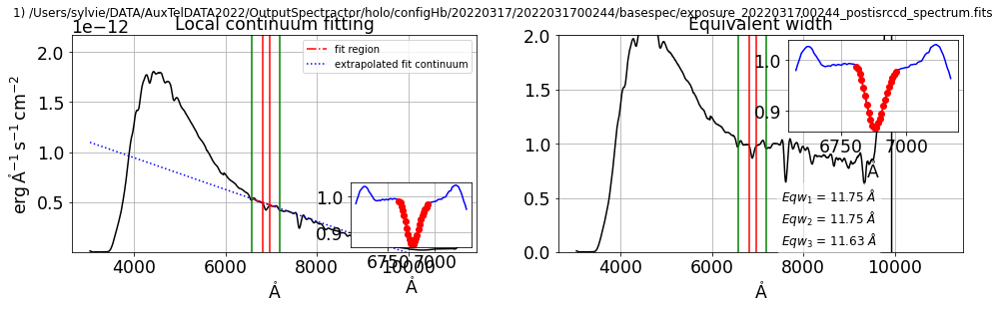

In [79]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
#eq1,eq2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
eq1,eq2,eq3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

2022-04-09 19:06:40  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

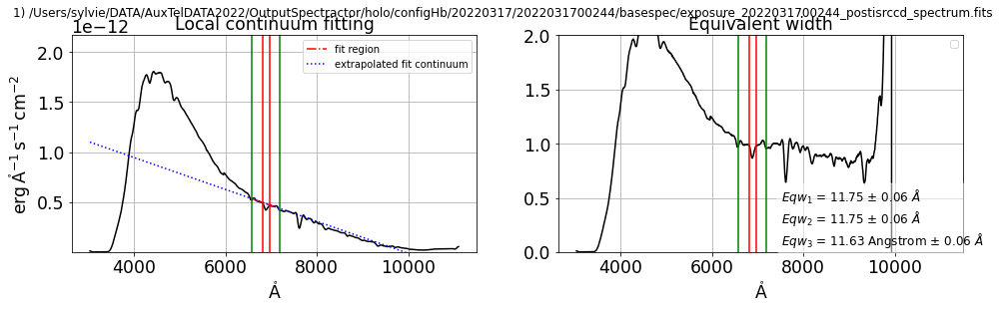

In [80]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
eqw10,eqw20,eqw30,eq1_set,eq2_set,eq3_set=ComputeMyEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=30,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

In [81]:
eqw_o2b_err=eq3_set.std()
eqw_o2b_err

0.055828835709935944

### H2O line

In [82]:
wlmin=10*(H2O_1.wavelength-30)*u.AA
wlmax=10*(H2O_2.wavelength+58)*u.AA
wlminline=10*(H2O_1.wavelength-12)*u.AA
wlmaxline=10*(H2O_2.wavelength+50)*u.AA

In [83]:
wlmin_h2o = wlmin
wlmax_h2o = wlmax
wlminline_h2o = wlminline
wlmaxline_h2o = wlmaxline

In [84]:
lamb = 10*s.lambdas * u.AA 
flux = s.data * u.Unit('erg cm-2 s-1 AA-1')/10. 
fluxerr = s.err * u.Unit('erg cm-2 s-1 AA-1')/10. 
spec = Spectrum1D(spectral_axis=lamb, flux=flux)
specerr = Spectrum1D(spectral_axis=lamb, flux=fluxerr)

2022-04-09 19:07:03  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

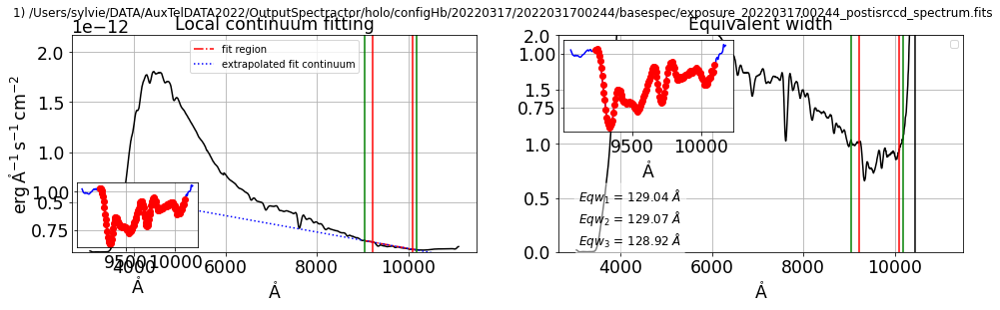

In [85]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
#ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
eq1,eq2,eq3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

2022-04-09 19:07:04  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

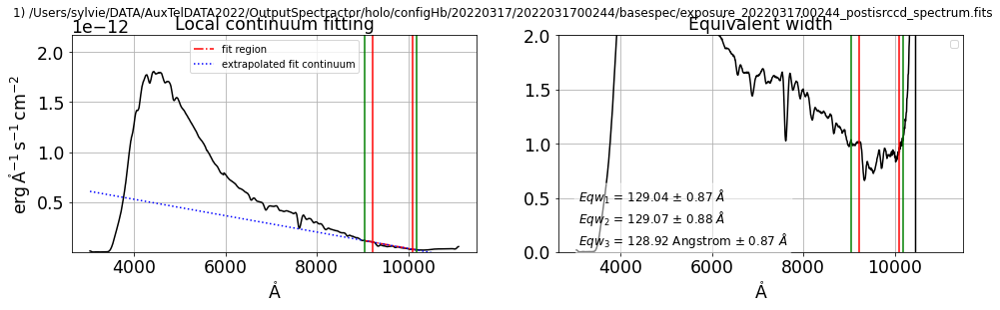

In [86]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
eqw10,eqw20,eqw30,eq1_set,eq2_set,eq3_set=ComputeMyEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=30,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

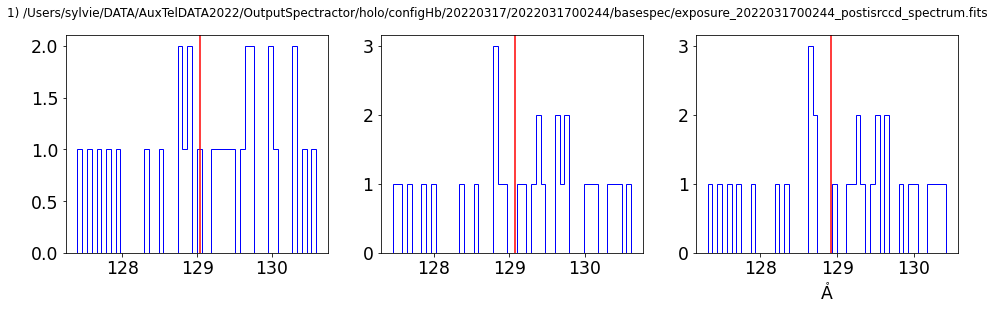

In [87]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 3, 1)
ax1.hist(eq1_set,bins=50,histtype='step',color='b');
ax1.axvline(eqw10,color='r')
ax2 = fig.add_subplot(1, 3, 2)
ax2.hist(eq2_set,bins=50,histtype='step',color='b');
ax2.axvline(eqw20,color='r')
ax3 = fig.add_subplot(1, 3, 3)
ax3.hist(eq3_set,bins=50,histtype='step',color='b');
ax3.axvline(eqw30,color='r')
plt.suptitle(thetitle)

In [88]:
eqw_h2o_err=eq3_set.std()
eqw_h2o_err

0.8675740021806201

## Other H2O lines

### H2O(730)

In [89]:
H2O_3 = Line(730, atmospheric=True, label=r'$H_2O_3$', label_pos=[0.007, 0.02],width_bounds=[5, 30])  # libradtran paper fig.3, broad line

In [90]:
wlmin=10*(H2O_3.wavelength-22)*u.AA
wlmax=10*(H2O_3.wavelength+20)*u.AA
wlminline=10*(H2O_3.wavelength-17)*u.AA
wlmaxline=10*(H2O_3.wavelength+10)*u.AA

In [91]:
wlmin_h2o_2 = wlmin
wlmax_h2o_2 = wlmax
wlminline_h2o_2 = wlminline
wlmaxline_h2o_2 = wlmaxline

In [92]:
lamb = 10*s.lambdas * u.AA 
flux = s.data * u.Unit('erg cm-2 s-1 AA-1')/10. 
fluxerr = s.err * u.Unit('erg cm-2 s-1 AA-1')/10. 
spec = Spectrum1D(spectral_axis=lamb, flux=flux)
specerr = Spectrum1D(spectral_axis=lamb, flux=fluxerr)

2022-04-09 19:07:25  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

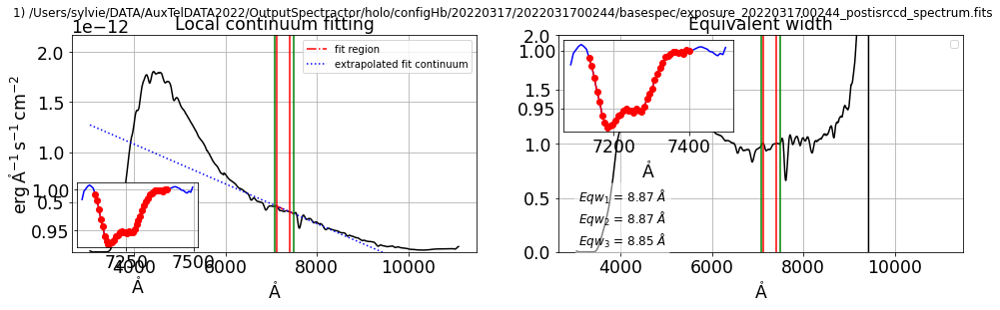

In [93]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
eq1,eq2,eq3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)


2022-04-09 19:07:26  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

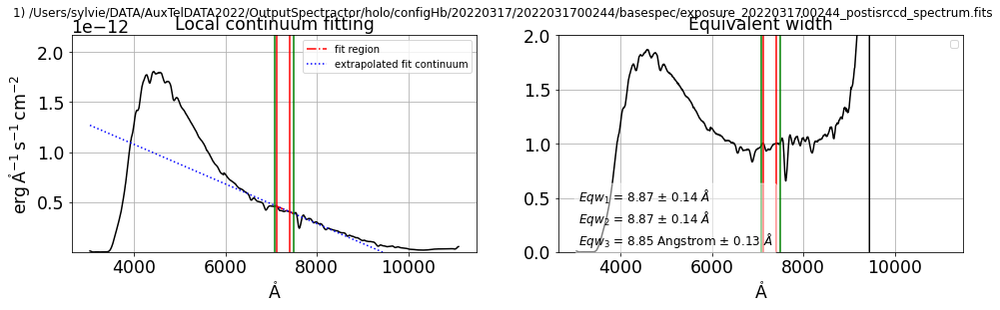

In [94]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
eqw10,eqw20,eqw30,eq1_set,eq2_set,eq3_set=ComputeMyEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=30,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

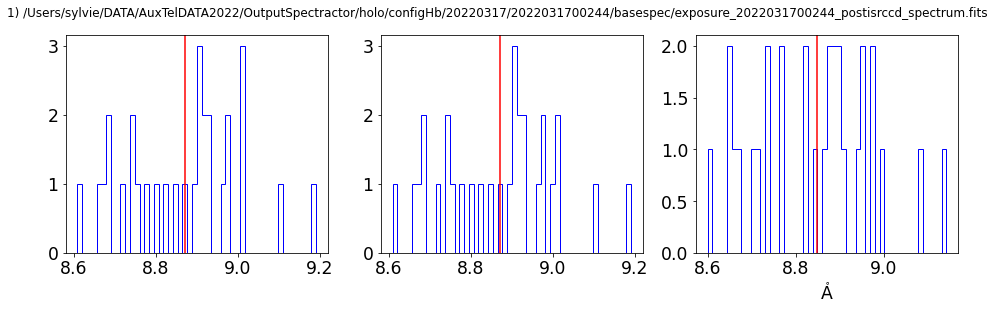

In [95]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 3, 1)
ax1.hist(eq1_set,bins=50,histtype='step',color='b');
ax1.axvline(eqw10,color='r')
ax2 = fig.add_subplot(1, 3, 2)
ax2.hist(eq2_set,bins=50,histtype='step',color="b");
ax2.axvline(eqw20,color='r')
ax3 = fig.add_subplot(1, 3, 3)
ax3.hist(eq3_set,bins=50,histtype='step',color="b");
ax3.axvline(eqw30,color='r')
plt.suptitle(thetitle)

In [96]:
eqw_h2o_2_err=eq3_set.std()
eqw_h2o_2_err

0.13220635389437563

### H2O(820)

In [97]:
H2O_4 = Line(820, atmospheric=True, label=r'$H_2O_4$', label_pos=[0.007, 0.02],width_bounds=[5, 30])  # libradtran paper fig.3, broad line

In [98]:
wlmin=10*(H2O_4.wavelength-20)*u.AA
wlmax=10*(H2O_4.wavelength+35)*u.AA
wlminline=10*(H2O_4.wavelength-10)*u.AA
wlmaxline=10*(H2O_4.wavelength+25)*u.AA

In [99]:
wlmin_h2o_3 = wlmin
wlmax_h2o_3 = wlmax
wlminline_h2o_3 = wlminline
wlmaxline_h2o_3 = wlmaxline

In [100]:
lamb = 10*s.lambdas * u.AA 
flux = s.data * u.Unit('erg cm-2 s-1 AA-1')/10. 
fluxerr = s.err * u.Unit('erg cm-2 s-1 AA-1')/10. 
spec = Spectrum1D(spectral_axis=lamb, flux=flux)
specerr = Spectrum1D(spectral_axis=lamb, flux=fluxerr)

2022-04-09 19:07:49  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

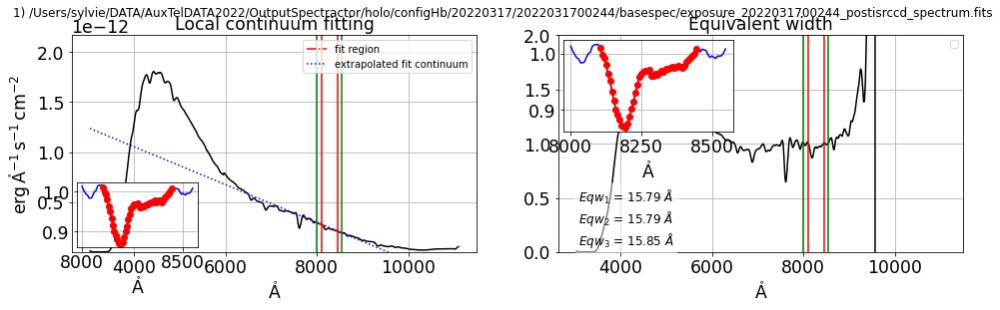

In [101]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
eq1,eq2,eq3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

2022-04-09 19:07:50  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

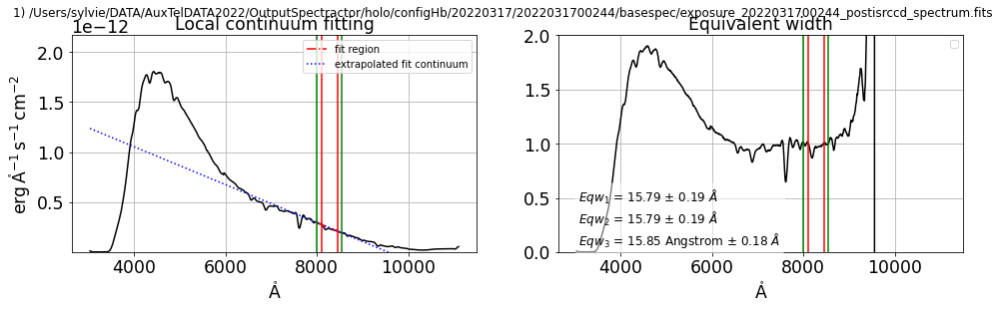

In [102]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
eqw10,eqw20,eqw30,eq1_set,eq2_set,eq3_set=ComputeMyEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=30,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

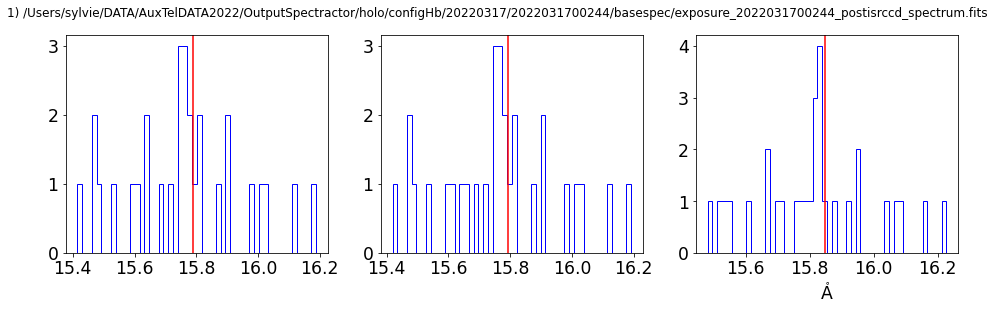

In [103]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 3, 1)
ax1.hist(eq1_set,bins=50,histtype='step',color='b');
ax1.axvline(eqw10,color='r')
ax2 = fig.add_subplot(1, 3, 2)
ax2.hist(eq2_set,bins=50,histtype='step',color="b");
ax2.axvline(eqw20,color='r')
ax3 = fig.add_subplot(1, 3, 3)
ax3.hist(eq3_set,bins=50,histtype='step',color="b");
ax3.axvline(eqw30,color='r')
plt.suptitle(thetitle)

In [104]:
eqw_h2o_3_err=eq3_set.std()
eqw_h2o_3_err

0.18360874228233062

### HALPHA

In [105]:
wlmin=10*(HALPHA.wavelength-30)*u.AA
wlmax=10*(HALPHA.wavelength+30)*u.AA
wlminline=10*(HALPHA.wavelength-10)*u.AA
wlmaxline=10*(HALPHA.wavelength+10)*u.AA

In [106]:
wlmin_halpha = wlmin
wlmax_halpha = wlmax
wlminline_halpha = wlminline
wlmaxline_halpha = wlmaxline

2022-04-09 19:08:14  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

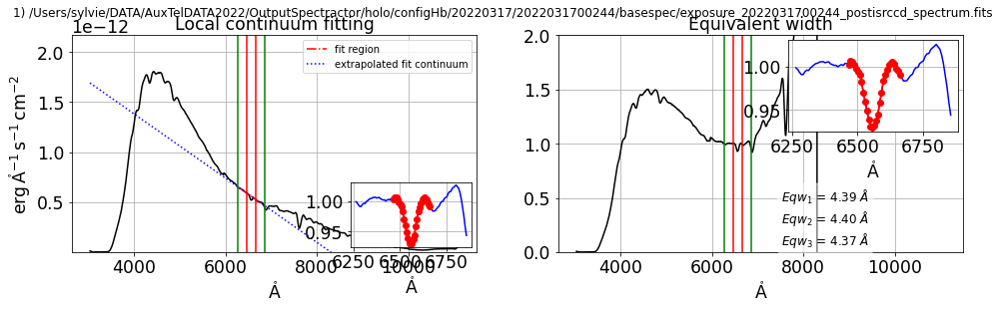

In [107]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
#eq1,eq2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
eq1,eq2,eq3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

2022-04-09 19:08:15  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

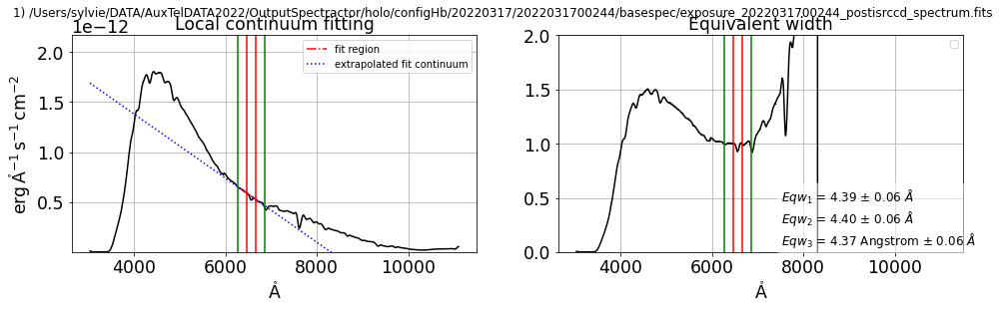

In [108]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
eqw10,eqw20,eqw30,eq1_set,eq2_set,eq3_set=ComputeMyEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=30,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

In [109]:
eqw_halpha_err=eq3_set.std()
eqw_halpha_err

0.060604336144928675

### HBETA

In [110]:
wlmin=10*(HBETA.wavelength-35)*u.AA
wlmax=10*(HBETA.wavelength+30)*u.AA
wlminline=10*(HBETA.wavelength-7)*u.AA
wlmaxline=10*(HBETA.wavelength+7)*u.AA

In [111]:
wlmin_hbeta = wlmin
wlmax_hbeta = wlmax
wlminline_hbeta = wlminline
wlmaxline_hbeta = wlmaxline

2022-04-09 19:08:38  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

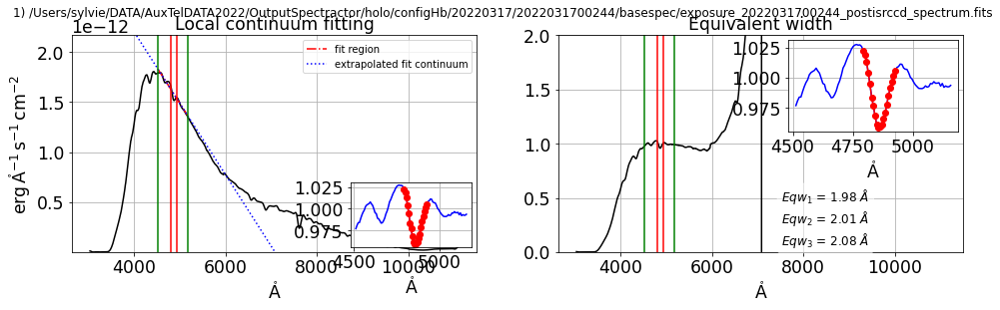

In [112]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
#eq1,eq2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
eq1,eq2,eq3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

2022-04-09 19:08:39  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

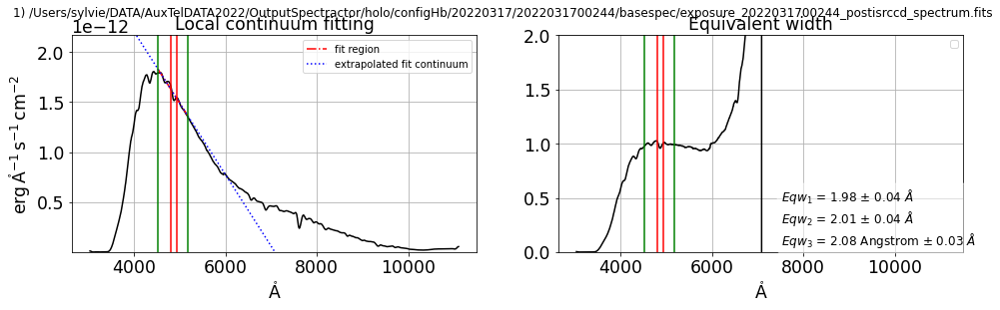

In [113]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
eqw10,eqw20,eqw30,eq1_set,eq2_set,eq3_set=ComputeMyEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=30,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

In [114]:
eqw_hbeta_err=eq3_set.std()
eqw_hbeta_err

0.033767313392150465

### HGAMMA

In [115]:
wlmin=10*(HGAMMA.wavelength-10)*u.AA
wlmax=10*(HGAMMA.wavelength+10)*u.AA
wlminline=10*(HGAMMA.wavelength-6)*u.AA
wlmaxline=10*(HGAMMA.wavelength+7)*u.AA

In [116]:
wlmin_hgamma = wlmin
wlmax_hgamma = wlmax
wlminline_hgamma = wlminline
wlmaxline_hgamma = wlmaxline

2022-04-09 19:09:04  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

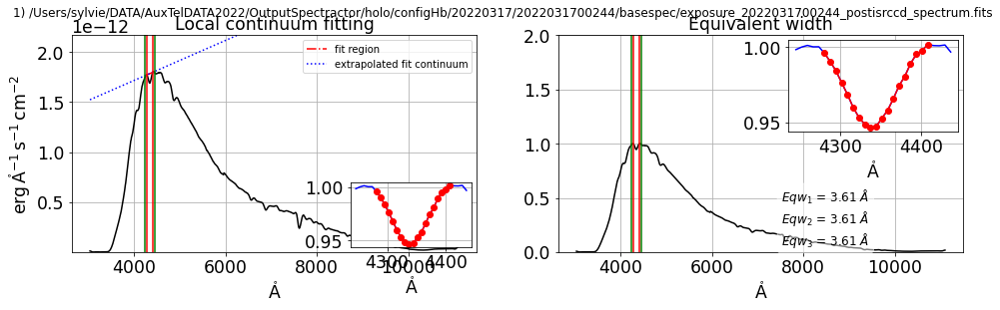

In [117]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
#eq1,eq2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
eq1,eq2,eq3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

2022-04-09 19:09:05  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


Text(0.5, 0.98, '1) /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits')

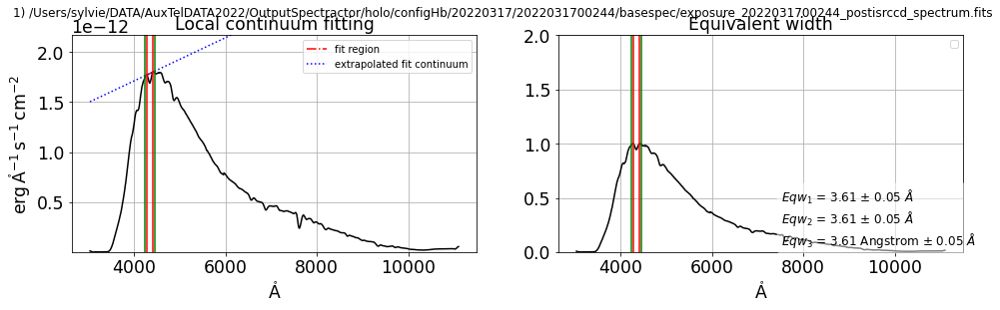

In [118]:
fig=plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
eqw10,eqw20,eq30,eq1_set,eq2_set,eq3_set=ComputeMyEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=30,flag_plot=True,ax1=ax1,ax2=ax2)
plt.suptitle(thetitle)

In [119]:
eqw_hgamma_err=eq3_set.std()
eqw_hgamma_err

0.0492242985857798

# LOOP on spectra to calculate equivalent width

## LOOP on O2 lines

0 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700238/basespec/exposure_2022031700238_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:51:22.049
set expo to 20.0
set airmass to 1.11557476948966
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1753951396614214
set dec to -32.3064444444444
set hour_angle to 30.8762989508295
set temperature to 8.9
set pressure to 743.45
set humidity to 48.0
set lambda_ref to 626.6801216985461
set parallactic_angle to 93.8012496664173
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_47 PM_ERR_MINA_47 PM_ERR_ANGLE_47 Z_VALUE_47 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -------------- --------------- ---------- --

2022-04-09 19:09:27  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


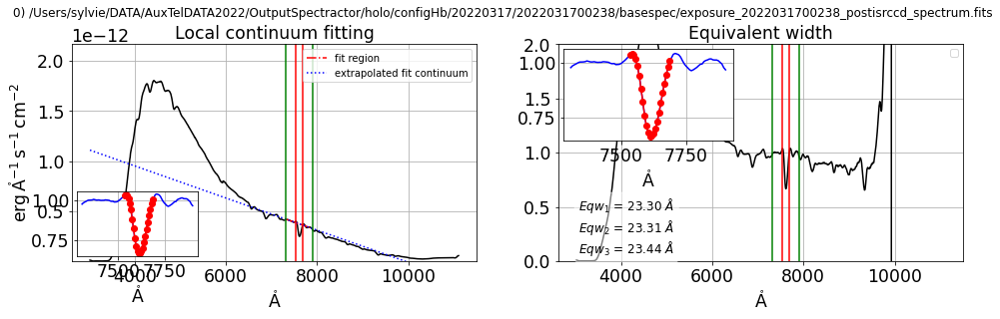

0 ) eqw_O2= 23.439535712211793
1 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:54:16.312
set expo to 20.0
set airmass to 1.121576965054115
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1741806116248446
set dec to -32.3064444444444
set hour_angle to 31.60492174100415
set temperature to 8.9
set pressure to 743.45
set humidity to 49.0
set lambda_ref to 626.883564656571
set parallactic_angle to 94.10618686949074
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_48 PM_ERR_MINA_48 PM_ERR_ANGLE_48 Z_VALUE_48 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -----------

2022-04-09 19:09:30  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


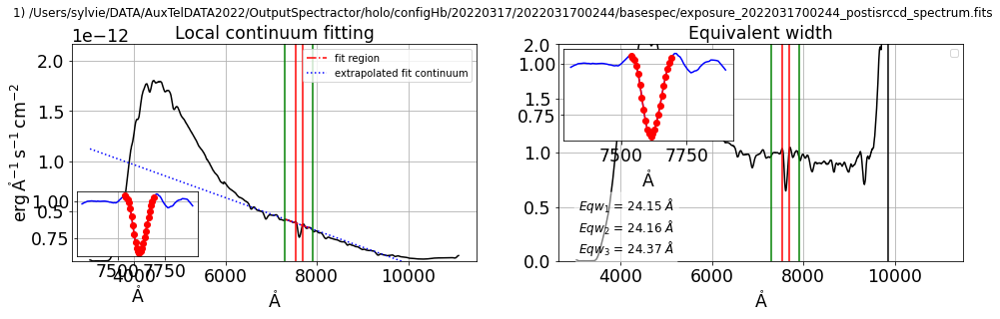

1 ) eqw_O2= 24.36939823025502
2 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700245/basespec/exposure_2022031700245_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:54:49.235
set expo to 20.0
set airmass to 1.12272698054768
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1736210434249555
set dec to -32.3064444444444
set hour_angle to 31.7419273199217
set temperature to 8.8
set pressure to 743.4
set humidity to 49.0
set lambda_ref to 626.0378655266279
set parallactic_angle to 94.16305953909519
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_49 PM_ERR_MINA_49 PM_ERR_ANGLE_49 Z_VALUE_49 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- --------------

2022-04-09 19:09:32  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


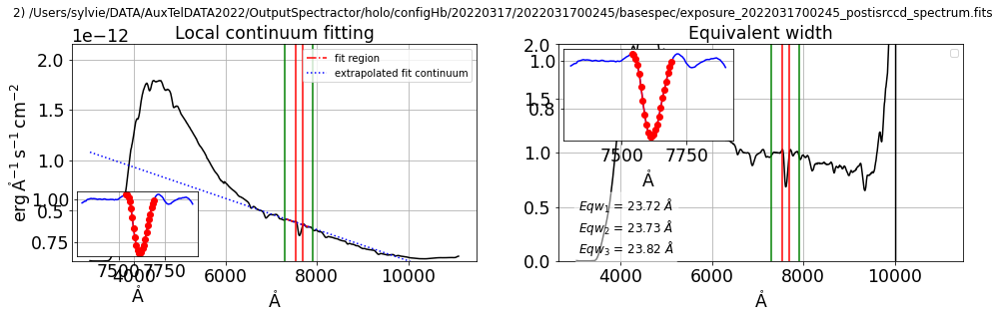

2 ) eqw_O2= 23.81503551521586
3 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700251/basespec/exposure_2022031700251_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:57:47.565
set expo to 20.0
set airmass to 1.12910731186445
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1713060449152569
set dec to -32.3064444444444
set hour_angle to 32.4876824869983
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.4911208542796
set parallactic_angle to 94.47019502924495
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_50 PM_ERR_MINA_50 PM_ERR_ANGLE_50 Z_VALUE_50 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- --------------

2022-04-09 19:09:34  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


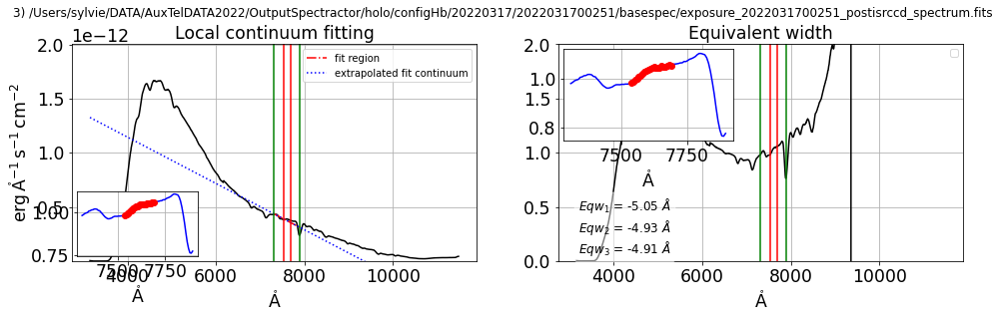

3 ) eqw_O2= -4.913205582211648
4 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700252/basespec/exposure_2022031700252_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:58:20.709
set expo to 20.0
set airmass to 1.130309156823195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.169943439836599
set dec to -32.3064444444444
set hour_angle to 32.6255240863161
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.2751365569749
set parallactic_angle to 94.52653019757676
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_51 PM_ERR_MINA_51 PM_ERR_ANGLE_51 Z_VALUE_51 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -------------

2022-04-09 19:09:36  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


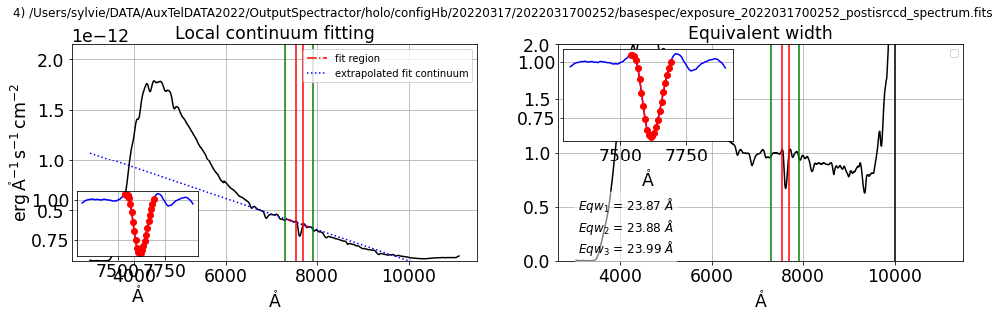

4 ) eqw_O2= 23.99273939335438
5 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700265/basespec/exposure_2022031700265_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:04:49.716
set expo to 20.0
set airmass to 1.14502998698828
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1680537967029804
set dec to -32.3064444444444
set hour_angle to 34.25103021292454
set temperature to 8.9
set pressure to 743.3
set humidity to 53.0
set lambda_ref to 626.5383418087131
set parallactic_angle to 95.18153718788132
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_52 PM_ERR_MINA_52 PM_ERR_ANGLE_52 Z_VALUE_52 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -------------

2022-04-09 19:09:38  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


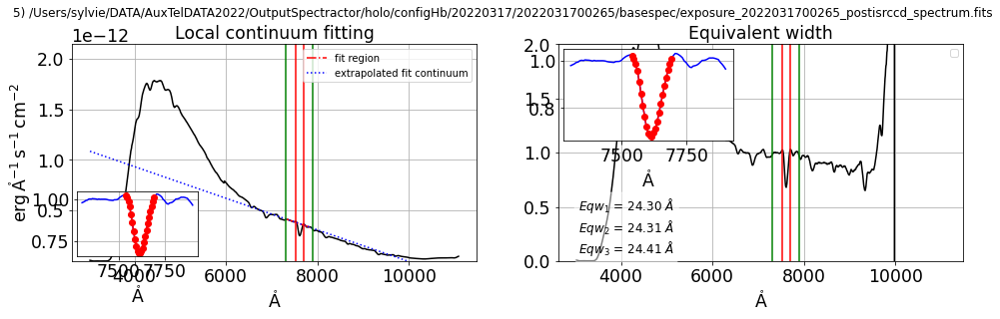

5 ) eqw_O2= 24.413408569805892
6 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700272/basespec/exposure_2022031700272_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:08:18.080
set expo to 20.0
set airmass to 1.1533391050821
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.165620392992809
set dec to -32.3064444444444
set hour_angle to 35.12228883044955
set temperature to 8.9
set pressure to 743.3
set humidity to 51.0
set lambda_ref to 626.067912732114
set parallactic_angle to 95.52618006847594
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_53 PM_ERR_MINA_53 PM_ERR_ANGLE_53 Z_VALUE_53 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -------------- 

2022-04-09 19:09:40  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


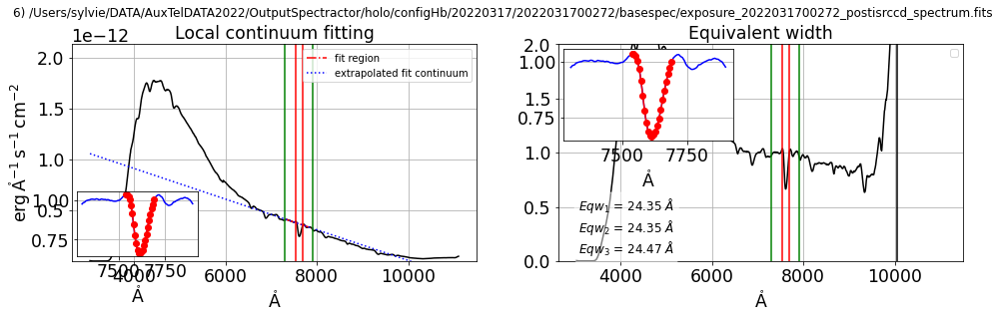

6 ) eqw_O2= 24.474306438419703
7 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700273/basespec/exposure_2022031700273_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:08:50.992
set expo to 20.0
set airmass to 1.154683255421995
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1687630065527601
set dec to -32.3064444444444
set hour_angle to 35.26034049072464
set temperature to 8.9
set pressure to 743.35
set humidity to 51.0
set lambda_ref to 626.2488273411835
set parallactic_angle to 95.58041503368928
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_54 PM_ERR_MINA_54 PM_ERR_ANGLE_54 Z_VALUE_54 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ----------

2022-04-09 19:09:41  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


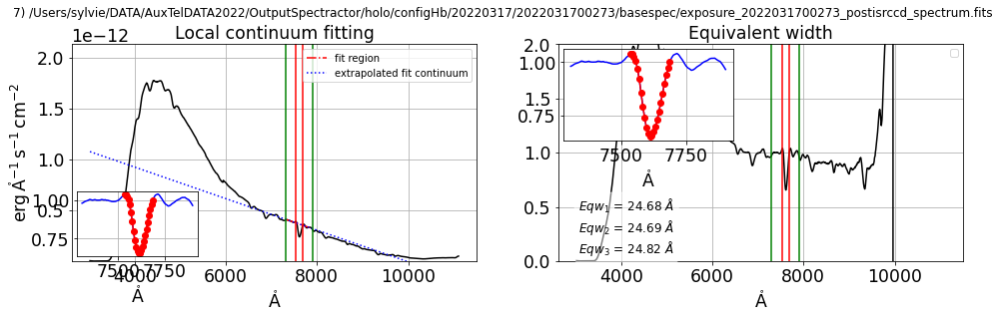

7 ) eqw_O2= 24.82366144986842
8 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700279/basespec/exposure_2022031700279_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:11:46.031
set expo to 20.0
set airmass to 1.16193866550813
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1650200479066801
set dec to -32.3064444444444
set hour_angle to 35.99118130784399
set temperature to 8.9
set pressure to 743.4
set humidity to 53.0
set lambda_ref to 625.9517855761172
set parallactic_angle to 95.86593376321808
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_55 PM_ERR_MINA_55 PM_ERR_ANGLE_55 Z_VALUE_55 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -------------

2022-04-09 19:09:44  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


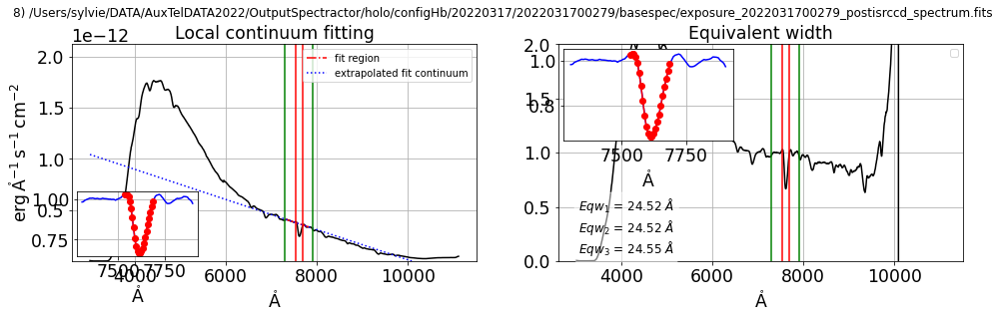

8 ) eqw_O2= 24.54724401076031
9 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700286/basespec/exposure_2022031700286_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:15:18.583
set expo to 20.0
set airmass to 1.17105276018288
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1604530597215738
set dec to -32.3064444444444
set hour_angle to 36.87993052247099
set temperature to 8.9
set pressure to 743.45
set humidity to 54.0
set lambda_ref to 626.415954438991
set parallactic_angle to 96.20974235390722
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_56 PM_ERR_MINA_56 PM_ERR_ANGLE_56 Z_VALUE_56 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -------------

2022-04-09 19:09:46  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


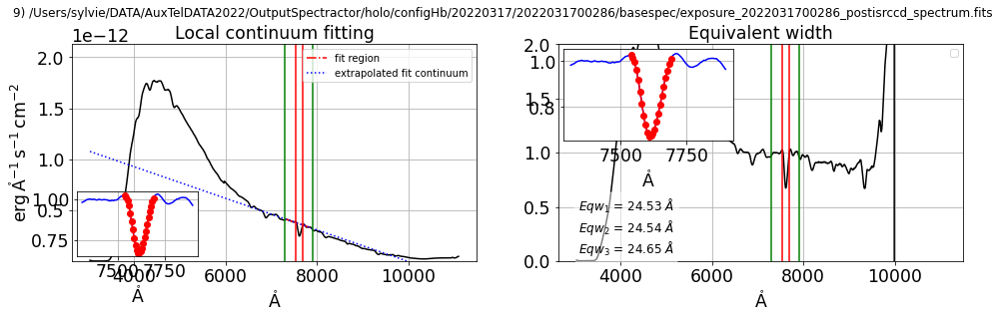

9 ) eqw_O2= 24.653145289690016
10 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700293/basespec/exposure_2022031700293_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:18:45.526
set expo to 20.0
set airmass to 1.18024864471996
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.161506254140246
set dec to -32.3064444444444
set hour_angle to 37.74449227926539
set temperature to 9.0
set pressure to 743.45
set humidity to 53.0
set lambda_ref to 626.2661772674467
set parallactic_angle to 96.54092631927332
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_57 PM_ERR_MINA_57 PM_ERR_ANGLE_57 Z_VALUE_57 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -----------

2022-04-09 19:09:48  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


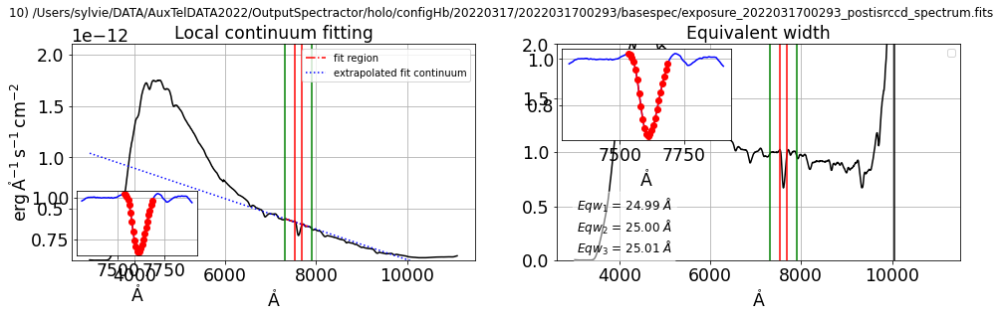

10 ) eqw_O2= 25.012130128443644
11 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700300/basespec/exposure_2022031700300_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:22:16.238
set expo to 20.0
set airmass to 1.189962402398665
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1600582040885921
set dec to -32.3064444444444
set hour_angle to 38.6257061937975
set temperature to 8.9
set pressure to 743.4
set humidity to 56.0
set lambda_ref to 626.2915574183227
set parallactic_angle to 96.875483029922
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_58 PM_ERR_MINA_58 PM_ERR_ANGLE_58 Z_VALUE_58 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ------------

2022-04-09 19:09:50  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


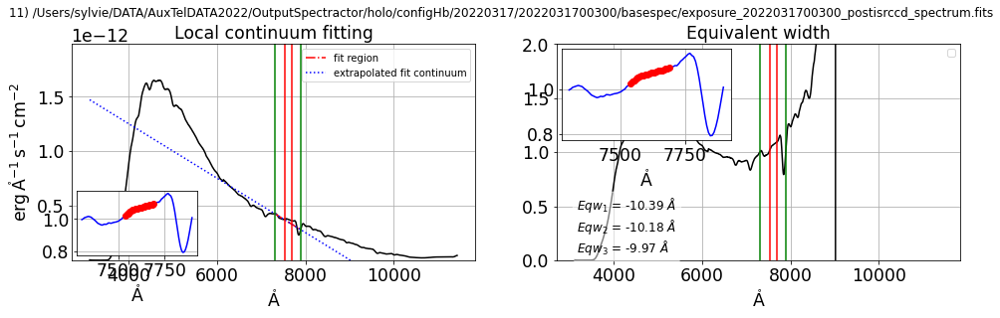

11 ) eqw_O2= -9.974737218627665
12 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700301/basespec/exposure_2022031700301_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:22:49.144
set expo to 20.0
set airmass to 1.191505368069865
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1585750124351514
set dec to -32.3064444444444
set hour_angle to 38.76271209839639
set temperature to 9.0
set pressure to 743.45
set humidity to 56.0
set lambda_ref to 626.4868452630084
set parallactic_angle to 96.92724413418016
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_59 PM_ERR_MINA_59 PM_ERR_ANGLE_59 Z_VALUE_59 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- --------

2022-04-09 19:09:52  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


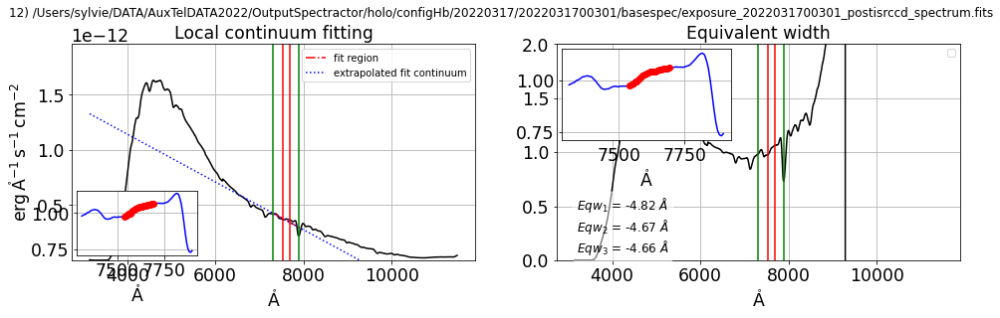

12 ) eqw_O2= -4.664802064285811
13 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700310/basespec/exposure_2022031700310_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:43:57.837
set expo to 20.0
set airmass to 1.25822658979951
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476502374643685
set dec to -32.3064444444444
set hour_angle to 44.06414790775874
set temperature to 8.8
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 626.6251269515418
set parallactic_angle to 98.88882683561982
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_60 PM_ERR_MINA_60 PM_ERR_ANGLE_60 Z_VALUE_60 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:09:54  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


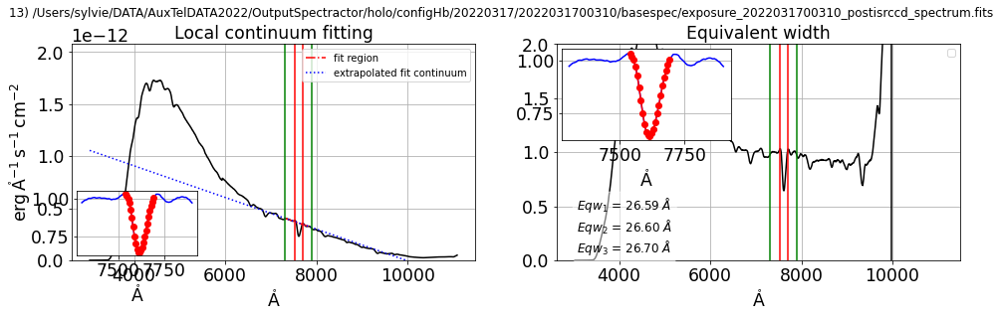

13 ) eqw_O2= 26.697968035251403
14 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700316/basespec/exposure_2022031700316_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:46:52.361
set expo to 20.0
set airmass to 1.26858445121286
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476350630254128
set dec to -32.3064444444444
set hour_angle to 44.79438636254909
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 627.6256863262817
set parallactic_angle to 99.15414320783184
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_61 PM_ERR_MINA_61 PM_ERR_ANGLE_61 Z_VALUE_61 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:09:56  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


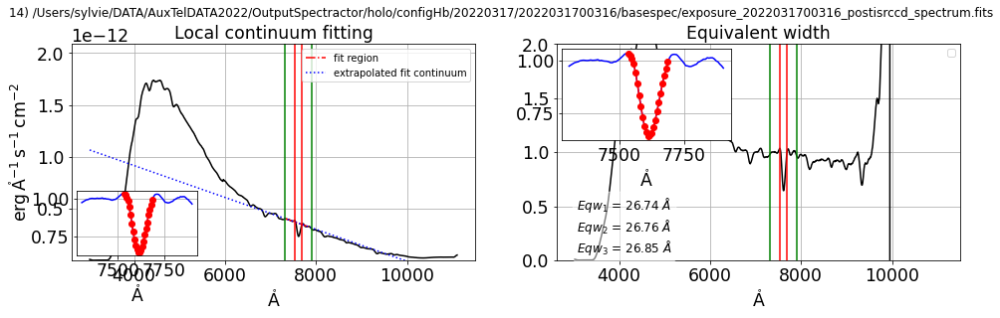

14 ) eqw_O2= 26.84614148904341
15 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700317/basespec/exposure_2022031700317_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:47:25.256
set expo to 20.0
set airmass to 1.27056341471374
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1466645118411156
set dec to -32.3064444444444
set hour_angle to 44.9315970155517
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 625.7408027741238
set parallactic_angle to 99.2038979478238
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_62 PM_ERR_MINA_62 PM_ERR_ANGLE_62 Z_VALUE_62 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ------------

2022-04-09 19:09:58  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


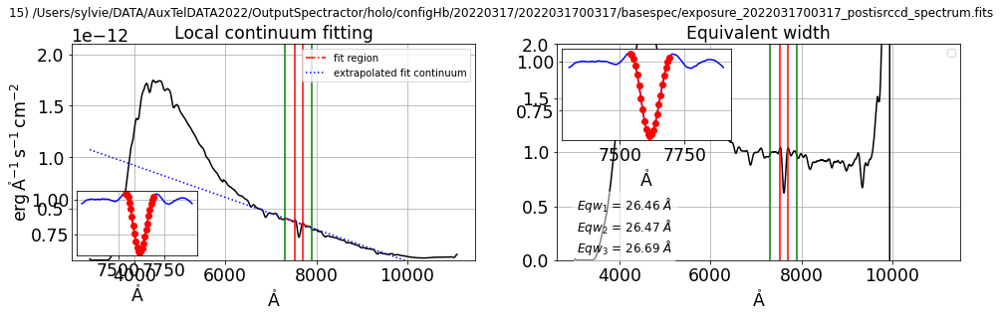

15 ) eqw_O2= 26.68710412626875
16 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700330/basespec/exposure_2022031700330_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:53:46.736
set expo to 20.0
set airmass to 1.294394244363805
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1444547716136137
set dec to -32.3064444444444
set hour_angle to 46.52581667330039
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.9120383005036
set parallactic_angle to 99.77999069166285
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_63 PM_ERR_MINA_63 PM_ERR_ANGLE_63 Z_VALUE_63 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ----------

2022-04-09 19:10:00  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


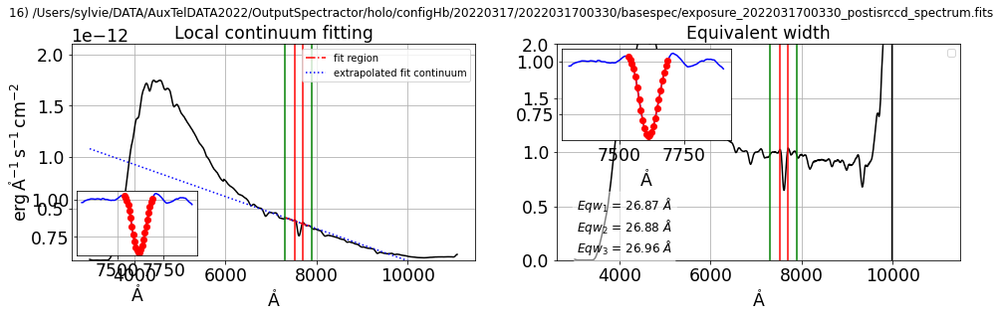

16 ) eqw_O2= 26.962901519284035
17 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700331/basespec/exposure_2022031700331_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:54:19.724
set expo to 20.0
set airmass to 1.29652271576687
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1441648974084375
set dec to -32.3064444444444
set hour_angle to 46.6628171725209
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.7462807078947
set parallactic_angle to 99.82934304254884
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_64 PM_ERR_MINA_64 PM_ERR_ANGLE_64 Z_VALUE_64 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -----------

2022-04-09 19:10:02  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


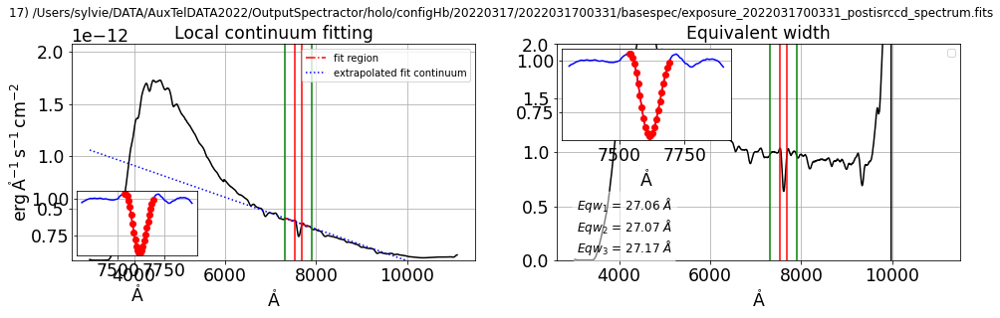

17 ) eqw_O2= 27.16860480960099
18 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700338/basespec/exposure_2022031700338_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:57:49.306
set expo to 20.0
set airmass to 1.31035777011874
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1437462230173573
set dec to -32.3064444444444
set hour_angle to 47.53898537176394
set temperature to 8.7
set pressure to 743.45
set humidity to 57.0
set lambda_ref to 628.9551099539515
set parallactic_angle to 100.14447493807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_65 PM_ERR_MINA_65 PM_ERR_ANGLE_65 Z_VALUE_65 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ------------

2022-04-09 19:10:04  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


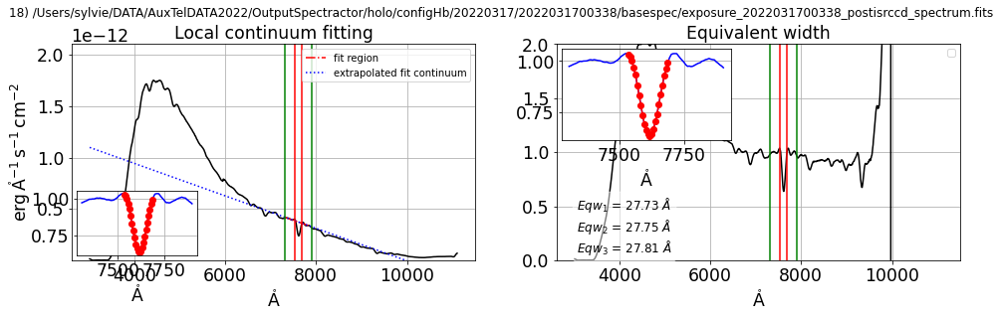

18 ) eqw_O2= 27.81229043569776
19 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700345/basespec/exposure_2022031700345_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:01:19.196
set expo to 20.0
set airmass to 1.324716687989025
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1392710710370809
set dec to -32.3064444444444
set hour_angle to 48.4163008821963
set temperature to 8.6
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 626.8625000130343
set parallactic_angle to 100.4592627484374
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_66 PM_ERR_MINA_66 PM_ERR_ANGLE_66 Z_VALUE_66 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ----------

2022-04-09 19:10:06  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


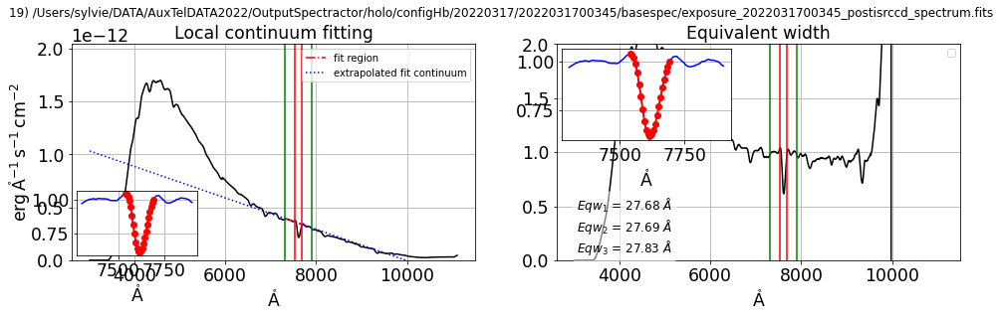

19 ) eqw_O2= 27.83188842029362
20 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700351/basespec/exposure_2022031700351_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:04:16.794
set expo to 20.0
set airmass to 1.33727547076682
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1388486262435704
set dec to -32.3064444444444
set hour_angle to 49.15879882143194
set temperature to 8.5
set pressure to 743.45
set humidity to 58.0
set lambda_ref to 628.5424256920012
set parallactic_angle to 100.7251843777299
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_67 PM_ERR_MINA_67 PM_ERR_ANGLE_67 Z_VALUE_67 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ----------

2022-04-09 19:10:09  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


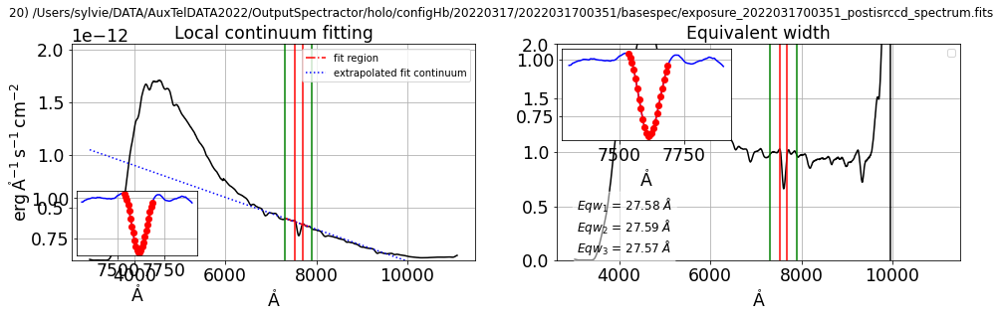

20 ) eqw_O2= 27.57255461094815
21 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700352/basespec/exposure_2022031700352_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:04:49.712
set expo to 20.0
set airmass to 1.33963651479802
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1368681187146323
set dec to -32.3064444444444
set hour_angle to 49.29580448438519
set temperature to 8.5
set pressure to 743.35
set humidity to 58.0
set lambda_ref to 628.2086674961155
set parallactic_angle to 100.7742095756281
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_68 PM_ERR_MINA_68 PM_ERR_ANGLE_68 Z_VALUE_68 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ----------

2022-04-09 19:10:11  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


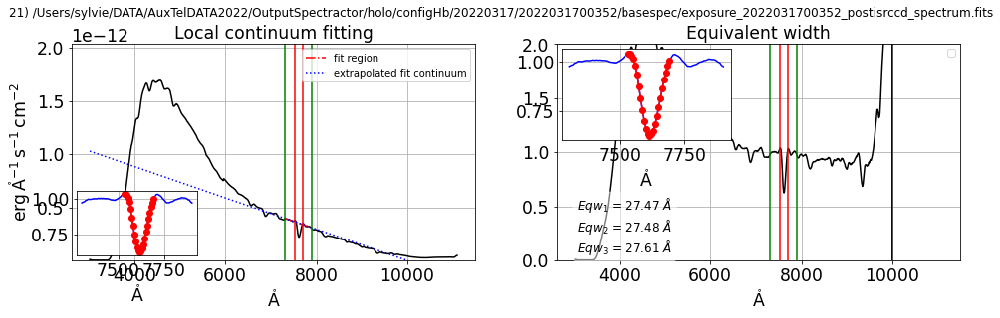

21 ) eqw_O2= 27.608698325787863
22 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700358/basespec/exposure_2022031700358_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:07:49.074
set expo to 20.0
set airmass to 1.352787300037425
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1331931685876357
set dec to -32.3064444444444
set hour_angle to 50.04587365708529
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 627.9591693143808
set parallactic_angle to 101.0424069948098
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_69 PM_ERR_MINA_69 PM_ERR_ANGLE_69 Z_VALUE_69 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:10:13  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


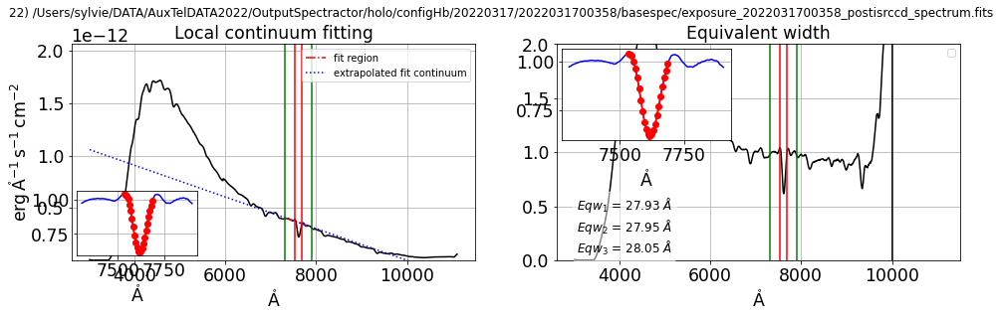

22 ) eqw_O2= 28.045927679715835
23 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700365/basespec/exposure_2022031700365_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:11:20.051
set expo to 20.0
set airmass to 1.368765631503195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1336440841342464
set dec to -32.3064444444444
set hour_angle to 50.92719907664954
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 622.7051672626101
set parallactic_angle to 101.357174452077
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_70 PM_ERR_MINA_70 PM_ERR_ANGLE_70 Z_VALUE_70 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ----------

2022-04-09 19:10:16  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


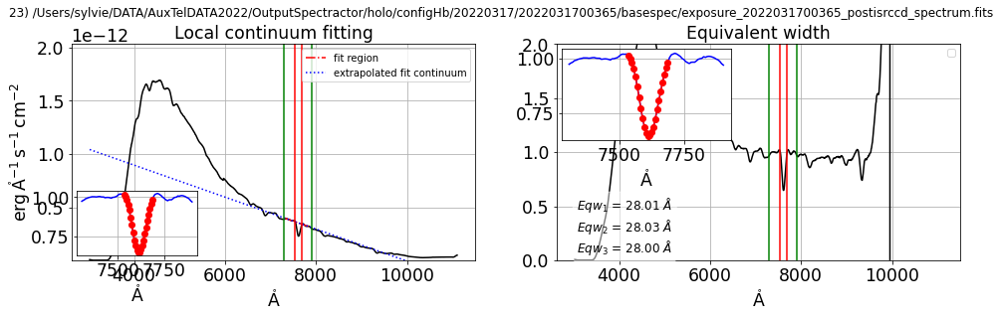

23 ) eqw_O2= 28.00377832724677
24 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700366/basespec/exposure_2022031700366_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:11:53.006
set expo to 20.0
set airmass to 1.371319339871885
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1369079175197151
set dec to -32.3064444444444
set hour_angle to 51.06504024257939
set temperature to 8.4
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 629.1845159477502
set parallactic_angle to 101.4063764649771
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_71 PM_ERR_MINA_71 PM_ERR_ANGLE_71 Z_VALUE_71 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:10:18  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


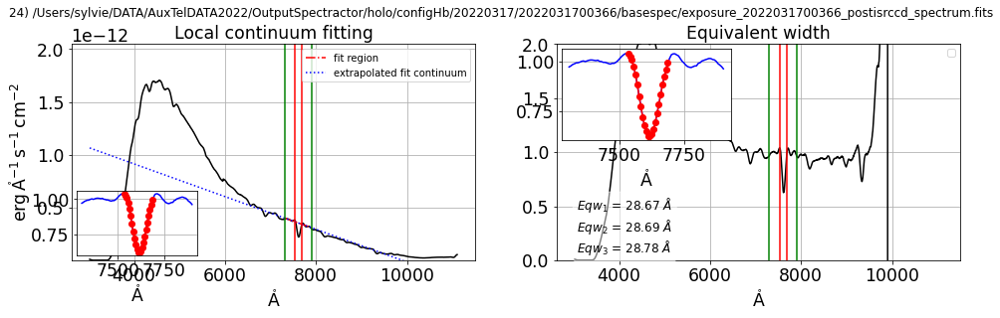

24 ) eqw_O2= 28.77719017503065
25 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700372/basespec/exposure_2022031700372_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:14:46.798
set expo to 20.0
set airmass to 1.38501167017706
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1310814762516916
set dec to -32.3064444444444
set hour_angle to 51.79156958975715
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.5245232921197
set parallactic_angle to 101.6656129875546
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_72 PM_ERR_MINA_72 PM_ERR_ANGLE_72 Z_VALUE_72 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ----------

2022-04-09 19:10:20  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


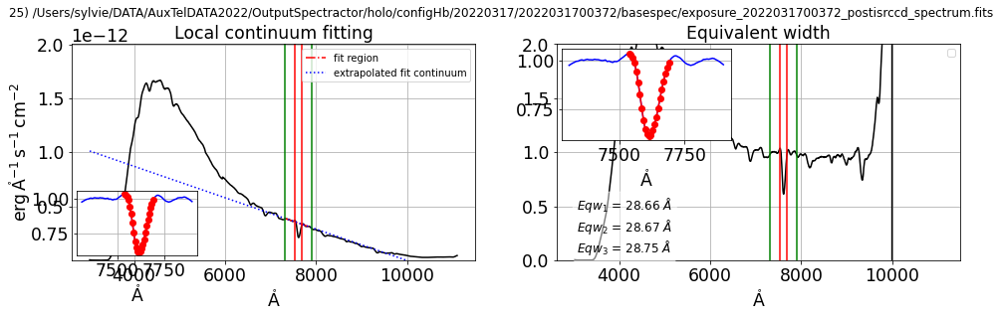

25 ) eqw_O2= 28.752415945745888
26 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700373/basespec/exposure_2022031700373_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:15:19.743
set expo to 20.0
set airmass to 1.387649936190795
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1317245037126307
set dec to -32.3064444444444
set hour_angle to 51.92878009828319
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.9968889639981
set parallactic_angle to 101.7145568247823
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_73 PM_ERR_MINA_73 PM_ERR_ANGLE_73 Z_VALUE_73 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- --------

2022-04-09 19:10:23  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


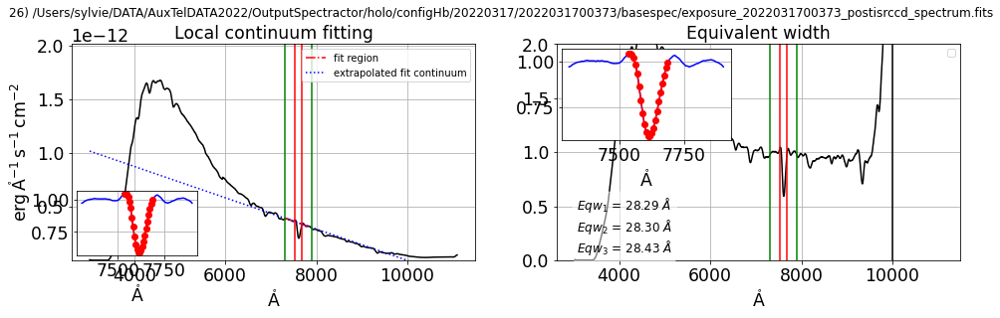

26 ) eqw_O2= 28.42714569347347
27 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700380/basespec/exposure_2022031700380_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:33:33.012
set expo to 20.0
set airmass to 1.48452422171666
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1197628273916148
set dec to -32.3064444444444
set hour_angle to 56.49902324990354
set temperature to 8.0
set pressure to 743.35
set humidity to 63.0
set lambda_ref to 628.5888123380201
set parallactic_angle to 103.3450343494105
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_74 PM_ERR_MINA_74 PM_ERR_ANGLE_74 Z_VALUE_74 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ----------

2022-04-09 19:10:25  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


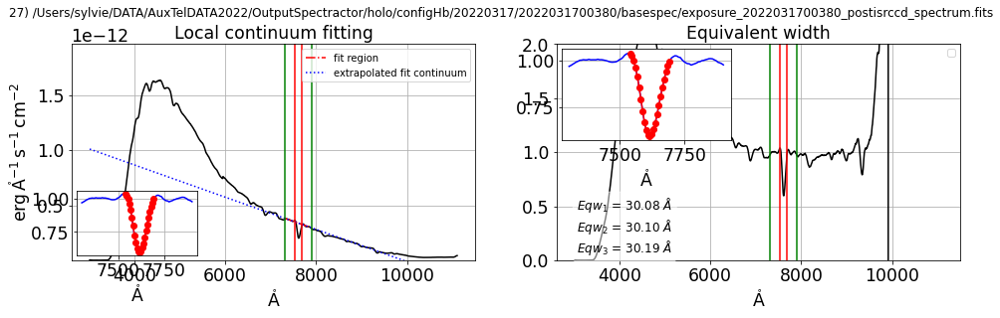

27 ) eqw_O2= 30.194136279037025
28 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700386/basespec/exposure_2022031700386_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:36:30.874
set expo to 20.0
set airmass to 1.50213593383469
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1172584274998106
set dec to -32.3064444444444
set hour_angle to 57.24247377715349
set temperature to 8.1
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 633.8101508297243
set parallactic_angle to 103.6108187575918
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_75 PM_ERR_MINA_75 PM_ERR_ANGLE_75 Z_VALUE_75 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:10:27  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


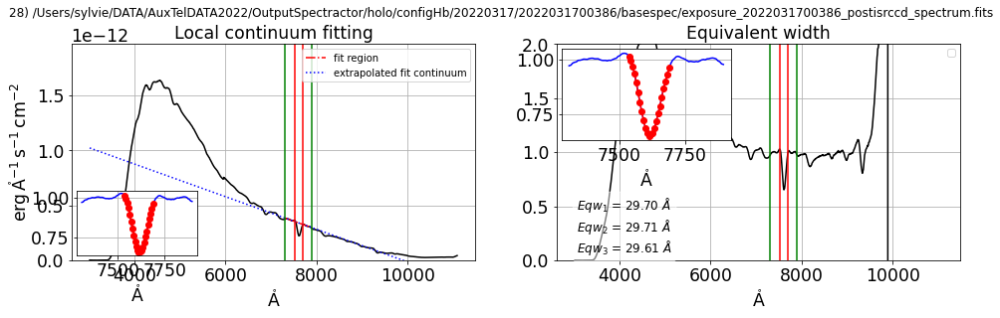

28 ) eqw_O2= 29.610243177400687
29 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700387/basespec/exposure_2022031700387_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:37:03.815
set expo to 20.0
set airmass to 1.50545657928364
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1211335036558286
set dec to -32.3064444444444
set hour_angle to 57.37947904087095
set temperature to 8.1
set pressure to 743.35
set humidity to 64.0
set lambda_ref to 628.2172036981787
set parallactic_angle to 103.6598297048832
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_76 PM_ERR_MINA_76 PM_ERR_ANGLE_76 Z_VALUE_76 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:10:30  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


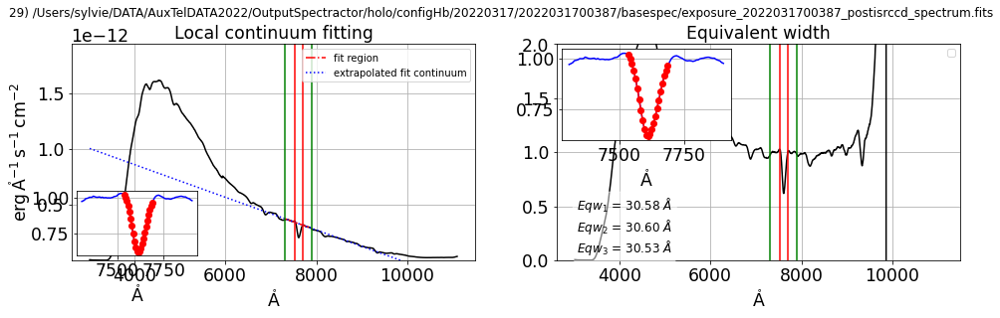

29 ) eqw_O2= 30.52901915158795
30 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700393/basespec/exposure_2022031700393_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:40:00.839
set expo to 20.0
set airmass to 1.523657512515415
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1177429780701742
set dec to -32.3064444444444
set hour_angle to 58.11949120092164
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.3577400172557
set parallactic_angle to 103.9247454603291
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_77 PM_ERR_MINA_77 PM_ERR_ANGLE_77 Z_VALUE_77 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ----------

2022-04-09 19:10:32  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


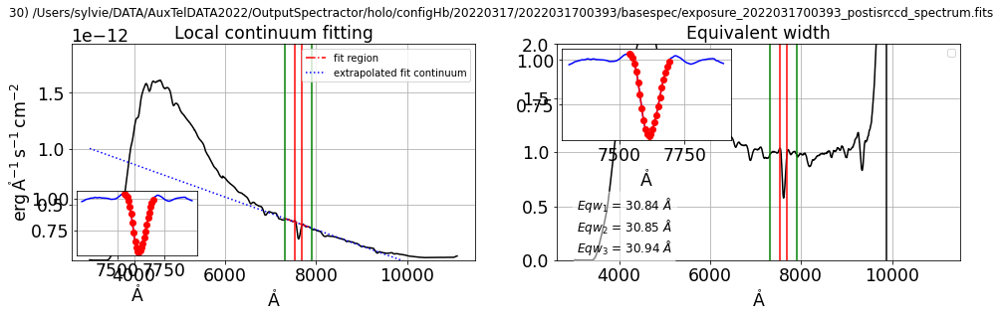

30 ) eqw_O2= 30.936503839954653
31 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700394/basespec/exposure_2022031700394_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:40:33.787
set expo to 20.0
set airmass to 1.527114954027915
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1169167488860146
set dec to -32.3064444444444
set hour_angle to 58.25733391386269
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.7847433714671
set parallactic_angle to 103.9741296646409
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_78 PM_ERR_MINA_78 PM_ERR_ANGLE_78 Z_VALUE_78 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:10:35  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


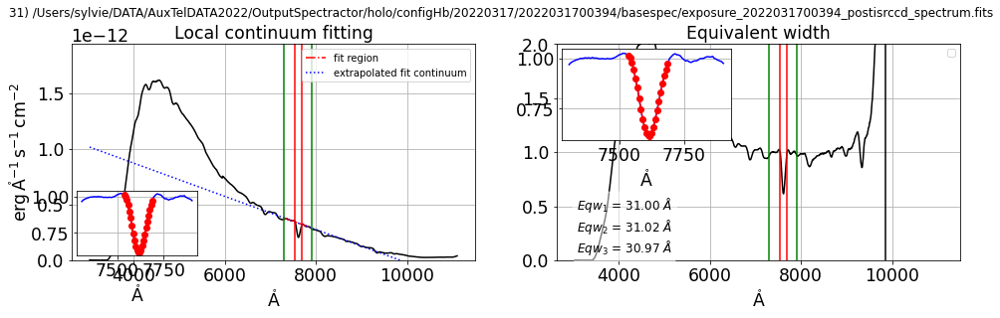

31 ) eqw_O2= 30.966918554772157
32 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700401/basespec/exposure_2022031700401_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:44:05.105
set expo to 20.0
set airmass to 1.54976447202586
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1144055844584487
set dec to -32.3064444444444
set hour_angle to 59.14046723526914
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 629.2826348266267
set parallactic_angle to 104.2908413745483
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_79 PM_ERR_MINA_79 PM_ERR_ANGLE_79 Z_VALUE_79 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:10:37  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


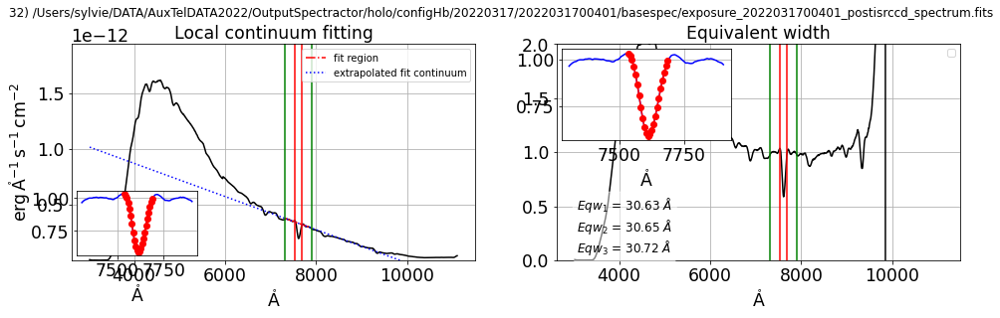

32 ) eqw_O2= 30.723235079633792
33 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700407/basespec/exposure_2022031700407_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:47:02.835
set expo to 20.0
set airmass to 1.56951976624838
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.113192412444726
set dec to -32.3064444444444
set hour_angle to 59.88301895711849
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 623.392411114623
set parallactic_angle to 104.5576025273592
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_80 PM_ERR_MINA_80 PM_ERR_ANGLE_80 Z_VALUE_80 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ------------

2022-04-09 19:10:39  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


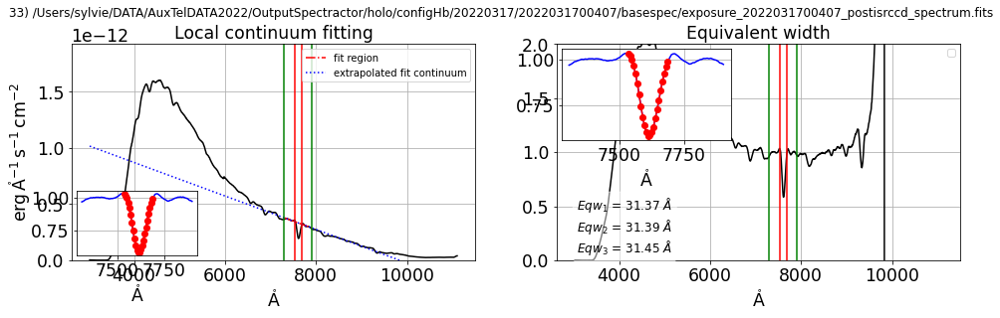

33 ) eqw_O2= 31.447602760493446
34 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700408/basespec/exposure_2022031700408_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:47:35.769
set expo to 20.0
set airmass to 1.573248011911855
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1127873058479127
set dec to -32.3064444444444
set hour_angle to 60.02106934614464
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 624.3168639615992
set parallactic_angle to 104.6072480488688
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_81 PM_ERR_MINA_81 PM_ERR_ANGLE_81 Z_VALUE_81 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- --------

2022-04-09 19:10:42  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


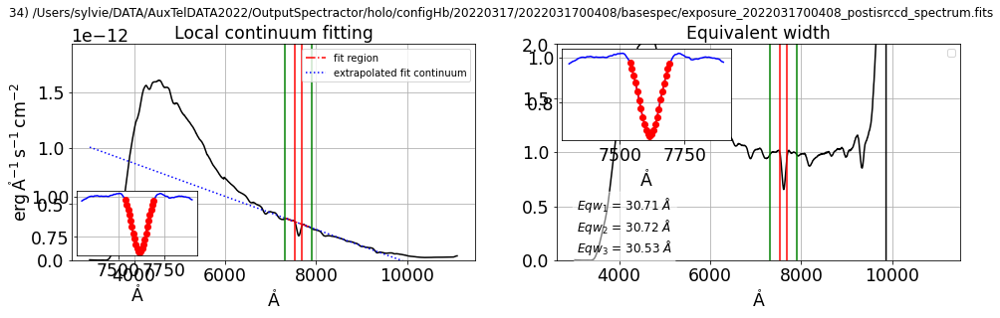

34 ) eqw_O2= 30.53023858966522
35 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700414/basespec/exposure_2022031700414_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:50:38.306
set expo to 20.0
set airmass to 1.594345273370295
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1038057563272595
set dec to -32.3064444444444
set hour_angle to 60.78322641711044
set temperature to 8.0
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 625.6140852852044
set parallactic_angle to 104.8816435668321
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_82 PM_ERR_MINA_82 PM_ERR_ANGLE_82 Z_VALUE_82 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:10:44  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


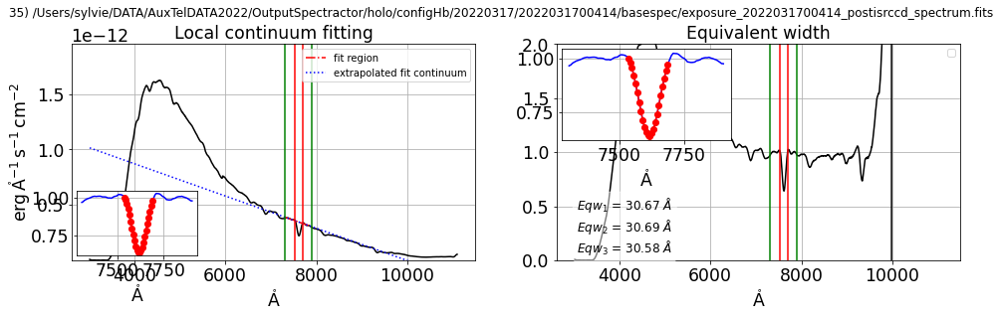

35 ) eqw_O2= 30.584152418541592
36 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700421/basespec/exposure_2022031700421_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:08:41.573
set expo to 20.0
set airmass to 1.73594131895663
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09058150608401207
set dec to -32.3064444444444
set hour_angle to 65.3119392087705
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 631.9889212287092
set parallactic_angle to 106.5252810168807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_83 PM_ERR_MINA_83 PM_ERR_ANGLE_83 Z_VALUE_83 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ----------

2022-04-09 19:10:47  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


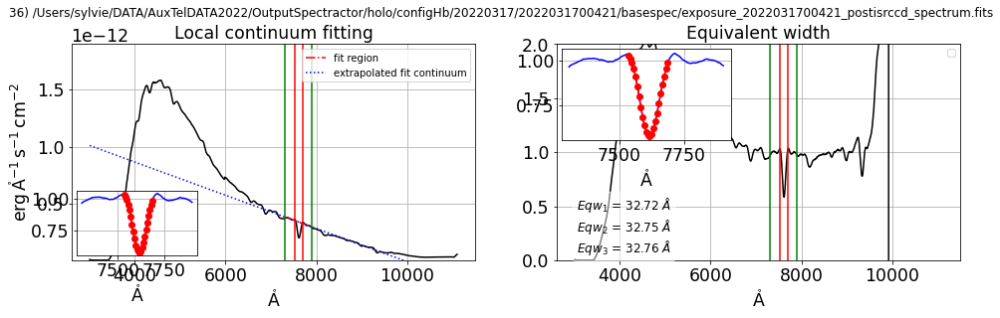

36 ) eqw_O2= 32.76366225927927
37 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700422/basespec/exposure_2022031700422_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:09:14.484
set expo to 20.0
set airmass to 1.740715384660955
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09733707671582016
set dec to -32.3064444444444
set hour_angle to 65.44894264967655
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 625.9596270530473
set parallactic_angle to 106.5754178018598
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_84 PM_ERR_MINA_84 PM_ERR_ANGLE_84 Z_VALUE_84 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:10:49  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


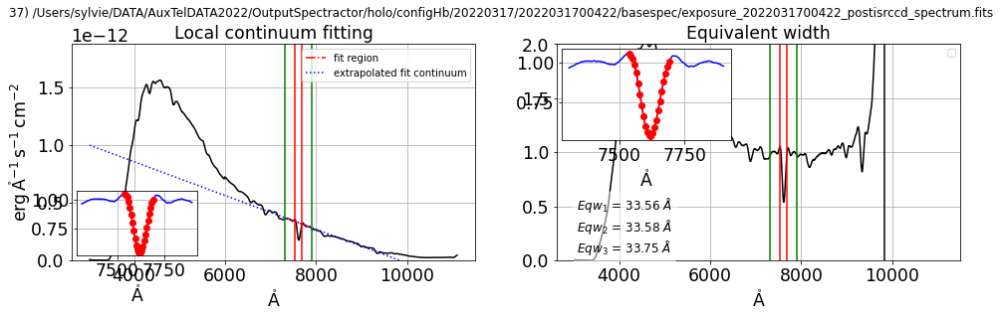

37 ) eqw_O2= 33.75342032473265
38 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700428/basespec/exposure_2022031700428_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:12:54.310
set expo to 20.0
set airmass to 2.129245852899135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.143944791309082
set dec to -87.4721944444444
set hour_angle to -155.5929780702915
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 686.0625390317258
set parallactic_angle to -156.1678055894986
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_85 PM_ERR_MINA_85 PM_ERR_ANGLE_85 Z_VALUE_85 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ------

2022-04-09 19:10:51  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


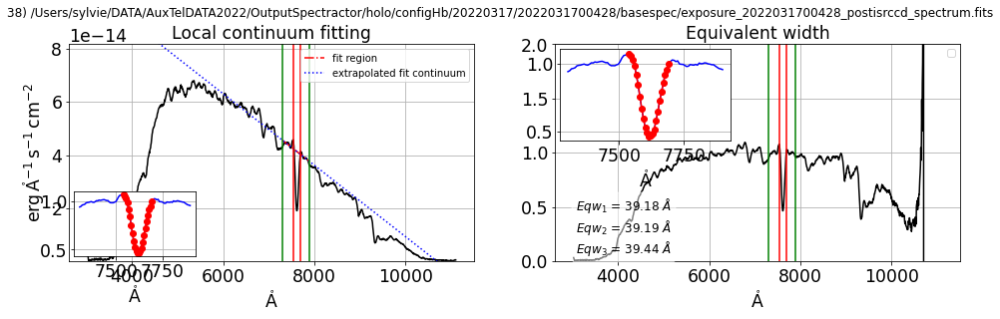

38 ) eqw_O2= 39.44160833622936
39 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700429/basespec/exposure_2022031700429_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:13:27.208
set expo to 20.0
set airmass to 2.1290679262036
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09887590360164929
set dec to -87.4721944444444
set hour_angle to -155.455137691263
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 636.4362643500099
set parallactic_angle to -156.0330469936088
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_86 PM_ERR_MINA_86 PM_ERR_ANGLE_86 Z_VALUE_86 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -------

2022-04-09 19:10:54  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


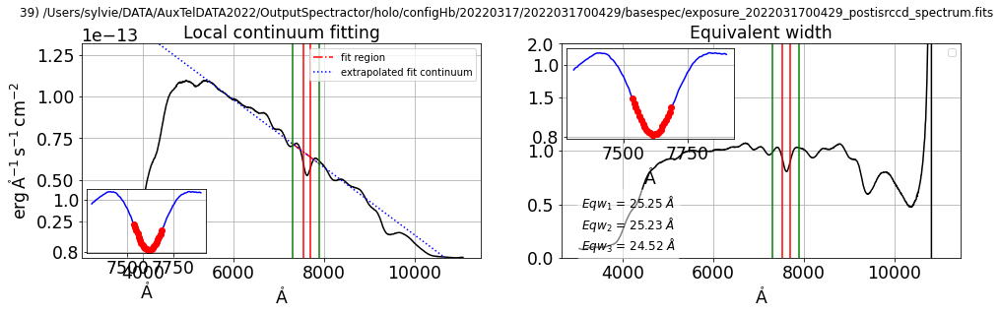

39 ) eqw_O2= 24.517224481924917
40 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700435/basespec/exposure_2022031700435_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:17:06.794
set expo to 20.0
set airmass to 1.81309435755974
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09210139501009447
set dec to -32.3064444444444
set hour_angle to 67.42354300312304
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 626.8738274489511
set parallactic_angle to 107.3011935159837
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_87 PM_ERR_MINA_87 PM_ERR_ANGLE_87 Z_VALUE_87 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- --------

2022-04-09 19:10:56  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


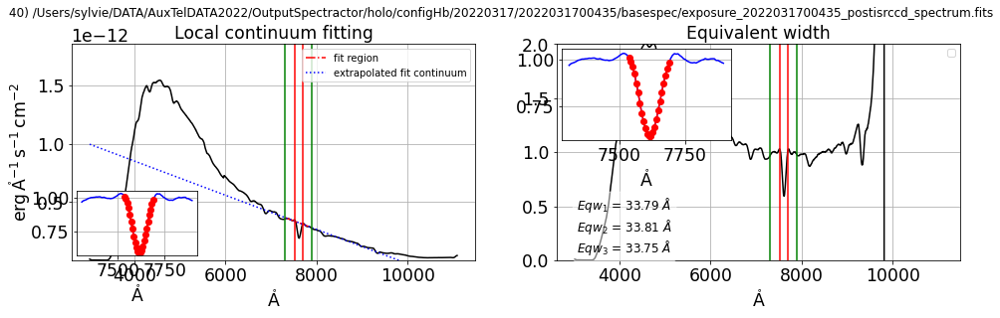

40 ) eqw_O2= 33.75478208399598
41 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700436/basespec/exposure_2022031700436_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:17:39.779
set expo to 20.0
set airmass to 1.818418067455135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.08344429603447075
set dec to -32.3064444444444
set hour_angle to 67.56159248336594
set temperature to 7.7
set pressure to 743.4
set humidity to 63.0
set lambda_ref to 632.4252252976918
set parallactic_angle to 107.3521665962106
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_88 PM_ERR_MINA_88 PM_ERR_ANGLE_88 Z_VALUE_88 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:10:59  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


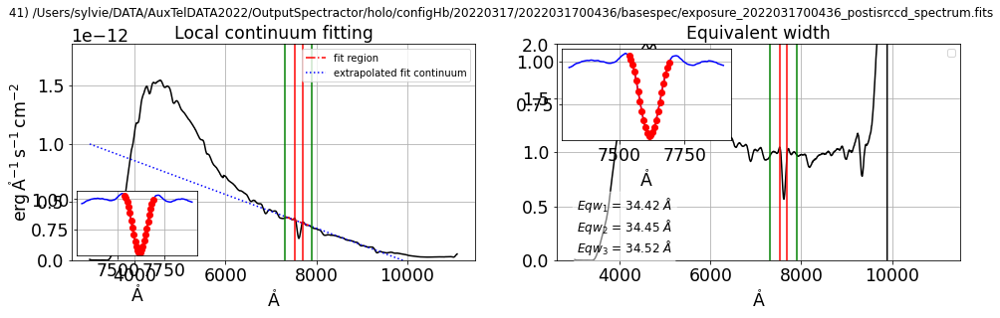

41 ) eqw_O2= 34.515240297561895
42 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700442/basespec/exposure_2022031700442_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:21:26.873
set expo to 20.0
set airmass to 1.856070090955285
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.06347269052355019
set dec to -32.3064444444444
set hour_angle to 68.51099093135984
set temperature to 7.8
set pressure to 743.4
set humidity to 62.0
set lambda_ref to 630.0633085655397
set parallactic_angle to 107.7035936917225
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_89 PM_ERR_MINA_89 PM_ERR_ANGLE_89 Z_VALUE_89 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- --------

2022-04-09 19:11:01  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


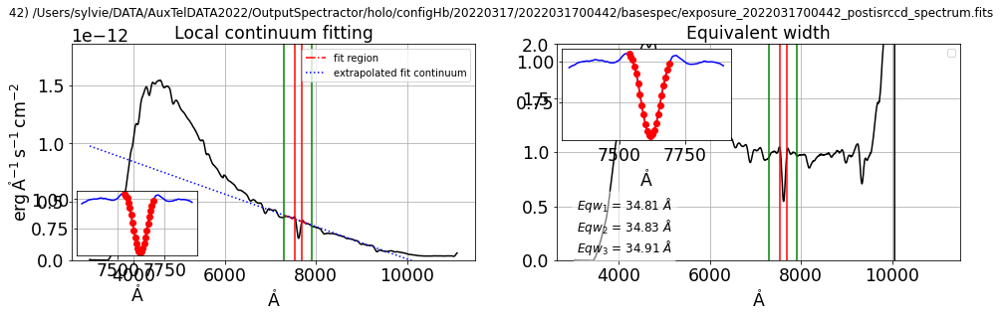

42 ) eqw_O2= 34.91443197850738
43 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700443/basespec/exposure_2022031700443_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:21:59.878
set expo to 20.0
set airmass to 1.861691550345225
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.0769189759908508
set dec to -32.3064444444444
set hour_angle to 68.64883074724754
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 633.3015467495994
set parallactic_angle to 107.7547458765076
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_90 PM_ERR_MINA_90 PM_ERR_ANGLE_90 Z_VALUE_90 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:11:04  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


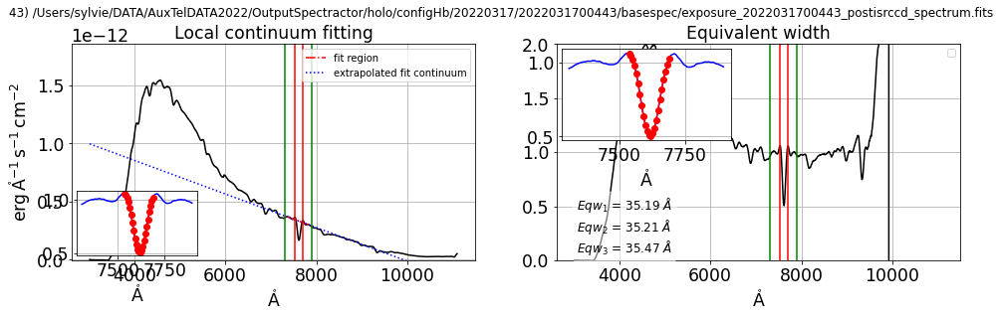

43 ) eqw_O2= 35.47459923283206


In [120]:
WLMIN=300
WLMAX=1000
lambdas = np.arange(WLMIN,WLMAX,1)
fwhm_func = interp1d(lambdas, 0.01 * lambdas)
parameters.DISPLAY=False


for IDXSEL in np.arange(0,NN):

    
    
    filename_SEL=all_good_spectra_spectrum_files[IDXSEL]
    filename_spectrogram_SEL=filename_SEL.replace("_spectrum","_spectrogram")
    fullfilename_SEL = os.path.join(dir_spectra,filename_SEL)
    fullfilename_spectrogram_SEL = fullfilename_SEL.replace("_spectrum","_spectrogram")
    
    # load the spectrum
    
    print(IDXSEL,") ",filename_SEL)
    
    s=Spectrum(fullfilename_SEL, config=config)
    s.load_spectrogram(fullfilename_spectrogram_SEL) 
    
    
    lamb = 10*s.lambdas * u.AA 
    flux = s.data * u.Unit('erg cm-2 s-1 AA-1')/10 
    spec = Spectrum1D(spectral_axis=lamb, flux=flux) 
    fluxerr = s.err * u.Unit('erg cm-2 s-1 AA-1')/10. 
    specerr = Spectrum1D(spectral_axis=lamb, flux=fluxerr)
    
    # O2 line
    # wlmin=10*(O2_1.wavelength-30)*u.AA
    #wlmax=10*(O2_1.wavelength+30)*u.AA
    #wlminline=10*(O2_1.wavelength-10)*u.AA
    #wlmaxline=10*(O2_1.wavelength+10)*u.AA
    
    
    wlmin = wlmin_o2
    wlmax = wlmax_o2
    wlminline = wlminline_o2
    wlmaxline = wlmaxline_o2
    
    
    fig=plt.figure(figsize=(16,4))
    ax1 = fig.add_subplot(1, 2, 1)
    ax2 = fig.add_subplot(1, 2, 2)
    #eq1,eq2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    eq1,eq2,eq3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    #eqw10,eqw20,eq1_set,eq2_set=ComputeEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=20,flag_plot=True,ax1=ax1,ax2=ax2)
    thetitle=str(IDXSEL)+") "+filename_SEL
    plt.suptitle(thetitle,y=1.01)
    plt.show() 
    
    print(IDXSEL,") eqw_O2=",eq3)
    
    df_infos.at[IDXSEL,"eqw_o2"] =  eq3


## LOOP on O2B

0 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700238/basespec/exposure_2022031700238_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:51:22.049
set expo to 20.0
set airmass to 1.11557476948966
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1753951396614214
set dec to -32.3064444444444
set hour_angle to 30.8762989508295
set temperature to 8.9
set pressure to 743.45
set humidity to 48.0
set lambda_ref to 626.6801216985461
set parallactic_angle to 93.8012496664173
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_91 PM_ERR_MINA_91 PM_ERR_ANGLE_91 Z_VALUE_91 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -------------- --------------- ---------- --

2022-04-09 19:11:07  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


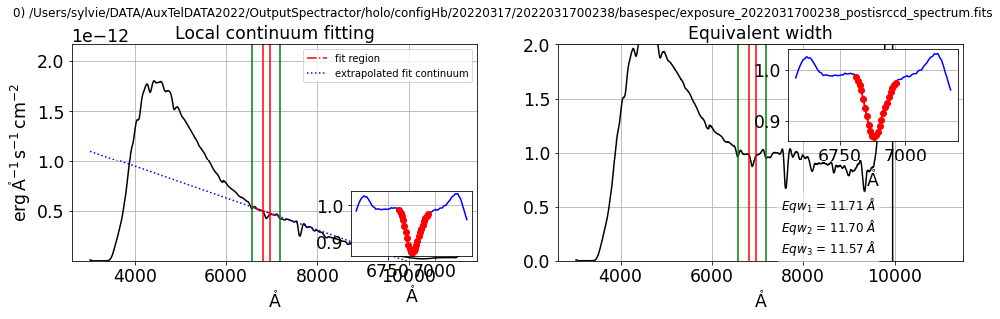

0 ) eqw_O2b= 11.57188797714492
1 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700244/basespec/exposure_2022031700244_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:54:16.312
set expo to 20.0
set airmass to 1.121576965054115
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1741806116248446
set dec to -32.3064444444444
set hour_angle to 31.60492174100415
set temperature to 8.9
set pressure to 743.45
set humidity to 49.0
set lambda_ref to 626.883564656571
set parallactic_angle to 94.10618686949074
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_92 PM_ERR_MINA_92 PM_ERR_ANGLE_92 Z_VALUE_92 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -----------

2022-04-09 19:11:09  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


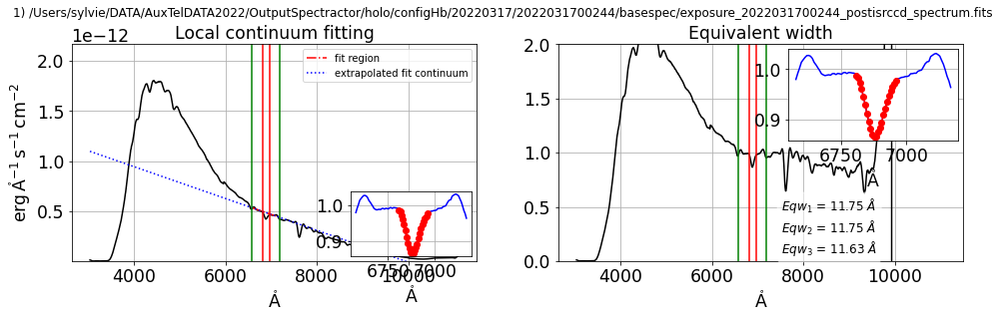

1 ) eqw_O2b= 11.630821996449901
2 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700245/basespec/exposure_2022031700245_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:54:49.235
set expo to 20.0
set airmass to 1.12272698054768
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1736210434249555
set dec to -32.3064444444444
set hour_angle to 31.7419273199217
set temperature to 8.8
set pressure to 743.4
set humidity to 49.0
set lambda_ref to 626.0378655266279
set parallactic_angle to 94.16305953909519
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_93 PM_ERR_MINA_93 PM_ERR_ANGLE_93 Z_VALUE_93 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ------------

2022-04-09 19:11:12  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


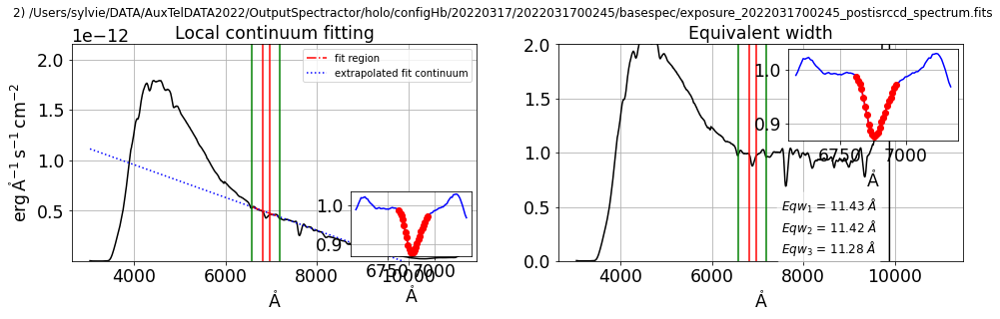

2 ) eqw_O2b= 11.281435969044958
3 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700251/basespec/exposure_2022031700251_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:57:47.565
set expo to 20.0
set airmass to 1.12910731186445
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1713060449152569
set dec to -32.3064444444444
set hour_angle to 32.4876824869983
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.4911208542796
set parallactic_angle to 94.47019502924495
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_94 PM_ERR_MINA_94 PM_ERR_ANGLE_94 Z_VALUE_94 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ------------

2022-04-09 19:11:14  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


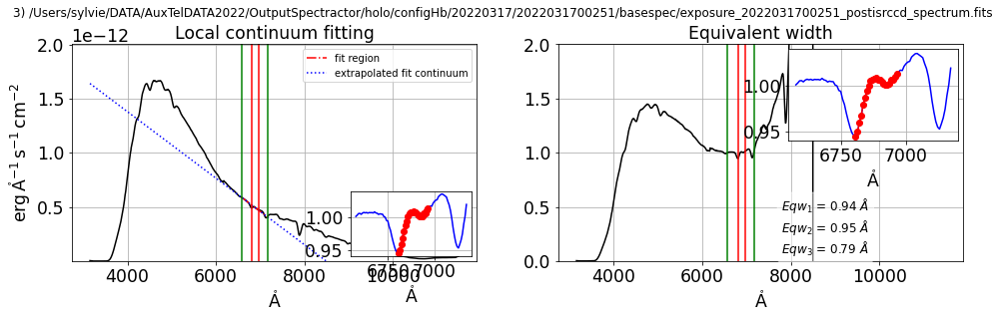

3 ) eqw_O2b= 0.7910305523890395
4 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700252/basespec/exposure_2022031700252_postisrccd_spectrum.fits
set date_obs to 2022-03-18T00:58:20.709
set expo to 20.0
set airmass to 1.130309156823195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.169943439836599
set dec to -32.3064444444444
set hour_angle to 32.6255240863161
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.2751365569749
set parallactic_angle to 94.52653019757676
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_95 PM_ERR_MINA_95 PM_ERR_ANGLE_95 Z_VALUE_95 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ------------

2022-04-09 19:11:17  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


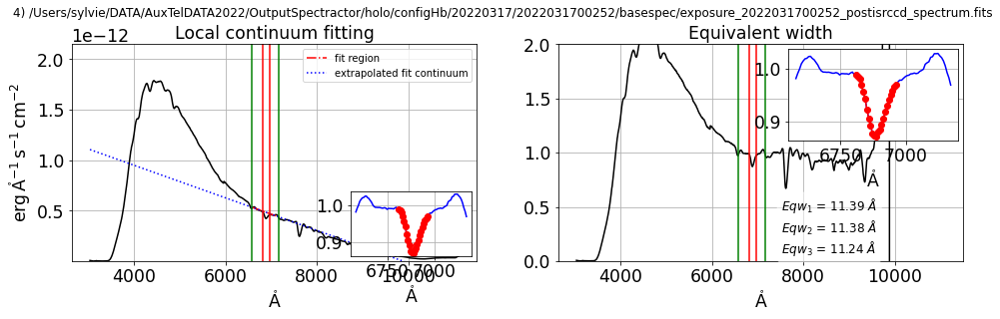

4 ) eqw_O2b= 11.240480012378653
5 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700265/basespec/exposure_2022031700265_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:04:49.716
set expo to 20.0
set airmass to 1.14502998698828
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1680537967029804
set dec to -32.3064444444444
set hour_angle to 34.25103021292454
set temperature to 8.9
set pressure to 743.3
set humidity to 53.0
set lambda_ref to 626.5383418087131
set parallactic_angle to 95.18153718788132
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_96 PM_ERR_MINA_96 PM_ERR_ANGLE_96 Z_VALUE_96 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -----------

2022-04-09 19:11:20  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


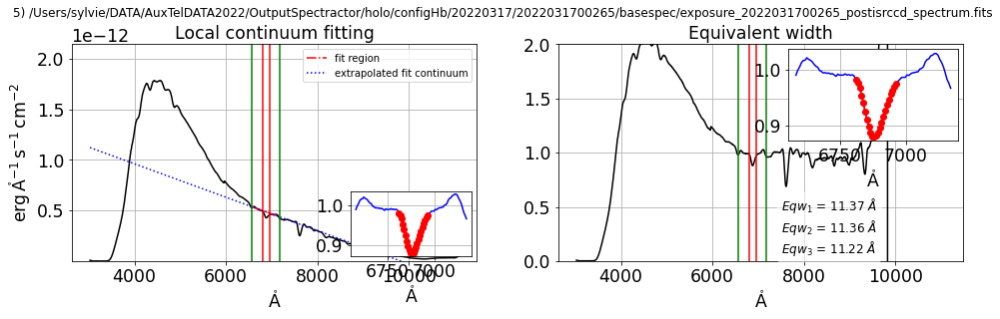

5 ) eqw_O2b= 11.220430058501778
6 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700272/basespec/exposure_2022031700272_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:08:18.080
set expo to 20.0
set airmass to 1.1533391050821
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.165620392992809
set dec to -32.3064444444444
set hour_angle to 35.12228883044955
set temperature to 8.9
set pressure to 743.3
set humidity to 51.0
set lambda_ref to 626.067912732114
set parallactic_angle to 95.52618006847594
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_97 PM_ERR_MINA_97 PM_ERR_ANGLE_97 Z_VALUE_97 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- --------------

2022-04-09 19:11:23  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


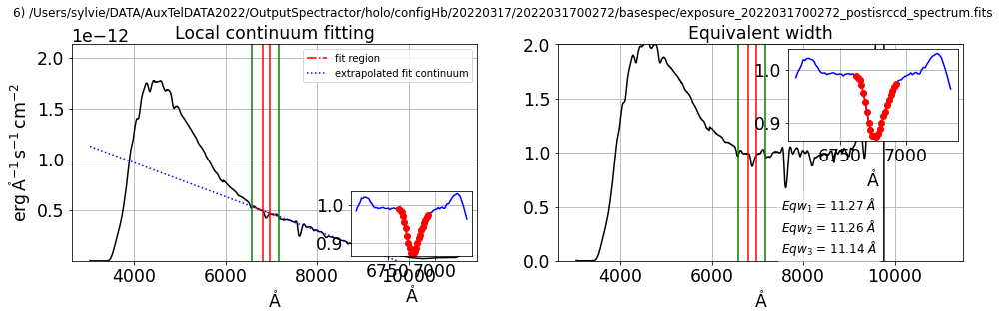

6 ) eqw_O2b= 11.140143758736233
7 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700273/basespec/exposure_2022031700273_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:08:50.992
set expo to 20.0
set airmass to 1.154683255421995
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1687630065527601
set dec to -32.3064444444444
set hour_angle to 35.26034049072464
set temperature to 8.9
set pressure to 743.35
set humidity to 51.0
set lambda_ref to 626.2488273411835
set parallactic_angle to 95.58041503368928
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_98 PM_ERR_MINA_98 PM_ERR_ANGLE_98 Z_VALUE_98 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- ---------

2022-04-09 19:11:25  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


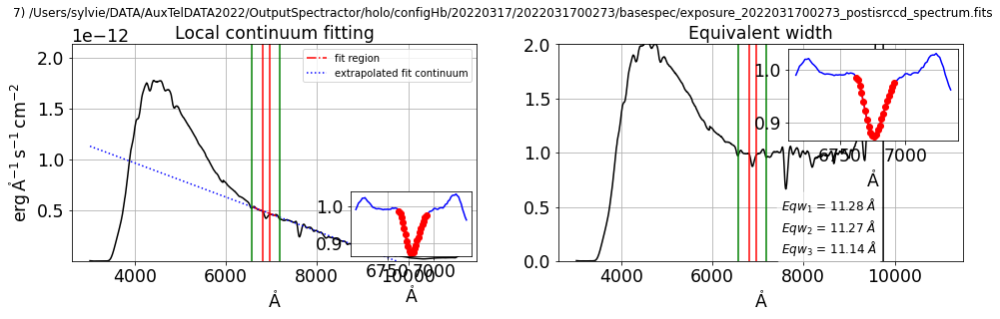

7 ) eqw_O2b= 11.140880046341884
8 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700279/basespec/exposure_2022031700279_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:11:46.031
set expo to 20.0
set airmass to 1.16193866550813
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1650200479066801
set dec to -32.3064444444444
set hour_angle to 35.99118130784399
set temperature to 8.9
set pressure to 743.4
set humidity to 53.0
set lambda_ref to 625.9517855761172
set parallactic_angle to 95.86593376321808
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_99 PM_ERR_MINA_99 PM_ERR_ANGLE_99 Z_VALUE_99 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...    mas / yr       mas / yr          deg                                  
--------- ------------- ------------- ------- -------- ... -------------- -----------

2022-04-09 19:11:28  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


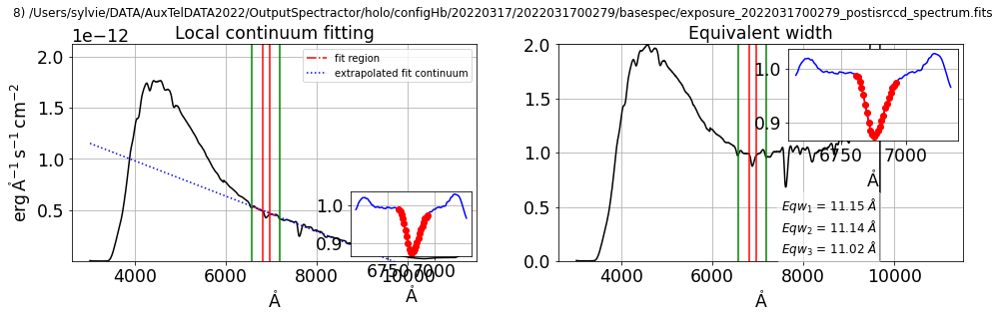

8 ) eqw_O2b= 11.015504523820091
9 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700286/basespec/exposure_2022031700286_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:15:18.583
set expo to 20.0
set airmass to 1.17105276018288
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1604530597215738
set dec to -32.3064444444444
set hour_angle to 36.87993052247099
set temperature to 8.9
set pressure to 743.45
set humidity to 54.0
set lambda_ref to 626.415954438991
set parallactic_angle to 96.20974235390722
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_100 PM_ERR_MINA_100 PM_ERR_ANGLE_100 Z_VALUE_100 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --

2022-04-09 19:11:31  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


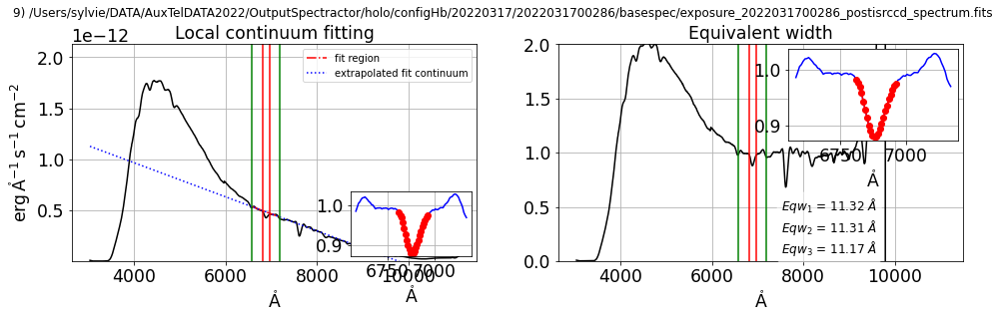

9 ) eqw_O2b= 11.167807632170545
10 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700293/basespec/exposure_2022031700293_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:18:45.526
set expo to 20.0
set airmass to 1.18024864471996
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.161506254140246
set dec to -32.3064444444444
set hour_angle to 37.74449227926539
set temperature to 9.0
set pressure to 743.45
set humidity to 53.0
set lambda_ref to 626.2661772674467
set parallactic_angle to 96.54092631927332
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_101 PM_ERR_MINA_101 PM_ERR_ANGLE_101 Z_VALUE_101 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- -

2022-04-09 19:11:33  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


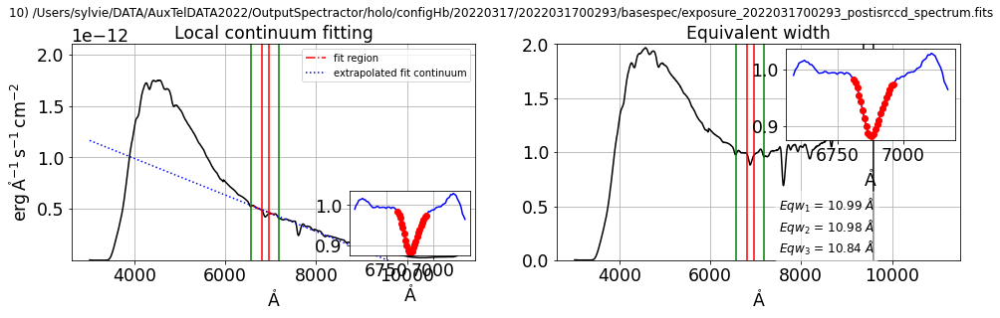

10 ) eqw_O2b= 10.835406449562491
11 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700300/basespec/exposure_2022031700300_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:22:16.238
set expo to 20.0
set airmass to 1.189962402398665
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1600582040885921
set dec to -32.3064444444444
set hour_angle to 38.6257061937975
set temperature to 8.9
set pressure to 743.4
set humidity to 56.0
set lambda_ref to 626.2915574183227
set parallactic_angle to 96.875483029922
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_102 PM_ERR_MINA_102 PM_ERR_ANGLE_102 Z_VALUE_102 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --

2022-04-09 19:11:36  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


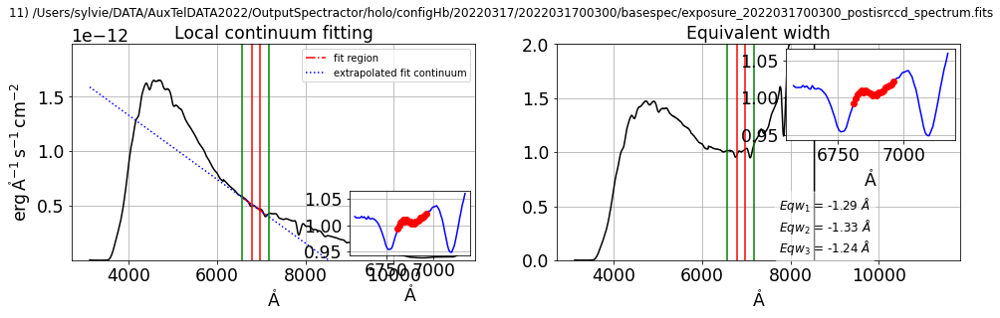

11 ) eqw_O2b= -1.2436456499000004
12 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700301/basespec/exposure_2022031700301_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:22:49.144
set expo to 20.0
set airmass to 1.191505368069865
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1585750124351514
set dec to -32.3064444444444
set hour_angle to 38.76271209839639
set temperature to 9.0
set pressure to 743.45
set humidity to 56.0
set lambda_ref to 626.4868452630084
set parallactic_angle to 96.92724413418016
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_103 PM_ERR_MINA_103 PM_ERR_ANGLE_103 Z_VALUE_103 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... -------------

2022-04-09 19:11:39  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


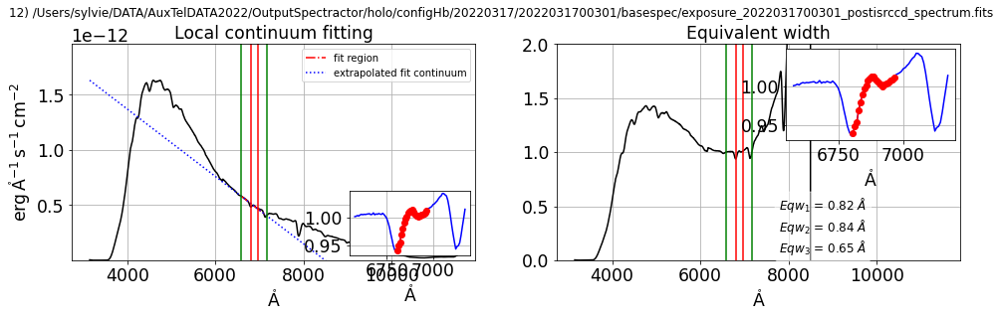

12 ) eqw_O2b= 0.6495333352847418
13 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700310/basespec/exposure_2022031700310_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:43:57.837
set expo to 20.0
set airmass to 1.25822658979951
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476502374643685
set dec to -32.3064444444444
set hour_angle to 44.06414790775874
set temperature to 8.8
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 626.6251269515418
set parallactic_angle to 98.88882683561982
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_104 PM_ERR_MINA_104 PM_ERR_ANGLE_104 Z_VALUE_104 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... ---------------

2022-04-09 19:11:42  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


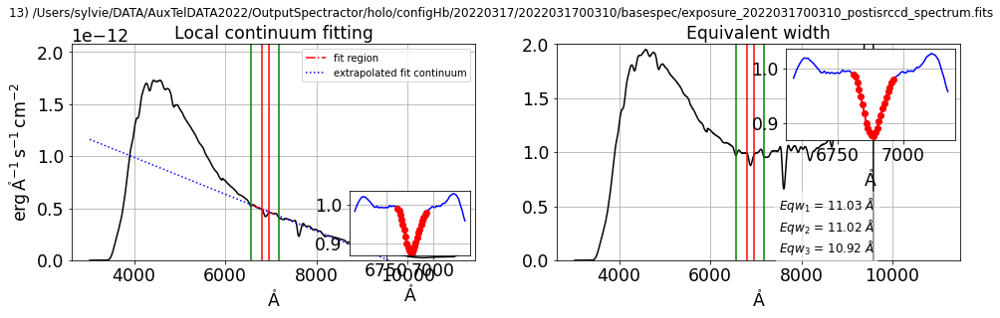

13 ) eqw_O2b= 10.92114808032995
14 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700316/basespec/exposure_2022031700316_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:46:52.361
set expo to 20.0
set airmass to 1.26858445121286
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476350630254128
set dec to -32.3064444444444
set hour_angle to 44.79438636254909
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 627.6256863262817
set parallactic_angle to 99.15414320783184
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_105 PM_ERR_MINA_105 PM_ERR_ANGLE_105 Z_VALUE_105 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- 

2022-04-09 19:11:44  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


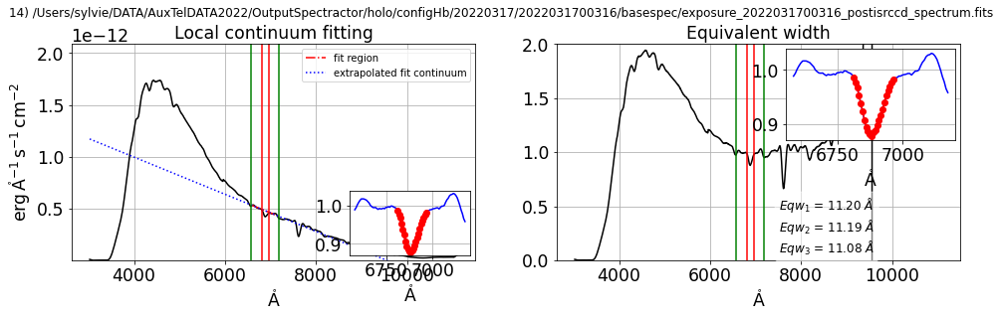

14 ) eqw_O2b= 11.084309091730319
15 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700317/basespec/exposure_2022031700317_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:47:25.256
set expo to 20.0
set airmass to 1.27056341471374
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1466645118411156
set dec to -32.3064444444444
set hour_angle to 44.9315970155517
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 625.7408027741238
set parallactic_angle to 99.2038979478238
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_106 PM_ERR_MINA_106 PM_ERR_ANGLE_106 Z_VALUE_106 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- -

2022-04-09 19:11:47  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


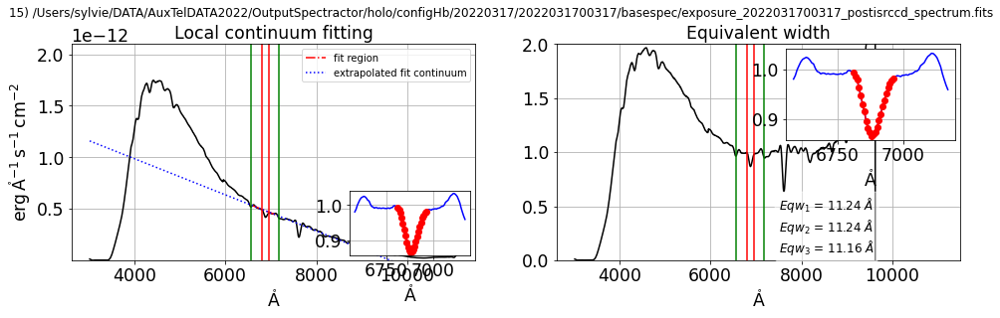

15 ) eqw_O2b= 11.158370671593104
16 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700330/basespec/exposure_2022031700330_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:53:46.736
set expo to 20.0
set airmass to 1.294394244363805
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1444547716136137
set dec to -32.3064444444444
set hour_angle to 46.52581667330039
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.9120383005036
set parallactic_angle to 99.77999069166285
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_107 PM_ERR_MINA_107 PM_ERR_ANGLE_107 Z_VALUE_107 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... ---------------

2022-04-09 19:11:50  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


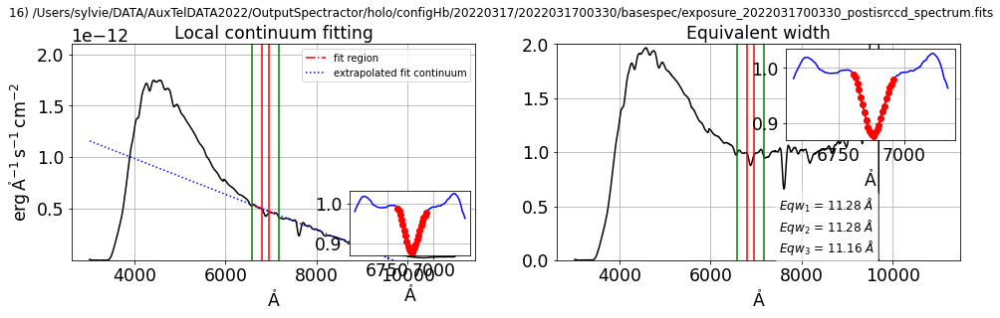

16 ) eqw_O2b= 11.164249308617997
17 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700331/basespec/exposure_2022031700331_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:54:19.724
set expo to 20.0
set airmass to 1.29652271576687
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1441648974084375
set dec to -32.3064444444444
set hour_angle to 46.6628171725209
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.7462807078947
set parallactic_angle to 99.82934304254884
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_108 PM_ERR_MINA_108 PM_ERR_ANGLE_108 Z_VALUE_108 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- -

2022-04-09 19:11:53  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


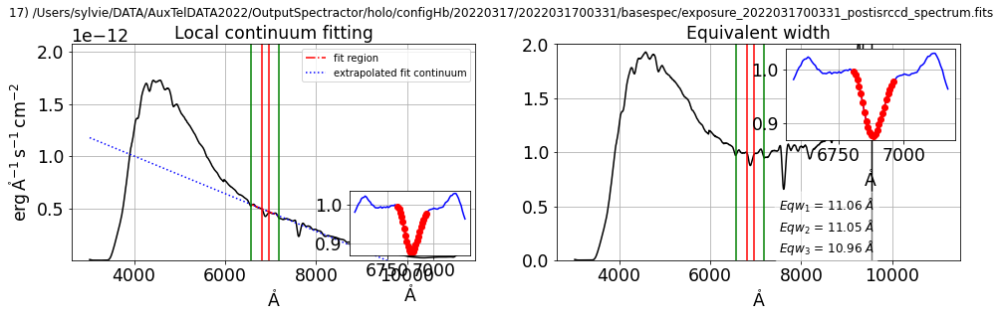

17 ) eqw_O2b= 10.960758519807206
18 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700338/basespec/exposure_2022031700338_postisrccd_spectrum.fits
set date_obs to 2022-03-18T01:57:49.306
set expo to 20.0
set airmass to 1.31035777011874
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1437462230173573
set dec to -32.3064444444444
set hour_angle to 47.53898537176394
set temperature to 8.7
set pressure to 743.45
set humidity to 57.0
set lambda_ref to 628.9551099539515
set parallactic_angle to 100.14447493807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_109 PM_ERR_MINA_109 PM_ERR_ANGLE_109 Z_VALUE_109 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- -

2022-04-09 19:11:56  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


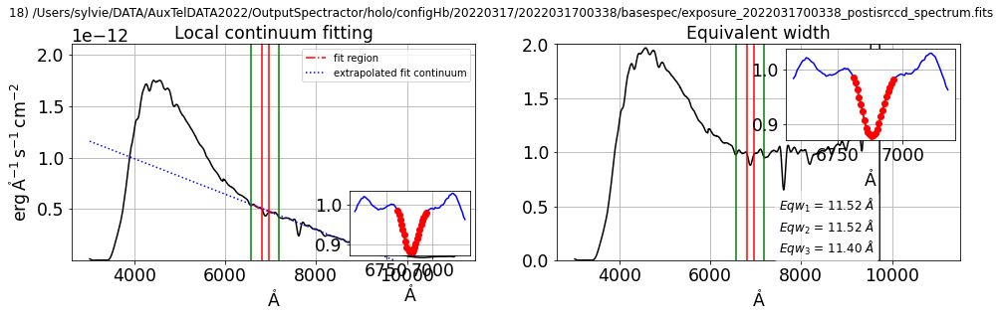

18 ) eqw_O2b= 11.399912697895855
19 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700345/basespec/exposure_2022031700345_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:01:19.196
set expo to 20.0
set airmass to 1.324716687989025
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1392710710370809
set dec to -32.3064444444444
set hour_angle to 48.4163008821963
set temperature to 8.6
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 626.8625000130343
set parallactic_angle to 100.4592627484374
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_110 PM_ERR_MINA_110 PM_ERR_ANGLE_110 Z_VALUE_110 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... ---------------

2022-04-09 19:11:59  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


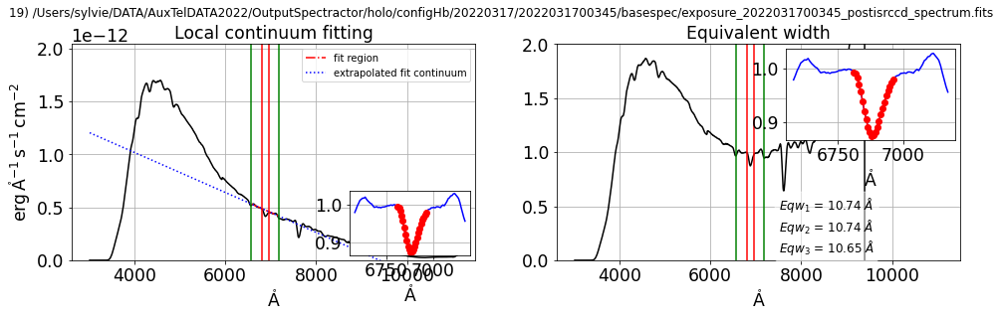

19 ) eqw_O2b= 10.647588276955812
20 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700351/basespec/exposure_2022031700351_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:04:16.794
set expo to 20.0
set airmass to 1.33727547076682
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1388486262435704
set dec to -32.3064444444444
set hour_angle to 49.15879882143194
set temperature to 8.5
set pressure to 743.45
set humidity to 58.0
set lambda_ref to 628.5424256920012
set parallactic_angle to 100.7251843777299
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_111 PM_ERR_MINA_111 PM_ERR_ANGLE_111 Z_VALUE_111 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... ---------------

2022-04-09 19:12:02  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


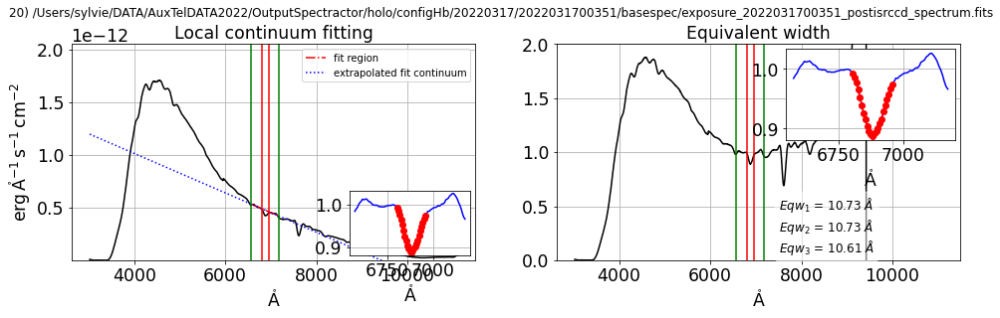

20 ) eqw_O2b= 10.60954170804492
21 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700352/basespec/exposure_2022031700352_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:04:49.712
set expo to 20.0
set airmass to 1.33963651479802
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1368681187146323
set dec to -32.3064444444444
set hour_angle to 49.29580448438519
set temperature to 8.5
set pressure to 743.35
set humidity to 58.0
set lambda_ref to 628.2086674961155
set parallactic_angle to 100.7742095756281
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_112 PM_ERR_MINA_112 PM_ERR_ANGLE_112 Z_VALUE_112 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- 

2022-04-09 19:12:05  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


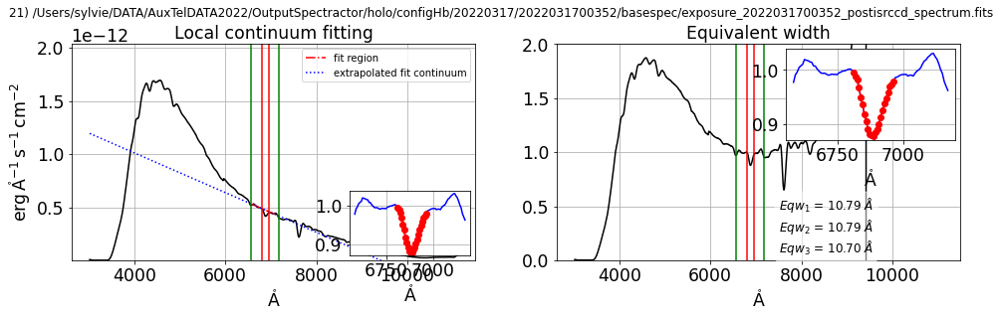

21 ) eqw_O2b= 10.701302262741851
22 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700358/basespec/exposure_2022031700358_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:07:49.074
set expo to 20.0
set airmass to 1.352787300037425
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1331931685876357
set dec to -32.3064444444444
set hour_angle to 50.04587365708529
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 627.9591693143808
set parallactic_angle to 101.0424069948098
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_113 PM_ERR_MINA_113 PM_ERR_ANGLE_113 Z_VALUE_113 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... ---------------

2022-04-09 19:12:08  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


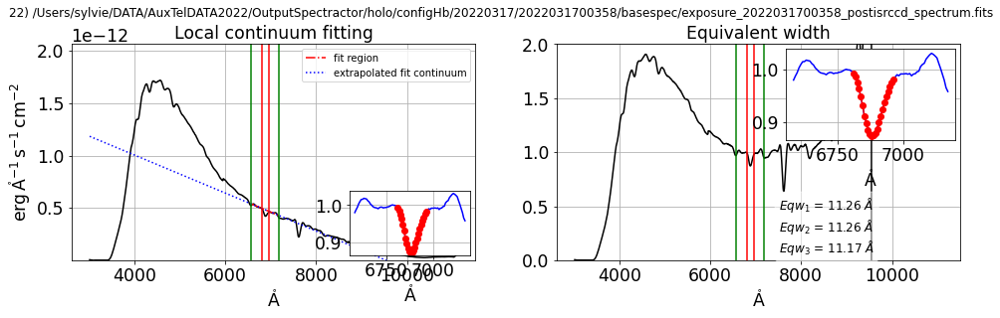

22 ) eqw_O2b= 11.169752487241748
23 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700365/basespec/exposure_2022031700365_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:11:20.051
set expo to 20.0
set airmass to 1.368765631503195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1336440841342464
set dec to -32.3064444444444
set hour_angle to 50.92719907664954
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 622.7051672626101
set parallactic_angle to 101.357174452077
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_114 PM_ERR_MINA_114 PM_ERR_ANGLE_114 Z_VALUE_114 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- 

2022-04-09 19:12:11  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


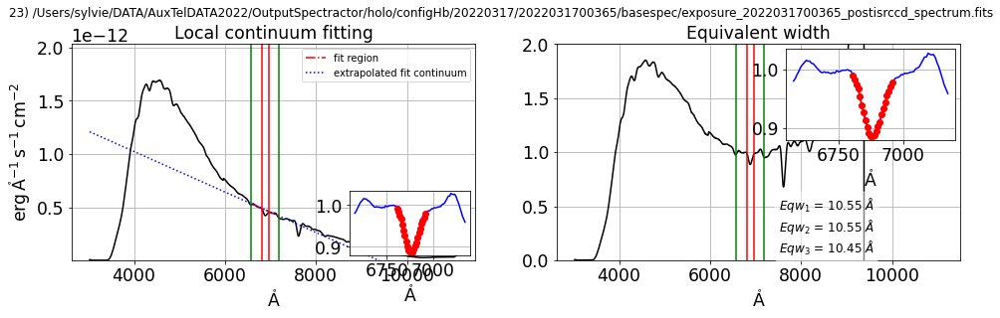

23 ) eqw_O2b= 10.446048216231167
24 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700366/basespec/exposure_2022031700366_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:11:53.006
set expo to 20.0
set airmass to 1.371319339871885
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1369079175197151
set dec to -32.3064444444444
set hour_angle to 51.06504024257939
set temperature to 8.4
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 629.1845159477502
set parallactic_angle to 101.4063764649771
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_115 PM_ERR_MINA_115 PM_ERR_ANGLE_115 Z_VALUE_115 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------

2022-04-09 19:12:15  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


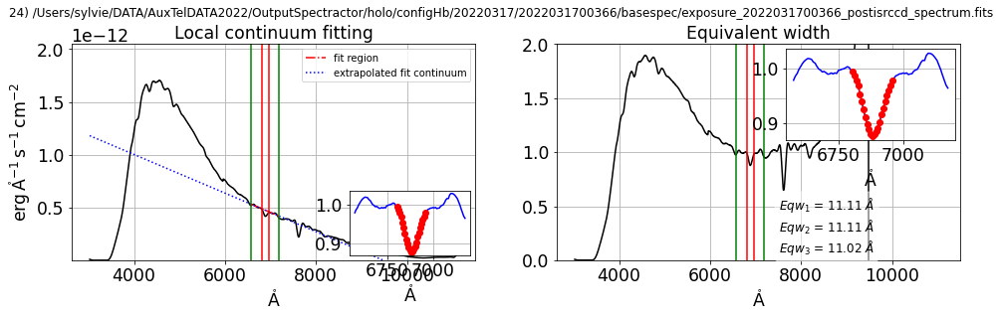

24 ) eqw_O2b= 11.01850226848873
25 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700372/basespec/exposure_2022031700372_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:14:46.798
set expo to 20.0
set airmass to 1.38501167017706
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1310814762516916
set dec to -32.3064444444444
set hour_angle to 51.79156958975715
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.5245232921197
set parallactic_angle to 101.6656129875546
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_116 PM_ERR_MINA_116 PM_ERR_ANGLE_116 Z_VALUE_116 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- 

2022-04-09 19:12:18  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


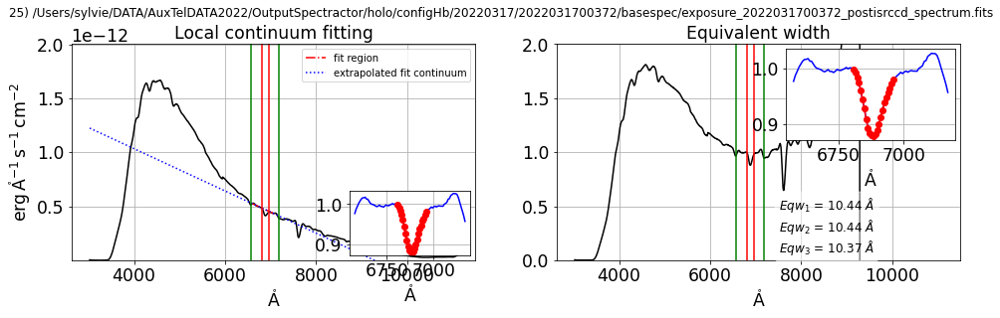

25 ) eqw_O2b= 10.371382171482505
26 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700373/basespec/exposure_2022031700373_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:15:19.743
set expo to 20.0
set airmass to 1.387649936190795
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1317245037126307
set dec to -32.3064444444444
set hour_angle to 51.92878009828319
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.9968889639981
set parallactic_angle to 101.7145568247823
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_117 PM_ERR_MINA_117 PM_ERR_ANGLE_117 Z_VALUE_117 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------

2022-04-09 19:12:20  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


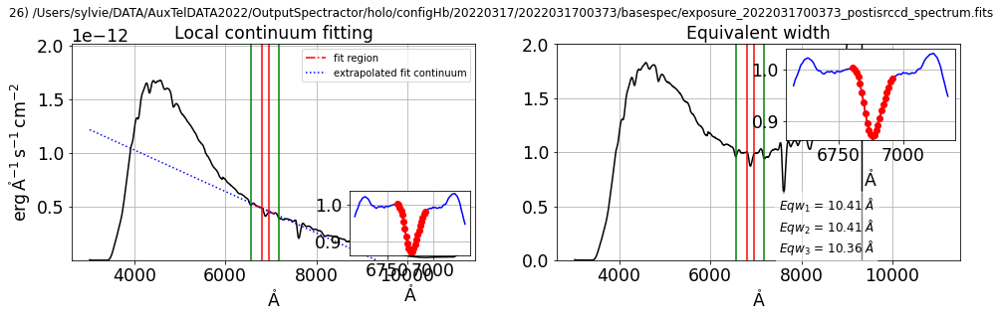

26 ) eqw_O2b= 10.357649858718442
27 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700380/basespec/exposure_2022031700380_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:33:33.012
set expo to 20.0
set airmass to 1.48452422171666
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1197628273916148
set dec to -32.3064444444444
set hour_angle to 56.49902324990354
set temperature to 8.0
set pressure to 743.35
set humidity to 63.0
set lambda_ref to 628.5888123380201
set parallactic_angle to 103.3450343494105
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_118 PM_ERR_MINA_118 PM_ERR_ANGLE_118 Z_VALUE_118 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... ---------------

2022-04-09 19:12:23  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


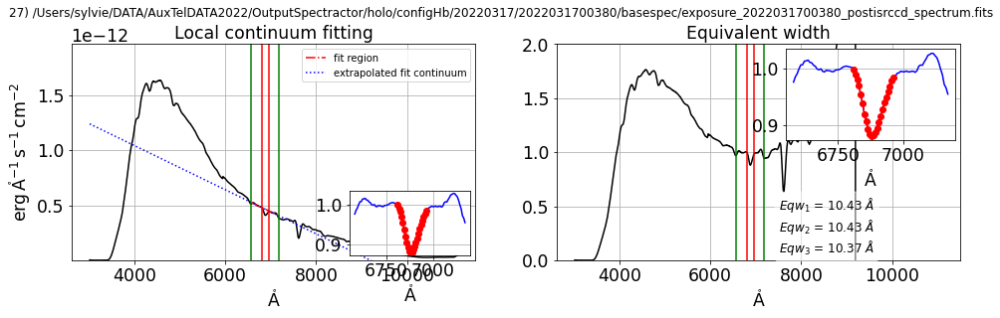

27 ) eqw_O2b= 10.36761491388443
28 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700386/basespec/exposure_2022031700386_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:36:30.874
set expo to 20.0
set airmass to 1.50213593383469
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1172584274998106
set dec to -32.3064444444444
set hour_angle to 57.24247377715349
set temperature to 8.1
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 633.8101508297243
set parallactic_angle to 103.6108187575918
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_119 PM_ERR_MINA_119 PM_ERR_ANGLE_119 Z_VALUE_119 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- 

2022-04-09 19:12:27  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


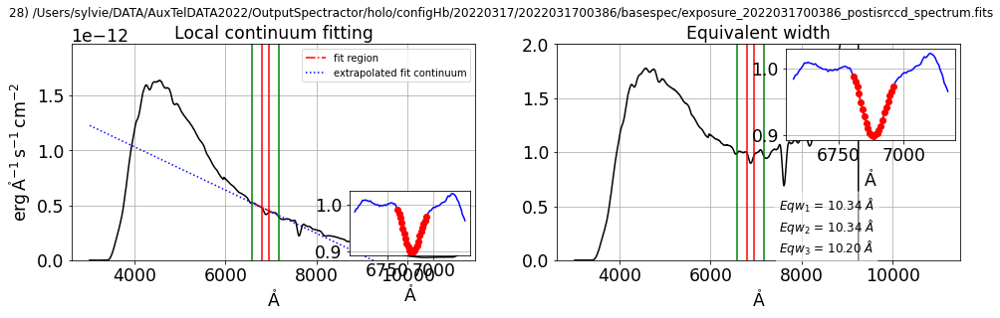

28 ) eqw_O2b= 10.204943754351701
29 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700387/basespec/exposure_2022031700387_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:37:03.815
set expo to 20.0
set airmass to 1.50545657928364
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1211335036558286
set dec to -32.3064444444444
set hour_angle to 57.37947904087095
set temperature to 8.1
set pressure to 743.35
set humidity to 64.0
set lambda_ref to 628.2172036981787
set parallactic_angle to 103.6598297048832
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_120 PM_ERR_MINA_120 PM_ERR_ANGLE_120 Z_VALUE_120 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... ---------------

2022-04-09 19:12:30  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


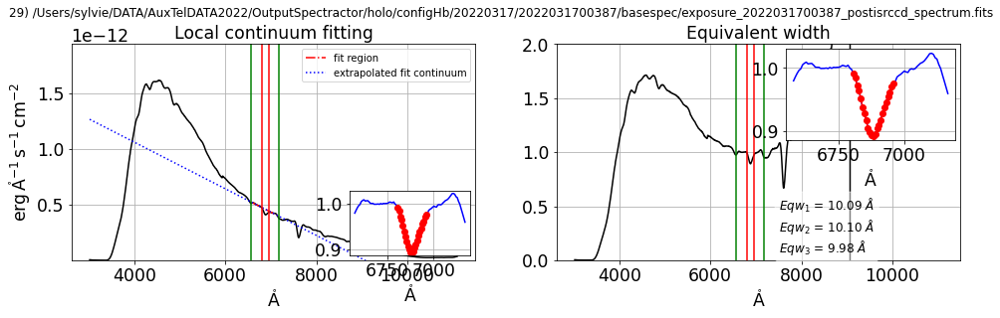

29 ) eqw_O2b= 9.978013021499194
30 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700393/basespec/exposure_2022031700393_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:40:00.839
set expo to 20.0
set airmass to 1.523657512515415
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1177429780701742
set dec to -32.3064444444444
set hour_angle to 58.11949120092164
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.3577400172557
set parallactic_angle to 103.9247454603291
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_121 PM_ERR_MINA_121 PM_ERR_ANGLE_121 Z_VALUE_121 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- 

2022-04-09 19:12:33  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


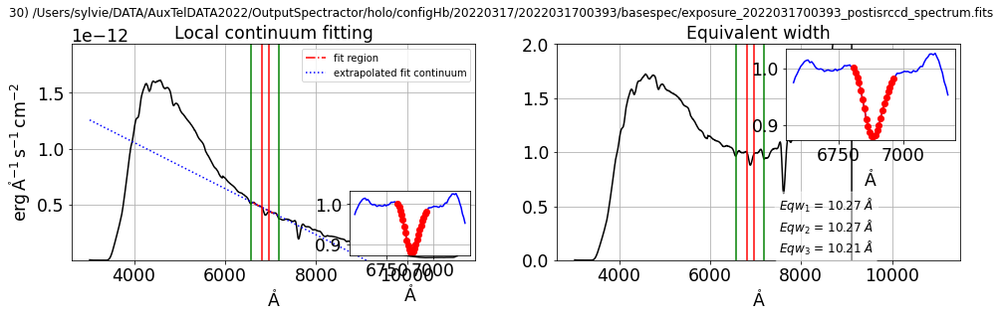

30 ) eqw_O2b= 10.208218053773857
31 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700394/basespec/exposure_2022031700394_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:40:33.787
set expo to 20.0
set airmass to 1.527114954027915
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1169167488860146
set dec to -32.3064444444444
set hour_angle to 58.25733391386269
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.7847433714671
set parallactic_angle to 103.9741296646409
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_122 PM_ERR_MINA_122 PM_ERR_ANGLE_122 Z_VALUE_122 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... ---------------

2022-04-09 19:12:36  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


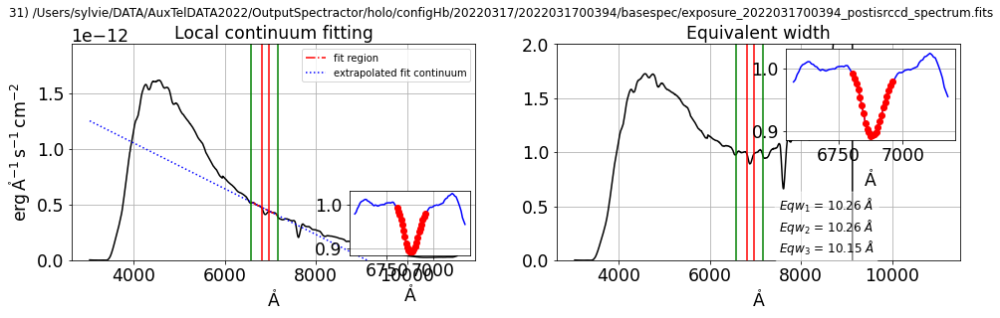

31 ) eqw_O2b= 10.152772179548535
32 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700401/basespec/exposure_2022031700401_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:44:05.105
set expo to 20.0
set airmass to 1.54976447202586
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1144055844584487
set dec to -32.3064444444444
set hour_angle to 59.14046723526914
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 629.2826348266267
set parallactic_angle to 104.2908413745483
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_123 PM_ERR_MINA_123 PM_ERR_ANGLE_123 Z_VALUE_123 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... ---------------

2022-04-09 19:12:39  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


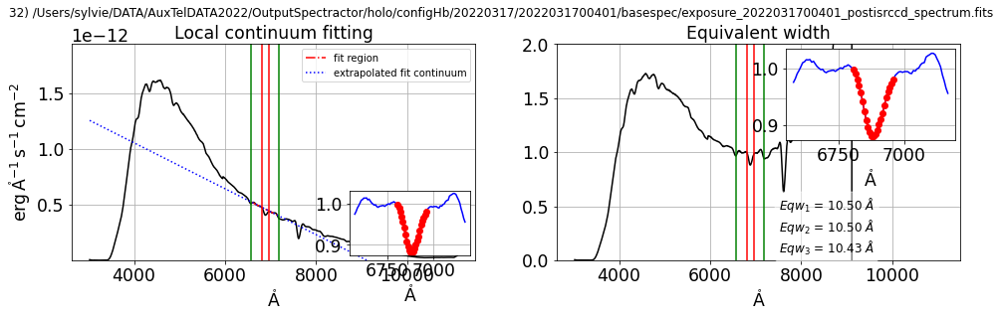

32 ) eqw_O2b= 10.426847550710242
33 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700407/basespec/exposure_2022031700407_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:47:02.835
set expo to 20.0
set airmass to 1.56951976624838
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.113192412444726
set dec to -32.3064444444444
set hour_angle to 59.88301895711849
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 623.392411114623
set parallactic_angle to 104.5576025273592
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_124 PM_ERR_MINA_124 PM_ERR_ANGLE_124 Z_VALUE_124 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --

2022-04-09 19:12:42  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


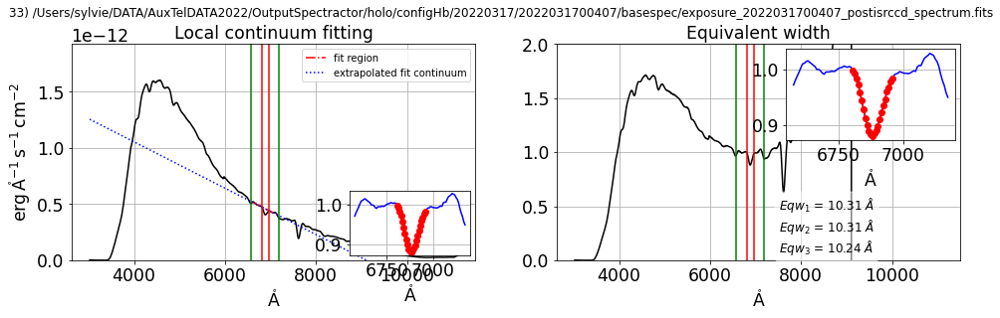

33 ) eqw_O2b= 10.240122068961666
34 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700408/basespec/exposure_2022031700408_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:47:35.769
set expo to 20.0
set airmass to 1.573248011911855
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1127873058479127
set dec to -32.3064444444444
set hour_angle to 60.02106934614464
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 624.3168639615992
set parallactic_angle to 104.6072480488688
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_125 PM_ERR_MINA_125 PM_ERR_ANGLE_125 Z_VALUE_125 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------

2022-04-09 19:12:45  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


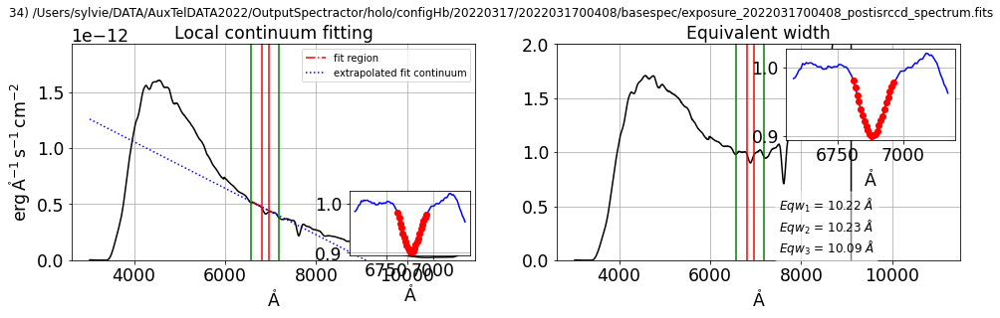

34 ) eqw_O2b= 10.086790454611195
35 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700414/basespec/exposure_2022031700414_postisrccd_spectrum.fits
set date_obs to 2022-03-18T02:50:38.306
set expo to 20.0
set airmass to 1.594345273370295
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1038057563272595
set dec to -32.3064444444444
set hour_angle to 60.78322641711044
set temperature to 8.0
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 625.6140852852044
set parallactic_angle to 104.8816435668321
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_126 PM_ERR_MINA_126 PM_ERR_ANGLE_126 Z_VALUE_126 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------

2022-04-09 19:12:49  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


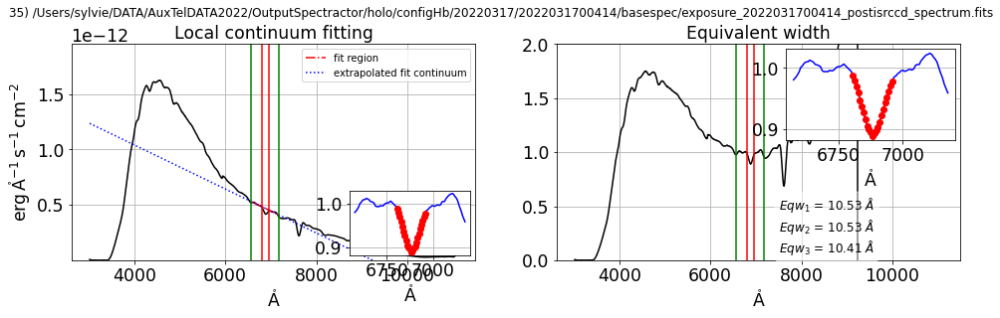

35 ) eqw_O2b= 10.412934111932447
36 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700421/basespec/exposure_2022031700421_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:08:41.573
set expo to 20.0
set airmass to 1.73594131895663
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09058150608401207
set dec to -32.3064444444444
set hour_angle to 65.3119392087705
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 631.9889212287092
set parallactic_angle to 106.5252810168807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_127 PM_ERR_MINA_127 PM_ERR_ANGLE_127 Z_VALUE_127 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- 

2022-04-09 19:12:52  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


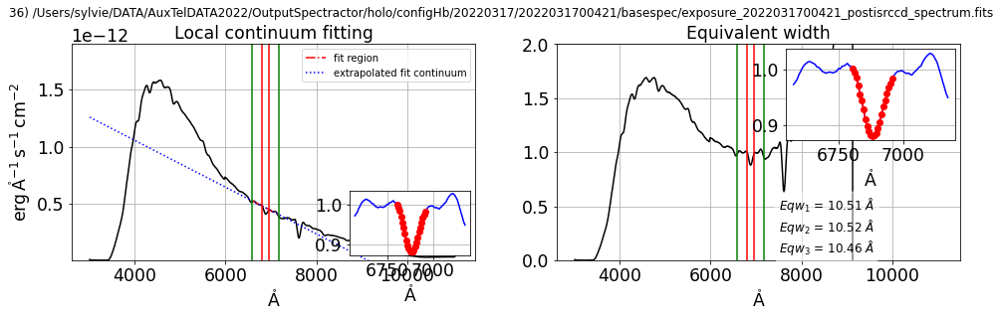

36 ) eqw_O2b= 10.457052277950853
37 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700422/basespec/exposure_2022031700422_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:09:14.484
set expo to 20.0
set airmass to 1.740715384660955
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09733707671582016
set dec to -32.3064444444444
set hour_angle to 65.44894264967655
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 625.9596270530473
set parallactic_angle to 106.5754178018598
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_128 PM_ERR_MINA_128 PM_ERR_ANGLE_128 Z_VALUE_128 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------

2022-04-09 19:12:55  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


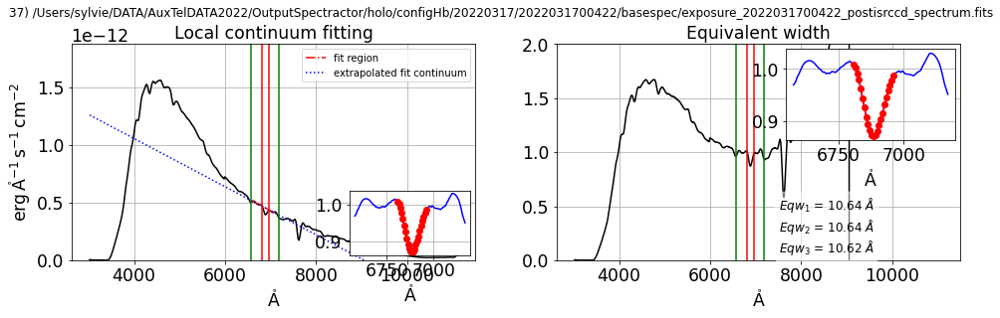

37 ) eqw_O2b= 10.617372469530649
38 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700428/basespec/exposure_2022031700428_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:12:54.310
set expo to 20.0
set airmass to 2.129245852899135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.143944791309082
set dec to -87.4721944444444
set hour_angle to -155.5929780702915
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 686.0625390317258
set parallactic_angle to -156.1678055894986
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_129 PM_ERR_MINA_129 PM_ERR_ANGLE_129 Z_VALUE_129 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... -----------

2022-04-09 19:12:58  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


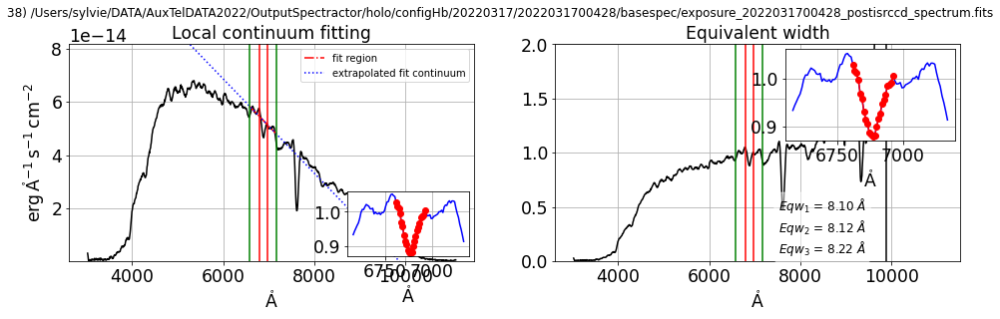

38 ) eqw_O2b= 8.216690212253523
39 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700429/basespec/exposure_2022031700429_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:13:27.208
set expo to 20.0
set airmass to 2.1290679262036
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09887590360164929
set dec to -87.4721944444444
set hour_angle to -155.455137691263
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 636.4362643500099
set parallactic_angle to -156.0330469936088
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_130 PM_ERR_MINA_130 PM_ERR_ANGLE_130 Z_VALUE_130 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... -------------

2022-04-09 19:13:01  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


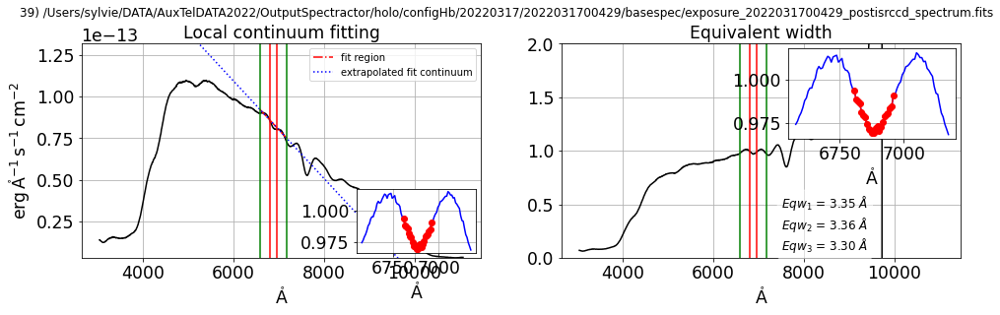

39 ) eqw_O2b= 3.295065695120721
40 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700435/basespec/exposure_2022031700435_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:17:06.794
set expo to 20.0
set airmass to 1.81309435755974
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09210139501009447
set dec to -32.3064444444444
set hour_angle to 67.42354300312304
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 626.8738274489511
set parallactic_angle to 107.3011935159837
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_131 PM_ERR_MINA_131 PM_ERR_ANGLE_131 Z_VALUE_131 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... ---------------

2022-04-09 19:13:05  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


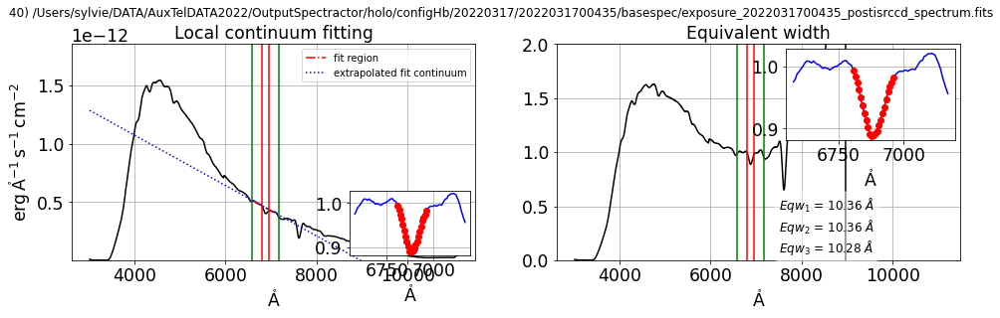

40 ) eqw_O2b= 10.275043264836581
41 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700436/basespec/exposure_2022031700436_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:17:39.779
set expo to 20.0
set airmass to 1.818418067455135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.08344429603447075
set dec to -32.3064444444444
set hour_angle to 67.56159248336594
set temperature to 7.7
set pressure to 743.4
set humidity to 63.0
set lambda_ref to 632.4252252976918
set parallactic_angle to 107.3521665962106
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_132 PM_ERR_MINA_132 PM_ERR_ANGLE_132 Z_VALUE_132 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------

2022-04-09 19:13:08  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


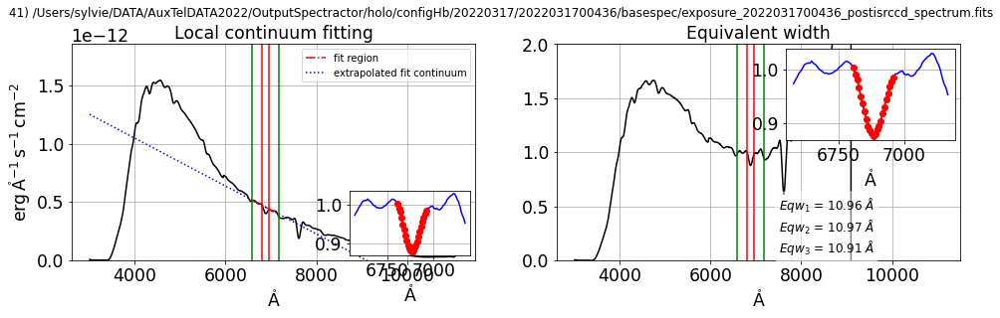

41 ) eqw_O2b= 10.914815643685007
42 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700442/basespec/exposure_2022031700442_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:21:26.873
set expo to 20.0
set airmass to 1.856070090955285
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.06347269052355019
set dec to -32.3064444444444
set hour_angle to 68.51099093135984
set temperature to 7.8
set pressure to 743.4
set humidity to 62.0
set lambda_ref to 630.0633085655397
set parallactic_angle to 107.7035936917225
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_133 PM_ERR_MINA_133 PM_ERR_ANGLE_133 Z_VALUE_133 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------

2022-04-09 19:13:11  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


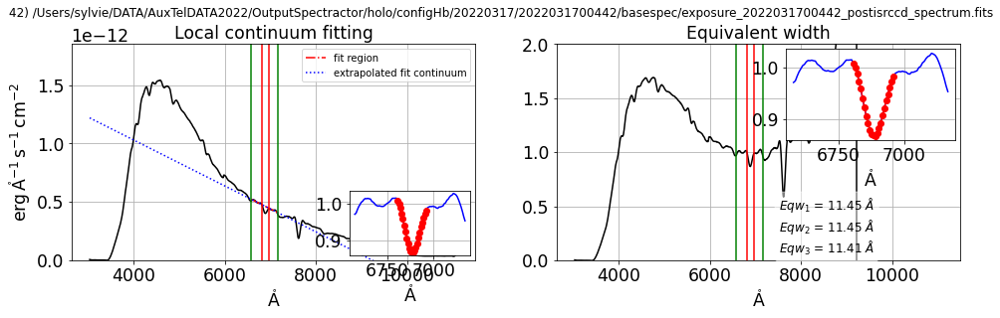

42 ) eqw_O2b= 11.412750089187544
43 )  /Users/sylvie/DATA/AuxTelDATA2022/OutputSpectractor/holo/configHb/20220317/2022031700443/basespec/exposure_2022031700443_postisrccd_spectrum.fits
set date_obs to 2022-03-18T03:21:59.878
set expo to 20.0
set airmass to 1.861691550345225
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.0769189759908508
set dec to -32.3064444444444
set hour_angle to 68.64883074724754
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 633.3015467495994
set parallactic_angle to 107.7547458765076
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_134 PM_ERR_MINA_134 PM_ERR_ANGLE_134 Z_VALUE_134 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------

2022-04-09 19:13:15  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


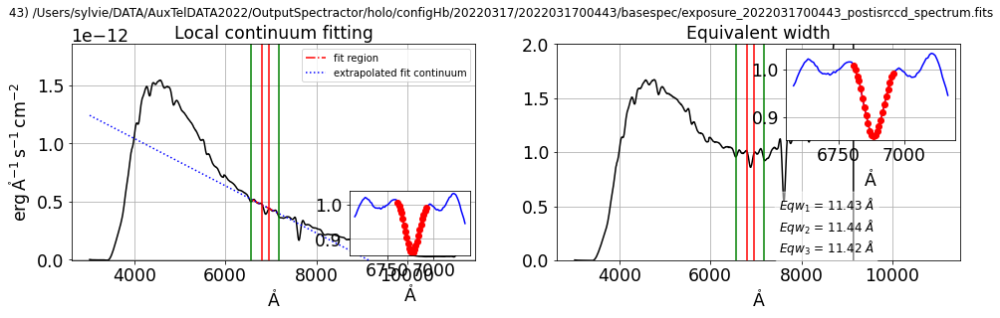

43 ) eqw_O2b= 11.424206914854103


In [121]:
WLMIN=300
WLMAX=1000
lambdas = np.arange(WLMIN,WLMAX,1)
fwhm_func = interp1d(lambdas, 0.01 * lambdas)
parameters.DISPLAY=False


for IDXSEL in np.arange(0,NN):

    
    
    filename_SEL=all_good_spectra_spectrum_files[IDXSEL]
    filename_spectrogram_SEL=filename_SEL.replace("_spectrum","_spectrogram")
    fullfilename_SEL = os.path.join(dir_spectra,filename_SEL)
    fullfilename_spectrogram_SEL = fullfilename_SEL.replace("_spectrum","_spectrogram")
    
    # load the spectrum
    
    print(IDXSEL,") ",filename_SEL)
    
    s=Spectrum(fullfilename_SEL, config=config)
    s.load_spectrogram(fullfilename_spectrogram_SEL) 
    
    
    lamb = 10*s.lambdas * u.AA 
    flux = s.data * u.Unit('erg cm-2 s-1 AA-1')/10 
    spec = Spectrum1D(spectral_axis=lamb, flux=flux) 
    fluxerr = s.err * u.Unit('erg cm-2 s-1 AA-1')/10. 
    specerr = Spectrum1D(spectral_axis=lamb, flux=fluxerr)
    
    # O2 line
    # wlmin=10*(O2_1.wavelength-30)*u.AA
    #wlmax=10*(O2_1.wavelength+30)*u.AA
    #wlminline=10*(O2_1.wavelength-10)*u.AA
    #wlmaxline=10*(O2_1.wavelength+10)*u.AA
    
    
    wlmin = wlmin_o2b
    wlmax = wlmax_o2b
    wlminline = wlminline_o2b
    wlmaxline = wlmaxline_o2b
    
    
    fig=plt.figure(figsize=(16,4))
    ax1 = fig.add_subplot(1, 2, 1)
    ax2 = fig.add_subplot(1, 2, 2)
    #eq1,eq2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    eq1,eq2,eq3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    #eqw10,eqw20,eq1_set,eq2_set=ComputeEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=20,flag_plot=True,ax1=ax1,ax2=ax2)
    thetitle=str(IDXSEL)+") "+filename_SEL
    plt.suptitle(thetitle,y=1.01)
    plt.show() 
    
    print(IDXSEL,") eqw_O2b=",eq3)
    
    df_infos.at[IDXSEL,"eqw_o2b"] =  eq3


## LOOP on H2O line

set date_obs to 2022-03-18T00:51:22.049
set expo to 20.0
set airmass to 1.11557476948966
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1753951396614214
set dec to -32.3064444444444
set hour_angle to 30.8762989508295
set temperature to 8.9
set pressure to 743.45
set humidity to 48.0
set lambda_ref to 626.6801216985461
set parallactic_angle to 93.8012496664173
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_135 PM_ERR_MINA_135 PM_ERR_ANGLE_135 Z_VALUE_135 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110               90   0.0003640     

2022-04-09 19:13:18  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


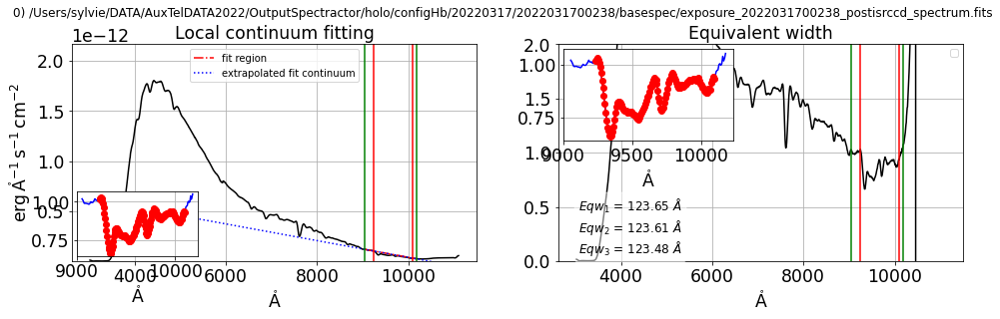

0 ) eqw_h2o= 123.48447765075497
set date_obs to 2022-03-18T00:54:16.312
set expo to 20.0
set airmass to 1.121576965054115
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1741806116248446
set dec to -32.3064444444444
set hour_angle to 31.60492174100415
set temperature to 8.9
set pressure to 743.45
set humidity to 49.0
set lambda_ref to 626.883564656571
set parallactic_angle to 94.10618686949074
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_136 PM_ERR_MINA_136 PM_ERR_ANGLE_136 Z_VALUE_136 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:13:22  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


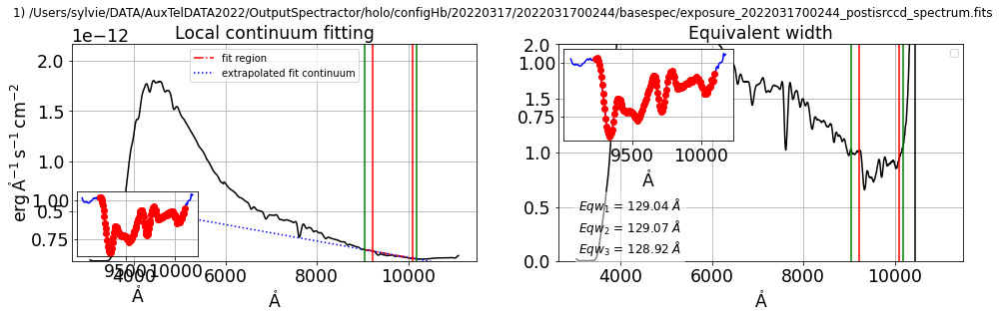

1 ) eqw_h2o= 128.92103831565927
set date_obs to 2022-03-18T00:54:49.235
set expo to 20.0
set airmass to 1.12272698054768
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1736210434249555
set dec to -32.3064444444444
set hour_angle to 31.7419273199217
set temperature to 8.8
set pressure to 743.4
set humidity to 49.0
set lambda_ref to 626.0378655266279
set parallactic_angle to 94.16305953909519
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_137 PM_ERR_MINA_137 PM_ERR_ANGLE_137 Z_VALUE_137 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110  

2022-04-09 19:13:25  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


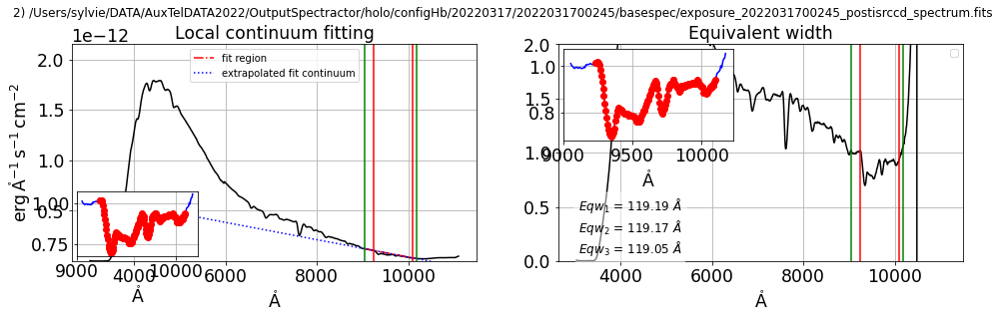

2 ) eqw_h2o= 119.04837785849027
set date_obs to 2022-03-18T00:57:47.565
set expo to 20.0
set airmass to 1.12910731186445
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1713060449152569
set dec to -32.3064444444444
set hour_angle to 32.4876824869983
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.4911208542796
set parallactic_angle to 94.47019502924495
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_138 PM_ERR_MINA_138 PM_ERR_ANGLE_138 Z_VALUE_138 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110  

2022-04-09 19:13:28  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


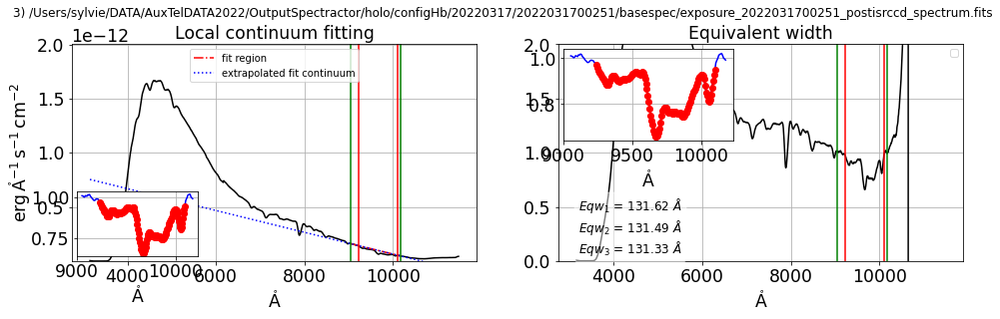

3 ) eqw_h2o= 131.32772359576884
set date_obs to 2022-03-18T00:58:20.709
set expo to 20.0
set airmass to 1.130309156823195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.169943439836599
set dec to -32.3064444444444
set hour_angle to 32.6255240863161
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.2751365569749
set parallactic_angle to 94.52653019757676
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_139 PM_ERR_MINA_139 PM_ERR_ANGLE_139 Z_VALUE_139 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110  

2022-04-09 19:13:32  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


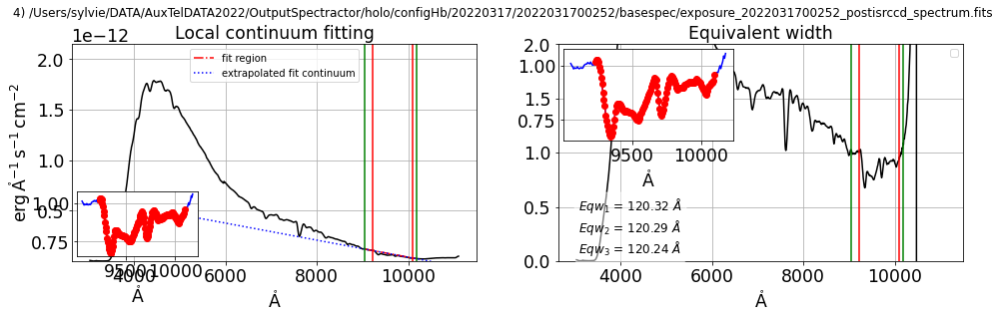

4 ) eqw_h2o= 120.23536317079973
set date_obs to 2022-03-18T01:04:49.716
set expo to 20.0
set airmass to 1.14502998698828
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1680537967029804
set dec to -32.3064444444444
set hour_angle to 34.25103021292454
set temperature to 8.9
set pressure to 743.3
set humidity to 53.0
set lambda_ref to 626.5383418087131
set parallactic_angle to 95.18153718788132
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_140 PM_ERR_MINA_140 PM_ERR_ANGLE_140 Z_VALUE_140 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:13:35  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


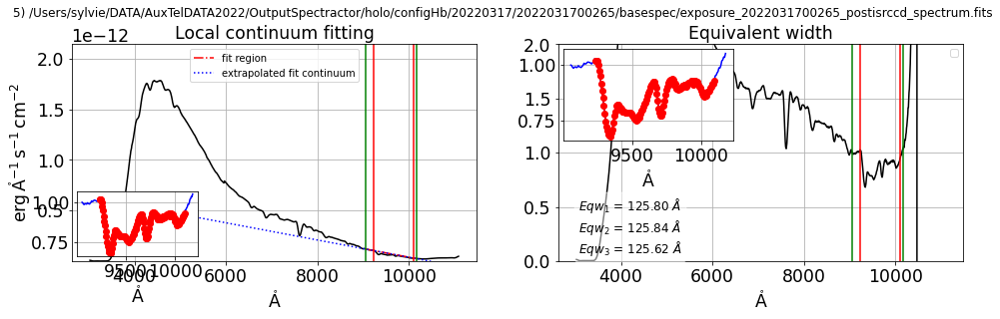

5 ) eqw_h2o= 125.62015632752397
set date_obs to 2022-03-18T01:08:18.080
set expo to 20.0
set airmass to 1.1533391050821
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.165620392992809
set dec to -32.3064444444444
set hour_angle to 35.12228883044955
set temperature to 8.9
set pressure to 743.3
set humidity to 51.0
set lambda_ref to 626.067912732114
set parallactic_angle to 95.52618006847594
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_141 PM_ERR_MINA_141 PM_ERR_ANGLE_141 Z_VALUE_141 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110    

2022-04-09 19:13:38  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


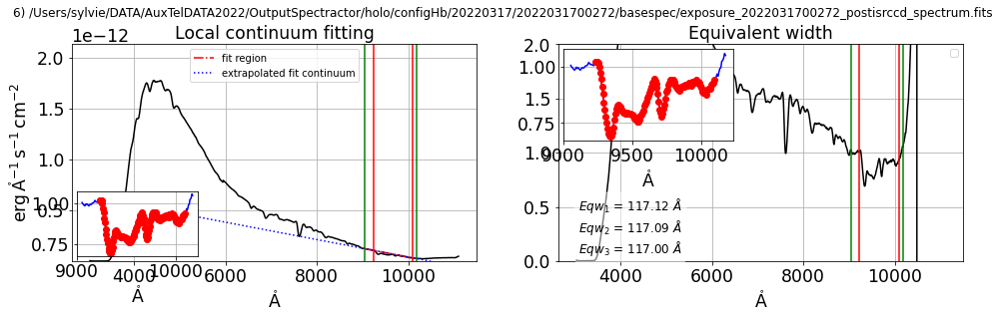

6 ) eqw_h2o= 116.99874358441144
set date_obs to 2022-03-18T01:08:50.992
set expo to 20.0
set airmass to 1.154683255421995
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1687630065527601
set dec to -32.3064444444444
set hour_angle to 35.26034049072464
set temperature to 8.9
set pressure to 743.35
set humidity to 51.0
set lambda_ref to 626.2488273411835
set parallactic_angle to 95.58041503368928
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_142 PM_ERR_MINA_142 PM_ERR_ANGLE_142 Z_VALUE_142 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:13:42  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


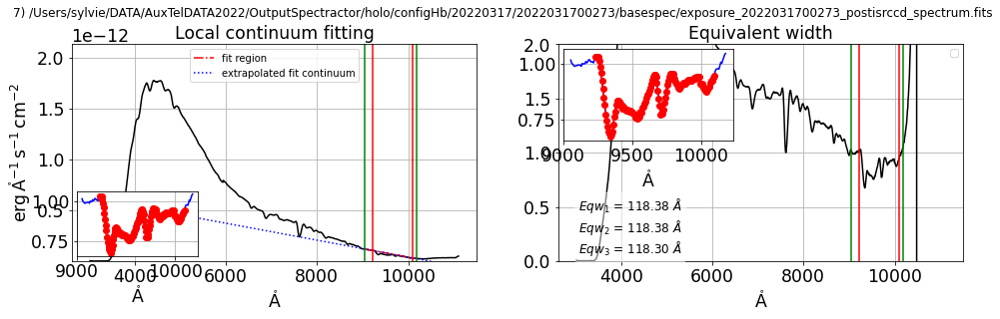

7 ) eqw_h2o= 118.29947990949853
set date_obs to 2022-03-18T01:11:46.031
set expo to 20.0
set airmass to 1.16193866550813
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1650200479066801
set dec to -32.3064444444444
set hour_angle to 35.99118130784399
set temperature to 8.9
set pressure to 743.4
set humidity to 53.0
set lambda_ref to 625.9517855761172
set parallactic_angle to 95.86593376321808
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_143 PM_ERR_MINA_143 PM_ERR_ANGLE_143 Z_VALUE_143 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:13:45  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


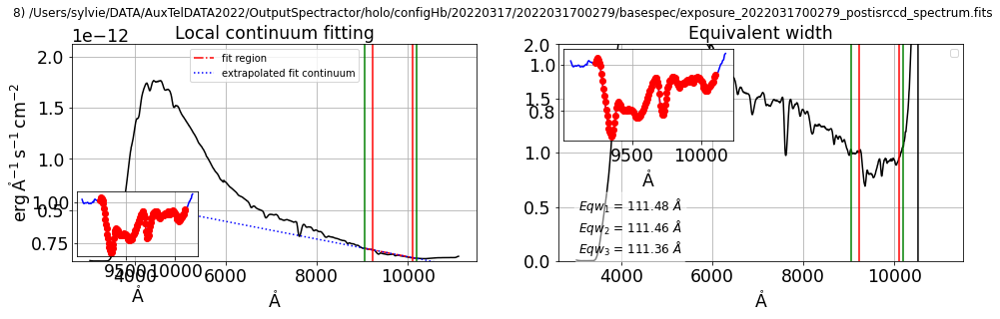

8 ) eqw_h2o= 111.36109030638947
set date_obs to 2022-03-18T01:15:18.583
set expo to 20.0
set airmass to 1.17105276018288
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1604530597215738
set dec to -32.3064444444444
set hour_angle to 36.87993052247099
set temperature to 8.9
set pressure to 743.45
set humidity to 54.0
set lambda_ref to 626.415954438991
set parallactic_angle to 96.20974235390722
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_144 PM_ERR_MINA_144 PM_ERR_ANGLE_144 Z_VALUE_144 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:13:49  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


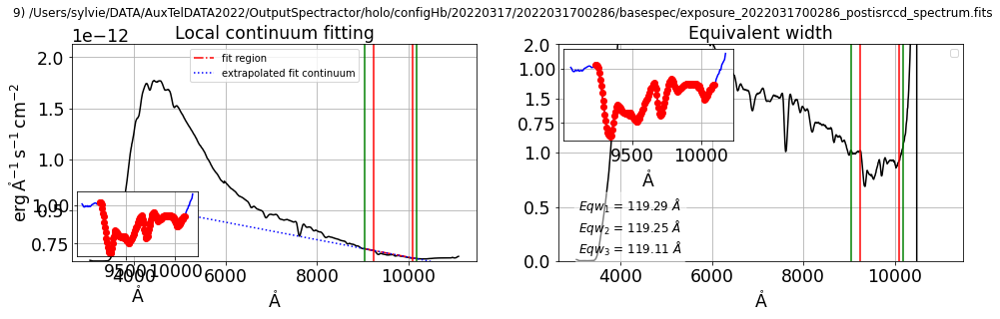

9 ) eqw_h2o= 119.11162897609374
set date_obs to 2022-03-18T01:18:45.526
set expo to 20.0
set airmass to 1.18024864471996
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.161506254140246
set dec to -32.3064444444444
set hour_angle to 37.74449227926539
set temperature to 9.0
set pressure to 743.45
set humidity to 53.0
set lambda_ref to 626.2661772674467
set parallactic_angle to 96.54092631927332
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_145 PM_ERR_MINA_145 PM_ERR_ANGLE_145 Z_VALUE_145 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:13:52  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


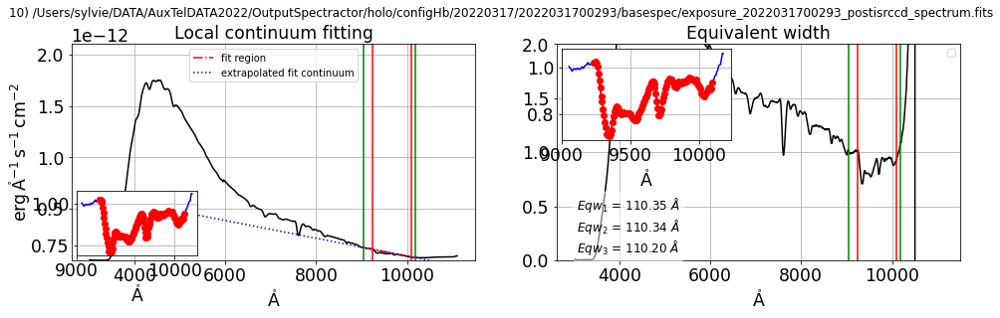

10 ) eqw_h2o= 110.20079727503206
set date_obs to 2022-03-18T01:22:16.238
set expo to 20.0
set airmass to 1.189962402398665
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1600582040885921
set dec to -32.3064444444444
set hour_angle to 38.6257061937975
set temperature to 8.9
set pressure to 743.4
set humidity to 56.0
set lambda_ref to 626.2915574183227
set parallactic_angle to 96.875483029922
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_146 PM_ERR_MINA_146 PM_ERR_ANGLE_146 Z_VALUE_146 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110  

2022-04-09 19:13:56  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


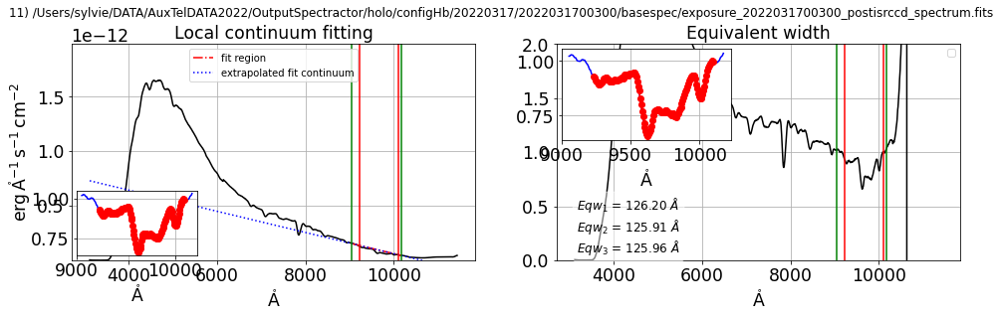

11 ) eqw_h2o= 125.95588289896641
set date_obs to 2022-03-18T01:22:49.144
set expo to 20.0
set airmass to 1.191505368069865
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1585750124351514
set dec to -32.3064444444444
set hour_angle to 38.76271209839639
set temperature to 9.0
set pressure to 743.45
set humidity to 56.0
set lambda_ref to 626.4868452630084
set parallactic_angle to 96.92724413418016
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_147 PM_ERR_MINA_147 PM_ERR_ANGLE_147 Z_VALUE_147 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:13:59  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


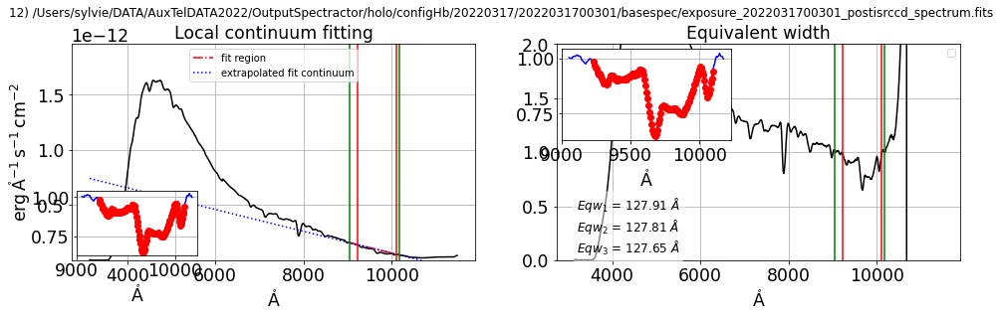

12 ) eqw_h2o= 127.64684731190883
set date_obs to 2022-03-18T01:43:57.837
set expo to 20.0
set airmass to 1.25822658979951
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476502374643685
set dec to -32.3064444444444
set hour_angle to 44.06414790775874
set temperature to 8.8
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 626.6251269515418
set parallactic_angle to 98.88882683561982
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_148 PM_ERR_MINA_148 PM_ERR_ANGLE_148 Z_VALUE_148 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:14:03  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


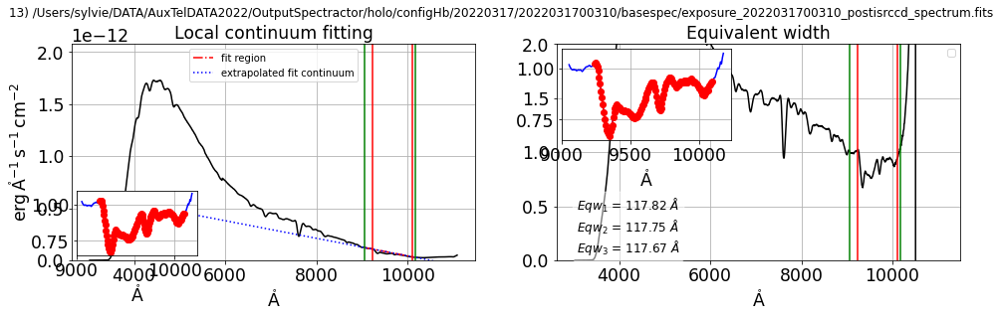

13 ) eqw_h2o= 117.66894899284858
set date_obs to 2022-03-18T01:46:52.361
set expo to 20.0
set airmass to 1.26858445121286
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476350630254128
set dec to -32.3064444444444
set hour_angle to 44.79438636254909
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 627.6256863262817
set parallactic_angle to 99.15414320783184
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_149 PM_ERR_MINA_149 PM_ERR_ANGLE_149 Z_VALUE_149 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:14:07  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


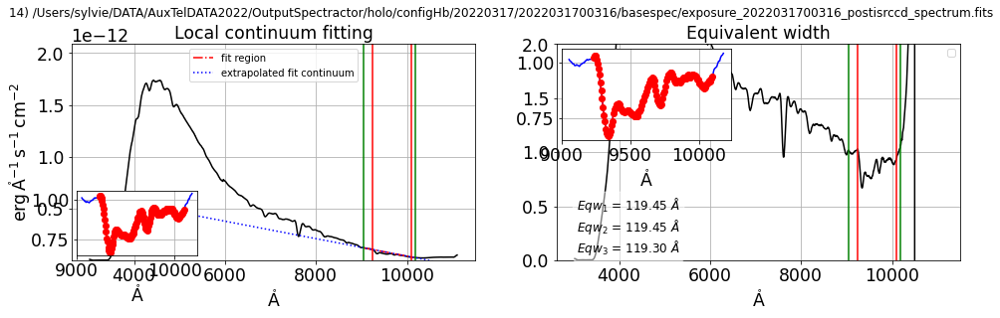

14 ) eqw_h2o= 119.2996156394266
set date_obs to 2022-03-18T01:47:25.256
set expo to 20.0
set airmass to 1.27056341471374
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1466645118411156
set dec to -32.3064444444444
set hour_angle to 44.9315970155517
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 625.7408027741238
set parallactic_angle to 99.2038979478238
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_150 PM_ERR_MINA_150 PM_ERR_ANGLE_150 Z_VALUE_150 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110  

2022-04-09 19:14:11  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


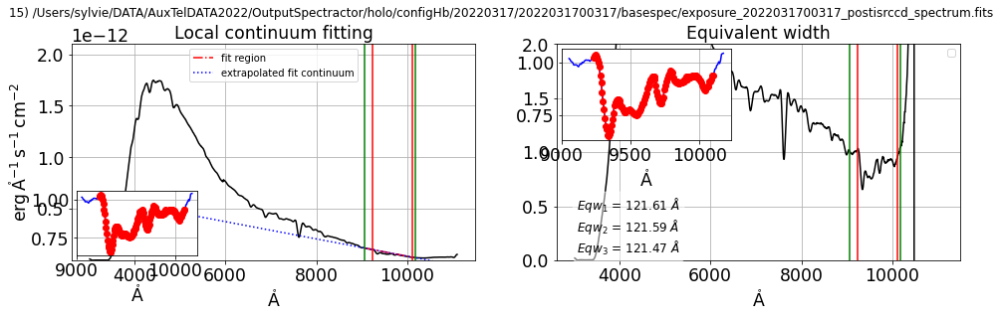

15 ) eqw_h2o= 121.46844562359458
set date_obs to 2022-03-18T01:53:46.736
set expo to 20.0
set airmass to 1.294394244363805
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1444547716136137
set dec to -32.3064444444444
set hour_angle to 46.52581667330039
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.9120383005036
set parallactic_angle to 99.77999069166285
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_151 PM_ERR_MINA_151 PM_ERR_ANGLE_151 Z_VALUE_151 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:14:15  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


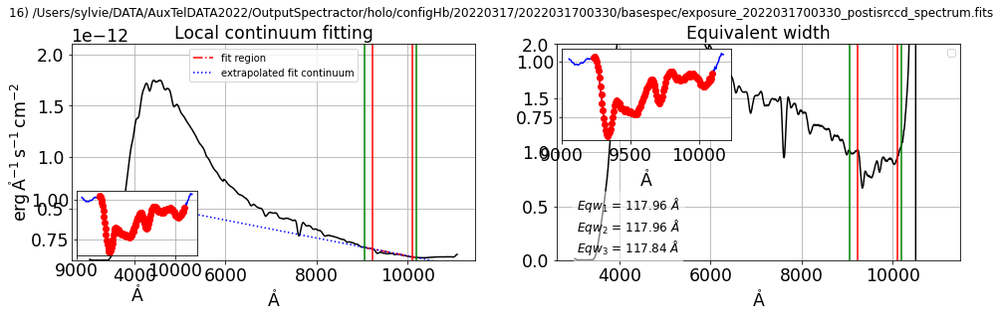

16 ) eqw_h2o= 117.84260242673875
set date_obs to 2022-03-18T01:54:19.724
set expo to 20.0
set airmass to 1.29652271576687
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1441648974084375
set dec to -32.3064444444444
set hour_angle to 46.6628171725209
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.7462807078947
set parallactic_angle to 99.82934304254884
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_152 PM_ERR_MINA_152 PM_ERR_ANGLE_152 Z_VALUE_152 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:14:18  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


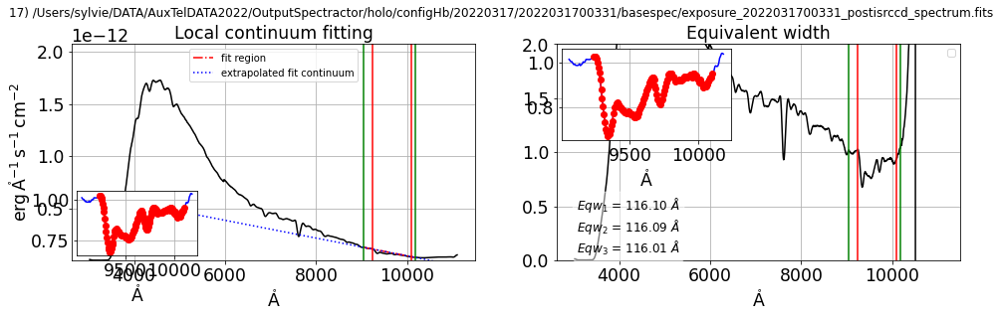

17 ) eqw_h2o= 116.01414669228005
set date_obs to 2022-03-18T01:57:49.306
set expo to 20.0
set airmass to 1.31035777011874
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1437462230173573
set dec to -32.3064444444444
set hour_angle to 47.53898537176394
set temperature to 8.7
set pressure to 743.45
set humidity to 57.0
set lambda_ref to 628.9551099539515
set parallactic_angle to 100.14447493807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_153 PM_ERR_MINA_153 PM_ERR_ANGLE_153 Z_VALUE_153 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:14:22  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


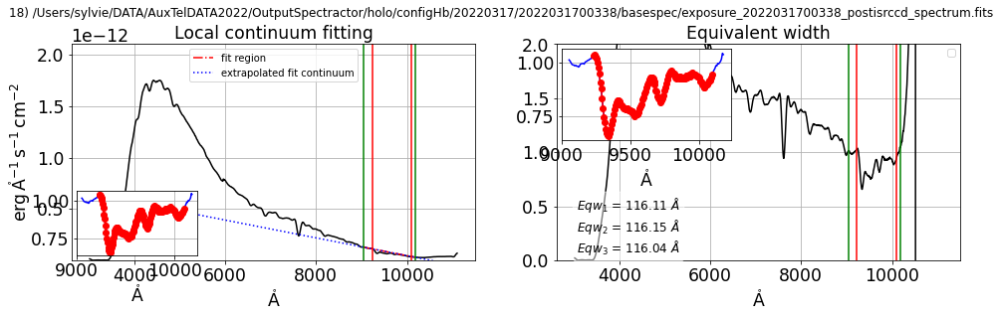

18 ) eqw_h2o= 116.04041662485785
set date_obs to 2022-03-18T02:01:19.196
set expo to 20.0
set airmass to 1.324716687989025
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1392710710370809
set dec to -32.3064444444444
set hour_angle to 48.4163008821963
set temperature to 8.6
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 626.8625000130343
set parallactic_angle to 100.4592627484374
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_154 PM_ERR_MINA_154 PM_ERR_ANGLE_154 Z_VALUE_154 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:14:26  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


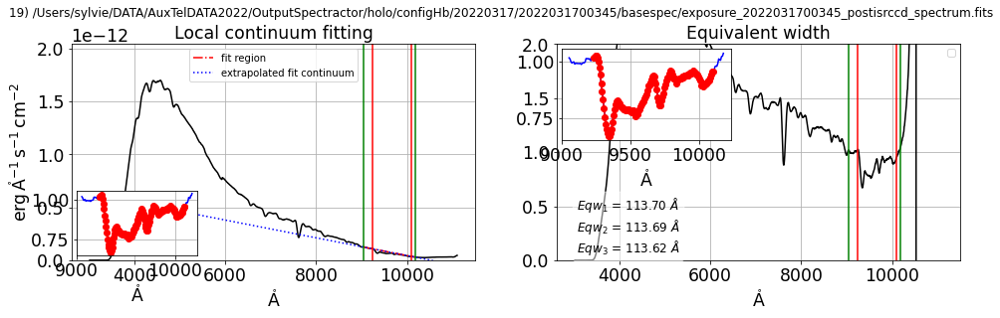

19 ) eqw_h2o= 113.61502114024351
set date_obs to 2022-03-18T02:04:16.794
set expo to 20.0
set airmass to 1.33727547076682
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1388486262435704
set dec to -32.3064444444444
set hour_angle to 49.15879882143194
set temperature to 8.5
set pressure to 743.45
set humidity to 58.0
set lambda_ref to 628.5424256920012
set parallactic_angle to 100.7251843777299
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_155 PM_ERR_MINA_155 PM_ERR_ANGLE_155 Z_VALUE_155 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:14:29  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


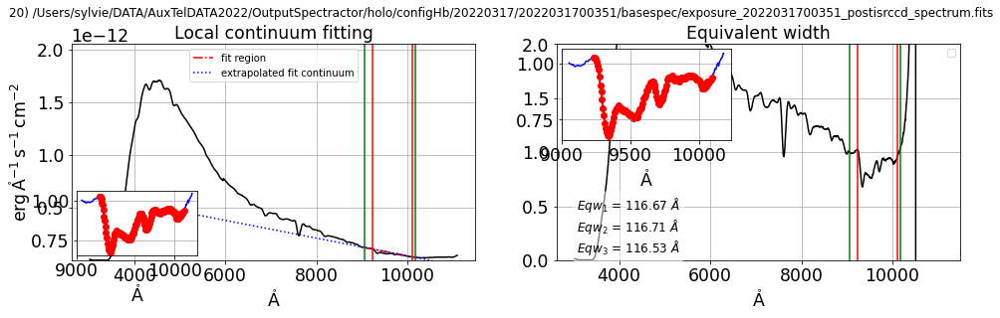

20 ) eqw_h2o= 116.53339150594526
set date_obs to 2022-03-18T02:04:49.712
set expo to 20.0
set airmass to 1.33963651479802
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1368681187146323
set dec to -32.3064444444444
set hour_angle to 49.29580448438519
set temperature to 8.5
set pressure to 743.35
set humidity to 58.0
set lambda_ref to 628.2086674961155
set parallactic_angle to 100.7742095756281
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_156 PM_ERR_MINA_156 PM_ERR_ANGLE_156 Z_VALUE_156 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:14:33  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


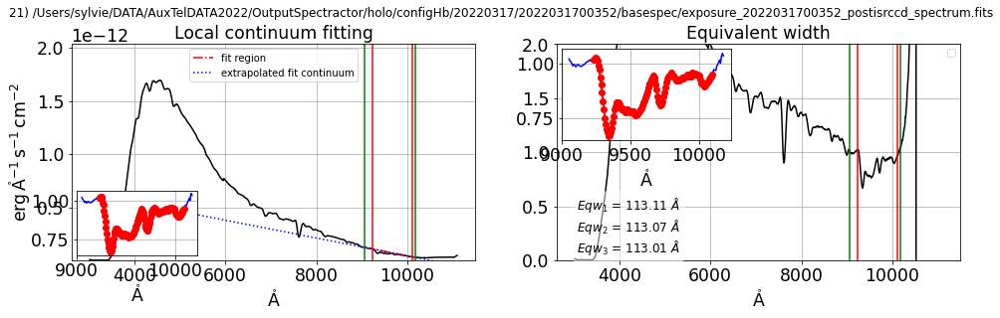

21 ) eqw_h2o= 113.00701766457973
set date_obs to 2022-03-18T02:07:49.074
set expo to 20.0
set airmass to 1.352787300037425
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1331931685876357
set dec to -32.3064444444444
set hour_angle to 50.04587365708529
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 627.9591693143808
set parallactic_angle to 101.0424069948098
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_157 PM_ERR_MINA_157 PM_ERR_ANGLE_157 Z_VALUE_157 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:14:37  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


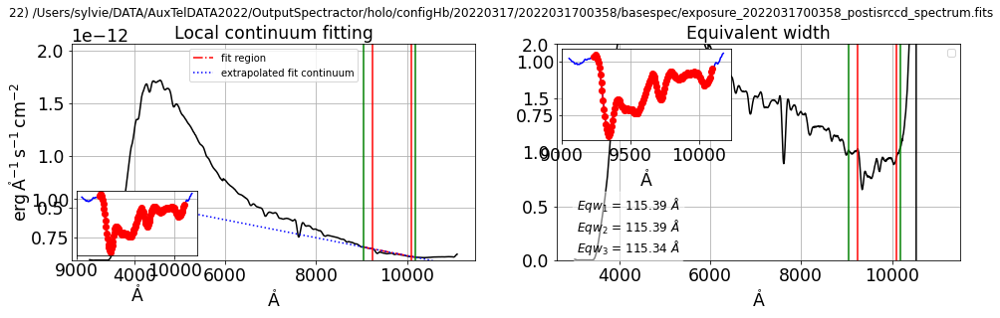

22 ) eqw_h2o= 115.33558193589622
set date_obs to 2022-03-18T02:11:20.051
set expo to 20.0
set airmass to 1.368765631503195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1336440841342464
set dec to -32.3064444444444
set hour_angle to 50.92719907664954
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 622.7051672626101
set parallactic_angle to 101.357174452077
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_158 PM_ERR_MINA_158 PM_ERR_ANGLE_158 Z_VALUE_158 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:14:41  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


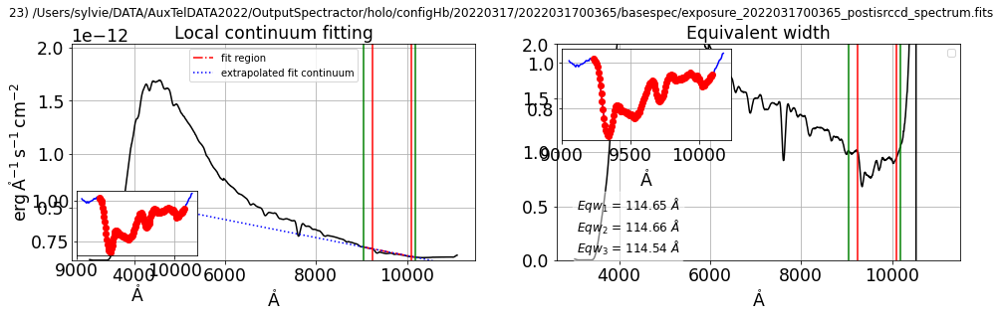

23 ) eqw_h2o= 114.53999386573828
set date_obs to 2022-03-18T02:11:53.006
set expo to 20.0
set airmass to 1.371319339871885
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1369079175197151
set dec to -32.3064444444444
set hour_angle to 51.06504024257939
set temperature to 8.4
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 629.1845159477502
set parallactic_angle to 101.4063764649771
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_159 PM_ERR_MINA_159 PM_ERR_ANGLE_159 Z_VALUE_159 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:14:45  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


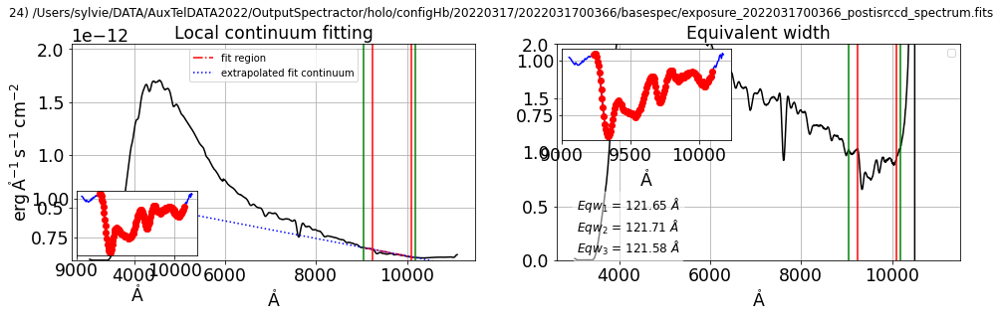

24 ) eqw_h2o= 121.58229833674007
set date_obs to 2022-03-18T02:14:46.798
set expo to 20.0
set airmass to 1.38501167017706
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1310814762516916
set dec to -32.3064444444444
set hour_angle to 51.79156958975715
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.5245232921197
set parallactic_angle to 101.6656129875546
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_160 PM_ERR_MINA_160 PM_ERR_ANGLE_160 Z_VALUE_160 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:14:49  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


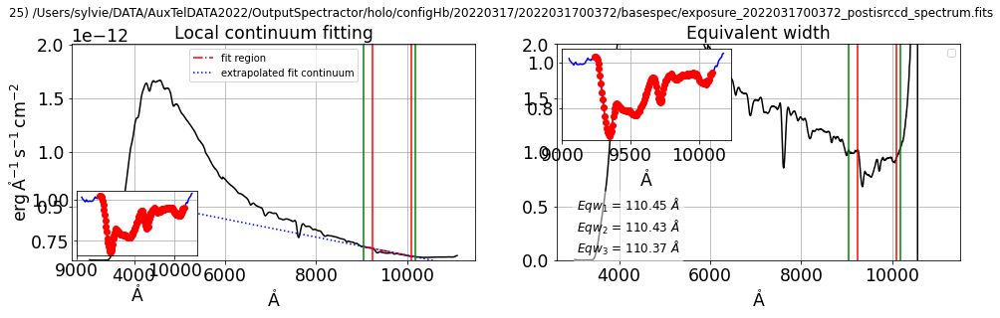

25 ) eqw_h2o= 110.36885646386204
set date_obs to 2022-03-18T02:15:19.743
set expo to 20.0
set airmass to 1.387649936190795
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1317245037126307
set dec to -32.3064444444444
set hour_angle to 51.92878009828319
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.9968889639981
set parallactic_angle to 101.7145568247823
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_161 PM_ERR_MINA_161 PM_ERR_ANGLE_161 Z_VALUE_161 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:14:52  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


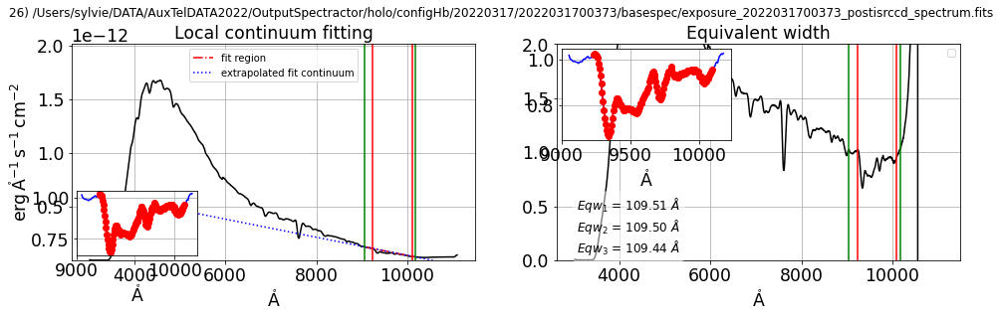

26 ) eqw_h2o= 109.44172916190553
set date_obs to 2022-03-18T02:33:33.012
set expo to 20.0
set airmass to 1.48452422171666
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1197628273916148
set dec to -32.3064444444444
set hour_angle to 56.49902324990354
set temperature to 8.0
set pressure to 743.35
set humidity to 63.0
set lambda_ref to 628.5888123380201
set parallactic_angle to 103.3450343494105
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_162 PM_ERR_MINA_162 PM_ERR_ANGLE_162 Z_VALUE_162 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:14:56  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


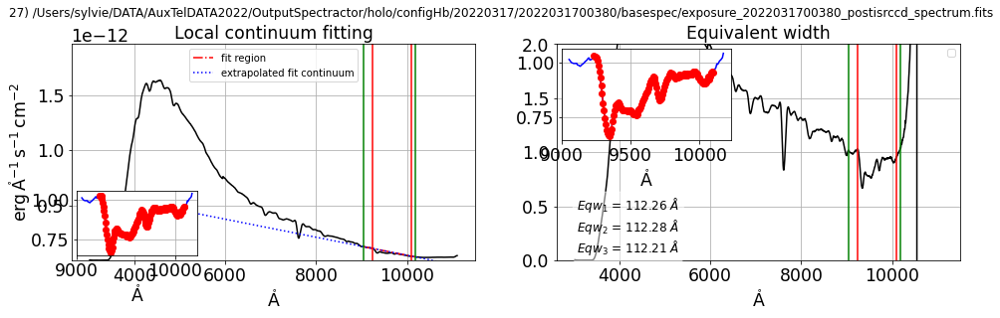

27 ) eqw_h2o= 112.2069623136825
set date_obs to 2022-03-18T02:36:30.874
set expo to 20.0
set airmass to 1.50213593383469
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1172584274998106
set dec to -32.3064444444444
set hour_angle to 57.24247377715349
set temperature to 8.1
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 633.8101508297243
set parallactic_angle to 103.6108187575918
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_163 PM_ERR_MINA_163 PM_ERR_ANGLE_163 Z_VALUE_163 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:15:00  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


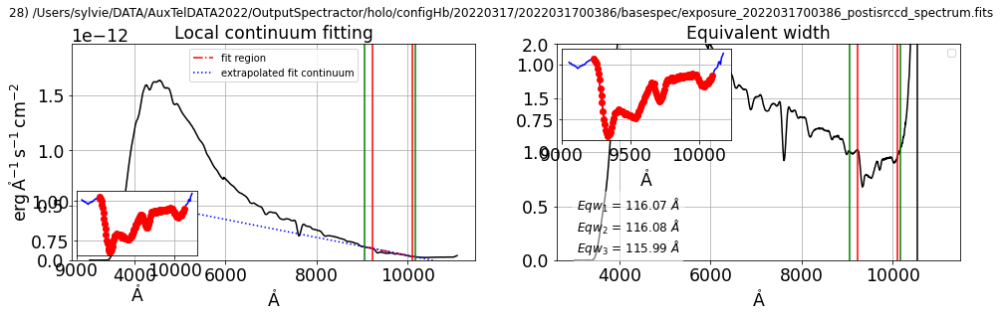

28 ) eqw_h2o= 115.9918968016116
set date_obs to 2022-03-18T02:37:03.815
set expo to 20.0
set airmass to 1.50545657928364
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1211335036558286
set dec to -32.3064444444444
set hour_angle to 57.37947904087095
set temperature to 8.1
set pressure to 743.35
set humidity to 64.0
set lambda_ref to 628.2172036981787
set parallactic_angle to 103.6598297048832
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_164 PM_ERR_MINA_164 PM_ERR_ANGLE_164 Z_VALUE_164 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:15:04  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


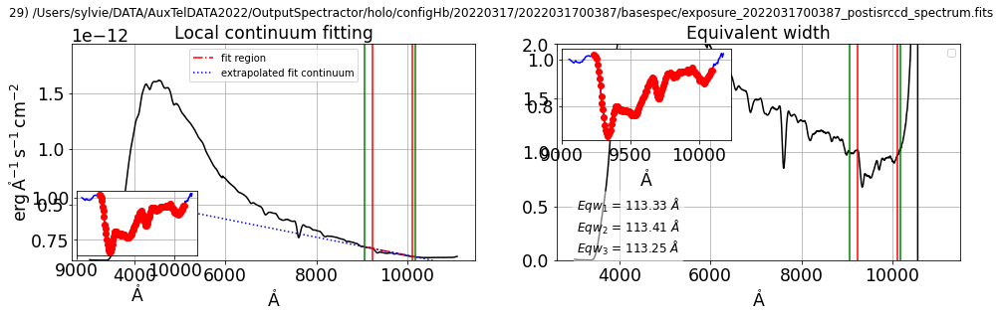

29 ) eqw_h2o= 113.25357744016625
set date_obs to 2022-03-18T02:40:00.839
set expo to 20.0
set airmass to 1.523657512515415
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1177429780701742
set dec to -32.3064444444444
set hour_angle to 58.11949120092164
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.3577400172557
set parallactic_angle to 103.9247454603291
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_165 PM_ERR_MINA_165 PM_ERR_ANGLE_165 Z_VALUE_165 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:15:08  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


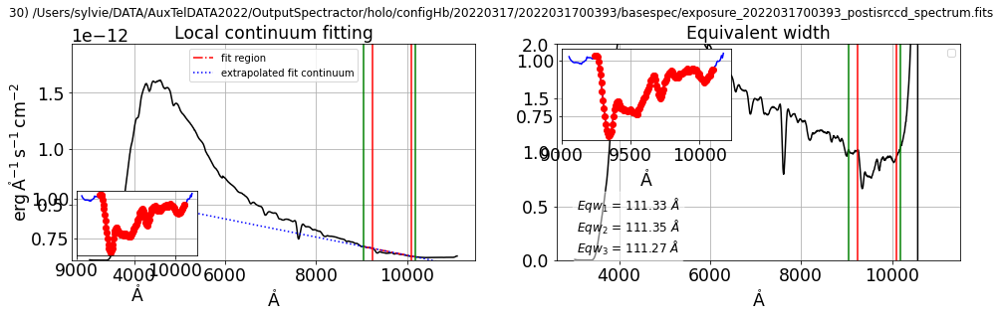

30 ) eqw_h2o= 111.26901466712843
set date_obs to 2022-03-18T02:40:33.787
set expo to 20.0
set airmass to 1.527114954027915
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1169167488860146
set dec to -32.3064444444444
set hour_angle to 58.25733391386269
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.7847433714671
set parallactic_angle to 103.9741296646409
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_166 PM_ERR_MINA_166 PM_ERR_ANGLE_166 Z_VALUE_166 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:15:12  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


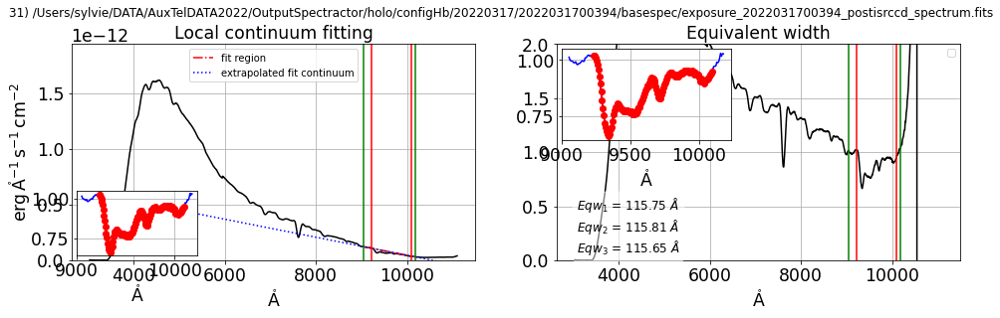

31 ) eqw_h2o= 115.65217321346834
set date_obs to 2022-03-18T02:44:05.105
set expo to 20.0
set airmass to 1.54976447202586
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1144055844584487
set dec to -32.3064444444444
set hour_angle to 59.14046723526914
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 629.2826348266267
set parallactic_angle to 104.2908413745483
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_167 PM_ERR_MINA_167 PM_ERR_ANGLE_167 Z_VALUE_167 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:15:16  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


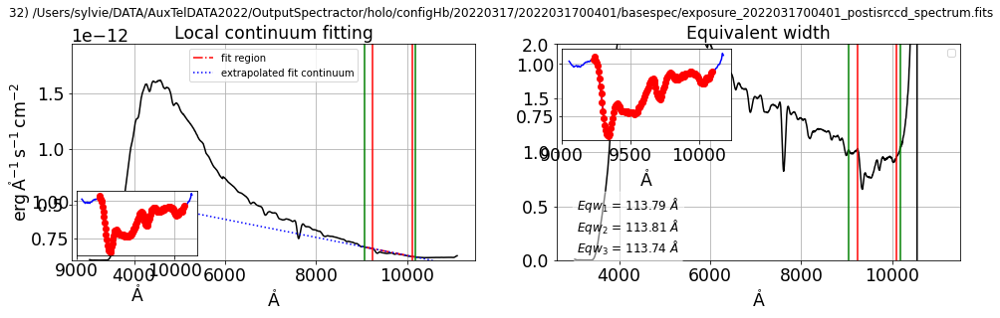

32 ) eqw_h2o= 113.74397920546886
set date_obs to 2022-03-18T02:47:02.835
set expo to 20.0
set airmass to 1.56951976624838
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.113192412444726
set dec to -32.3064444444444
set hour_angle to 59.88301895711849
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 623.392411114623
set parallactic_angle to 104.5576025273592
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_168 PM_ERR_MINA_168 PM_ERR_ANGLE_168 Z_VALUE_168 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110  

2022-04-09 19:15:20  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


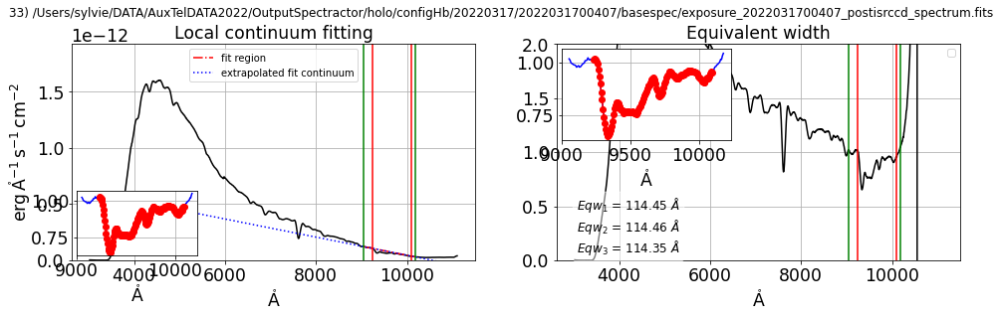

33 ) eqw_h2o= 114.34688661011884
set date_obs to 2022-03-18T02:47:35.769
set expo to 20.0
set airmass to 1.573248011911855
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1127873058479127
set dec to -32.3064444444444
set hour_angle to 60.02106934614464
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 624.3168639615992
set parallactic_angle to 104.6072480488688
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_169 PM_ERR_MINA_169 PM_ERR_ANGLE_169 Z_VALUE_169 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:15:25  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


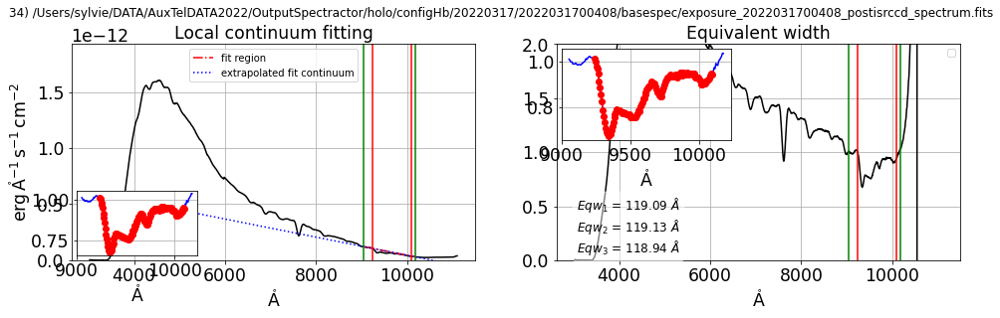

34 ) eqw_h2o= 118.9374460697976
set date_obs to 2022-03-18T02:50:38.306
set expo to 20.0
set airmass to 1.594345273370295
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1038057563272595
set dec to -32.3064444444444
set hour_angle to 60.78322641711044
set temperature to 8.0
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 625.6140852852044
set parallactic_angle to 104.8816435668321
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_170 PM_ERR_MINA_170 PM_ERR_ANGLE_170 Z_VALUE_170 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:15:29  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


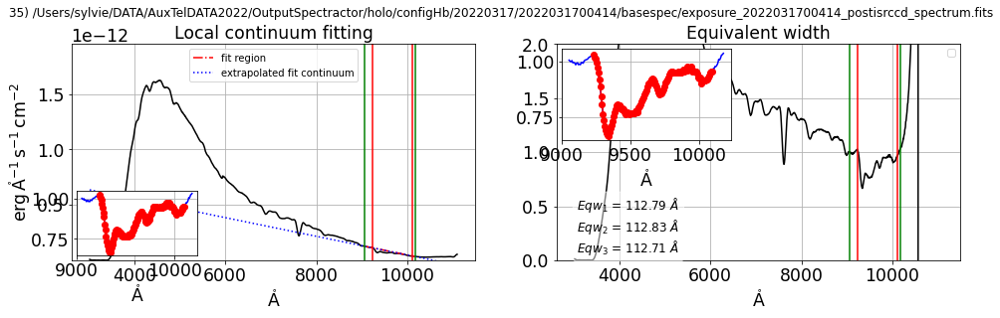

35 ) eqw_h2o= 112.71323729952708
set date_obs to 2022-03-18T03:08:41.573
set expo to 20.0
set airmass to 1.73594131895663
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09058150608401207
set dec to -32.3064444444444
set hour_angle to 65.3119392087705
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 631.9889212287092
set parallactic_angle to 106.5252810168807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_171 PM_ERR_MINA_171 PM_ERR_ANGLE_171 Z_VALUE_171 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:15:33  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


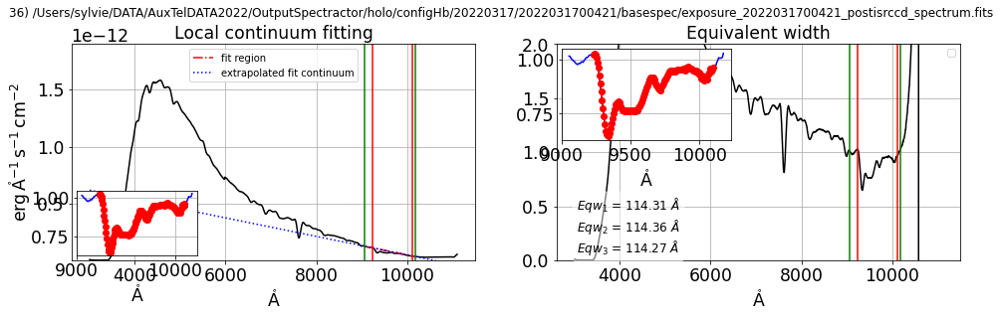

36 ) eqw_h2o= 114.26732795362787
set date_obs to 2022-03-18T03:09:14.484
set expo to 20.0
set airmass to 1.740715384660955
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09733707671582016
set dec to -32.3064444444444
set hour_angle to 65.44894264967655
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 625.9596270530473
set parallactic_angle to 106.5754178018598
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_172 PM_ERR_MINA_172 PM_ERR_ANGLE_172 Z_VALUE_172 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:15:38  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


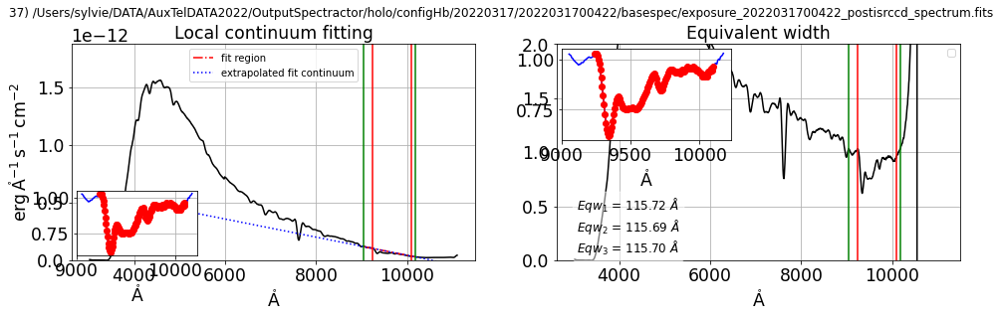

37 ) eqw_h2o= 115.70141021523978
set date_obs to 2022-03-18T03:12:54.310
set expo to 20.0
set airmass to 2.129245852899135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.143944791309082
set dec to -87.4721944444444
set hour_angle to -155.5929780702915
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 686.0625390317258
set parallactic_angle to -156.1678055894986
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_173 PM_ERR_MINA_173 PM_ERR_ANGLE_173 Z_VALUE_173 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
HD 185975 20 28 18.7398 -87 28 19.937      14       14 ...           0.017           

2022-04-09 19:15:42  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


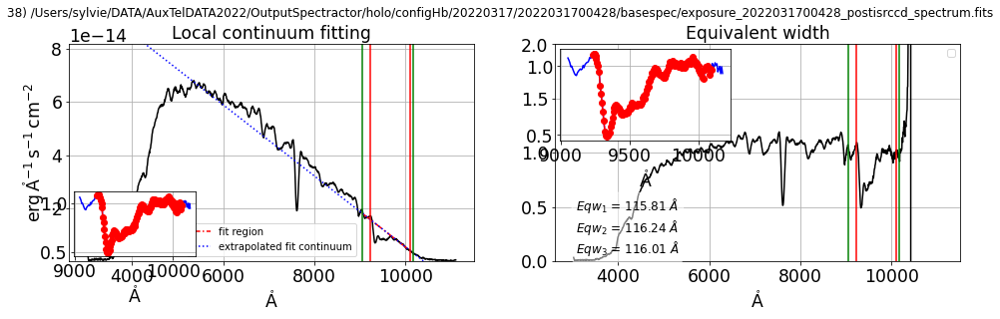

38 ) eqw_h2o= 116.01287918800477
set date_obs to 2022-03-18T03:13:27.208
set expo to 20.0
set airmass to 2.1290679262036
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09887590360164929
set dec to -87.4721944444444
set hour_angle to -155.455137691263
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 636.4362643500099
set parallactic_angle to -156.0330469936088
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_174 PM_ERR_MINA_174 PM_ERR_ANGLE_174 Z_VALUE_174 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
HD 185975 20 28 18.7398 -87 28 19.937      14       14 ...           0.017           0

2022-04-09 19:15:47  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


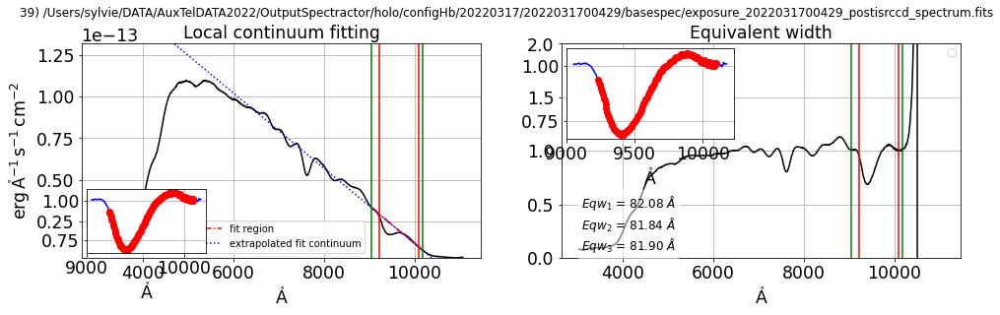

39 ) eqw_h2o= 81.89538047611222
set date_obs to 2022-03-18T03:17:06.794
set expo to 20.0
set airmass to 1.81309435755974
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09210139501009447
set dec to -32.3064444444444
set hour_angle to 67.42354300312304
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 626.8738274489511
set parallactic_angle to 107.3011935159837
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_175 PM_ERR_MINA_175 PM_ERR_ANGLE_175 Z_VALUE_175 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:15:51  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


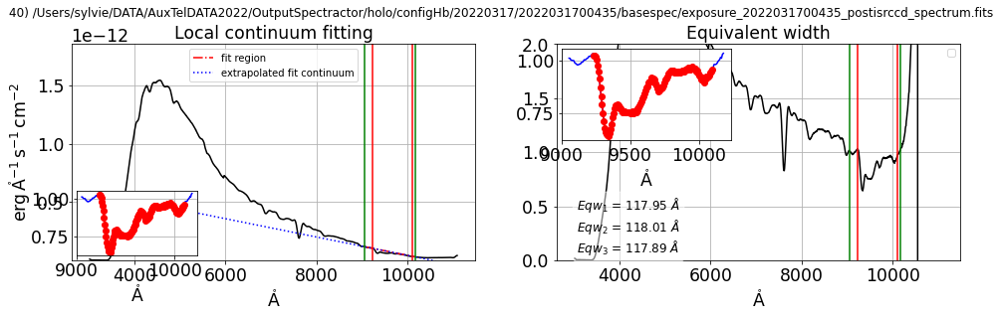

40 ) eqw_h2o= 117.88868834926285
set date_obs to 2022-03-18T03:17:39.779
set expo to 20.0
set airmass to 1.818418067455135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.08344429603447075
set dec to -32.3064444444444
set hour_angle to 67.56159248336594
set temperature to 7.7
set pressure to 743.4
set humidity to 63.0
set lambda_ref to 632.4252252976918
set parallactic_angle to 107.3521665962106
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_176 PM_ERR_MINA_176 PM_ERR_ANGLE_176 Z_VALUE_176 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:15:56  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


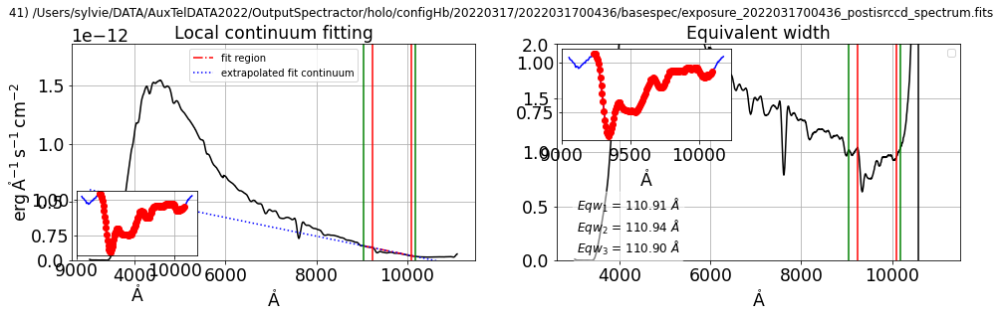

41 ) eqw_h2o= 110.90287477694447
set date_obs to 2022-03-18T03:21:26.873
set expo to 20.0
set airmass to 1.856070090955285
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.06347269052355019
set dec to -32.3064444444444
set hour_angle to 68.51099093135984
set temperature to 7.8
set pressure to 743.4
set humidity to 62.0
set lambda_ref to 630.0633085655397
set parallactic_angle to 107.7035936917225
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_177 PM_ERR_MINA_177 PM_ERR_ANGLE_177 Z_VALUE_177 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:16:00  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


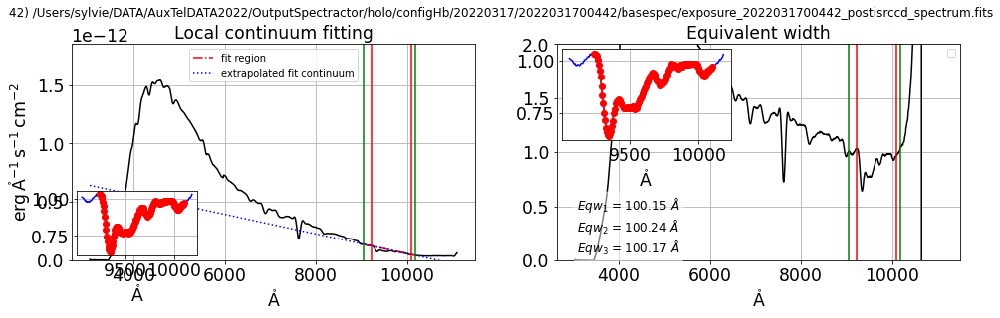

42 ) eqw_h2o= 100.17128515599691
set date_obs to 2022-03-18T03:21:59.878
set expo to 20.0
set airmass to 1.861691550345225
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.0769189759908508
set dec to -32.3064444444444
set hour_angle to 68.64883074724754
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 633.3015467495994
set parallactic_angle to 107.7547458765076
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_178 PM_ERR_MINA_178 PM_ERR_ANGLE_178 Z_VALUE_178 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:16:05  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


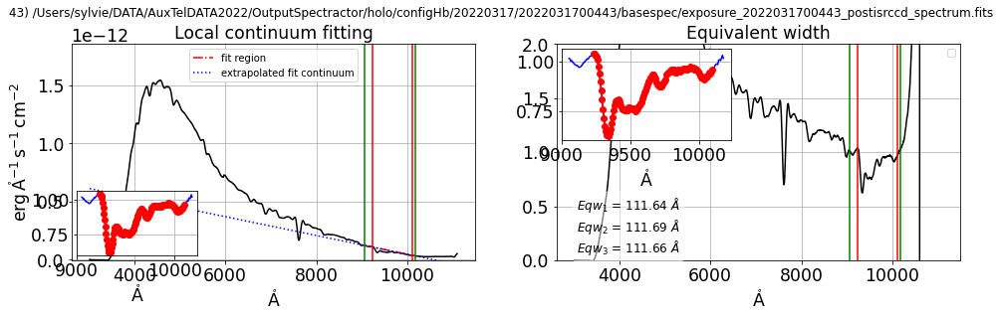

43 ) eqw_h2o= 111.6583059620801


In [122]:
WLMIN=300
WLMAX=1000
lambdas = np.arange(WLMIN,WLMAX,1)
fwhm_func = interp1d(lambdas, 0.01 * lambdas)
parameters.DISPLAY=False


for IDXSEL in np.arange(0,NN):
    filename_SEL=all_good_spectra_spectrum_files[IDXSEL]
    filename_spectrogram_SEL=filename_SEL.replace("_spectrum","_spectrogram")
    fullfilename_SEL = os.path.join(dir_spectra,filename_SEL)
    fullfilename_spectrogram_SEL = fullfilename_SEL.replace("_spectrum","_spectrogram")
    
    # load the spectrum
    s=Spectrum(fullfilename_SEL, config=config)
    s.load_spectrogram(fullfilename_spectrogram_SEL) 
    
    
    lamb = 10*s.lambdas * u.AA 
    flux = s.data * u.Unit('erg cm-2 s-1 AA-1')/10 
    spec = Spectrum1D(spectral_axis=lamb, flux=flux) 
    fluxerr = s.err * u.Unit('erg cm-2 s-1 AA-1')/10. 
    specerr = Spectrum1D(spectral_axis=lamb, flux=fluxerr)
    
    # H2O line
    
    #wlmin=10*(H2O_1.wavelength-30)*u.AA
    #wlmax=10*(H2O_2.wavelength+30)*u.AA
    #wlminline=10*(H2O_1.wavelength-12)*u.AA
    #wlmaxline=10*(H2O_2.wavelength+10)*u.AA
    
    wlmin = wlmin_h2o
    wlmax = wlmax_h2o
    wlminline = wlminline_h2o
    wlmaxline = wlmaxline_h2o
    
    
    fig=plt.figure(figsize=(16,4))
    ax1 = fig.add_subplot(1, 2, 1)
    ax2 = fig.add_subplot(1, 2, 2)
    #eqw1,eqw2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    eqw1,eqw2,eqw3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    #eqw10,eqw20,eq1_set,eq2_set=ComputeEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=20,flag_plot=True,ax1=ax1,ax2=ax2)
    thetitle=str(IDXSEL)+") "+filename_SEL
    plt.suptitle(thetitle,y=1.01)
    plt.show() 
    
    print(IDXSEL,") eqw_h2o=",eqw3)
    
    df_infos.at[IDXSEL,"eqw_h2o"] =  eqw3


## LOOP on H2O(730) line

set date_obs to 2022-03-18T00:51:22.049
set expo to 20.0
set airmass to 1.11557476948966
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1753951396614214
set dec to -32.3064444444444
set hour_angle to 30.8762989508295
set temperature to 8.9
set pressure to 743.45
set humidity to 48.0
set lambda_ref to 626.6801216985461
set parallactic_angle to 93.8012496664173
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_179 PM_ERR_MINA_179 PM_ERR_ANGLE_179 Z_VALUE_179 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110               90   0.0003640     

2022-04-09 19:16:09  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


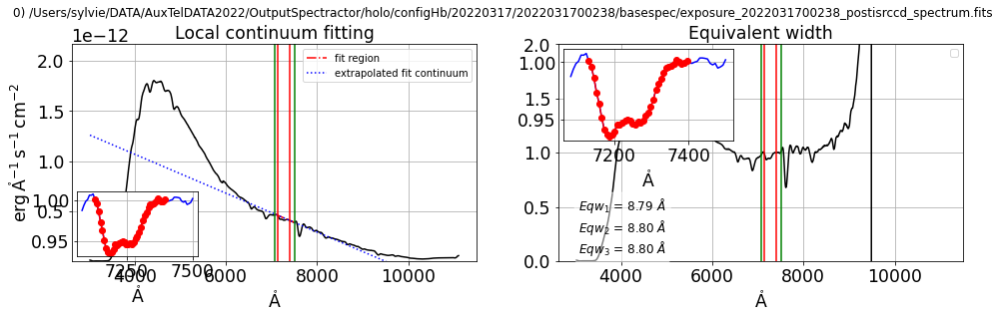

0 ) eqw_h2o_2= 8.800508590247732
set date_obs to 2022-03-18T00:54:16.312
set expo to 20.0
set airmass to 1.121576965054115
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1741806116248446
set dec to -32.3064444444444
set hour_angle to 31.60492174100415
set temperature to 8.9
set pressure to 743.45
set humidity to 49.0
set lambda_ref to 626.883564656571
set parallactic_angle to 94.10618686949074
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_180 PM_ERR_MINA_180 PM_ERR_ANGLE_180 Z_VALUE_180 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:16:14  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


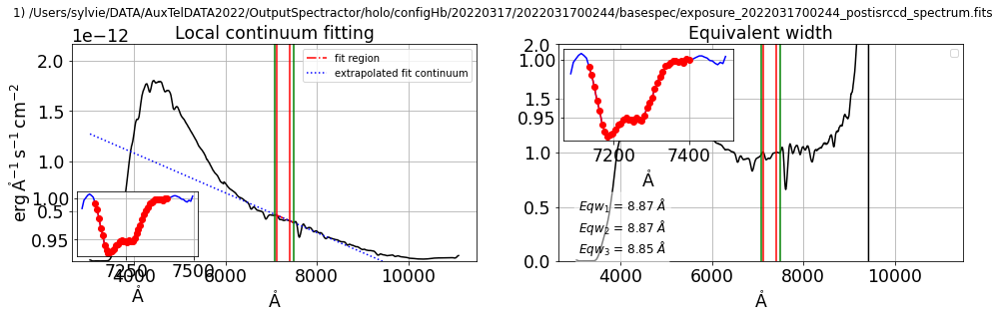

1 ) eqw_h2o_2= 8.847538199075112
set date_obs to 2022-03-18T00:54:49.235
set expo to 20.0
set airmass to 1.12272698054768
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1736210434249555
set dec to -32.3064444444444
set hour_angle to 31.7419273199217
set temperature to 8.8
set pressure to 743.4
set humidity to 49.0
set lambda_ref to 626.0378655266279
set parallactic_angle to 94.16305953909519
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_181 PM_ERR_MINA_181 PM_ERR_ANGLE_181 Z_VALUE_181 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:16:18  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


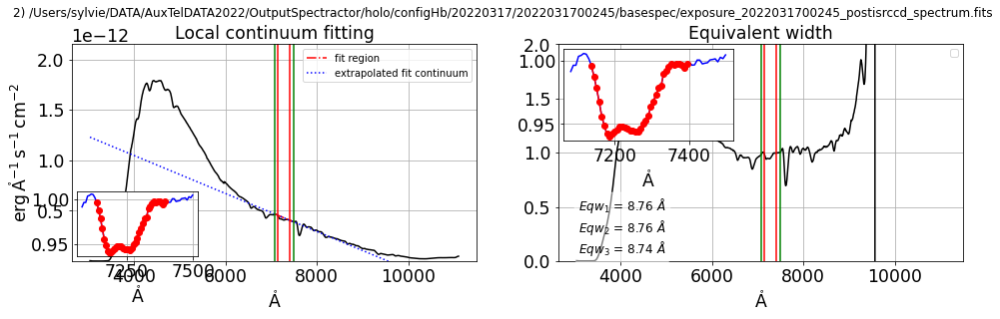

2 ) eqw_h2o_2= 8.736368310320072
set date_obs to 2022-03-18T00:57:47.565
set expo to 20.0
set airmass to 1.12910731186445
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1713060449152569
set dec to -32.3064444444444
set hour_angle to 32.4876824869983
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.4911208542796
set parallactic_angle to 94.47019502924495
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_182 PM_ERR_MINA_182 PM_ERR_ANGLE_182 Z_VALUE_182 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:16:23  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


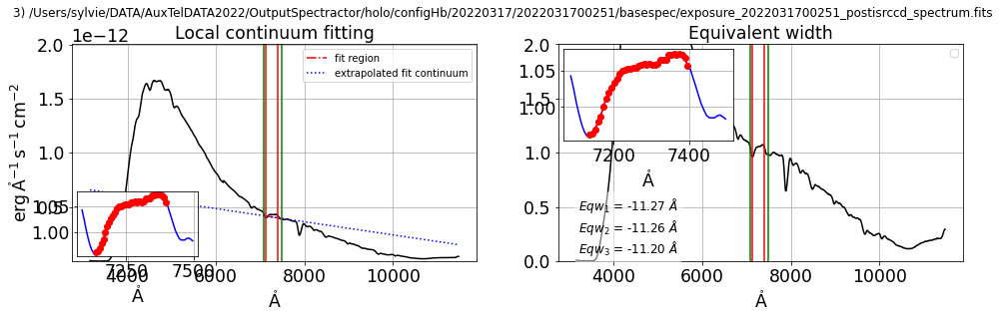

3 ) eqw_h2o_2= -11.197551565653
set date_obs to 2022-03-18T00:58:20.709
set expo to 20.0
set airmass to 1.130309156823195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.169943439836599
set dec to -32.3064444444444
set hour_angle to 32.6255240863161
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.2751365569749
set parallactic_angle to 94.52653019757676
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_183 PM_ERR_MINA_183 PM_ERR_ANGLE_183 Z_VALUE_183 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110  

2022-04-09 19:16:28  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


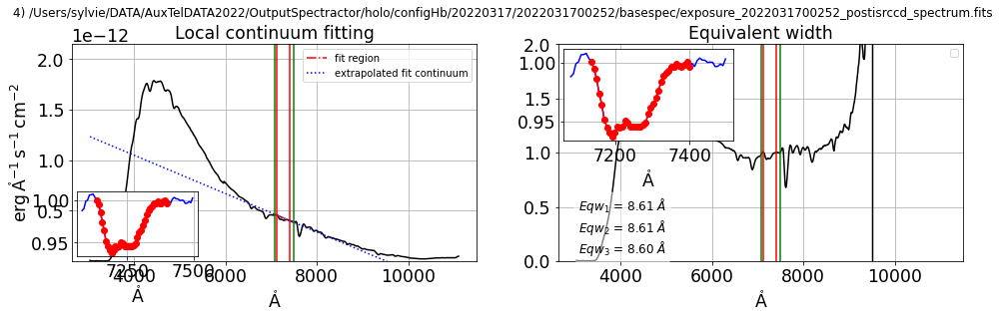

4 ) eqw_h2o_2= 8.596750590488314
set date_obs to 2022-03-18T01:04:49.716
set expo to 20.0
set airmass to 1.14502998698828
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1680537967029804
set dec to -32.3064444444444
set hour_angle to 34.25103021292454
set temperature to 8.9
set pressure to 743.3
set humidity to 53.0
set lambda_ref to 626.5383418087131
set parallactic_angle to 95.18153718788132
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_184 PM_ERR_MINA_184 PM_ERR_ANGLE_184 Z_VALUE_184 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:16:32  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


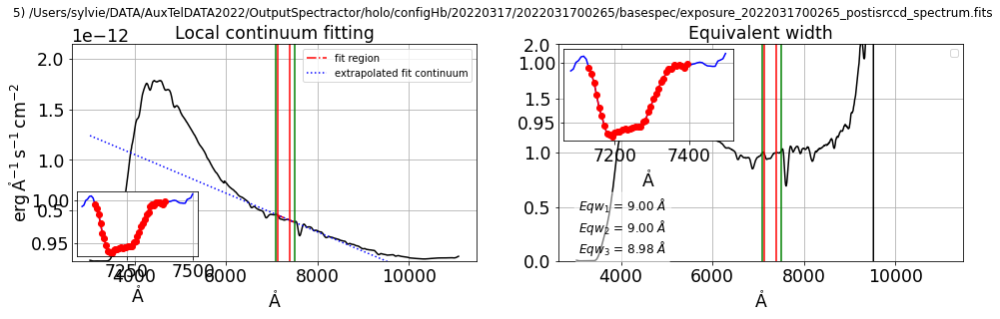

5 ) eqw_h2o_2= 8.981147527334937
set date_obs to 2022-03-18T01:08:18.080
set expo to 20.0
set airmass to 1.1533391050821
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.165620392992809
set dec to -32.3064444444444
set hour_angle to 35.12228883044955
set temperature to 8.9
set pressure to 743.3
set humidity to 51.0
set lambda_ref to 626.067912732114
set parallactic_angle to 95.52618006847594
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_185 PM_ERR_MINA_185 PM_ERR_ANGLE_185 Z_VALUE_185 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110   

2022-04-09 19:16:37  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


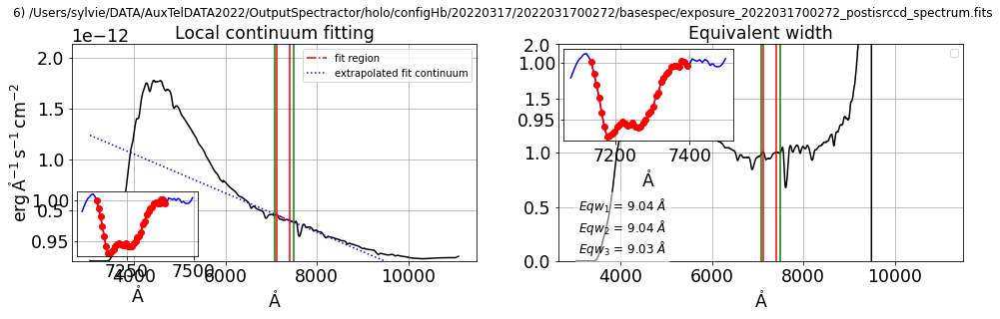

6 ) eqw_h2o_2= 9.02777707442222
set date_obs to 2022-03-18T01:08:50.992
set expo to 20.0
set airmass to 1.154683255421995
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1687630065527601
set dec to -32.3064444444444
set hour_angle to 35.26034049072464
set temperature to 8.9
set pressure to 743.35
set humidity to 51.0
set lambda_ref to 626.2488273411835
set parallactic_angle to 95.58041503368928
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_186 PM_ERR_MINA_186 PM_ERR_ANGLE_186 Z_VALUE_186 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:16:42  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


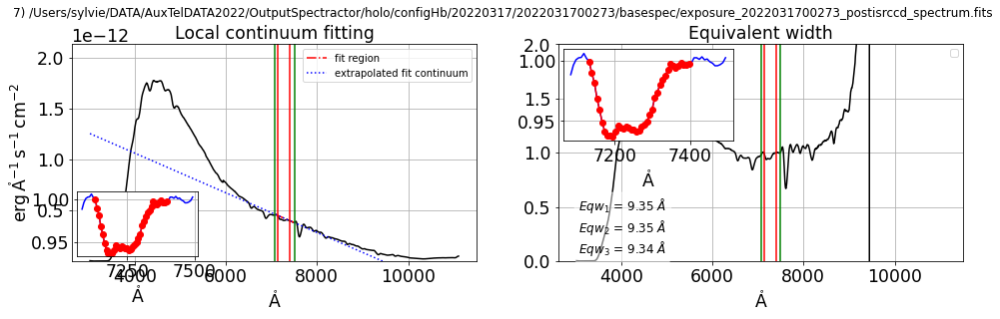

7 ) eqw_h2o_2= 9.336137259085653
set date_obs to 2022-03-18T01:11:46.031
set expo to 20.0
set airmass to 1.16193866550813
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1650200479066801
set dec to -32.3064444444444
set hour_angle to 35.99118130784399
set temperature to 8.9
set pressure to 743.4
set humidity to 53.0
set lambda_ref to 625.9517855761172
set parallactic_angle to 95.86593376321808
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_187 PM_ERR_MINA_187 PM_ERR_ANGLE_187 Z_VALUE_187 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:16:48  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


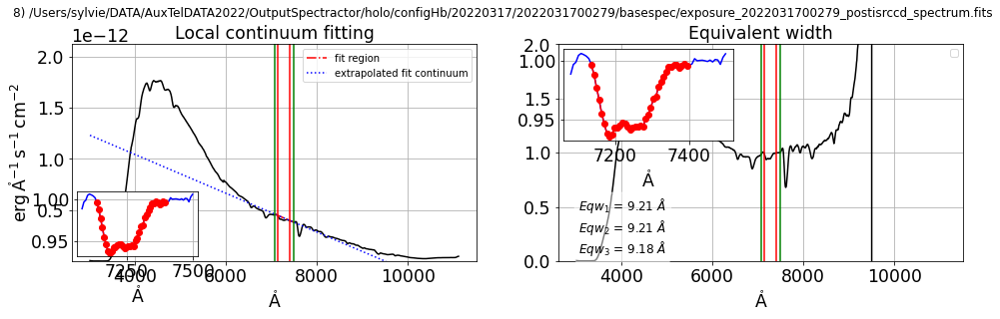

8 ) eqw_h2o_2= 9.179091443466735
set date_obs to 2022-03-18T01:15:18.583
set expo to 20.0
set airmass to 1.17105276018288
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1604530597215738
set dec to -32.3064444444444
set hour_angle to 36.87993052247099
set temperature to 8.9
set pressure to 743.45
set humidity to 54.0
set lambda_ref to 626.415954438991
set parallactic_angle to 96.20974235390722
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_188 PM_ERR_MINA_188 PM_ERR_ANGLE_188 Z_VALUE_188 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:16:54  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


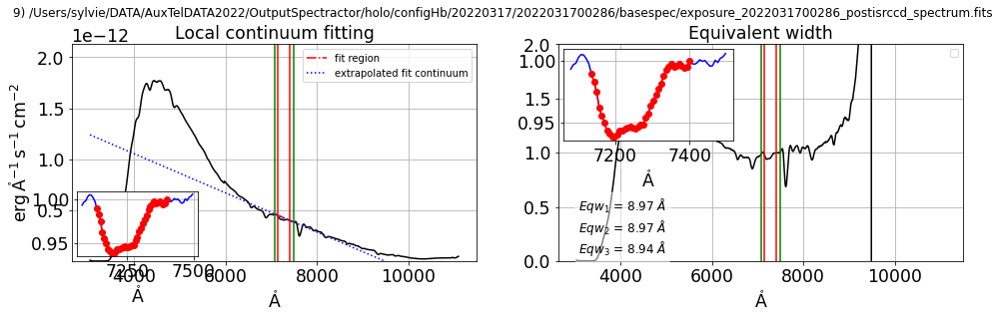

9 ) eqw_h2o_2= 8.939094363211598
set date_obs to 2022-03-18T01:18:45.526
set expo to 20.0
set airmass to 1.18024864471996
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.161506254140246
set dec to -32.3064444444444
set hour_angle to 37.74449227926539
set temperature to 9.0
set pressure to 743.45
set humidity to 53.0
set lambda_ref to 626.2661772674467
set parallactic_angle to 96.54092631927332
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_189 PM_ERR_MINA_189 PM_ERR_ANGLE_189 Z_VALUE_189 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:16:59  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


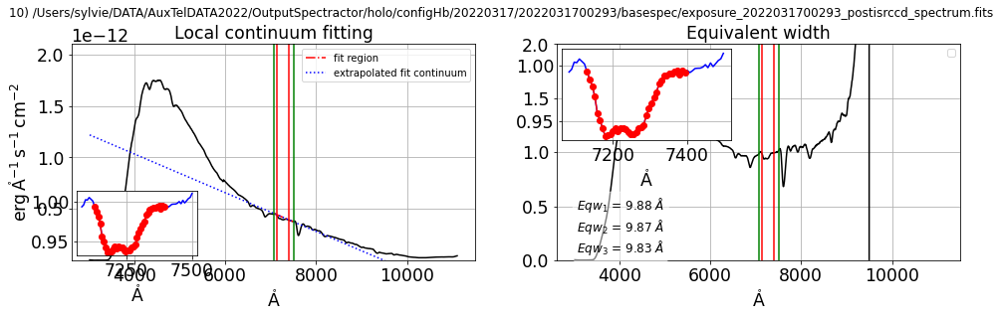

10 ) eqw_h2o_2= 9.831935238598934
set date_obs to 2022-03-18T01:22:16.238
set expo to 20.0
set airmass to 1.189962402398665
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1600582040885921
set dec to -32.3064444444444
set hour_angle to 38.6257061937975
set temperature to 8.9
set pressure to 743.4
set humidity to 56.0
set lambda_ref to 626.2915574183227
set parallactic_angle to 96.875483029922
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_190 PM_ERR_MINA_190 PM_ERR_ANGLE_190 Z_VALUE_190 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:17:04  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


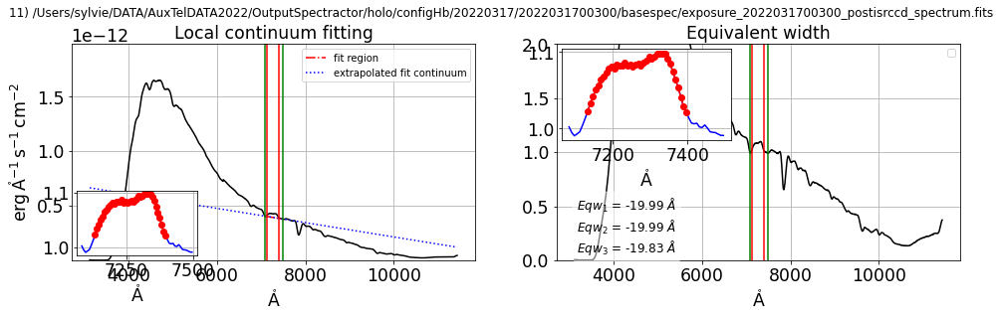

11 ) eqw_h2o_2= -19.827368342611663
set date_obs to 2022-03-18T01:22:49.144
set expo to 20.0
set airmass to 1.191505368069865
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1585750124351514
set dec to -32.3064444444444
set hour_angle to 38.76271209839639
set temperature to 9.0
set pressure to 743.45
set humidity to 56.0
set lambda_ref to 626.4868452630084
set parallactic_angle to 96.92724413418016
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_191 PM_ERR_MINA_191 PM_ERR_ANGLE_191 Z_VALUE_191 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           

2022-04-09 19:17:09  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


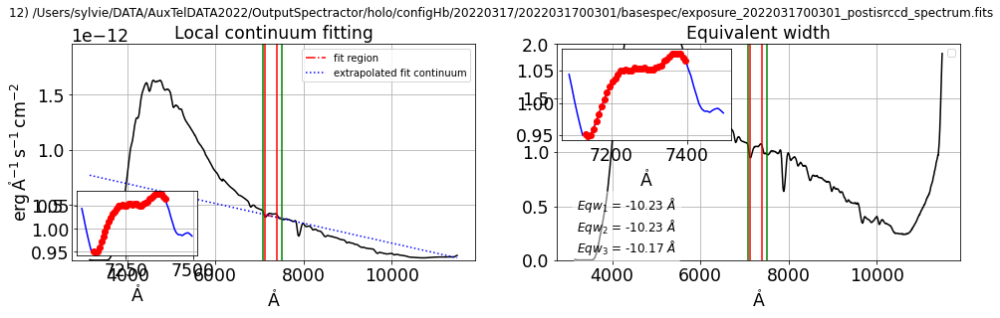

12 ) eqw_h2o_2= -10.165218247769406
set date_obs to 2022-03-18T01:43:57.837
set expo to 20.0
set airmass to 1.25822658979951
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476502374643685
set dec to -32.3064444444444
set hour_angle to 44.06414790775874
set temperature to 8.8
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 626.6251269515418
set parallactic_angle to 98.88882683561982
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_192 PM_ERR_MINA_192 PM_ERR_ANGLE_192 Z_VALUE_192 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:17:13  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


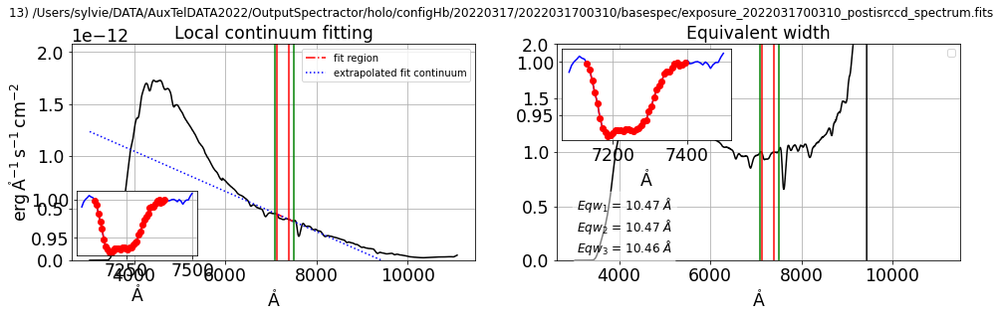

13 ) eqw_h2o_2= 10.462440821526194
set date_obs to 2022-03-18T01:46:52.361
set expo to 20.0
set airmass to 1.26858445121286
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476350630254128
set dec to -32.3064444444444
set hour_angle to 44.79438636254909
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 627.6256863262817
set parallactic_angle to 99.15414320783184
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_193 PM_ERR_MINA_193 PM_ERR_ANGLE_193 Z_VALUE_193 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:17:19  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


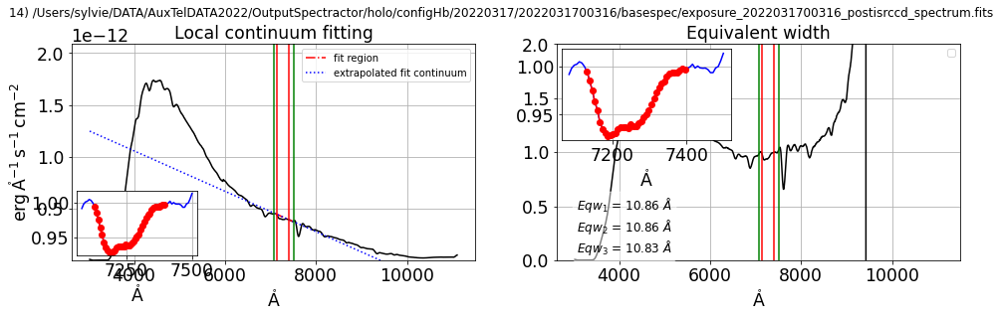

14 ) eqw_h2o_2= 10.833900308180379
set date_obs to 2022-03-18T01:47:25.256
set expo to 20.0
set airmass to 1.27056341471374
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1466645118411156
set dec to -32.3064444444444
set hour_angle to 44.9315970155517
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 625.7408027741238
set parallactic_angle to 99.2038979478238
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_194 PM_ERR_MINA_194 PM_ERR_ANGLE_194 Z_VALUE_194 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:17:23  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


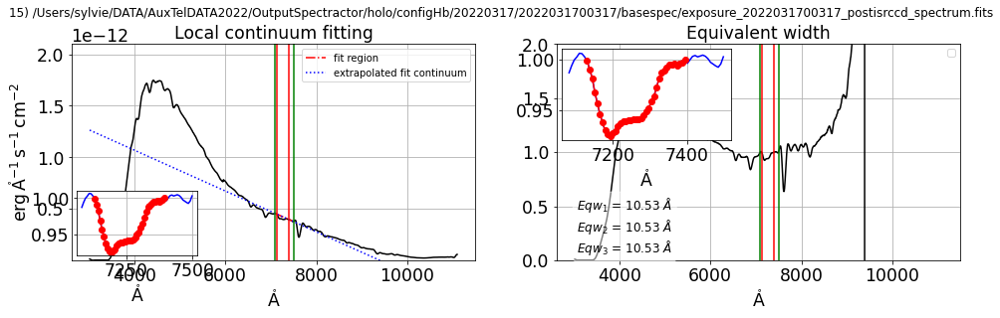

15 ) eqw_h2o_2= 10.526617755680483
set date_obs to 2022-03-18T01:53:46.736
set expo to 20.0
set airmass to 1.294394244363805
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1444547716136137
set dec to -32.3064444444444
set hour_angle to 46.52581667330039
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.9120383005036
set parallactic_angle to 99.77999069166285
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_195 PM_ERR_MINA_195 PM_ERR_ANGLE_195 Z_VALUE_195 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:17:29  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


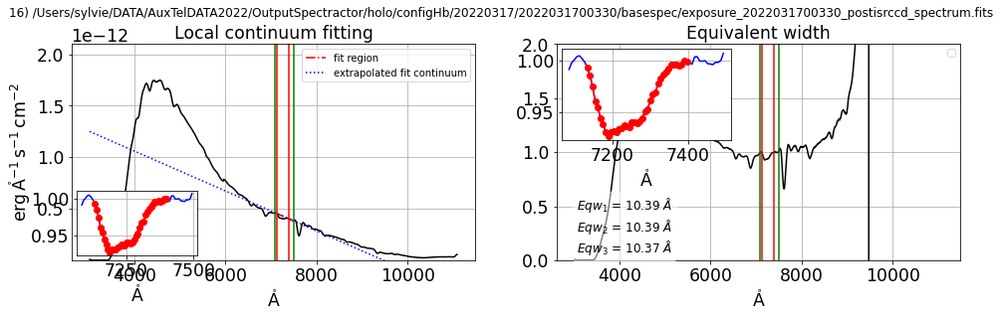

16 ) eqw_h2o_2= 10.368901283080268
set date_obs to 2022-03-18T01:54:19.724
set expo to 20.0
set airmass to 1.29652271576687
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1441648974084375
set dec to -32.3064444444444
set hour_angle to 46.6628171725209
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.7462807078947
set parallactic_angle to 99.82934304254884
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_196 PM_ERR_MINA_196 PM_ERR_ANGLE_196 Z_VALUE_196 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:17:34  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


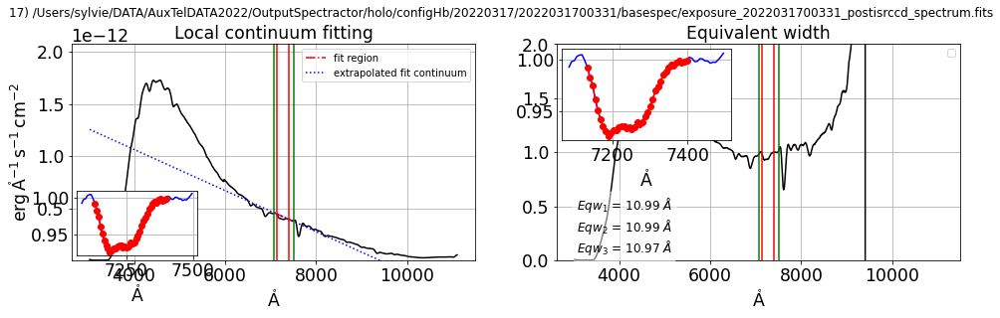

17 ) eqw_h2o_2= 10.9659045103192
set date_obs to 2022-03-18T01:57:49.306
set expo to 20.0
set airmass to 1.31035777011874
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1437462230173573
set dec to -32.3064444444444
set hour_angle to 47.53898537176394
set temperature to 8.7
set pressure to 743.45
set humidity to 57.0
set lambda_ref to 628.9551099539515
set parallactic_angle to 100.14447493807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_197 PM_ERR_MINA_197 PM_ERR_ANGLE_197 Z_VALUE_197 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:17:39  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


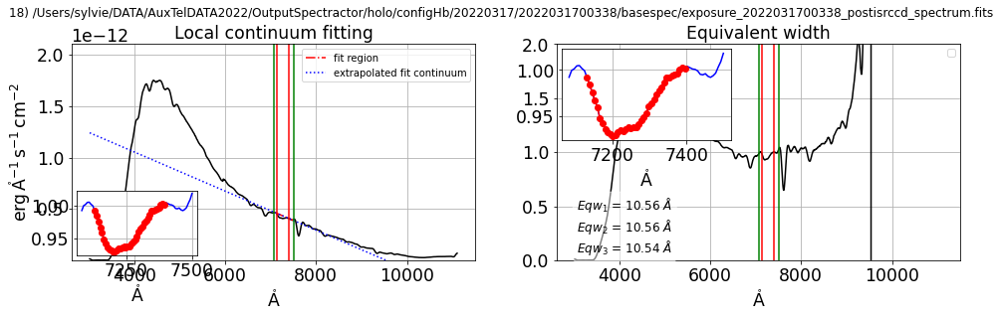

18 ) eqw_h2o_2= 10.536616569519746
set date_obs to 2022-03-18T02:01:19.196
set expo to 20.0
set airmass to 1.324716687989025
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1392710710370809
set dec to -32.3064444444444
set hour_angle to 48.4163008821963
set temperature to 8.6
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 626.8625000130343
set parallactic_angle to 100.4592627484374
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_198 PM_ERR_MINA_198 PM_ERR_ANGLE_198 Z_VALUE_198 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:17:45  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


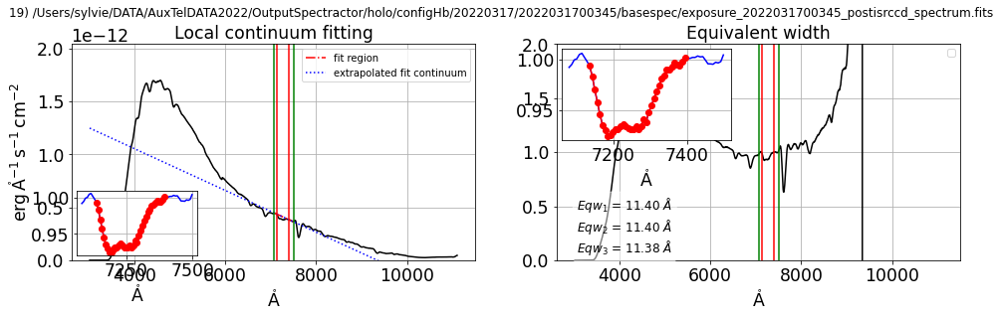

19 ) eqw_h2o_2= 11.383094494217435
set date_obs to 2022-03-18T02:04:16.794
set expo to 20.0
set airmass to 1.33727547076682
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1388486262435704
set dec to -32.3064444444444
set hour_angle to 49.15879882143194
set temperature to 8.5
set pressure to 743.45
set humidity to 58.0
set lambda_ref to 628.5424256920012
set parallactic_angle to 100.7251843777299
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_199 PM_ERR_MINA_199 PM_ERR_ANGLE_199 Z_VALUE_199 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:17:50  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


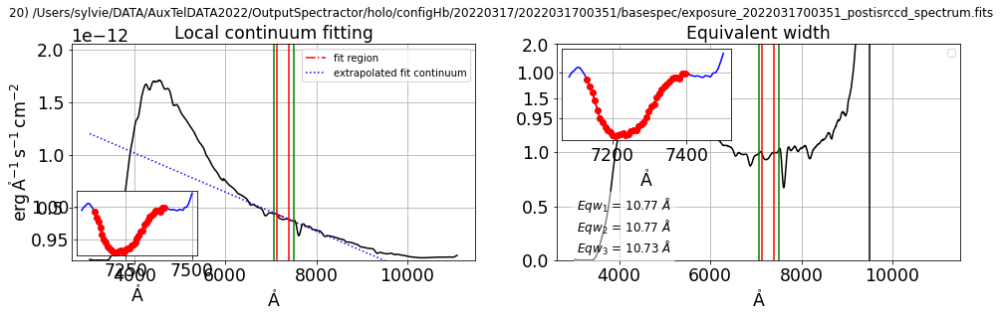

20 ) eqw_h2o_2= 10.732774081076315
set date_obs to 2022-03-18T02:04:49.712
set expo to 20.0
set airmass to 1.33963651479802
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1368681187146323
set dec to -32.3064444444444
set hour_angle to 49.29580448438519
set temperature to 8.5
set pressure to 743.35
set humidity to 58.0
set lambda_ref to 628.2086674961155
set parallactic_angle to 100.7742095756281
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_200 PM_ERR_MINA_200 PM_ERR_ANGLE_200 Z_VALUE_200 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:17:55  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


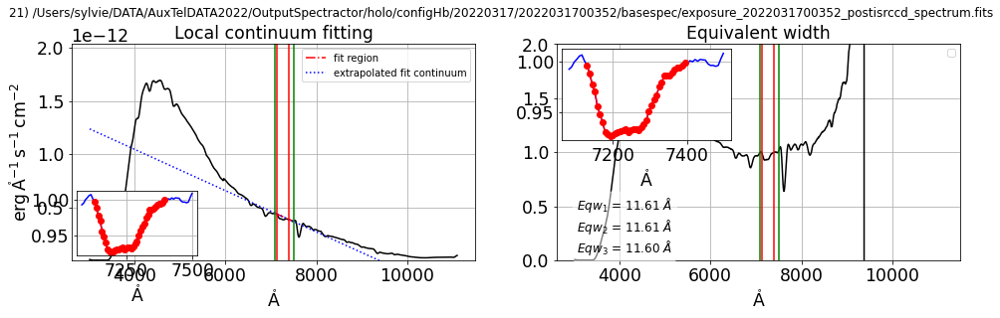

21 ) eqw_h2o_2= 11.595633144535265
set date_obs to 2022-03-18T02:07:49.074
set expo to 20.0
set airmass to 1.352787300037425
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1331931685876357
set dec to -32.3064444444444
set hour_angle to 50.04587365708529
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 627.9591693143808
set parallactic_angle to 101.0424069948098
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_201 PM_ERR_MINA_201 PM_ERR_ANGLE_201 Z_VALUE_201 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:18:00  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


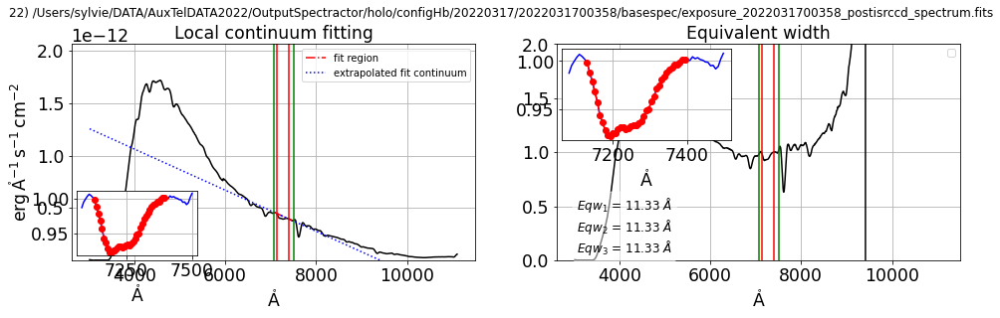

22 ) eqw_h2o_2= 11.328411206539455
set date_obs to 2022-03-18T02:11:20.051
set expo to 20.0
set airmass to 1.368765631503195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1336440841342464
set dec to -32.3064444444444
set hour_angle to 50.92719907664954
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 622.7051672626101
set parallactic_angle to 101.357174452077
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_202 PM_ERR_MINA_202 PM_ERR_ANGLE_202 Z_VALUE_202 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:18:05  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


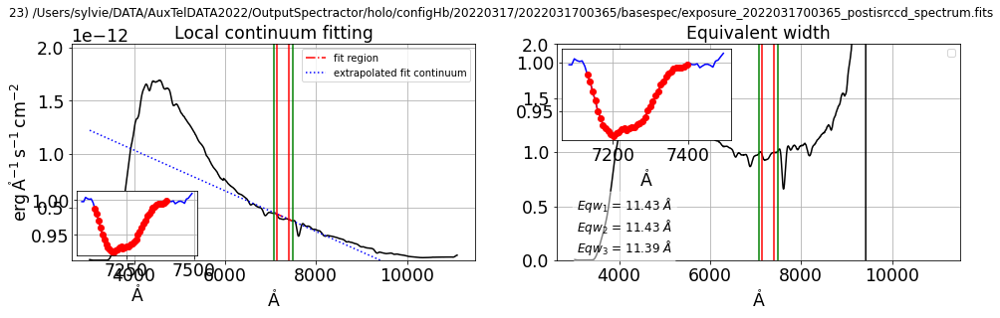

23 ) eqw_h2o_2= 11.385537686389434
set date_obs to 2022-03-18T02:11:53.006
set expo to 20.0
set airmass to 1.371319339871885
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1369079175197151
set dec to -32.3064444444444
set hour_angle to 51.06504024257939
set temperature to 8.4
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 629.1845159477502
set parallactic_angle to 101.4063764649771
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_203 PM_ERR_MINA_203 PM_ERR_ANGLE_203 Z_VALUE_203 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:18:10  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


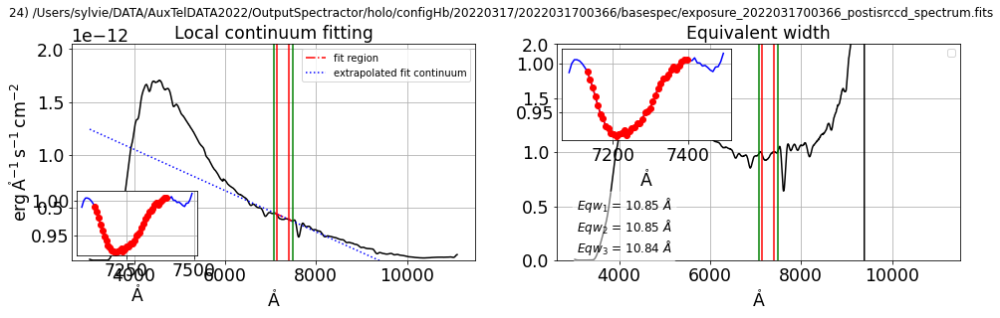

24 ) eqw_h2o_2= 10.836407391158335
set date_obs to 2022-03-18T02:14:46.798
set expo to 20.0
set airmass to 1.38501167017706
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1310814762516916
set dec to -32.3064444444444
set hour_angle to 51.79156958975715
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.5245232921197
set parallactic_angle to 101.6656129875546
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_204 PM_ERR_MINA_204 PM_ERR_ANGLE_204 Z_VALUE_204 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:18:15  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


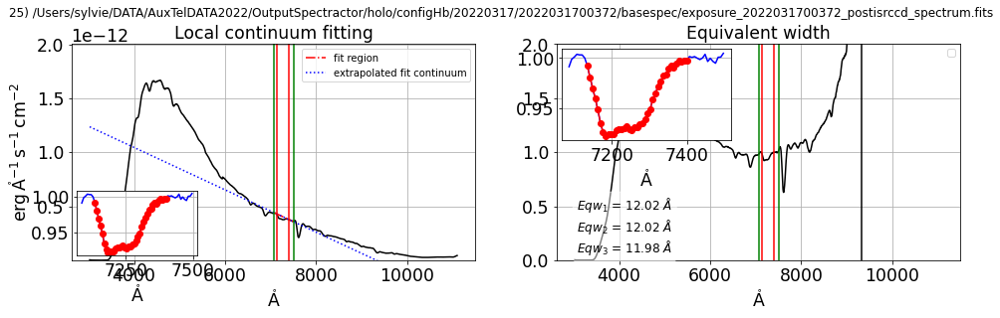

25 ) eqw_h2o_2= 11.978023614282574
set date_obs to 2022-03-18T02:15:19.743
set expo to 20.0
set airmass to 1.387649936190795
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1317245037126307
set dec to -32.3064444444444
set hour_angle to 51.92878009828319
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.9968889639981
set parallactic_angle to 101.7145568247823
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_205 PM_ERR_MINA_205 PM_ERR_ANGLE_205 Z_VALUE_205 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:18:20  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


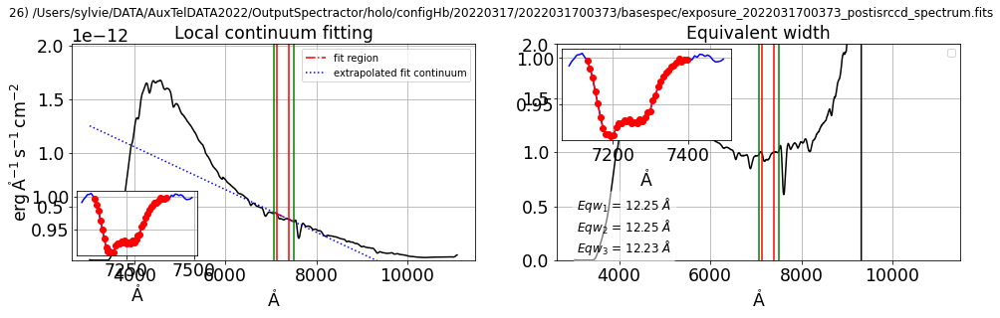

26 ) eqw_h2o_2= 12.229366775791771
set date_obs to 2022-03-18T02:33:33.012
set expo to 20.0
set airmass to 1.48452422171666
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1197628273916148
set dec to -32.3064444444444
set hour_angle to 56.49902324990354
set temperature to 8.0
set pressure to 743.35
set humidity to 63.0
set lambda_ref to 628.5888123380201
set parallactic_angle to 103.3450343494105
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_206 PM_ERR_MINA_206 PM_ERR_ANGLE_206 Z_VALUE_206 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:18:25  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


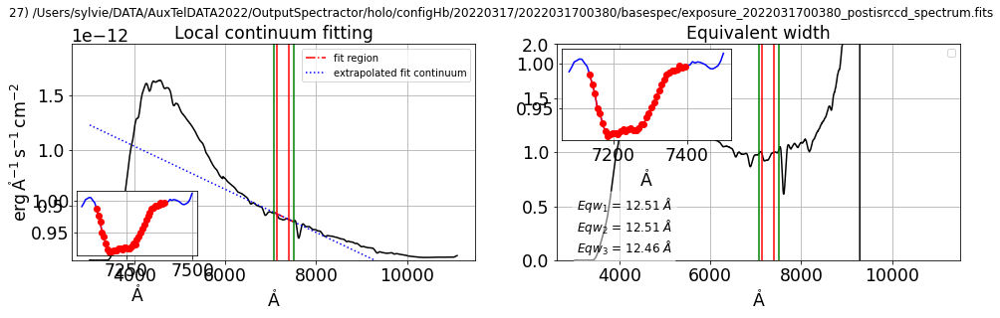

27 ) eqw_h2o_2= 12.45643458537974
set date_obs to 2022-03-18T02:36:30.874
set expo to 20.0
set airmass to 1.50213593383469
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1172584274998106
set dec to -32.3064444444444
set hour_angle to 57.24247377715349
set temperature to 8.1
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 633.8101508297243
set parallactic_angle to 103.6108187575918
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_207 PM_ERR_MINA_207 PM_ERR_ANGLE_207 Z_VALUE_207 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:18:29  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


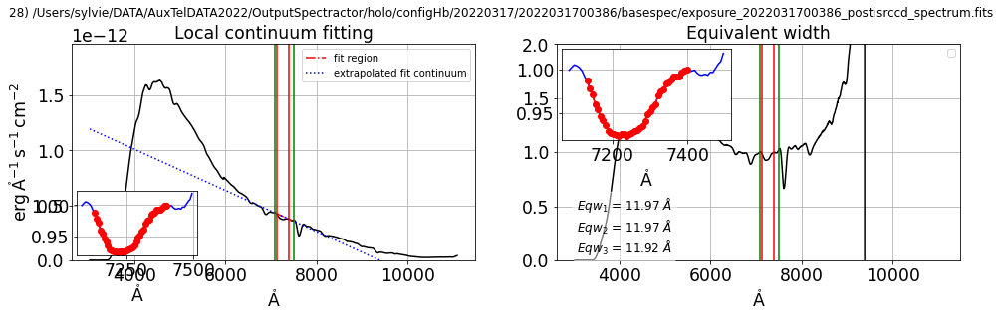

28 ) eqw_h2o_2= 11.921517769121762
set date_obs to 2022-03-18T02:37:03.815
set expo to 20.0
set airmass to 1.50545657928364
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1211335036558286
set dec to -32.3064444444444
set hour_angle to 57.37947904087095
set temperature to 8.1
set pressure to 743.35
set humidity to 64.0
set lambda_ref to 628.2172036981787
set parallactic_angle to 103.6598297048832
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_208 PM_ERR_MINA_208 PM_ERR_ANGLE_208 Z_VALUE_208 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:18:35  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


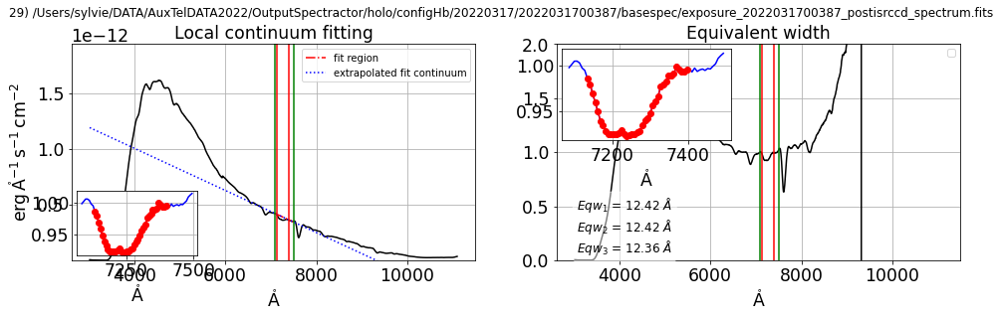

29 ) eqw_h2o_2= 12.361154730465811
set date_obs to 2022-03-18T02:40:00.839
set expo to 20.0
set airmass to 1.523657512515415
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1177429780701742
set dec to -32.3064444444444
set hour_angle to 58.11949120092164
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.3577400172557
set parallactic_angle to 103.9247454603291
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_209 PM_ERR_MINA_209 PM_ERR_ANGLE_209 Z_VALUE_209 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:18:39  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


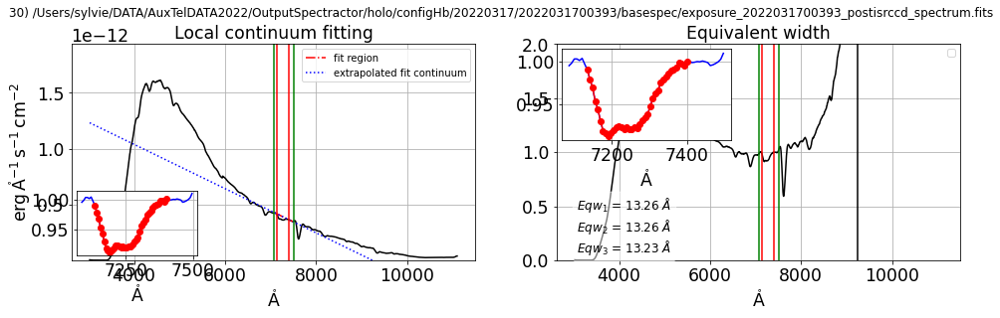

30 ) eqw_h2o_2= 13.225560264792163
set date_obs to 2022-03-18T02:40:33.787
set expo to 20.0
set airmass to 1.527114954027915
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1169167488860146
set dec to -32.3064444444444
set hour_angle to 58.25733391386269
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.7847433714671
set parallactic_angle to 103.9741296646409
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_210 PM_ERR_MINA_210 PM_ERR_ANGLE_210 Z_VALUE_210 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:18:45  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


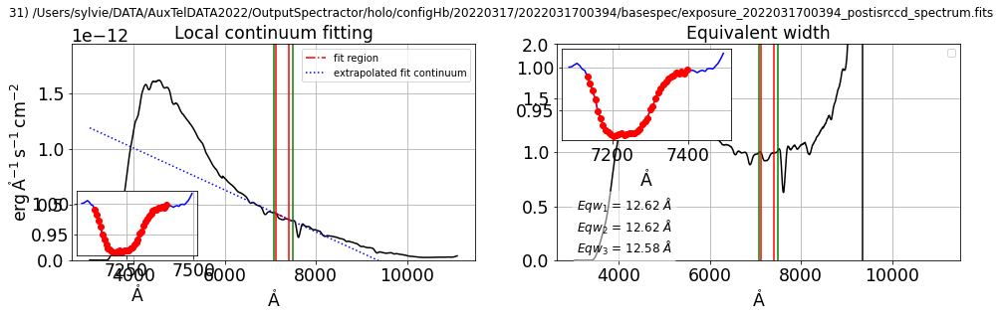

31 ) eqw_h2o_2= 12.577649109087691
set date_obs to 2022-03-18T02:44:05.105
set expo to 20.0
set airmass to 1.54976447202586
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1144055844584487
set dec to -32.3064444444444
set hour_angle to 59.14046723526914
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 629.2826348266267
set parallactic_angle to 104.2908413745483
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_211 PM_ERR_MINA_211 PM_ERR_ANGLE_211 Z_VALUE_211 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:18:50  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


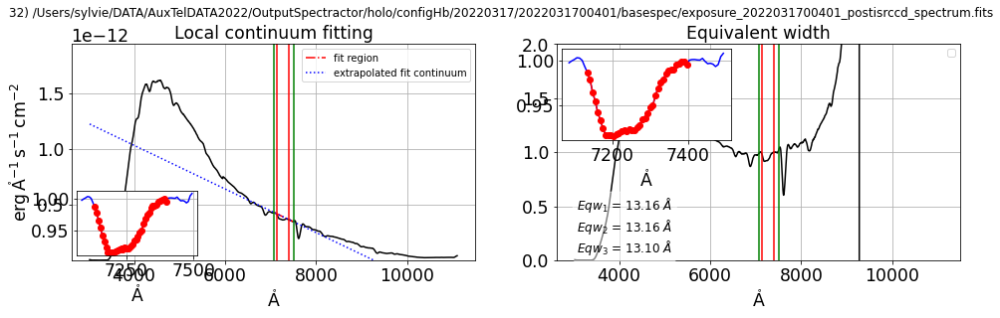

32 ) eqw_h2o_2= 13.101471269626188
set date_obs to 2022-03-18T02:47:02.835
set expo to 20.0
set airmass to 1.56951976624838
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.113192412444726
set dec to -32.3064444444444
set hour_angle to 59.88301895711849
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 623.392411114623
set parallactic_angle to 104.5576025273592
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_212 PM_ERR_MINA_212 PM_ERR_ANGLE_212 Z_VALUE_212 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:18:55  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


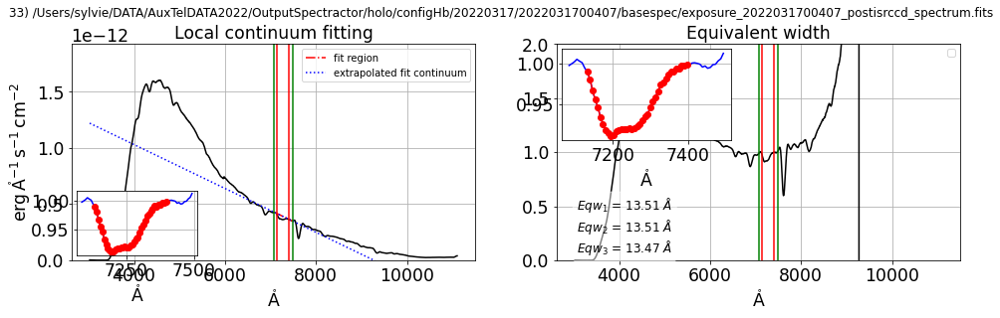

33 ) eqw_h2o_2= 13.46524470101946
set date_obs to 2022-03-18T02:47:35.769
set expo to 20.0
set airmass to 1.573248011911855
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1127873058479127
set dec to -32.3064444444444
set hour_angle to 60.02106934614464
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 624.3168639615992
set parallactic_angle to 104.6072480488688
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_213 PM_ERR_MINA_213 PM_ERR_ANGLE_213 Z_VALUE_213 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:19:01  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


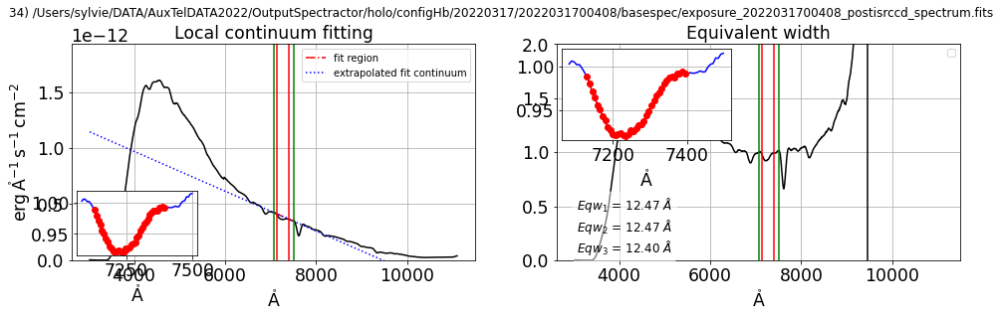

34 ) eqw_h2o_2= 12.404525502297826
set date_obs to 2022-03-18T02:50:38.306
set expo to 20.0
set airmass to 1.594345273370295
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1038057563272595
set dec to -32.3064444444444
set hour_angle to 60.78322641711044
set temperature to 8.0
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 625.6140852852044
set parallactic_angle to 104.8816435668321
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_214 PM_ERR_MINA_214 PM_ERR_ANGLE_214 Z_VALUE_214 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:19:06  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


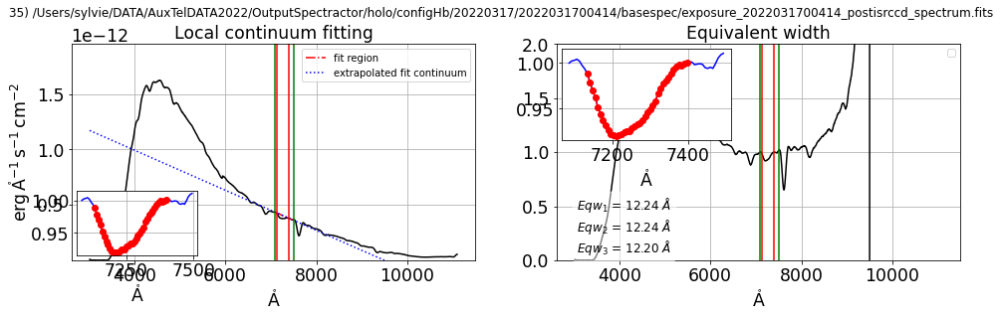

35 ) eqw_h2o_2= 12.202074471834166
set date_obs to 2022-03-18T03:08:41.573
set expo to 20.0
set airmass to 1.73594131895663
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09058150608401207
set dec to -32.3064444444444
set hour_angle to 65.3119392087705
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 631.9889212287092
set parallactic_angle to 106.5252810168807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_215 PM_ERR_MINA_215 PM_ERR_ANGLE_215 Z_VALUE_215 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:19:13  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


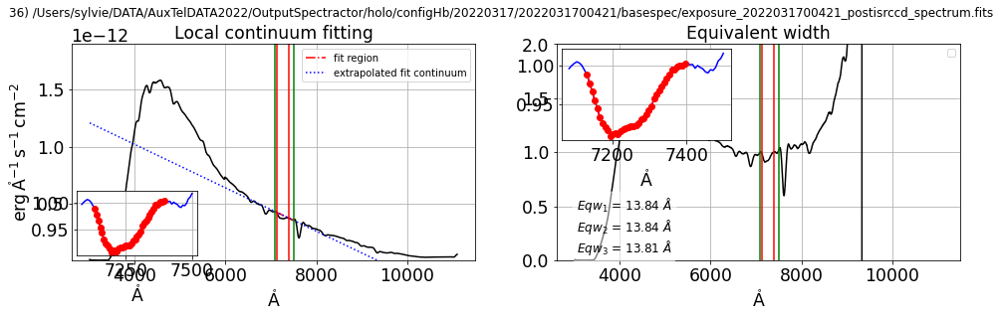

36 ) eqw_h2o_2= 13.808899298469465
set date_obs to 2022-03-18T03:09:14.484
set expo to 20.0
set airmass to 1.740715384660955
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09733707671582016
set dec to -32.3064444444444
set hour_angle to 65.44894264967655
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 625.9596270530473
set parallactic_angle to 106.5754178018598
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_216 PM_ERR_MINA_216 PM_ERR_ANGLE_216 Z_VALUE_216 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:19:19  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


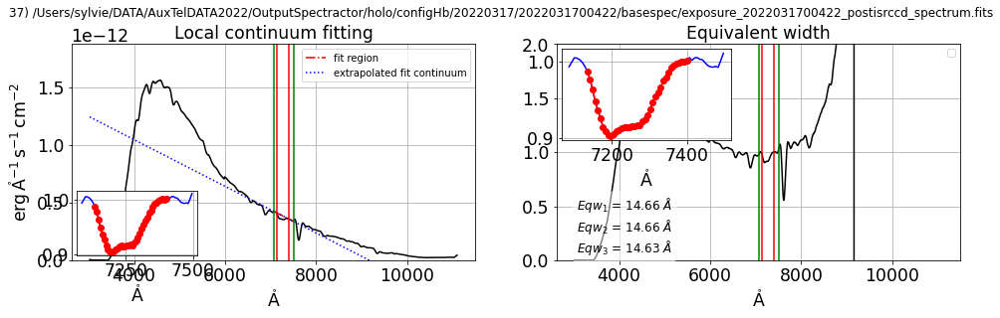

37 ) eqw_h2o_2= 14.6271490355397
set date_obs to 2022-03-18T03:12:54.310
set expo to 20.0
set airmass to 2.129245852899135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.143944791309082
set dec to -87.4721944444444
set hour_angle to -155.5929780702915
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 686.0625390317258
set parallactic_angle to -156.1678055894986
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_217 PM_ERR_MINA_217 PM_ERR_ANGLE_217 Z_VALUE_217 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
HD 185975 20 28 18.7398 -87 28 19.937      14       14 ...           0.017           

2022-04-09 19:19:25  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


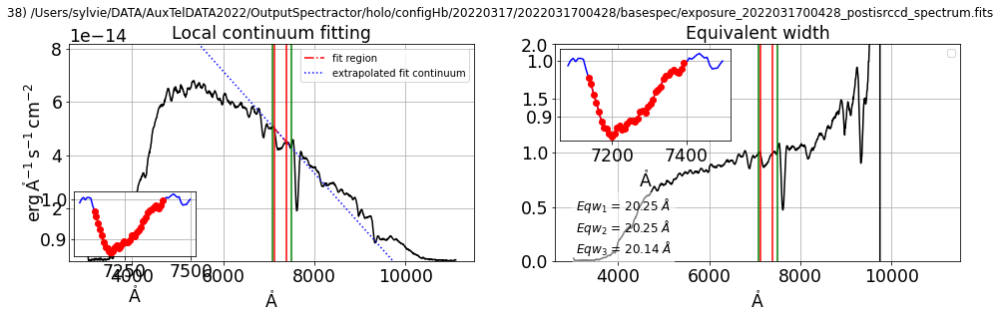

38 ) eqw_h2o_2= 20.13652179340118
set date_obs to 2022-03-18T03:13:27.208
set expo to 20.0
set airmass to 2.1290679262036
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09887590360164929
set dec to -87.4721944444444
set hour_angle to -155.455137691263
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 636.4362643500099
set parallactic_angle to -156.0330469936088
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_218 PM_ERR_MINA_218 PM_ERR_ANGLE_218 Z_VALUE_218 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
HD 185975 20 28 18.7398 -87 28 19.937      14       14 ...           0.017           

2022-04-09 19:19:32  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


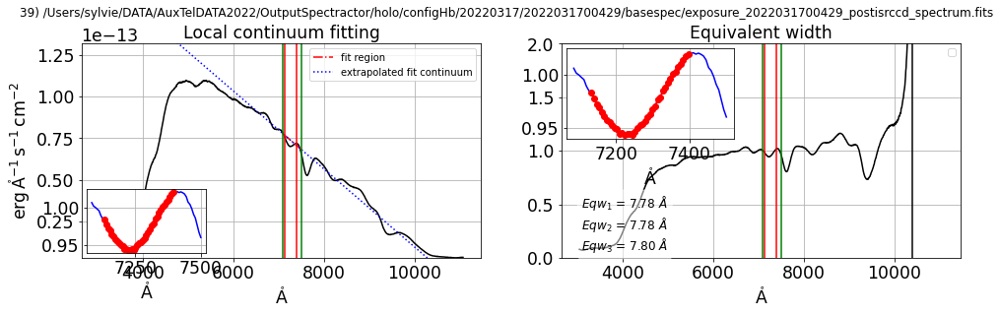

39 ) eqw_h2o_2= 7.796171288399849
set date_obs to 2022-03-18T03:17:06.794
set expo to 20.0
set airmass to 1.81309435755974
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09210139501009447
set dec to -32.3064444444444
set hour_angle to 67.42354300312304
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 626.8738274489511
set parallactic_angle to 107.3011935159837
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_219 PM_ERR_MINA_219 PM_ERR_ANGLE_219 Z_VALUE_219 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:19:37  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


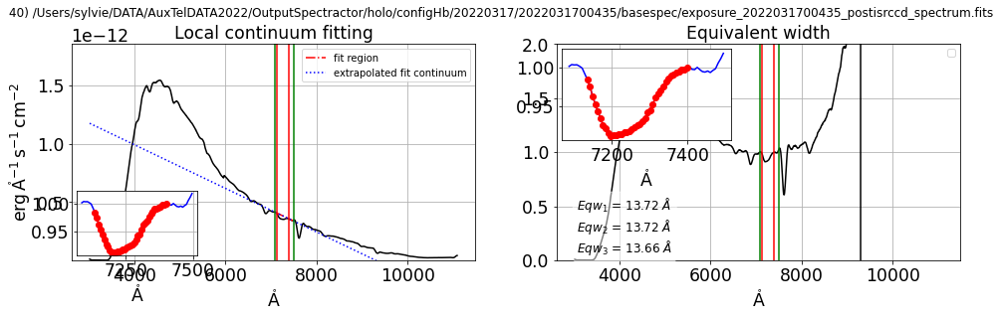

40 ) eqw_h2o_2= 13.65996172312955
set date_obs to 2022-03-18T03:17:39.779
set expo to 20.0
set airmass to 1.818418067455135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.08344429603447075
set dec to -32.3064444444444
set hour_angle to 67.56159248336594
set temperature to 7.7
set pressure to 743.4
set humidity to 63.0
set lambda_ref to 632.4252252976918
set parallactic_angle to 107.3521665962106
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_220 PM_ERR_MINA_220 PM_ERR_ANGLE_220 Z_VALUE_220 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:19:43  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


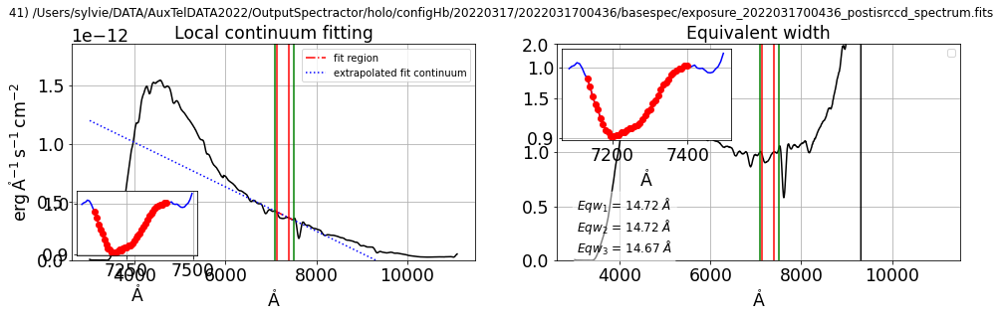

41 ) eqw_h2o_2= 14.668435726824203
set date_obs to 2022-03-18T03:21:26.873
set expo to 20.0
set airmass to 1.856070090955285
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.06347269052355019
set dec to -32.3064444444444
set hour_angle to 68.51099093135984
set temperature to 7.8
set pressure to 743.4
set humidity to 62.0
set lambda_ref to 630.0633085655397
set parallactic_angle to 107.7035936917225
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_221 PM_ERR_MINA_221 PM_ERR_ANGLE_221 Z_VALUE_221 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:19:50  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


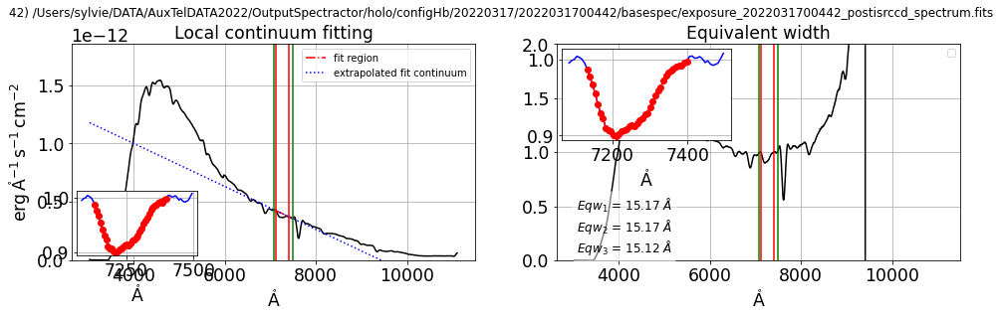

42 ) eqw_h2o_2= 15.116485112274463
set date_obs to 2022-03-18T03:21:59.878
set expo to 20.0
set airmass to 1.861691550345225
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.0769189759908508
set dec to -32.3064444444444
set hour_angle to 68.64883074724754
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 633.3015467495994
set parallactic_angle to 107.7547458765076
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_222 PM_ERR_MINA_222 PM_ERR_ANGLE_222 Z_VALUE_222 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:19:57  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


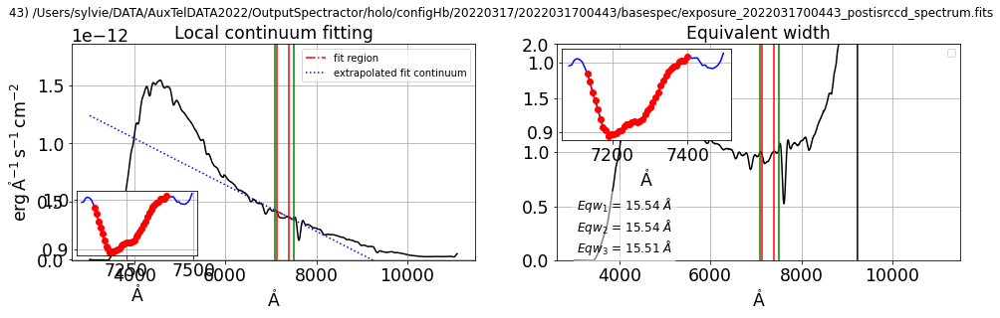

43 ) eqw_h2o_2= 15.509236175794511


In [123]:
WLMIN=300
WLMAX=1000
lambdas = np.arange(WLMIN,WLMAX,1)
fwhm_func = interp1d(lambdas, 0.01 * lambdas)
parameters.DISPLAY=False


for IDXSEL in np.arange(0,NN):
    filename_SEL=all_good_spectra_spectrum_files[IDXSEL]
    filename_spectrogram_SEL=filename_SEL.replace("_spectrum","_spectrogram")
    fullfilename_SEL = os.path.join(dir_spectra,filename_SEL)
    fullfilename_spectrogram_SEL = fullfilename_SEL.replace("_spectrum","_spectrogram")
    
    # load the spectrum
    s=Spectrum(fullfilename_SEL, config=config)
    s.load_spectrogram(fullfilename_spectrogram_SEL) 
    
    
    lamb = 10*s.lambdas * u.AA 
    flux = s.data * u.Unit('erg cm-2 s-1 AA-1')/10 
    spec = Spectrum1D(spectral_axis=lamb, flux=flux) 
    fluxerr = s.err * u.Unit('erg cm-2 s-1 AA-1')/10. 
    specerr = Spectrum1D(spectral_axis=lamb, flux=fluxerr)
    
    # H2O line
    
    #wlmin=10*(H2O_1.wavelength-30)*u.AA
    #wlmax=10*(H2O_2.wavelength+30)*u.AA
    #wlminline=10*(H2O_1.wavelength-12)*u.AA
    #wlmaxline=10*(H2O_2.wavelength+10)*u.AA
    
    wlmin = wlmin_h2o_2
    wlmax = wlmax_h2o_2
    wlminline = wlminline_h2o_2
    wlmaxline = wlmaxline_h2o_2
    
    
    fig=plt.figure(figsize=(16,4))
    ax1 = fig.add_subplot(1, 2, 1)
    ax2 = fig.add_subplot(1, 2, 2)
    #eqw1,eqw2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    eqw1,eqw2,eqw3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    #eqw10,eqw20,eq1_set,eq2_set=ComputeEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=20,flag_plot=True,ax1=ax1,ax2=ax2)
    thetitle=str(IDXSEL)+") "+filename_SEL
    plt.suptitle(thetitle,y=1.01)
    plt.show() 
    
    print(IDXSEL,") eqw_h2o_2=",eqw3)
    
    df_infos.at[IDXSEL,"eqw_h2o_2"] =  eqw3


set date_obs to 2022-03-18T00:51:22.049
set expo to 20.0
set airmass to 1.11557476948966
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1753951396614214
set dec to -32.3064444444444
set hour_angle to 30.8762989508295
set temperature to 8.9
set pressure to 743.45
set humidity to 48.0
set lambda_ref to 626.6801216985461
set parallactic_angle to 93.8012496664173
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_223 PM_ERR_MINA_223 PM_ERR_ANGLE_223 Z_VALUE_223 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110               90   0.0003640     

2022-04-09 19:20:03  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


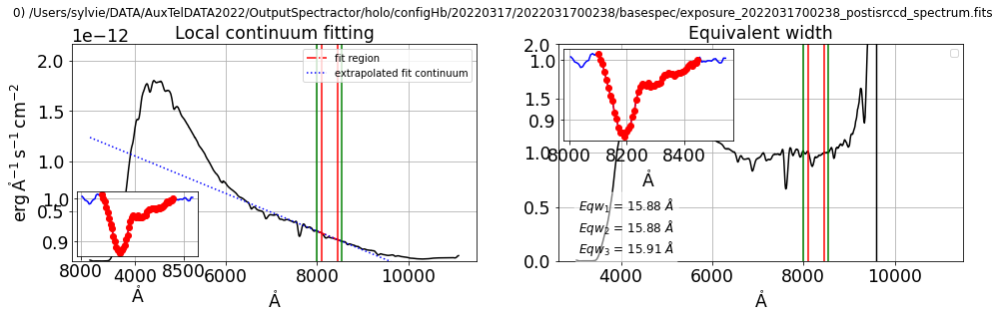

0 ) eqw_h2o_3= 15.910889994905338
set date_obs to 2022-03-18T00:54:16.312
set expo to 20.0
set airmass to 1.121576965054115
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1741806116248446
set dec to -32.3064444444444
set hour_angle to 31.60492174100415
set temperature to 8.9
set pressure to 743.45
set humidity to 49.0
set lambda_ref to 626.883564656571
set parallactic_angle to 94.10618686949074
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_224 PM_ERR_MINA_224 PM_ERR_ANGLE_224 Z_VALUE_224 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:20:10  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


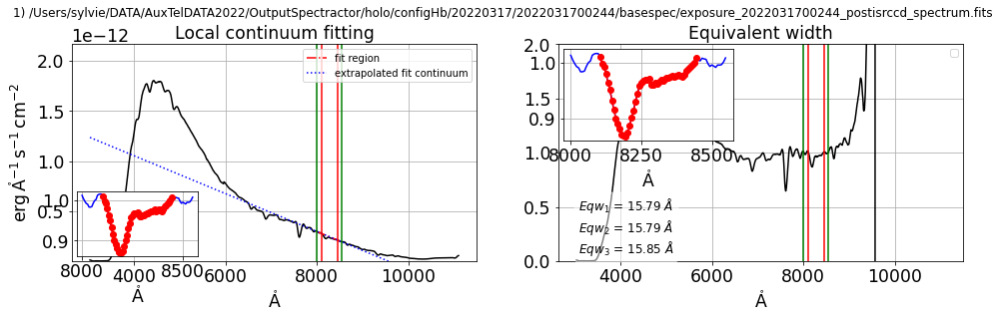

1 ) eqw_h2o_3= 15.84807159424358
set date_obs to 2022-03-18T00:54:49.235
set expo to 20.0
set airmass to 1.12272698054768
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1736210434249555
set dec to -32.3064444444444
set hour_angle to 31.7419273199217
set temperature to 8.8
set pressure to 743.4
set humidity to 49.0
set lambda_ref to 626.0378655266279
set parallactic_angle to 94.16305953909519
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_225 PM_ERR_MINA_225 PM_ERR_ANGLE_225 Z_VALUE_225 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:20:17  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


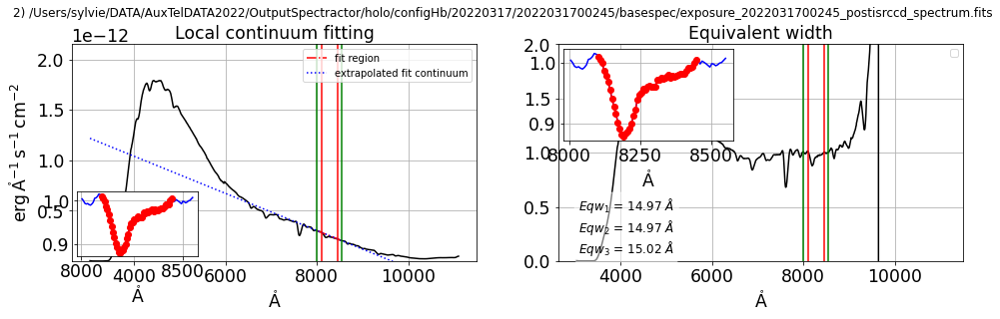

2 ) eqw_h2o_3= 15.02085178565237
set date_obs to 2022-03-18T00:57:47.565
set expo to 20.0
set airmass to 1.12910731186445
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1713060449152569
set dec to -32.3064444444444
set hour_angle to 32.4876824869983
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.4911208542796
set parallactic_angle to 94.47019502924495
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_226 PM_ERR_MINA_226 PM_ERR_ANGLE_226 Z_VALUE_226 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:20:25  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


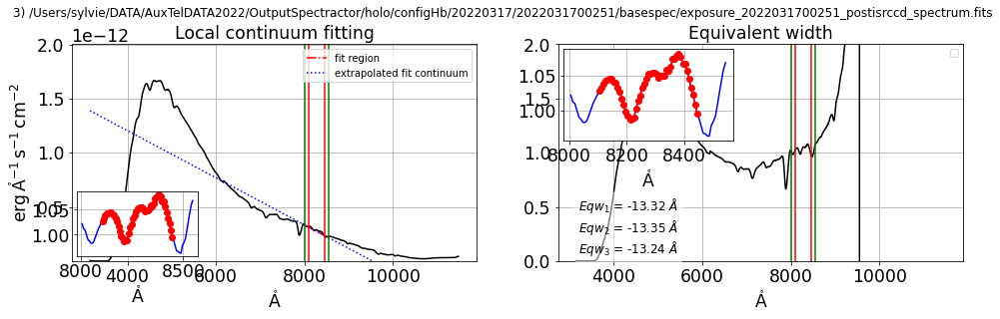

3 ) eqw_h2o_3= -13.236470754863085
set date_obs to 2022-03-18T00:58:20.709
set expo to 20.0
set airmass to 1.130309156823195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.169943439836599
set dec to -32.3064444444444
set hour_angle to 32.6255240863161
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.2751365569749
set parallactic_angle to 94.52653019757676
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_227 PM_ERR_MINA_227 PM_ERR_ANGLE_227 Z_VALUE_227 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:20:33  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


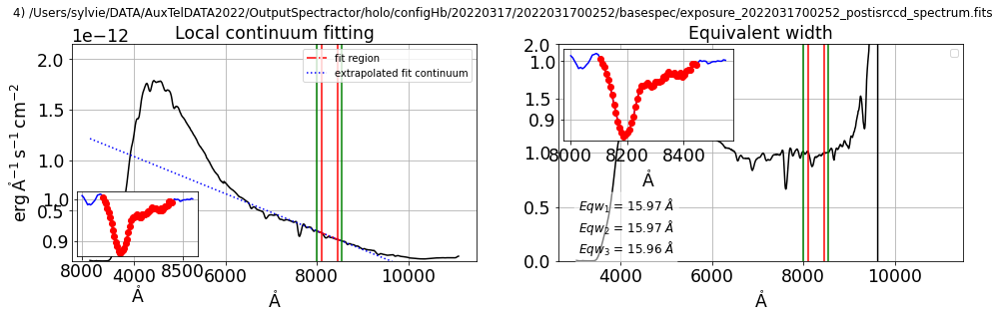

4 ) eqw_h2o_3= 15.964419520680769
set date_obs to 2022-03-18T01:04:49.716
set expo to 20.0
set airmass to 1.14502998698828
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1680537967029804
set dec to -32.3064444444444
set hour_angle to 34.25103021292454
set temperature to 8.9
set pressure to 743.3
set humidity to 53.0
set lambda_ref to 626.5383418087131
set parallactic_angle to 95.18153718788132
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_228 PM_ERR_MINA_228 PM_ERR_ANGLE_228 Z_VALUE_228 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:20:39  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


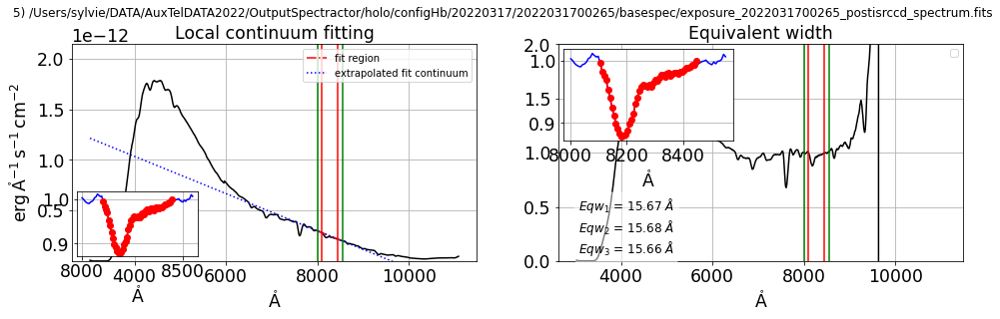

5 ) eqw_h2o_3= 15.661008858754371
set date_obs to 2022-03-18T01:08:18.080
set expo to 20.0
set airmass to 1.1533391050821
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.165620392992809
set dec to -32.3064444444444
set hour_angle to 35.12228883044955
set temperature to 8.9
set pressure to 743.3
set humidity to 51.0
set lambda_ref to 626.067912732114
set parallactic_angle to 95.52618006847594
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_229 PM_ERR_MINA_229 PM_ERR_ANGLE_229 Z_VALUE_229 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110  

2022-04-09 19:20:45  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


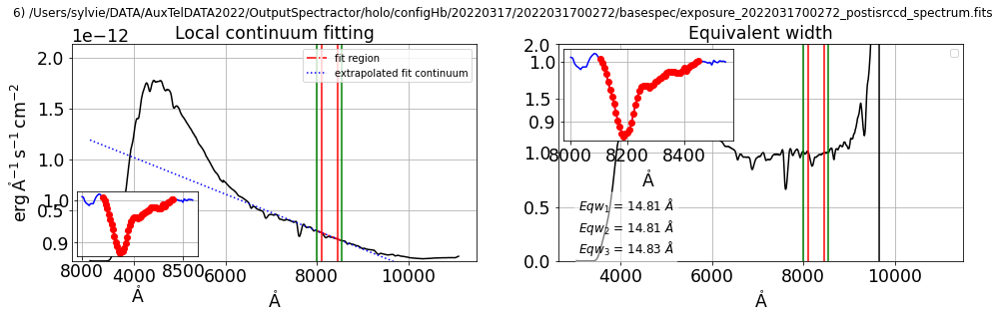

6 ) eqw_h2o_3= 14.83318724354776
set date_obs to 2022-03-18T01:08:50.992
set expo to 20.0
set airmass to 1.154683255421995
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1687630065527601
set dec to -32.3064444444444
set hour_angle to 35.26034049072464
set temperature to 8.9
set pressure to 743.35
set humidity to 51.0
set lambda_ref to 626.2488273411835
set parallactic_angle to 95.58041503368928
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_230 PM_ERR_MINA_230 PM_ERR_ANGLE_230 Z_VALUE_230 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:20:51  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


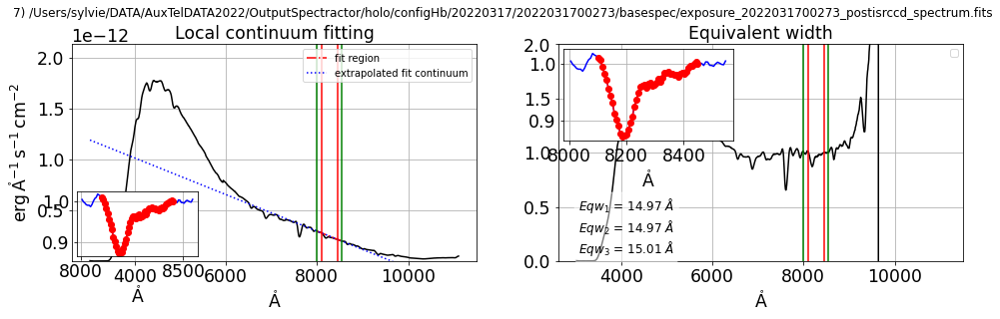

7 ) eqw_h2o_3= 15.005085807792916
set date_obs to 2022-03-18T01:11:46.031
set expo to 20.0
set airmass to 1.16193866550813
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1650200479066801
set dec to -32.3064444444444
set hour_angle to 35.99118130784399
set temperature to 8.9
set pressure to 743.4
set humidity to 53.0
set lambda_ref to 625.9517855761172
set parallactic_angle to 95.86593376321808
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_231 PM_ERR_MINA_231 PM_ERR_ANGLE_231 Z_VALUE_231 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:20:58  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


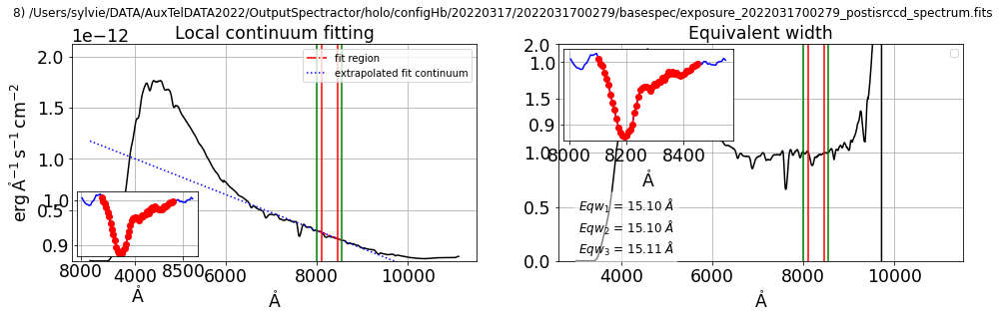

8 ) eqw_h2o_3= 15.113819409052148
set date_obs to 2022-03-18T01:15:18.583
set expo to 20.0
set airmass to 1.17105276018288
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1604530597215738
set dec to -32.3064444444444
set hour_angle to 36.87993052247099
set temperature to 8.9
set pressure to 743.45
set humidity to 54.0
set lambda_ref to 626.415954438991
set parallactic_angle to 96.20974235390722
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_232 PM_ERR_MINA_232 PM_ERR_ANGLE_232 Z_VALUE_232 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:21:04  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


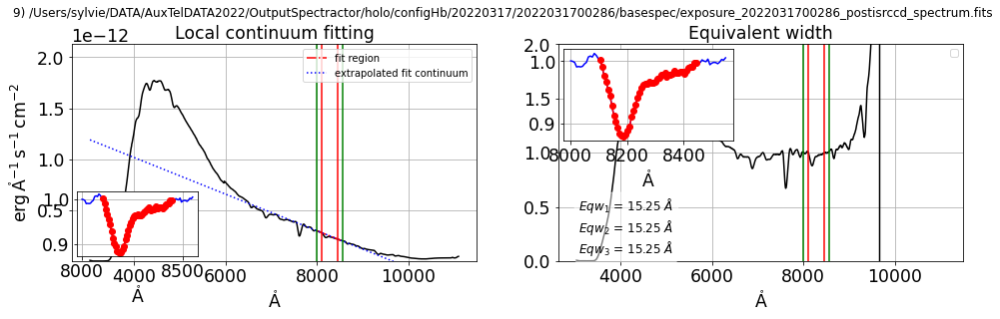

9 ) eqw_h2o_3= 15.249561617077992
set date_obs to 2022-03-18T01:18:45.526
set expo to 20.0
set airmass to 1.18024864471996
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.161506254140246
set dec to -32.3064444444444
set hour_angle to 37.74449227926539
set temperature to 9.0
set pressure to 743.45
set humidity to 53.0
set lambda_ref to 626.2661772674467
set parallactic_angle to 96.54092631927332
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_233 PM_ERR_MINA_233 PM_ERR_ANGLE_233 Z_VALUE_233 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:21:12  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


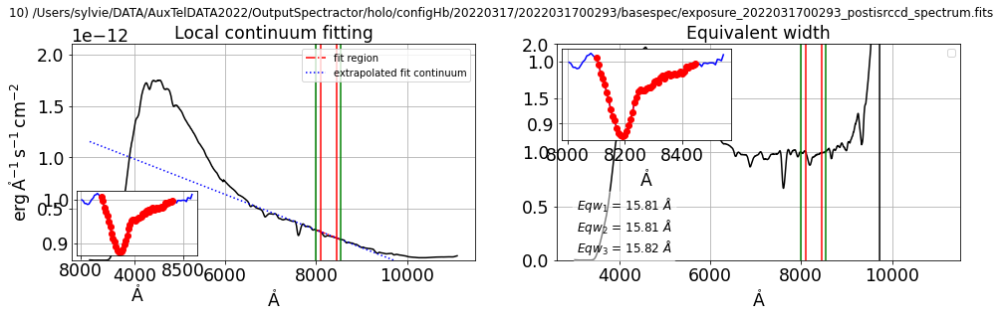

10 ) eqw_h2o_3= 15.82030414009297
set date_obs to 2022-03-18T01:22:16.238
set expo to 20.0
set airmass to 1.189962402398665
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1600582040885921
set dec to -32.3064444444444
set hour_angle to 38.6257061937975
set temperature to 8.9
set pressure to 743.4
set humidity to 56.0
set lambda_ref to 626.2915574183227
set parallactic_angle to 96.875483029922
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_234 PM_ERR_MINA_234 PM_ERR_ANGLE_234 Z_VALUE_234 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:21:19  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


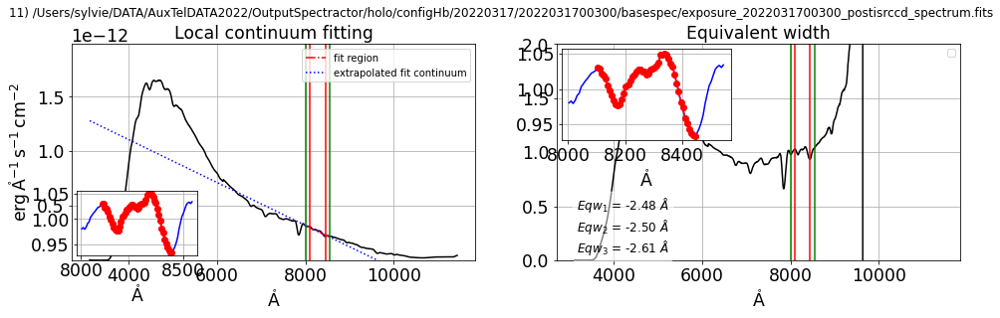

11 ) eqw_h2o_3= -2.610774941447332
set date_obs to 2022-03-18T01:22:49.144
set expo to 20.0
set airmass to 1.191505368069865
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1585750124351514
set dec to -32.3064444444444
set hour_angle to 38.76271209839639
set temperature to 9.0
set pressure to 743.45
set humidity to 56.0
set lambda_ref to 626.4868452630084
set parallactic_angle to 96.92724413418016
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_235 PM_ERR_MINA_235 PM_ERR_ANGLE_235 Z_VALUE_235 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:21:27  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


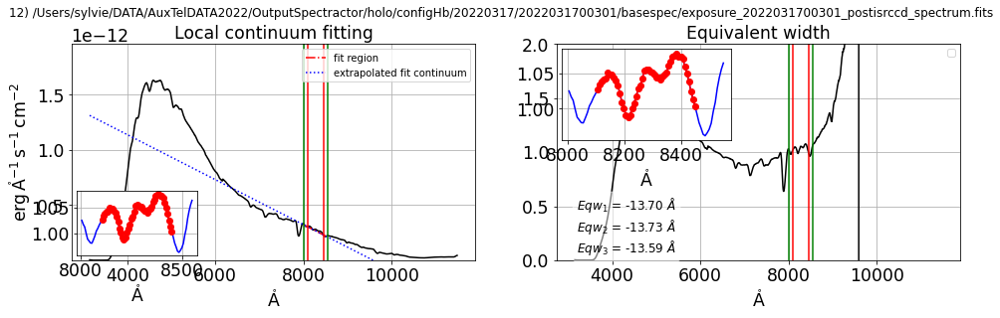

12 ) eqw_h2o_3= -13.5945824501635
set date_obs to 2022-03-18T01:43:57.837
set expo to 20.0
set airmass to 1.25822658979951
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476502374643685
set dec to -32.3064444444444
set hour_angle to 44.06414790775874
set temperature to 8.8
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 626.6251269515418
set parallactic_angle to 98.88882683561982
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_236 PM_ERR_MINA_236 PM_ERR_ANGLE_236 Z_VALUE_236 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:21:36  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


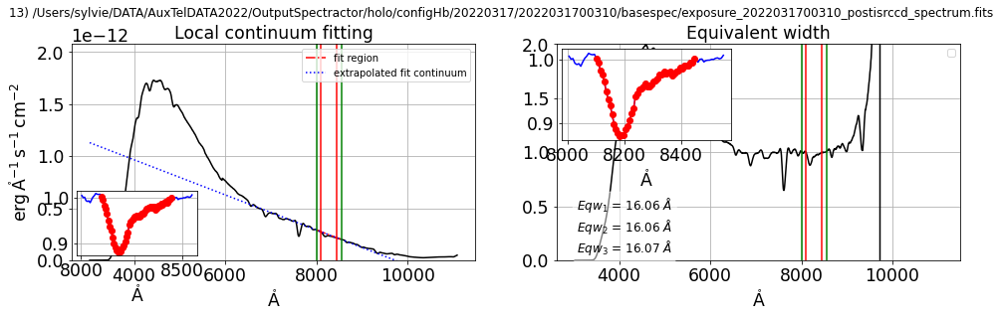

13 ) eqw_h2o_3= 16.067217546232296
set date_obs to 2022-03-18T01:46:52.361
set expo to 20.0
set airmass to 1.26858445121286
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476350630254128
set dec to -32.3064444444444
set hour_angle to 44.79438636254909
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 627.6256863262817
set parallactic_angle to 99.15414320783184
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_237 PM_ERR_MINA_237 PM_ERR_ANGLE_237 Z_VALUE_237 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:21:44  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


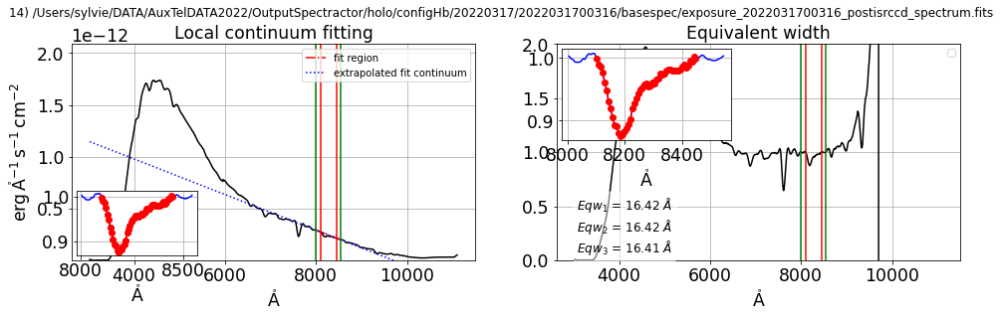

14 ) eqw_h2o_3= 16.41258472617408
set date_obs to 2022-03-18T01:47:25.256
set expo to 20.0
set airmass to 1.27056341471374
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1466645118411156
set dec to -32.3064444444444
set hour_angle to 44.9315970155517
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 625.7408027741238
set parallactic_angle to 99.2038979478238
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_238 PM_ERR_MINA_238 PM_ERR_ANGLE_238 Z_VALUE_238 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:21:53  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


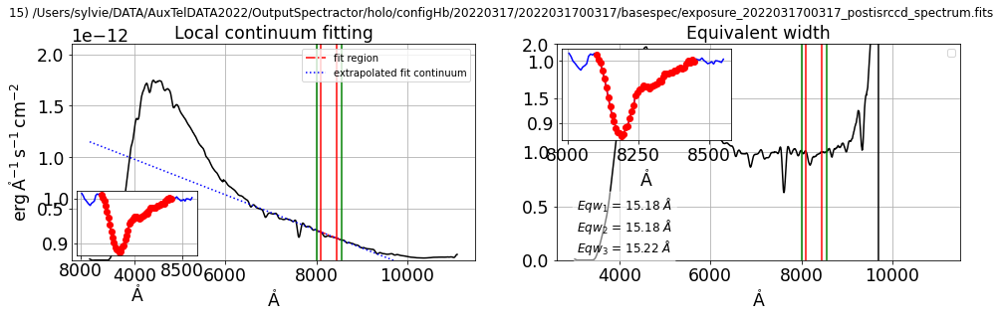

15 ) eqw_h2o_3= 15.215177937709742
set date_obs to 2022-03-18T01:53:46.736
set expo to 20.0
set airmass to 1.294394244363805
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1444547716136137
set dec to -32.3064444444444
set hour_angle to 46.52581667330039
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.9120383005036
set parallactic_angle to 99.77999069166285
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_239 PM_ERR_MINA_239 PM_ERR_ANGLE_239 Z_VALUE_239 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:22:00  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


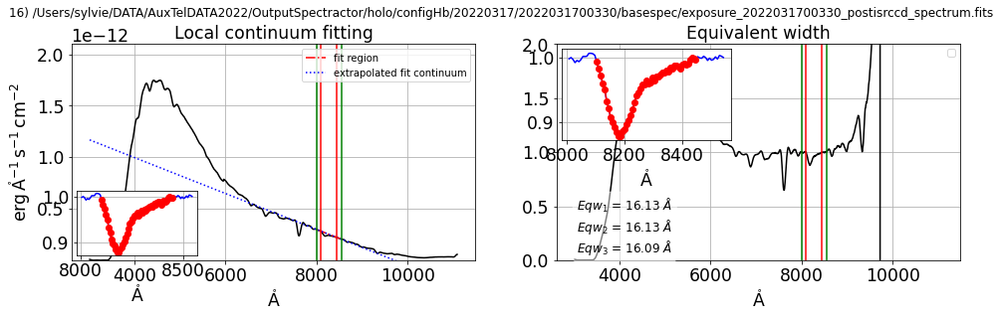

16 ) eqw_h2o_3= 16.09342604360835
set date_obs to 2022-03-18T01:54:19.724
set expo to 20.0
set airmass to 1.29652271576687
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1441648974084375
set dec to -32.3064444444444
set hour_angle to 46.6628171725209
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.7462807078947
set parallactic_angle to 99.82934304254884
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_240 PM_ERR_MINA_240 PM_ERR_ANGLE_240 Z_VALUE_240 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:22:08  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


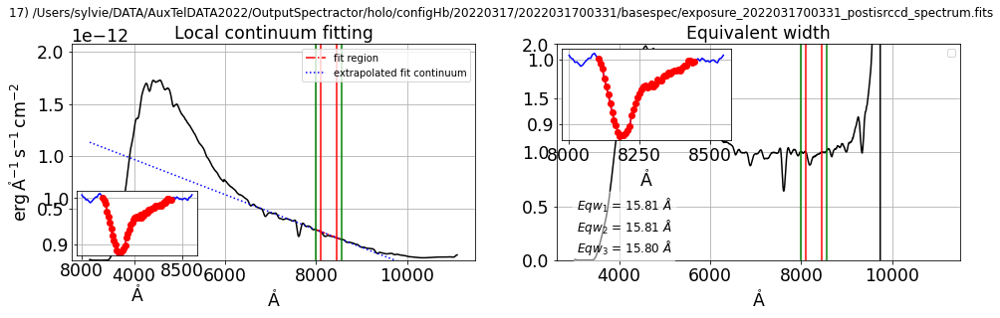

17 ) eqw_h2o_3= 15.801762814156515
set date_obs to 2022-03-18T01:57:49.306
set expo to 20.0
set airmass to 1.31035777011874
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1437462230173573
set dec to -32.3064444444444
set hour_angle to 47.53898537176394
set temperature to 8.7
set pressure to 743.45
set humidity to 57.0
set lambda_ref to 628.9551099539515
set parallactic_angle to 100.14447493807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_241 PM_ERR_MINA_241 PM_ERR_ANGLE_241 Z_VALUE_241 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:22:17  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


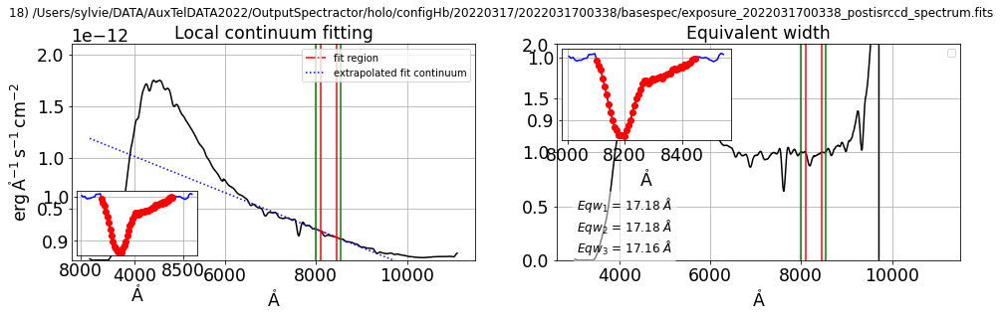

18 ) eqw_h2o_3= 17.155426541050844
set date_obs to 2022-03-18T02:01:19.196
set expo to 20.0
set airmass to 1.324716687989025
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1392710710370809
set dec to -32.3064444444444
set hour_angle to 48.4163008821963
set temperature to 8.6
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 626.8625000130343
set parallactic_angle to 100.4592627484374
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_242 PM_ERR_MINA_242 PM_ERR_ANGLE_242 Z_VALUE_242 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:22:24  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


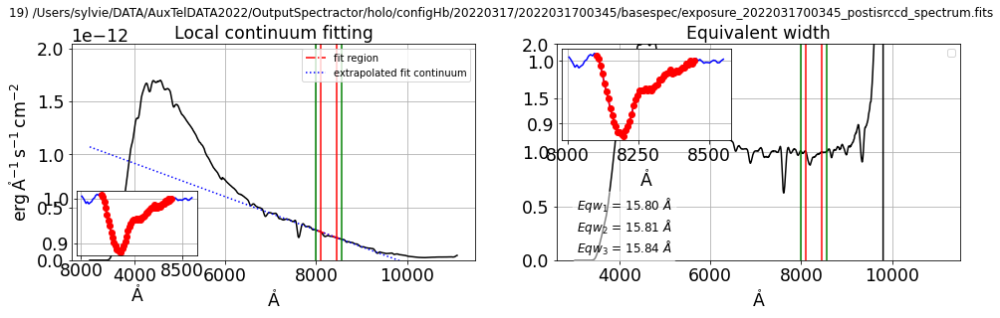

19 ) eqw_h2o_3= 15.836820171384511
set date_obs to 2022-03-18T02:04:16.794
set expo to 20.0
set airmass to 1.33727547076682
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1388486262435704
set dec to -32.3064444444444
set hour_angle to 49.15879882143194
set temperature to 8.5
set pressure to 743.45
set humidity to 58.0
set lambda_ref to 628.5424256920012
set parallactic_angle to 100.7251843777299
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_243 PM_ERR_MINA_243 PM_ERR_ANGLE_243 Z_VALUE_243 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:22:33  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


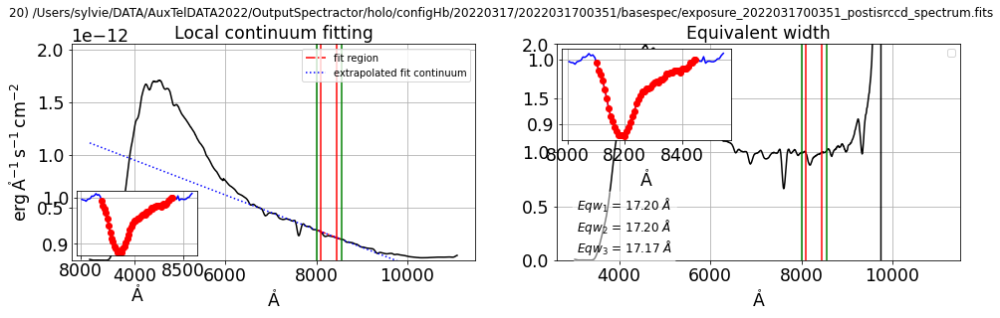

20 ) eqw_h2o_3= 17.17440527702243
set date_obs to 2022-03-18T02:04:49.712
set expo to 20.0
set airmass to 1.33963651479802
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1368681187146323
set dec to -32.3064444444444
set hour_angle to 49.29580448438519
set temperature to 8.5
set pressure to 743.35
set humidity to 58.0
set lambda_ref to 628.2086674961155
set parallactic_angle to 100.7742095756281
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_244 PM_ERR_MINA_244 PM_ERR_ANGLE_244 Z_VALUE_244 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:22:41  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


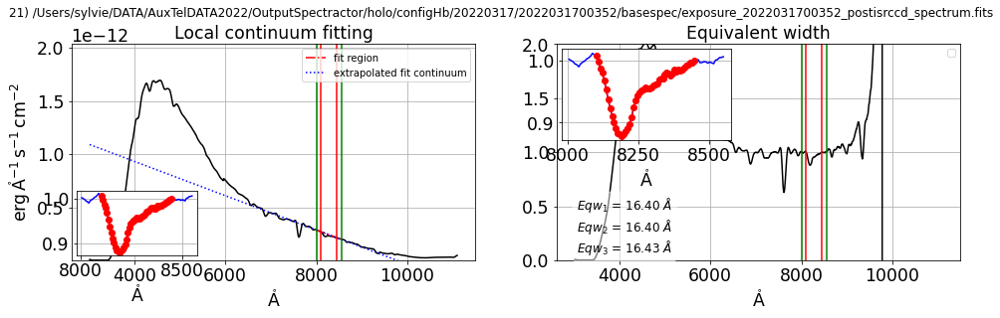

21 ) eqw_h2o_3= 16.42933519605848
set date_obs to 2022-03-18T02:07:49.074
set expo to 20.0
set airmass to 1.352787300037425
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1331931685876357
set dec to -32.3064444444444
set hour_angle to 50.04587365708529
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 627.9591693143808
set parallactic_angle to 101.0424069948098
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_245 PM_ERR_MINA_245 PM_ERR_ANGLE_245 Z_VALUE_245 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:22:49  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


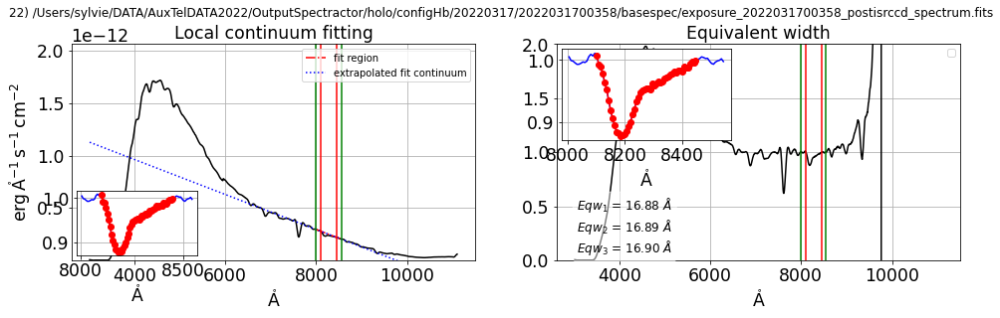

22 ) eqw_h2o_3= 16.901623586620712
set date_obs to 2022-03-18T02:11:20.051
set expo to 20.0
set airmass to 1.368765631503195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1336440841342464
set dec to -32.3064444444444
set hour_angle to 50.92719907664954
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 622.7051672626101
set parallactic_angle to 101.357174452077
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_246 PM_ERR_MINA_246 PM_ERR_ANGLE_246 Z_VALUE_246 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:22:58  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


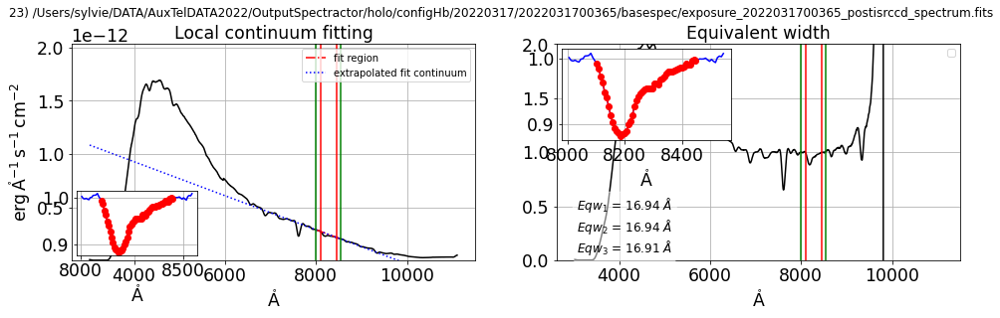

23 ) eqw_h2o_3= 16.9073377601078
set date_obs to 2022-03-18T02:11:53.006
set expo to 20.0
set airmass to 1.371319339871885
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1369079175197151
set dec to -32.3064444444444
set hour_angle to 51.06504024257939
set temperature to 8.4
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 629.1845159477502
set parallactic_angle to 101.4063764649771
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_247 PM_ERR_MINA_247 PM_ERR_ANGLE_247 Z_VALUE_247 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:23:05  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


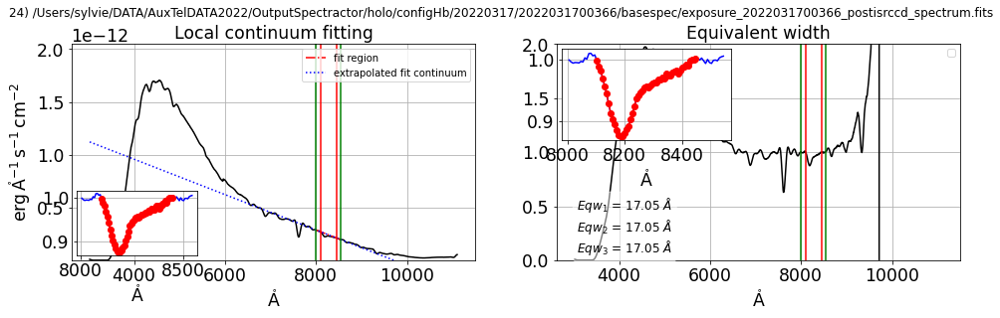

24 ) eqw_h2o_3= 17.04856705865672
set date_obs to 2022-03-18T02:14:46.798
set expo to 20.0
set airmass to 1.38501167017706
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1310814762516916
set dec to -32.3064444444444
set hour_angle to 51.79156958975715
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.5245232921197
set parallactic_angle to 101.6656129875546
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_248 PM_ERR_MINA_248 PM_ERR_ANGLE_248 Z_VALUE_248 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:23:14  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


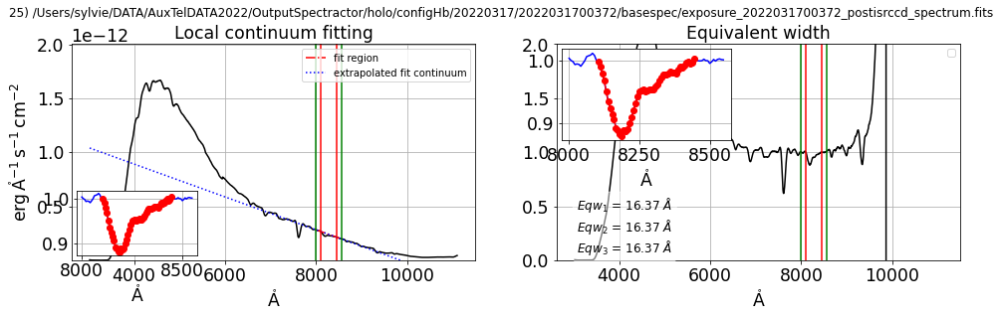

25 ) eqw_h2o_3= 16.369849149004047
set date_obs to 2022-03-18T02:15:19.743
set expo to 20.0
set airmass to 1.387649936190795
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1317245037126307
set dec to -32.3064444444444
set hour_angle to 51.92878009828319
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.9968889639981
set parallactic_angle to 101.7145568247823
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_249 PM_ERR_MINA_249 PM_ERR_ANGLE_249 Z_VALUE_249 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:23:23  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


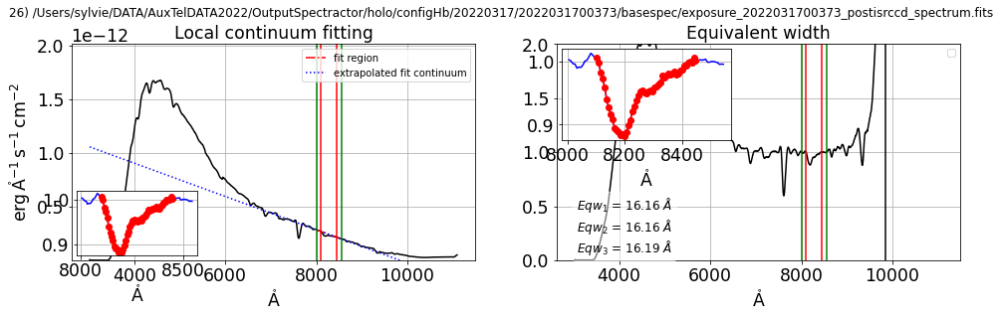

26 ) eqw_h2o_3= 16.188249749533284
set date_obs to 2022-03-18T02:33:33.012
set expo to 20.0
set airmass to 1.48452422171666
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1197628273916148
set dec to -32.3064444444444
set hour_angle to 56.49902324990354
set temperature to 8.0
set pressure to 743.35
set humidity to 63.0
set lambda_ref to 628.5888123380201
set parallactic_angle to 103.3450343494105
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_250 PM_ERR_MINA_250 PM_ERR_ANGLE_250 Z_VALUE_250 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:23:31  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


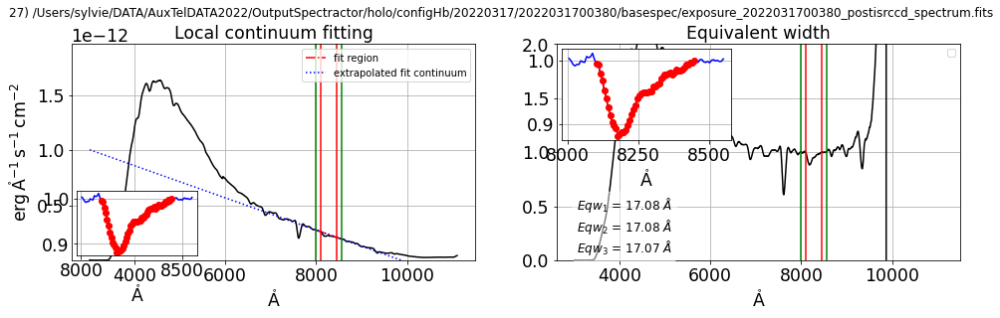

27 ) eqw_h2o_3= 17.067814277422812
set date_obs to 2022-03-18T02:36:30.874
set expo to 20.0
set airmass to 1.50213593383469
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1172584274998106
set dec to -32.3064444444444
set hour_angle to 57.24247377715349
set temperature to 8.1
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 633.8101508297243
set parallactic_angle to 103.6108187575918
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_251 PM_ERR_MINA_251 PM_ERR_ANGLE_251 Z_VALUE_251 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:23:40  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


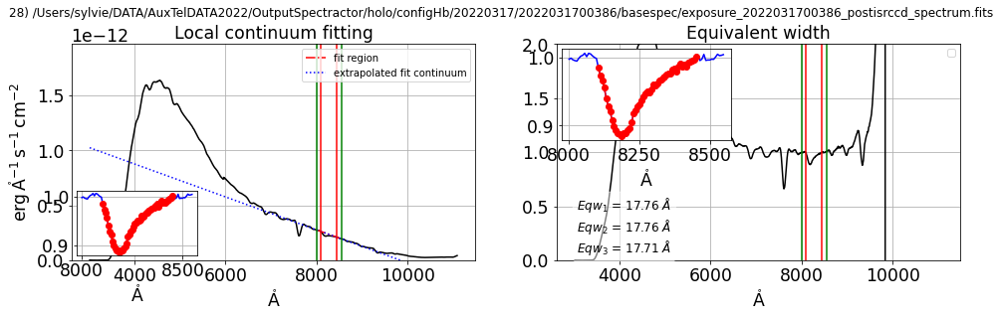

28 ) eqw_h2o_3= 17.711836428633163
set date_obs to 2022-03-18T02:37:03.815
set expo to 20.0
set airmass to 1.50545657928364
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1211335036558286
set dec to -32.3064444444444
set hour_angle to 57.37947904087095
set temperature to 8.1
set pressure to 743.35
set humidity to 64.0
set lambda_ref to 628.2172036981787
set parallactic_angle to 103.6598297048832
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_252 PM_ERR_MINA_252 PM_ERR_ANGLE_252 Z_VALUE_252 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:23:49  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


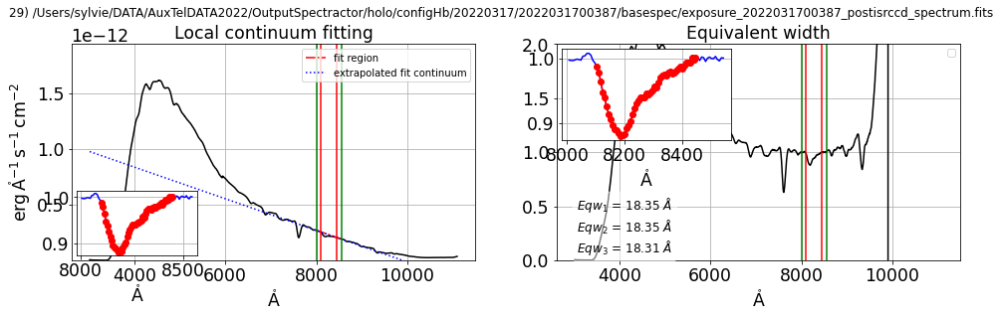

29 ) eqw_h2o_3= 18.311212709289983
set date_obs to 2022-03-18T02:40:00.839
set expo to 20.0
set airmass to 1.523657512515415
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1177429780701742
set dec to -32.3064444444444
set hour_angle to 58.11949120092164
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.3577400172557
set parallactic_angle to 103.9247454603291
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_253 PM_ERR_MINA_253 PM_ERR_ANGLE_253 Z_VALUE_253 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:23:57  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


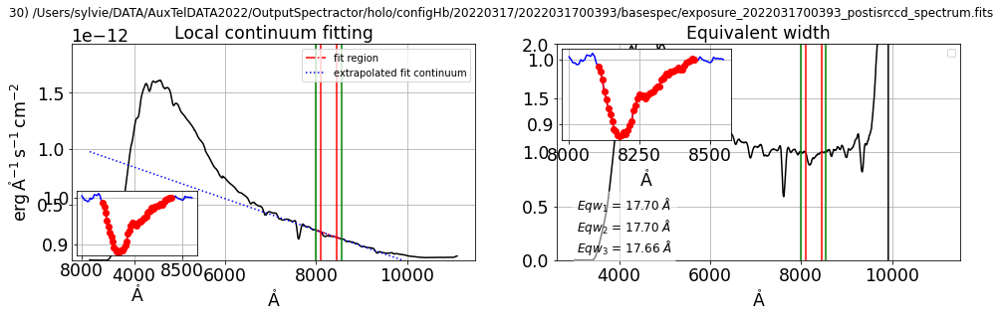

30 ) eqw_h2o_3= 17.657941938887138
set date_obs to 2022-03-18T02:40:33.787
set expo to 20.0
set airmass to 1.527114954027915
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1169167488860146
set dec to -32.3064444444444
set hour_angle to 58.25733391386269
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.7847433714671
set parallactic_angle to 103.9741296646409
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_254 PM_ERR_MINA_254 PM_ERR_ANGLE_254 Z_VALUE_254 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:24:06  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


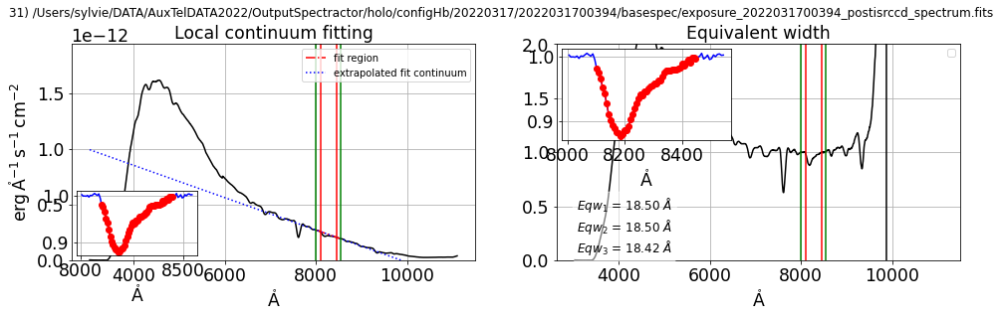

31 ) eqw_h2o_3= 18.418024623353265
set date_obs to 2022-03-18T02:44:05.105
set expo to 20.0
set airmass to 1.54976447202586
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1144055844584487
set dec to -32.3064444444444
set hour_angle to 59.14046723526914
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 629.2826348266267
set parallactic_angle to 104.2908413745483
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_255 PM_ERR_MINA_255 PM_ERR_ANGLE_255 Z_VALUE_255 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:24:14  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


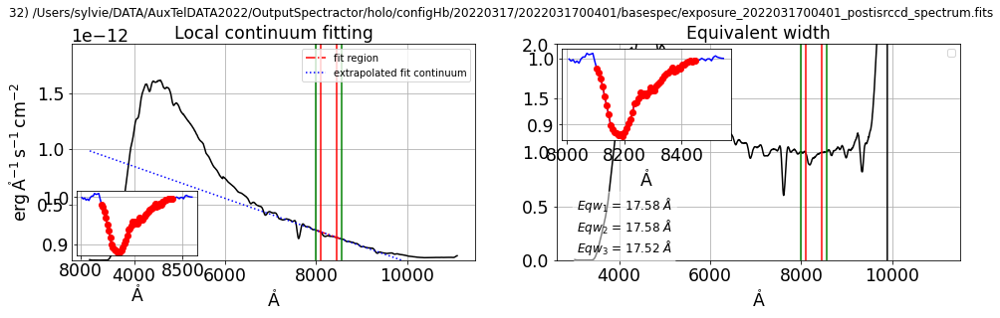

32 ) eqw_h2o_3= 17.519638664216462
set date_obs to 2022-03-18T02:47:02.835
set expo to 20.0
set airmass to 1.56951976624838
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.113192412444726
set dec to -32.3064444444444
set hour_angle to 59.88301895711849
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 623.392411114623
set parallactic_angle to 104.5576025273592
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_256 PM_ERR_MINA_256 PM_ERR_ANGLE_256 Z_VALUE_256 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:24:23  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


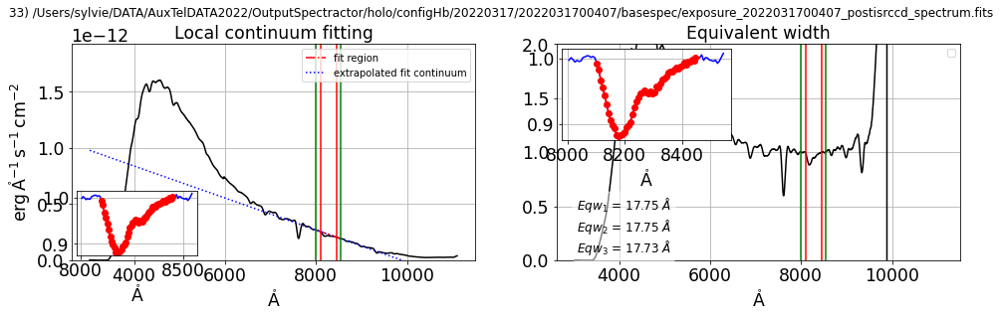

33 ) eqw_h2o_3= 17.733507083176484
set date_obs to 2022-03-18T02:47:35.769
set expo to 20.0
set airmass to 1.573248011911855
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1127873058479127
set dec to -32.3064444444444
set hour_angle to 60.02106934614464
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 624.3168639615992
set parallactic_angle to 104.6072480488688
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_257 PM_ERR_MINA_257 PM_ERR_ANGLE_257 Z_VALUE_257 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:24:32  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


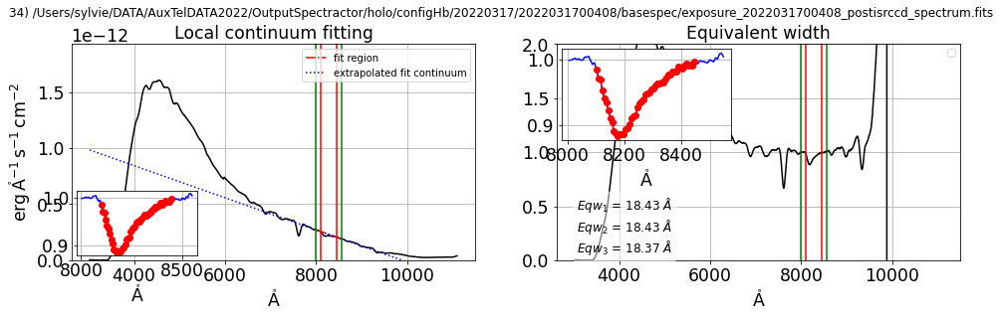

34 ) eqw_h2o_3= 18.371298991555093
set date_obs to 2022-03-18T02:50:38.306
set expo to 20.0
set airmass to 1.594345273370295
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1038057563272595
set dec to -32.3064444444444
set hour_angle to 60.78322641711044
set temperature to 8.0
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 625.6140852852044
set parallactic_angle to 104.8816435668321
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_258 PM_ERR_MINA_258 PM_ERR_ANGLE_258 Z_VALUE_258 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:24:40  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


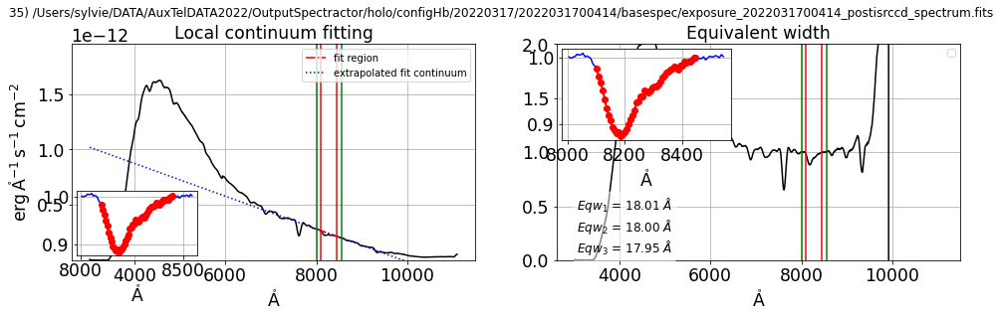

35 ) eqw_h2o_3= 17.947059231485913
set date_obs to 2022-03-18T03:08:41.573
set expo to 20.0
set airmass to 1.73594131895663
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09058150608401207
set dec to -32.3064444444444
set hour_angle to 65.3119392087705
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 631.9889212287092
set parallactic_angle to 106.5252810168807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_259 PM_ERR_MINA_259 PM_ERR_ANGLE_259 Z_VALUE_259 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:24:48  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


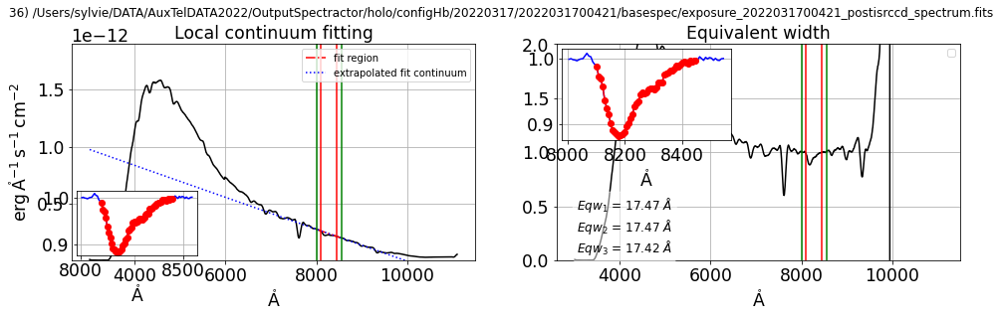

36 ) eqw_h2o_3= 17.41776418737862
set date_obs to 2022-03-18T03:09:14.484
set expo to 20.0
set airmass to 1.740715384660955
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09733707671582016
set dec to -32.3064444444444
set hour_angle to 65.44894264967655
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 625.9596270530473
set parallactic_angle to 106.5754178018598
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_260 PM_ERR_MINA_260 PM_ERR_ANGLE_260 Z_VALUE_260 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:24:58  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


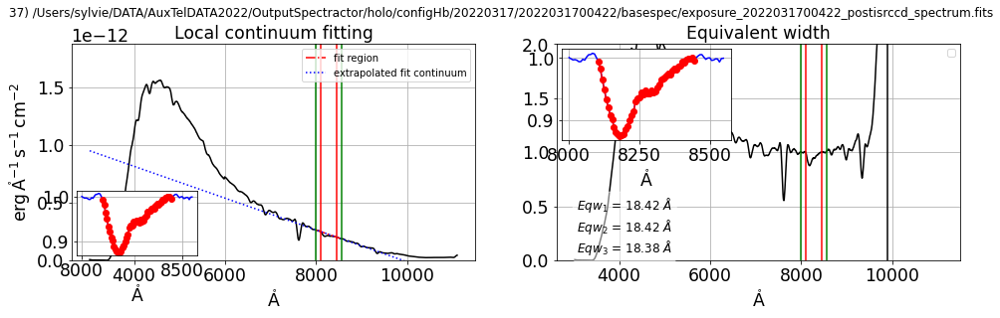

37 ) eqw_h2o_3= 18.382587350032995
set date_obs to 2022-03-18T03:12:54.310
set expo to 20.0
set airmass to 2.129245852899135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.143944791309082
set dec to -87.4721944444444
set hour_angle to -155.5929780702915
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 686.0625390317258
set parallactic_angle to -156.1678055894986
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_261 PM_ERR_MINA_261 PM_ERR_ANGLE_261 Z_VALUE_261 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
HD 185975 20 28 18.7398 -87 28 19.937      14       14 ...           0.017         

2022-04-09 19:25:06  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


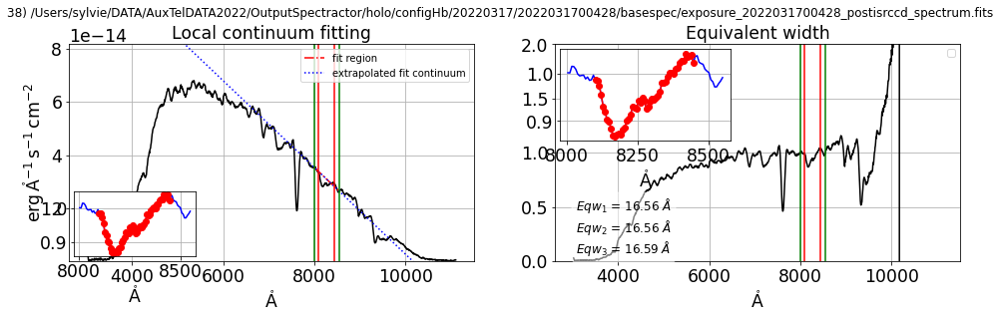

38 ) eqw_h2o_3= 16.591049768672477
set date_obs to 2022-03-18T03:13:27.208
set expo to 20.0
set airmass to 2.1290679262036
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09887590360164929
set dec to -87.4721944444444
set hour_angle to -155.455137691263
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 636.4362643500099
set parallactic_angle to -156.0330469936088
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_262 PM_ERR_MINA_262 PM_ERR_ANGLE_262 Z_VALUE_262 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
HD 185975 20 28 18.7398 -87 28 19.937      14       14 ...           0.017          

2022-04-09 19:25:15  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


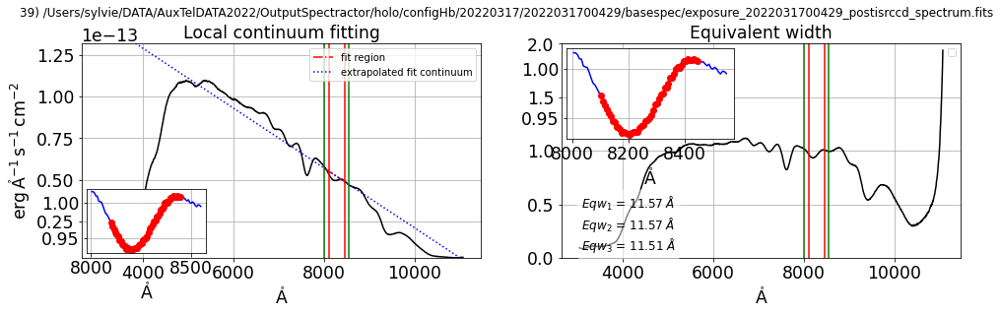

39 ) eqw_h2o_3= 11.50834321932278
set date_obs to 2022-03-18T03:17:06.794
set expo to 20.0
set airmass to 1.81309435755974
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09210139501009447
set dec to -32.3064444444444
set hour_angle to 67.42354300312304
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 626.8738274489511
set parallactic_angle to 107.3011935159837
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_263 PM_ERR_MINA_263 PM_ERR_ANGLE_263 Z_VALUE_263 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:25:24  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


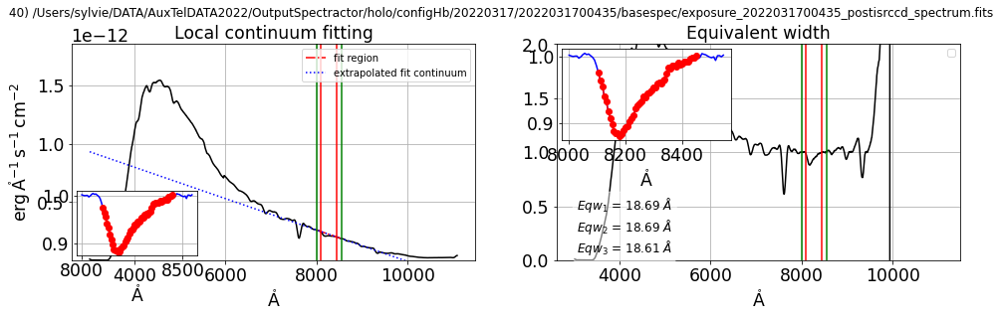

40 ) eqw_h2o_3= 18.614749452835284
set date_obs to 2022-03-18T03:17:39.779
set expo to 20.0
set airmass to 1.818418067455135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.08344429603447075
set dec to -32.3064444444444
set hour_angle to 67.56159248336594
set temperature to 7.7
set pressure to 743.4
set humidity to 63.0
set lambda_ref to 632.4252252976918
set parallactic_angle to 107.3521665962106
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_264 PM_ERR_MINA_264 PM_ERR_ANGLE_264 Z_VALUE_264 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:25:32  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


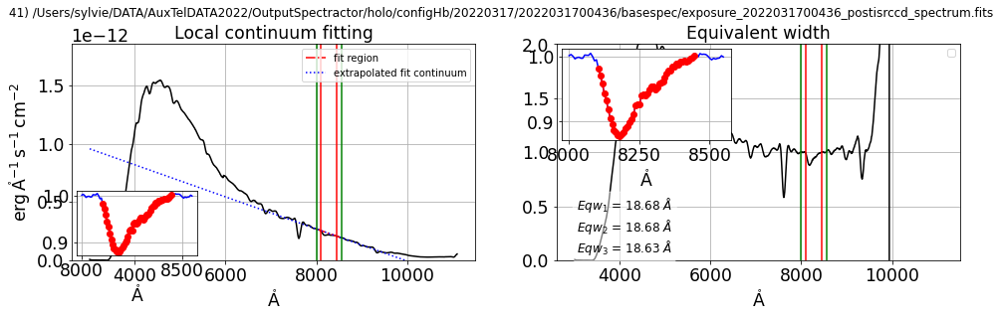

41 ) eqw_h2o_3= 18.627744292060754
set date_obs to 2022-03-18T03:21:26.873
set expo to 20.0
set airmass to 1.856070090955285
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.06347269052355019
set dec to -32.3064444444444
set hour_angle to 68.51099093135984
set temperature to 7.8
set pressure to 743.4
set humidity to 62.0
set lambda_ref to 630.0633085655397
set parallactic_angle to 107.7035936917225
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_265 PM_ERR_MINA_265 PM_ERR_ANGLE_265 Z_VALUE_265 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:25:40  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


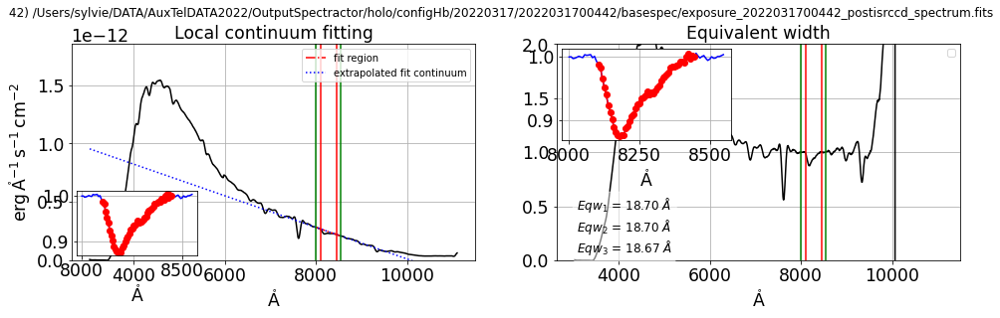

42 ) eqw_h2o_3= 18.666135367023198
set date_obs to 2022-03-18T03:21:59.878
set expo to 20.0
set airmass to 1.861691550345225
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.0769189759908508
set dec to -32.3064444444444
set hour_angle to 68.64883074724754
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 633.3015467495994
set parallactic_angle to 107.7547458765076
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_266 PM_ERR_MINA_266 PM_ERR_ANGLE_266 Z_VALUE_266 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:25:49  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


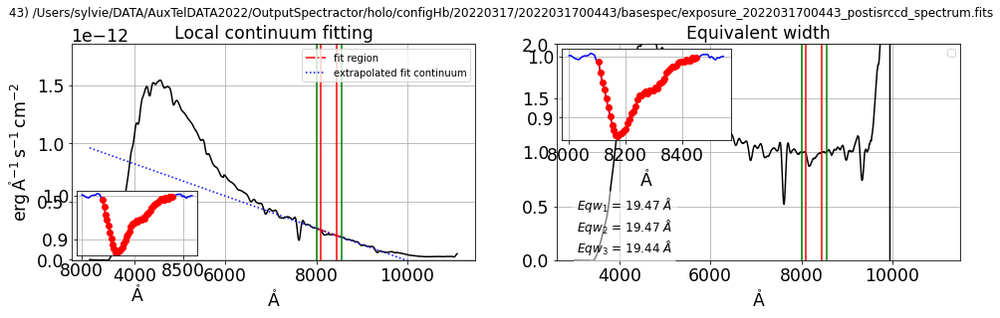

43 ) eqw_h2o_3= 19.43627400278164


In [124]:
WLMIN=300
WLMAX=1000
lambdas = np.arange(WLMIN,WLMAX,1)
fwhm_func = interp1d(lambdas, 0.01 * lambdas)
parameters.DISPLAY=False


for IDXSEL in np.arange(0,NN):
    filename_SEL=all_good_spectra_spectrum_files[IDXSEL]
    filename_spectrogram_SEL=filename_SEL.replace("_spectrum","_spectrogram")
    fullfilename_SEL = os.path.join(dir_spectra,filename_SEL)
    fullfilename_spectrogram_SEL = fullfilename_SEL.replace("_spectrum","_spectrogram")
    
    # load the spectrum
    s=Spectrum(fullfilename_SEL, config=config)
    s.load_spectrogram(fullfilename_spectrogram_SEL) 
    
    
    lamb = 10*s.lambdas * u.AA 
    flux = s.data * u.Unit('erg cm-2 s-1 AA-1')/10 
    spec = Spectrum1D(spectral_axis=lamb, flux=flux) 
    fluxerr = s.err * u.Unit('erg cm-2 s-1 AA-1')/10. 
    specerr = Spectrum1D(spectral_axis=lamb, flux=fluxerr)
    
    # H2O line
    
    #wlmin=10*(H2O_1.wavelength-30)*u.AA
    #wlmax=10*(H2O_2.wavelength+30)*u.AA
    #wlminline=10*(H2O_1.wavelength-12)*u.AA
    #wlmaxline=10*(H2O_2.wavelength+10)*u.AA
    
    wlmin = wlmin_h2o_3
    wlmax = wlmax_h2o_3
    wlminline = wlminline_h2o_3
    wlmaxline = wlmaxline_h2o_3
    
    
    fig=plt.figure(figsize=(16,4))
    ax1 = fig.add_subplot(1, 2, 1)
    ax2 = fig.add_subplot(1, 2, 2)
    #eqw1,eqw2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    eqw1,eqw2,eqw3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    #eqw10,eqw20,eq1_set,eq2_set=ComputeEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=20,flag_plot=True,ax1=ax1,ax2=ax2)
    thetitle=str(IDXSEL)+") "+filename_SEL
    plt.suptitle(thetitle,y=1.01)
    plt.show() 
    
    print(IDXSEL,") eqw_h2o_3=",eqw3)
    
    df_infos.at[IDXSEL,"eqw_h2o_3"] =  eqw3


## LOOP on H_alpha

set date_obs to 2022-03-18T00:51:22.049
set expo to 20.0
set airmass to 1.11557476948966
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1753951396614214
set dec to -32.3064444444444
set hour_angle to 30.8762989508295
set temperature to 8.9
set pressure to 743.45
set humidity to 48.0
set lambda_ref to 626.6801216985461
set parallactic_angle to 93.8012496664173
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_267 PM_ERR_MINA_267 PM_ERR_ANGLE_267 Z_VALUE_267 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110               90   0.0003640     

2022-04-09 19:25:59  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


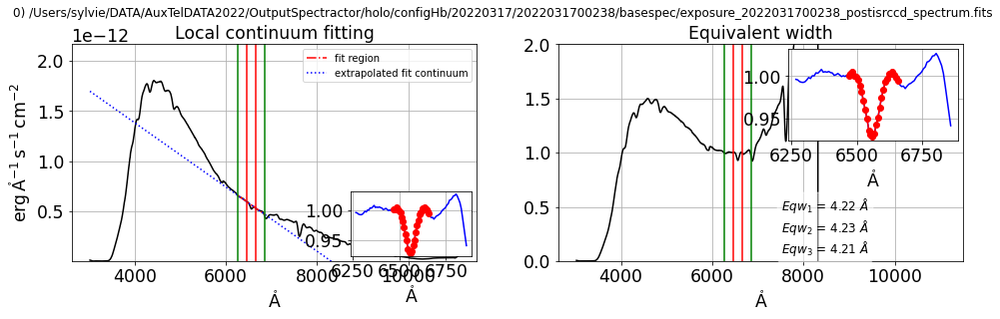

0 ) eqw_halpha= 4.209068007390113
set date_obs to 2022-03-18T00:54:16.312
set expo to 20.0
set airmass to 1.121576965054115
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1741806116248446
set dec to -32.3064444444444
set hour_angle to 31.60492174100415
set temperature to 8.9
set pressure to 743.45
set humidity to 49.0
set lambda_ref to 626.883564656571
set parallactic_angle to 94.10618686949074
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_268 PM_ERR_MINA_268 PM_ERR_ANGLE_268 Z_VALUE_268 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:26:07  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


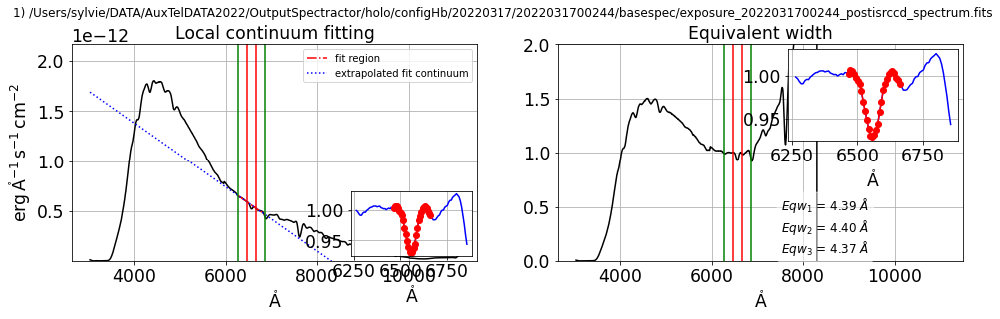

1 ) eqw_halpha= 4.366677745078703
set date_obs to 2022-03-18T00:54:49.235
set expo to 20.0
set airmass to 1.12272698054768
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1736210434249555
set dec to -32.3064444444444
set hour_angle to 31.7419273199217
set temperature to 8.8
set pressure to 743.4
set humidity to 49.0
set lambda_ref to 626.0378655266279
set parallactic_angle to 94.16305953909519
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_269 PM_ERR_MINA_269 PM_ERR_ANGLE_269 Z_VALUE_269 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:26:17  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


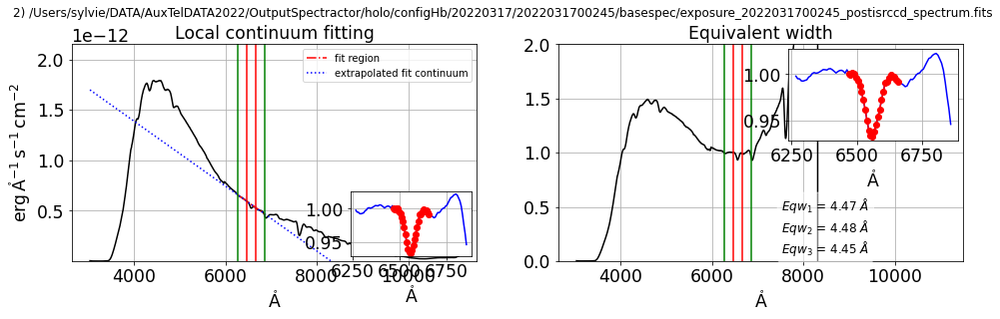

2 ) eqw_halpha= 4.448080174135088
set date_obs to 2022-03-18T00:57:47.565
set expo to 20.0
set airmass to 1.12910731186445
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1713060449152569
set dec to -32.3064444444444
set hour_angle to 32.4876824869983
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.4911208542796
set parallactic_angle to 94.47019502924495
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_270 PM_ERR_MINA_270 PM_ERR_ANGLE_270 Z_VALUE_270 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:26:26  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


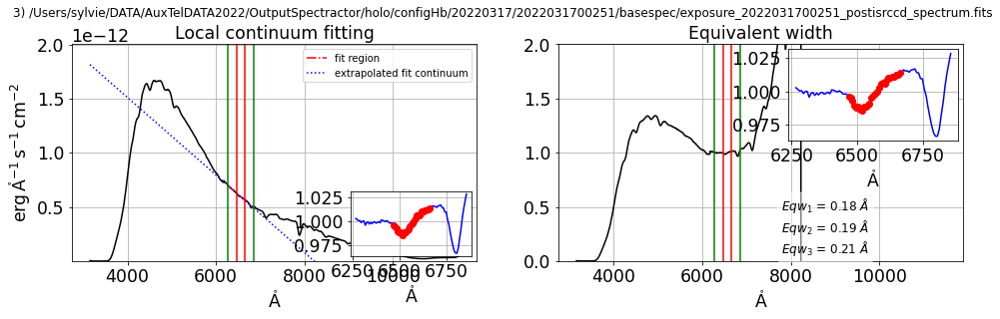

3 ) eqw_halpha= 0.21325021772978908
set date_obs to 2022-03-18T00:58:20.709
set expo to 20.0
set airmass to 1.130309156823195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.169943439836599
set dec to -32.3064444444444
set hour_angle to 32.6255240863161
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.2751365569749
set parallactic_angle to 94.52653019757676
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_271 PM_ERR_MINA_271 PM_ERR_ANGLE_271 Z_VALUE_271 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:26:35  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


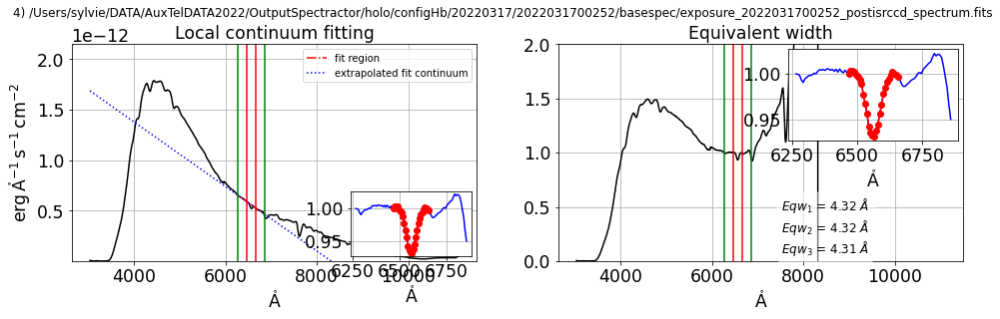

4 ) eqw_halpha= 4.307804221553079
set date_obs to 2022-03-18T01:04:49.716
set expo to 20.0
set airmass to 1.14502998698828
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1680537967029804
set dec to -32.3064444444444
set hour_angle to 34.25103021292454
set temperature to 8.9
set pressure to 743.3
set humidity to 53.0
set lambda_ref to 626.5383418087131
set parallactic_angle to 95.18153718788132
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_272 PM_ERR_MINA_272 PM_ERR_ANGLE_272 Z_VALUE_272 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:26:45  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


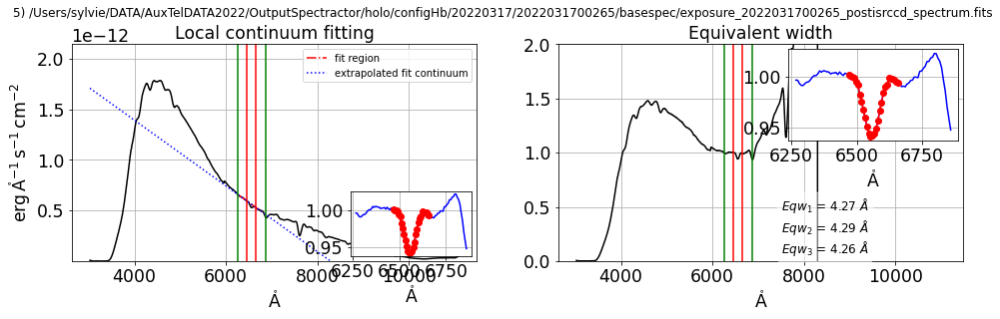

5 ) eqw_halpha= 4.2581305489458305
set date_obs to 2022-03-18T01:08:18.080
set expo to 20.0
set airmass to 1.1533391050821
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.165620392992809
set dec to -32.3064444444444
set hour_angle to 35.12228883044955
set temperature to 8.9
set pressure to 743.3
set humidity to 51.0
set lambda_ref to 626.067912732114
set parallactic_angle to 95.52618006847594
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_273 PM_ERR_MINA_273 PM_ERR_ANGLE_273 Z_VALUE_273 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:26:54  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


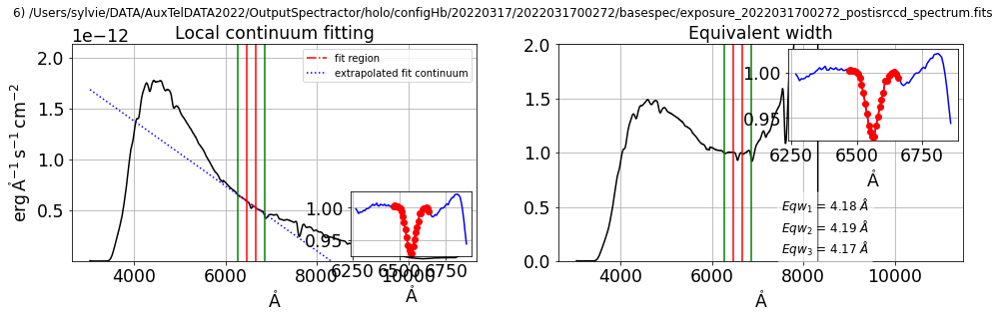

6 ) eqw_halpha= 4.1700623396443515
set date_obs to 2022-03-18T01:08:50.992
set expo to 20.0
set airmass to 1.154683255421995
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1687630065527601
set dec to -32.3064444444444
set hour_angle to 35.26034049072464
set temperature to 8.9
set pressure to 743.35
set humidity to 51.0
set lambda_ref to 626.2488273411835
set parallactic_angle to 95.58041503368928
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_274 PM_ERR_MINA_274 PM_ERR_ANGLE_274 Z_VALUE_274 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:27:04  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


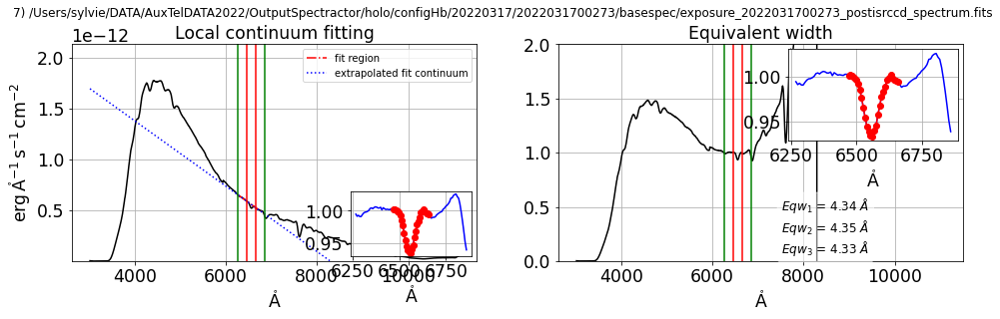

7 ) eqw_halpha= 4.32506042617796
set date_obs to 2022-03-18T01:11:46.031
set expo to 20.0
set airmass to 1.16193866550813
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1650200479066801
set dec to -32.3064444444444
set hour_angle to 35.99118130784399
set temperature to 8.9
set pressure to 743.4
set humidity to 53.0
set lambda_ref to 625.9517855761172
set parallactic_angle to 95.86593376321808
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_275 PM_ERR_MINA_275 PM_ERR_ANGLE_275 Z_VALUE_275 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:27:15  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


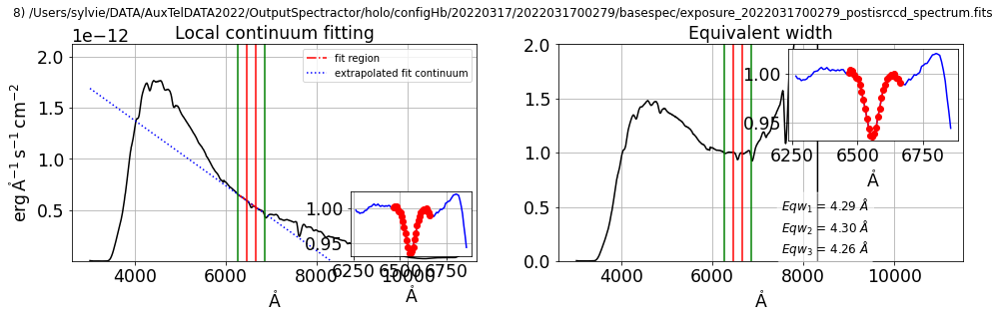

8 ) eqw_halpha= 4.2579884250085644
set date_obs to 2022-03-18T01:15:18.583
set expo to 20.0
set airmass to 1.17105276018288
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1604530597215738
set dec to -32.3064444444444
set hour_angle to 36.87993052247099
set temperature to 8.9
set pressure to 743.45
set humidity to 54.0
set lambda_ref to 626.415954438991
set parallactic_angle to 96.20974235390722
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_276 PM_ERR_MINA_276 PM_ERR_ANGLE_276 Z_VALUE_276 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:27:25  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


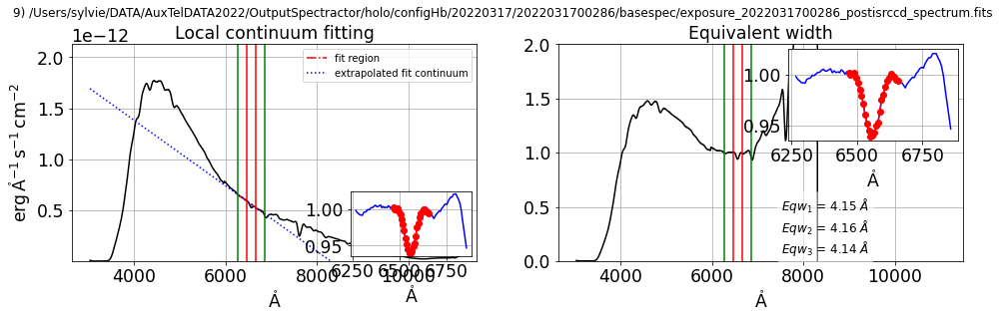

9 ) eqw_halpha= 4.141824859317119
set date_obs to 2022-03-18T01:18:45.526
set expo to 20.0
set airmass to 1.18024864471996
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.161506254140246
set dec to -32.3064444444444
set hour_angle to 37.74449227926539
set temperature to 9.0
set pressure to 743.45
set humidity to 53.0
set lambda_ref to 626.2661772674467
set parallactic_angle to 96.54092631927332
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_277 PM_ERR_MINA_277 PM_ERR_ANGLE_277 Z_VALUE_277 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:27:35  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


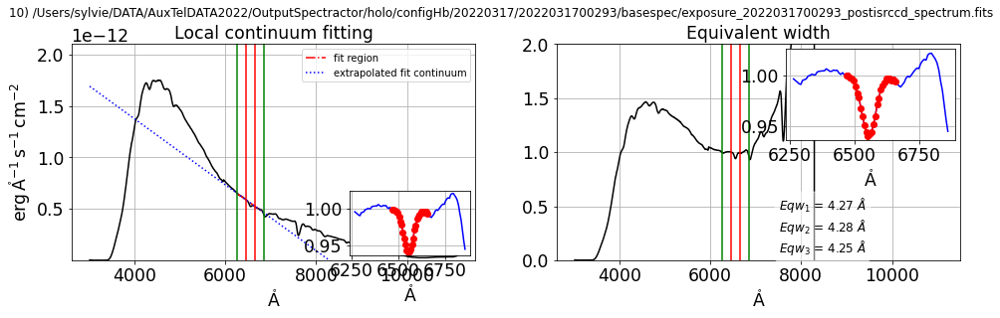

10 ) eqw_halpha= 4.245107464110351
set date_obs to 2022-03-18T01:22:16.238
set expo to 20.0
set airmass to 1.189962402398665
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1600582040885921
set dec to -32.3064444444444
set hour_angle to 38.6257061937975
set temperature to 8.9
set pressure to 743.4
set humidity to 56.0
set lambda_ref to 626.2915574183227
set parallactic_angle to 96.875483029922
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_278 PM_ERR_MINA_278 PM_ERR_ANGLE_278 Z_VALUE_278 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:27:45  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


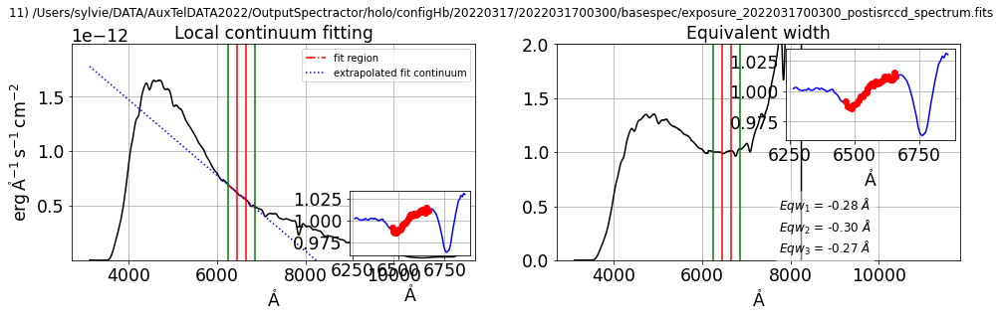

11 ) eqw_halpha= -0.2723465279641166
set date_obs to 2022-03-18T01:22:49.144
set expo to 20.0
set airmass to 1.191505368069865
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1585750124351514
set dec to -32.3064444444444
set hour_angle to 38.76271209839639
set temperature to 9.0
set pressure to 743.45
set humidity to 56.0
set lambda_ref to 626.4868452630084
set parallactic_angle to 96.92724413418016
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_279 PM_ERR_MINA_279 PM_ERR_ANGLE_279 Z_VALUE_279 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095          

2022-04-09 19:27:55  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


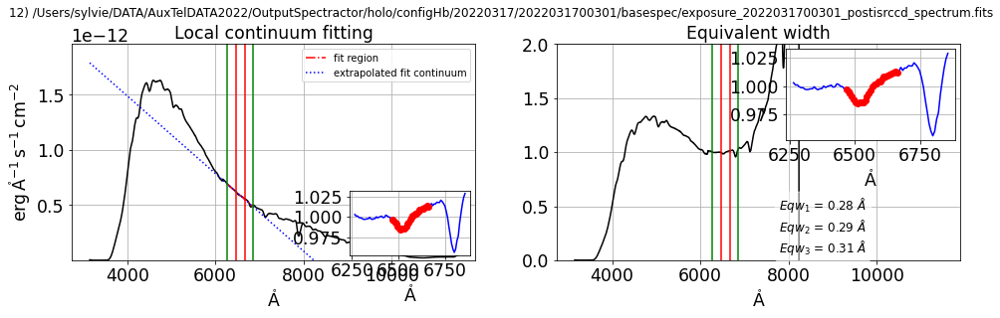

12 ) eqw_halpha= 0.30832307615865095
set date_obs to 2022-03-18T01:43:57.837
set expo to 20.0
set airmass to 1.25822658979951
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476502374643685
set dec to -32.3064444444444
set hour_angle to 44.06414790775874
set temperature to 8.8
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 626.6251269515418
set parallactic_angle to 98.88882683561982
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_280 PM_ERR_MINA_280 PM_ERR_ANGLE_280 Z_VALUE_280 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           

2022-04-09 19:28:04  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


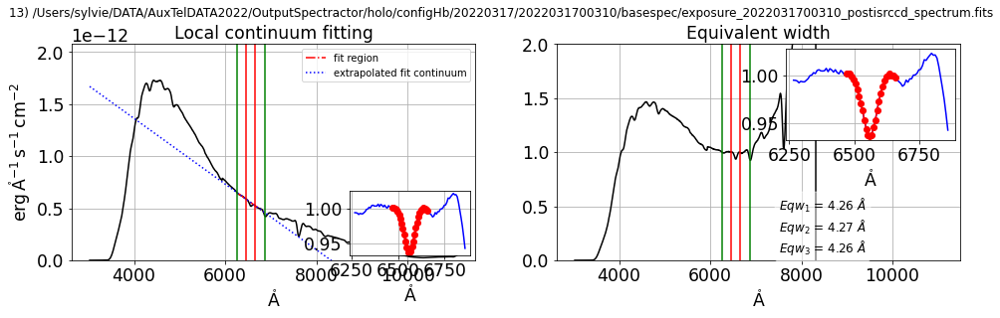

13 ) eqw_halpha= 4.256968442798886
set date_obs to 2022-03-18T01:46:52.361
set expo to 20.0
set airmass to 1.26858445121286
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476350630254128
set dec to -32.3064444444444
set hour_angle to 44.79438636254909
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 627.6256863262817
set parallactic_angle to 99.15414320783184
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_281 PM_ERR_MINA_281 PM_ERR_ANGLE_281 Z_VALUE_281 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:28:14  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


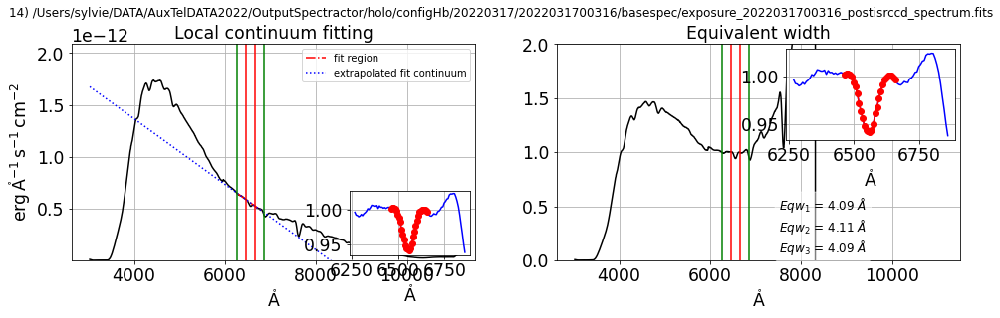

14 ) eqw_halpha= 4.090345953342442
set date_obs to 2022-03-18T01:47:25.256
set expo to 20.0
set airmass to 1.27056341471374
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1466645118411156
set dec to -32.3064444444444
set hour_angle to 44.9315970155517
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 625.7408027741238
set parallactic_angle to 99.2038979478238
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_282 PM_ERR_MINA_282 PM_ERR_ANGLE_282 Z_VALUE_282 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:28:24  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


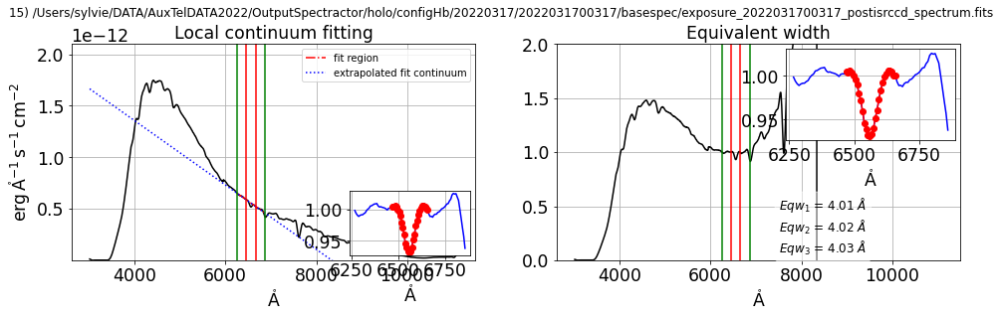

15 ) eqw_halpha= 4.0295880858344
set date_obs to 2022-03-18T01:53:46.736
set expo to 20.0
set airmass to 1.294394244363805
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1444547716136137
set dec to -32.3064444444444
set hour_angle to 46.52581667330039
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.9120383005036
set parallactic_angle to 99.77999069166285
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_283 PM_ERR_MINA_283 PM_ERR_ANGLE_283 Z_VALUE_283 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:28:34  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


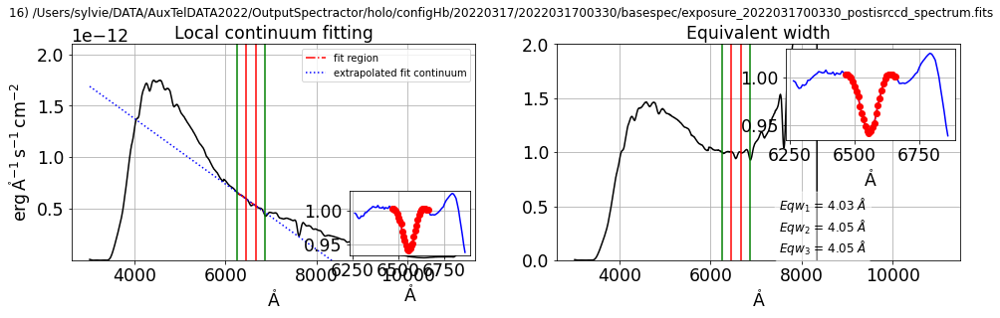

16 ) eqw_halpha= 4.047032111287619
set date_obs to 2022-03-18T01:54:19.724
set expo to 20.0
set airmass to 1.29652271576687
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1441648974084375
set dec to -32.3064444444444
set hour_angle to 46.6628171725209
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.7462807078947
set parallactic_angle to 99.82934304254884
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_284 PM_ERR_MINA_284 PM_ERR_ANGLE_284 Z_VALUE_284 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:28:43  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


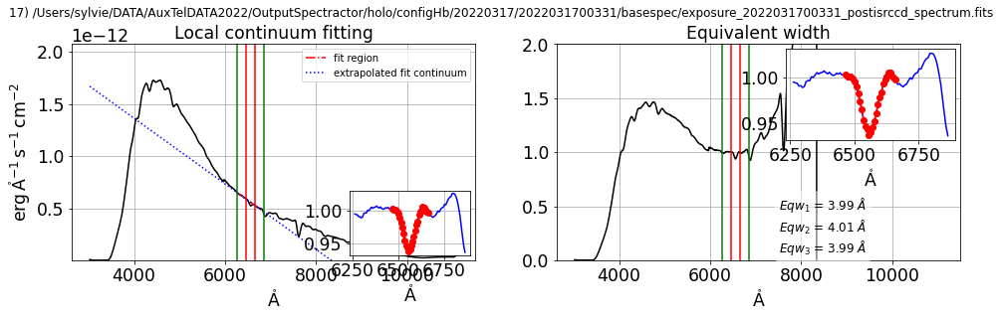

17 ) eqw_halpha= 3.9945484487642178
set date_obs to 2022-03-18T01:57:49.306
set expo to 20.0
set airmass to 1.31035777011874
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1437462230173573
set dec to -32.3064444444444
set hour_angle to 47.53898537176394
set temperature to 8.7
set pressure to 743.45
set humidity to 57.0
set lambda_ref to 628.9551099539515
set parallactic_angle to 100.14447493807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_285 PM_ERR_MINA_285 PM_ERR_ANGLE_285 Z_VALUE_285 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:28:53  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


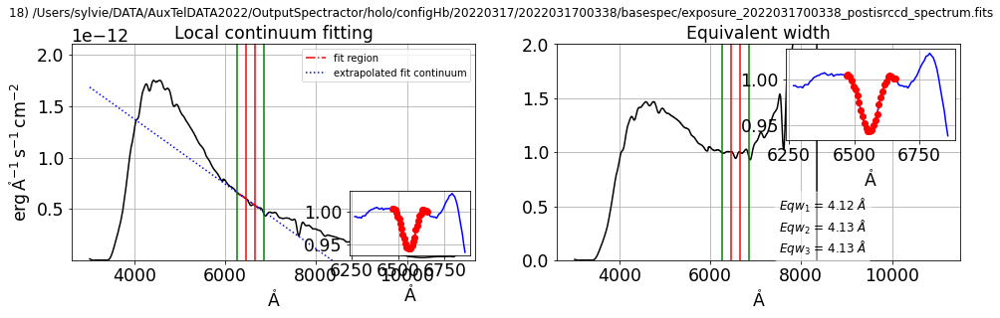

18 ) eqw_halpha= 4.1342581365307
set date_obs to 2022-03-18T02:01:19.196
set expo to 20.0
set airmass to 1.324716687989025
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1392710710370809
set dec to -32.3064444444444
set hour_angle to 48.4163008821963
set temperature to 8.6
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 626.8625000130343
set parallactic_angle to 100.4592627484374
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_286 PM_ERR_MINA_286 PM_ERR_ANGLE_286 Z_VALUE_286 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:29:03  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


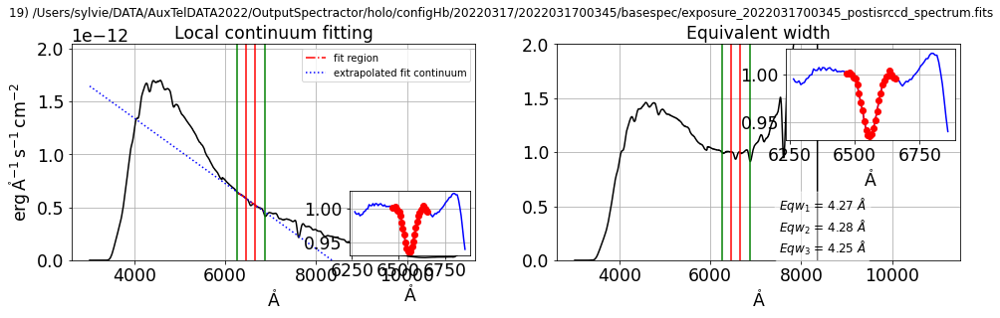

19 ) eqw_halpha= 4.254579331347269
set date_obs to 2022-03-18T02:04:16.794
set expo to 20.0
set airmass to 1.33727547076682
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1388486262435704
set dec to -32.3064444444444
set hour_angle to 49.15879882143194
set temperature to 8.5
set pressure to 743.45
set humidity to 58.0
set lambda_ref to 628.5424256920012
set parallactic_angle to 100.7251843777299
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_287 PM_ERR_MINA_287 PM_ERR_ANGLE_287 Z_VALUE_287 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:29:13  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


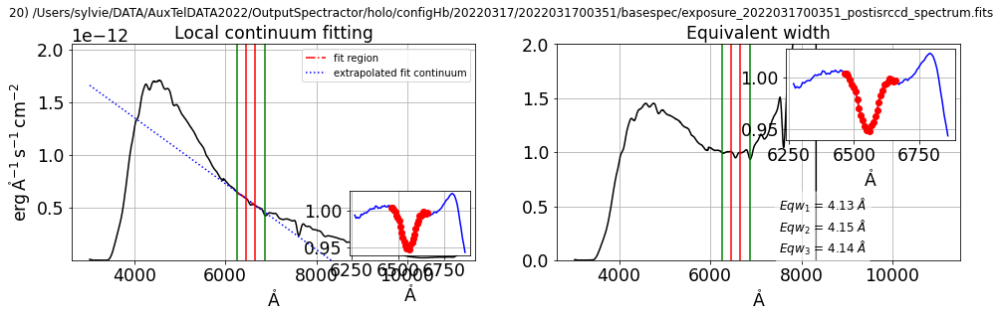

20 ) eqw_halpha= 4.1356524151347225
set date_obs to 2022-03-18T02:04:49.712
set expo to 20.0
set airmass to 1.33963651479802
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1368681187146323
set dec to -32.3064444444444
set hour_angle to 49.29580448438519
set temperature to 8.5
set pressure to 743.35
set humidity to 58.0
set lambda_ref to 628.2086674961155
set parallactic_angle to 100.7742095756281
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_288 PM_ERR_MINA_288 PM_ERR_ANGLE_288 Z_VALUE_288 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:29:23  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


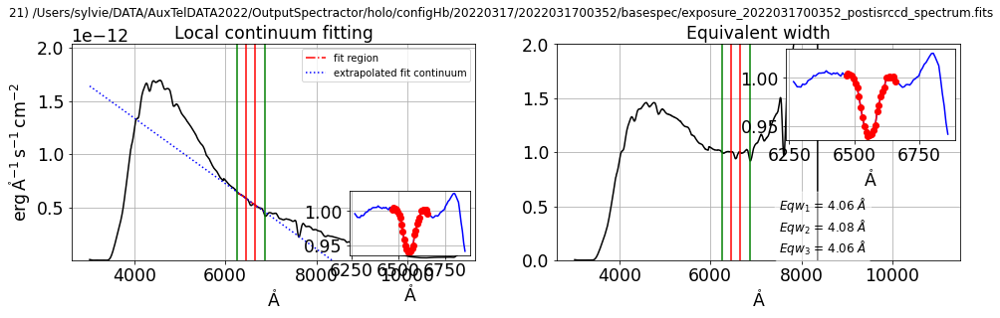

21 ) eqw_halpha= 4.061292019687056
set date_obs to 2022-03-18T02:07:49.074
set expo to 20.0
set airmass to 1.352787300037425
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1331931685876357
set dec to -32.3064444444444
set hour_angle to 50.04587365708529
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 627.9591693143808
set parallactic_angle to 101.0424069948098
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_289 PM_ERR_MINA_289 PM_ERR_ANGLE_289 Z_VALUE_289 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:29:35  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


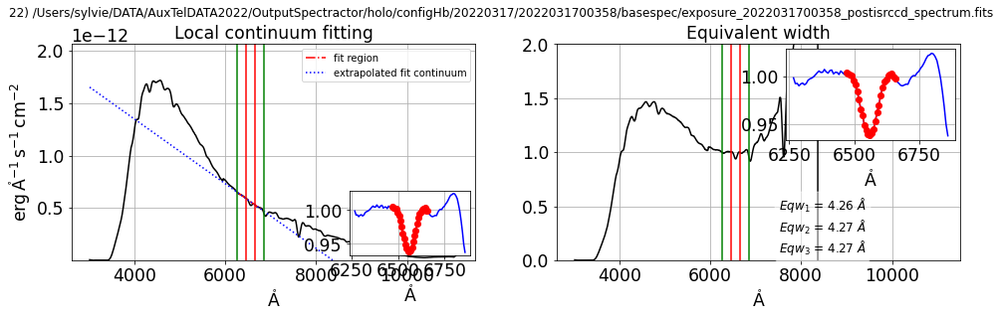

22 ) eqw_halpha= 4.269065208132018
set date_obs to 2022-03-18T02:11:20.051
set expo to 20.0
set airmass to 1.368765631503195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1336440841342464
set dec to -32.3064444444444
set hour_angle to 50.92719907664954
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 622.7051672626101
set parallactic_angle to 101.357174452077
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_290 PM_ERR_MINA_290 PM_ERR_ANGLE_290 Z_VALUE_290 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:29:45  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


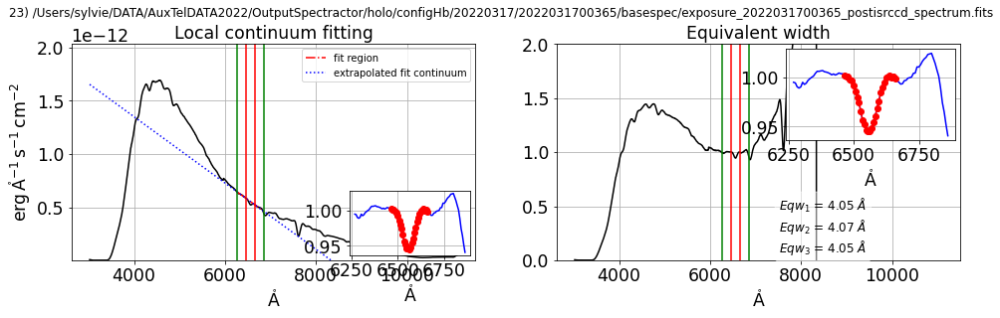

23 ) eqw_halpha= 4.048617807094046
set date_obs to 2022-03-18T02:11:53.006
set expo to 20.0
set airmass to 1.371319339871885
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1369079175197151
set dec to -32.3064444444444
set hour_angle to 51.06504024257939
set temperature to 8.4
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 629.1845159477502
set parallactic_angle to 101.4063764649771
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_291 PM_ERR_MINA_291 PM_ERR_ANGLE_291 Z_VALUE_291 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:29:54  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


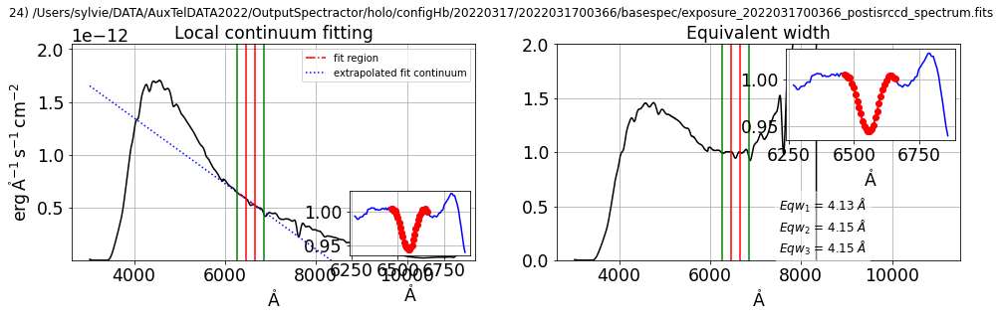

24 ) eqw_halpha= 4.147578918911143
set date_obs to 2022-03-18T02:14:46.798
set expo to 20.0
set airmass to 1.38501167017706
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1310814762516916
set dec to -32.3064444444444
set hour_angle to 51.79156958975715
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.5245232921197
set parallactic_angle to 101.6656129875546
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_292 PM_ERR_MINA_292 PM_ERR_ANGLE_292 Z_VALUE_292 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:30:06  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


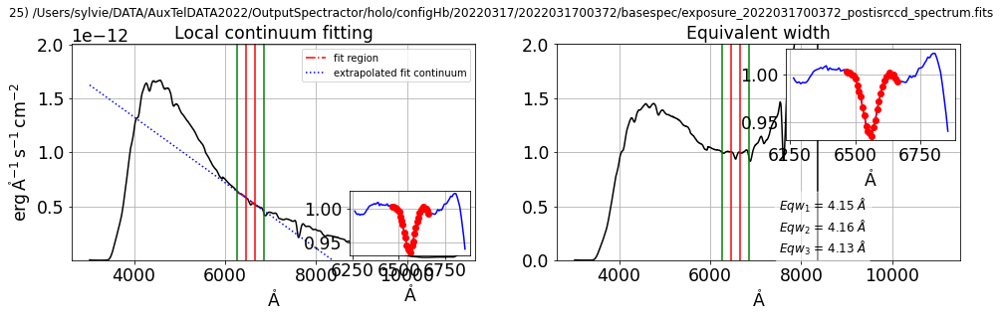

25 ) eqw_halpha= 4.132160526909402
set date_obs to 2022-03-18T02:15:19.743
set expo to 20.0
set airmass to 1.387649936190795
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1317245037126307
set dec to -32.3064444444444
set hour_angle to 51.92878009828319
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.9968889639981
set parallactic_angle to 101.7145568247823
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_293 PM_ERR_MINA_293 PM_ERR_ANGLE_293 Z_VALUE_293 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:30:17  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


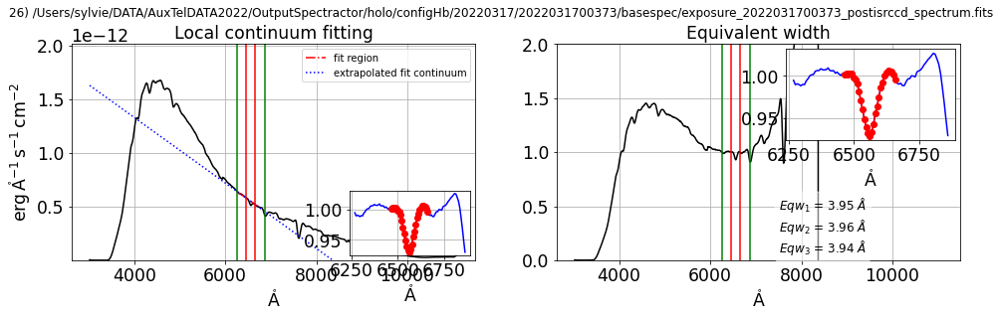

26 ) eqw_halpha= 3.9415137996066223
set date_obs to 2022-03-18T02:33:33.012
set expo to 20.0
set airmass to 1.48452422171666
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1197628273916148
set dec to -32.3064444444444
set hour_angle to 56.49902324990354
set temperature to 8.0
set pressure to 743.35
set humidity to 63.0
set lambda_ref to 628.5888123380201
set parallactic_angle to 103.3450343494105
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_294 PM_ERR_MINA_294 PM_ERR_ANGLE_294 Z_VALUE_294 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:30:28  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


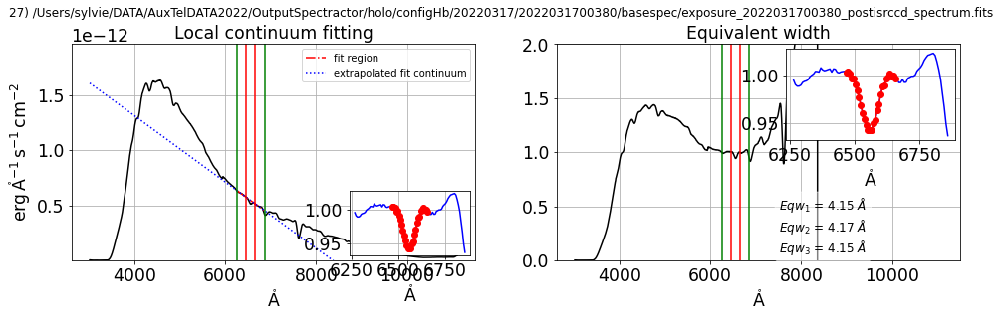

27 ) eqw_halpha= 4.147808698468702
set date_obs to 2022-03-18T02:36:30.874
set expo to 20.0
set airmass to 1.50213593383469
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1172584274998106
set dec to -32.3064444444444
set hour_angle to 57.24247377715349
set temperature to 8.1
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 633.8101508297243
set parallactic_angle to 103.6108187575918
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_295 PM_ERR_MINA_295 PM_ERR_ANGLE_295 Z_VALUE_295 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:30:39  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


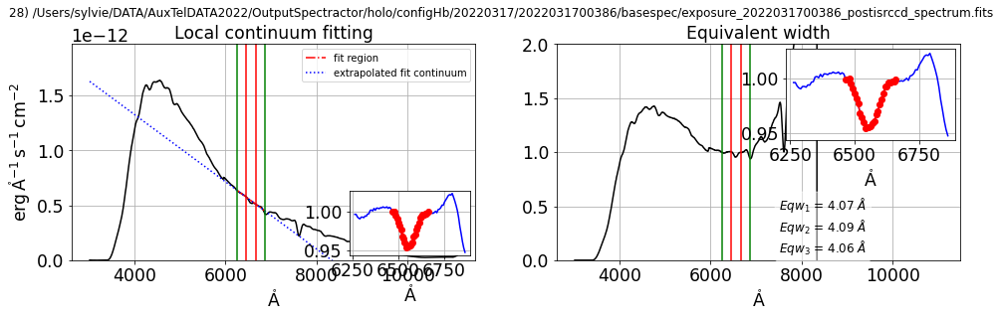

28 ) eqw_halpha= 4.062982566334975
set date_obs to 2022-03-18T02:37:03.815
set expo to 20.0
set airmass to 1.50545657928364
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1211335036558286
set dec to -32.3064444444444
set hour_angle to 57.37947904087095
set temperature to 8.1
set pressure to 743.35
set humidity to 64.0
set lambda_ref to 628.2172036981787
set parallactic_angle to 103.6598297048832
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_296 PM_ERR_MINA_296 PM_ERR_ANGLE_296 Z_VALUE_296 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:30:50  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


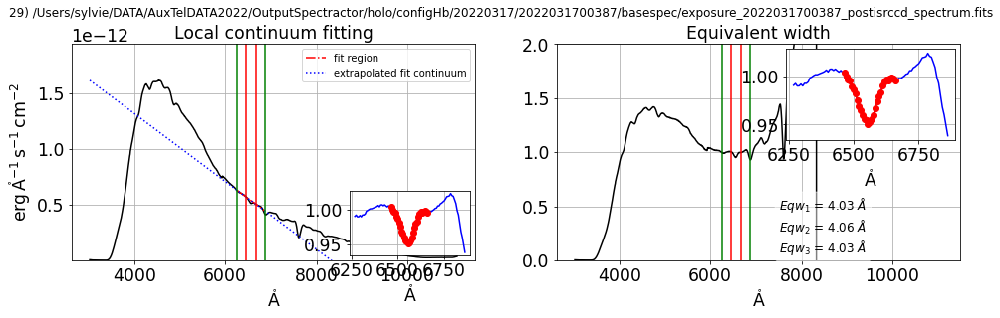

29 ) eqw_halpha= 4.031116491242412
set date_obs to 2022-03-18T02:40:00.839
set expo to 20.0
set airmass to 1.523657512515415
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1177429780701742
set dec to -32.3064444444444
set hour_angle to 58.11949120092164
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.3577400172557
set parallactic_angle to 103.9247454603291
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_297 PM_ERR_MINA_297 PM_ERR_ANGLE_297 Z_VALUE_297 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:31:01  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


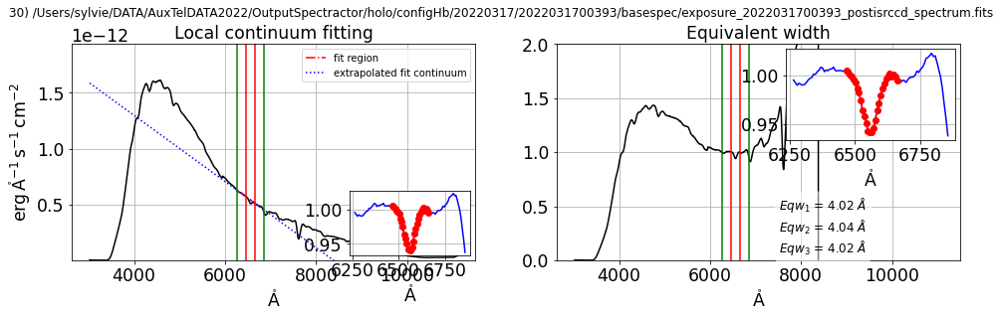

30 ) eqw_halpha= 4.021110504201154
set date_obs to 2022-03-18T02:40:33.787
set expo to 20.0
set airmass to 1.527114954027915
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1169167488860146
set dec to -32.3064444444444
set hour_angle to 58.25733391386269
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.7847433714671
set parallactic_angle to 103.9741296646409
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_298 PM_ERR_MINA_298 PM_ERR_ANGLE_298 Z_VALUE_298 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:31:12  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


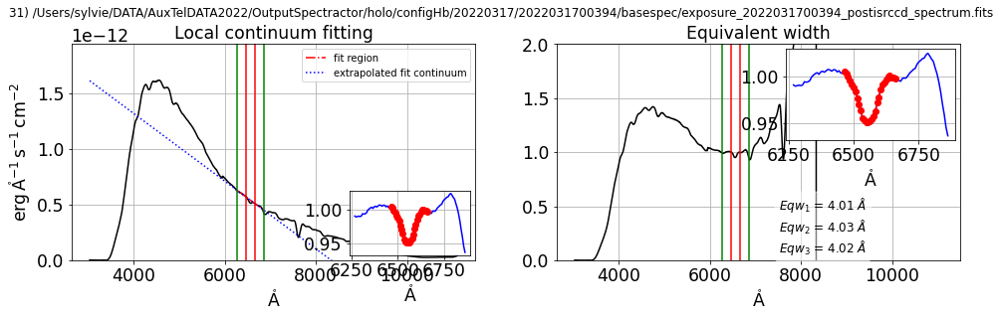

31 ) eqw_halpha= 4.015415381655961
set date_obs to 2022-03-18T02:44:05.105
set expo to 20.0
set airmass to 1.54976447202586
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1144055844584487
set dec to -32.3064444444444
set hour_angle to 59.14046723526914
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 629.2826348266267
set parallactic_angle to 104.2908413745483
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_299 PM_ERR_MINA_299 PM_ERR_ANGLE_299 Z_VALUE_299 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:31:21  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


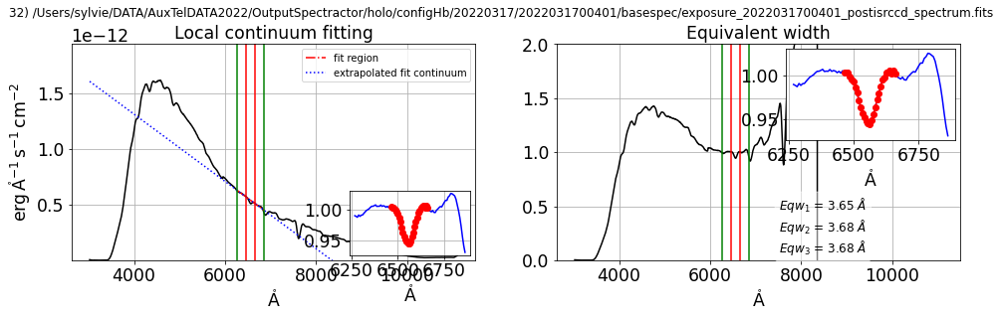

32 ) eqw_halpha= 3.6756447029699406
set date_obs to 2022-03-18T02:47:02.835
set expo to 20.0
set airmass to 1.56951976624838
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.113192412444726
set dec to -32.3064444444444
set hour_angle to 59.88301895711849
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 623.392411114623
set parallactic_angle to 104.5576025273592
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_300 PM_ERR_MINA_300 PM_ERR_ANGLE_300 Z_VALUE_300 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:31:31  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


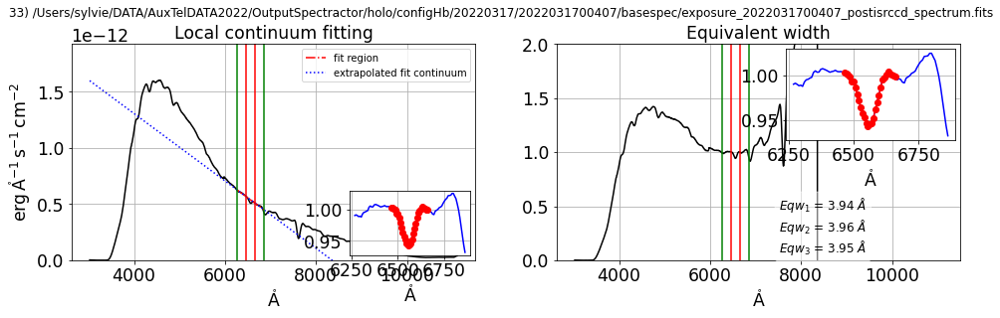

33 ) eqw_halpha= 3.9494724024508616
set date_obs to 2022-03-18T02:47:35.769
set expo to 20.0
set airmass to 1.573248011911855
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1127873058479127
set dec to -32.3064444444444
set hour_angle to 60.02106934614464
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 624.3168639615992
set parallactic_angle to 104.6072480488688
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_301 PM_ERR_MINA_301 PM_ERR_ANGLE_301 Z_VALUE_301 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           

2022-04-09 19:31:41  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


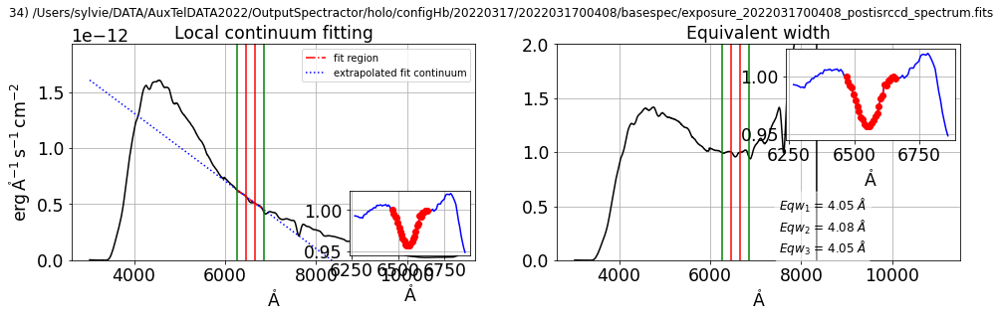

34 ) eqw_halpha= 4.049516282980619
set date_obs to 2022-03-18T02:50:38.306
set expo to 20.0
set airmass to 1.594345273370295
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1038057563272595
set dec to -32.3064444444444
set hour_angle to 60.78322641711044
set temperature to 8.0
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 625.6140852852044
set parallactic_angle to 104.8816435668321
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_302 PM_ERR_MINA_302 PM_ERR_ANGLE_302 Z_VALUE_302 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:31:50  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


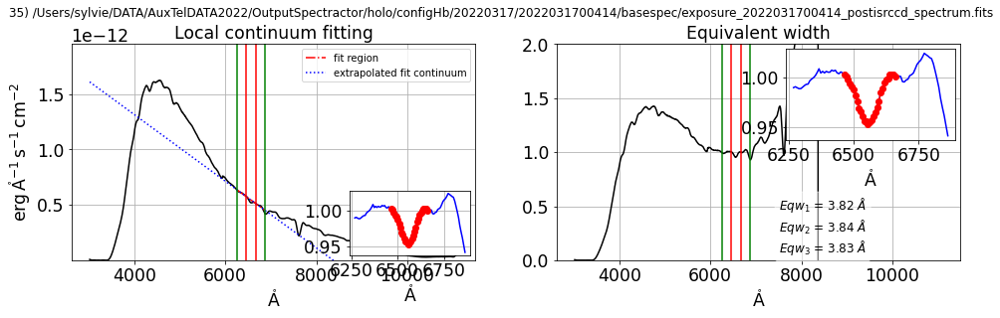

35 ) eqw_halpha= 3.832726180278553
set date_obs to 2022-03-18T03:08:41.573
set expo to 20.0
set airmass to 1.73594131895663
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09058150608401207
set dec to -32.3064444444444
set hour_angle to 65.3119392087705
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 631.9889212287092
set parallactic_angle to 106.5252810168807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_303 PM_ERR_MINA_303 PM_ERR_ANGLE_303 Z_VALUE_303 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:31:59  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


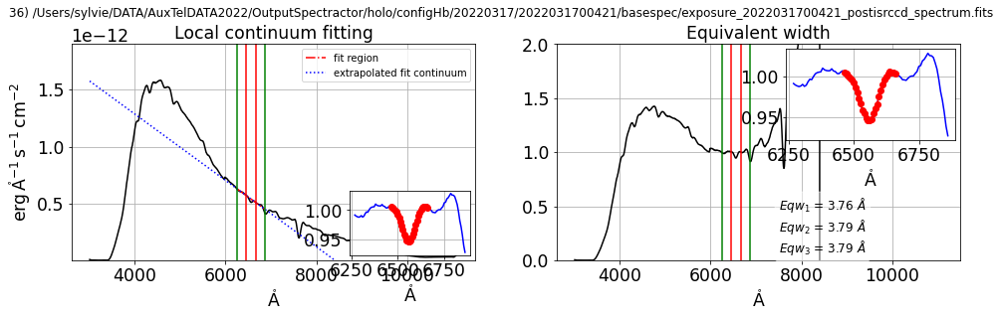

36 ) eqw_halpha= 3.79407955196341
set date_obs to 2022-03-18T03:09:14.484
set expo to 20.0
set airmass to 1.740715384660955
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09733707671582016
set dec to -32.3064444444444
set hour_angle to 65.44894264967655
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 625.9596270530473
set parallactic_angle to 106.5754178018598
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_304 PM_ERR_MINA_304 PM_ERR_ANGLE_304 Z_VALUE_304 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:32:09  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


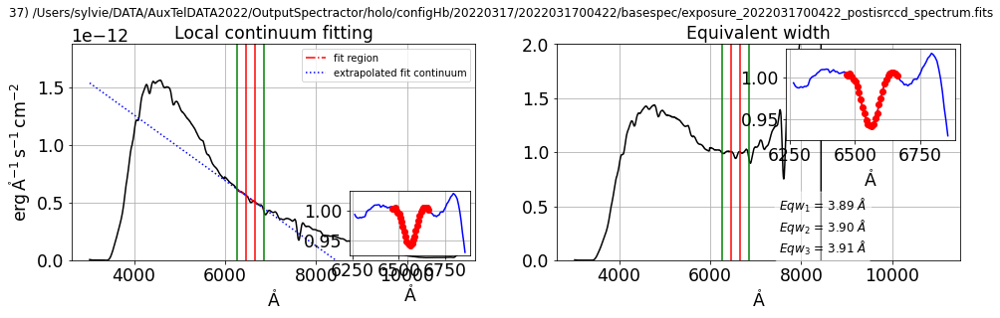

37 ) eqw_halpha= 3.9068550205291133
set date_obs to 2022-03-18T03:12:54.310
set expo to 20.0
set airmass to 2.129245852899135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.143944791309082
set dec to -87.4721944444444
set hour_angle to -155.5929780702915
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 686.0625390317258
set parallactic_angle to -156.1678055894986
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_305 PM_ERR_MINA_305 PM_ERR_ANGLE_305 Z_VALUE_305 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
HD 185975 20 28 18.7398 -87 28 19.937      14       14 ...           0.017        

2022-04-09 19:32:19  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


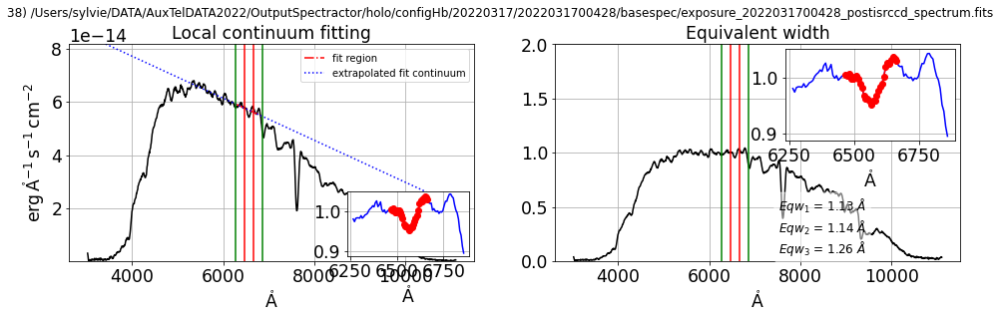

38 ) eqw_halpha= 1.2598661511195983
set date_obs to 2022-03-18T03:13:27.208
set expo to 20.0
set airmass to 2.1290679262036
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09887590360164929
set dec to -87.4721944444444
set hour_angle to -155.455137691263
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 636.4362643500099
set parallactic_angle to -156.0330469936088
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_306 PM_ERR_MINA_306 PM_ERR_ANGLE_306 Z_VALUE_306 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
HD 185975 20 28 18.7398 -87 28 19.937      14       14 ...           0.017         

2022-04-09 19:32:28  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


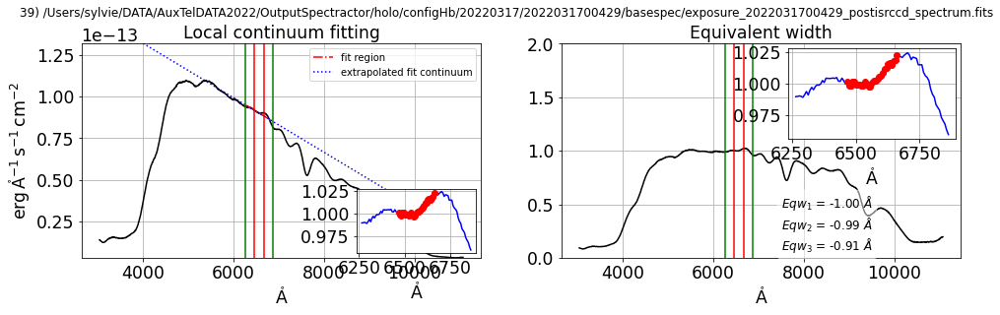

39 ) eqw_halpha= -0.9133746631818211
set date_obs to 2022-03-18T03:17:06.794
set expo to 20.0
set airmass to 1.81309435755974
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09210139501009447
set dec to -32.3064444444444
set hour_angle to 67.42354300312304
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 626.8738274489511
set parallactic_angle to 107.3011935159837
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_307 PM_ERR_MINA_307 PM_ERR_ANGLE_307 Z_VALUE_307 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095          

2022-04-09 19:32:37  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


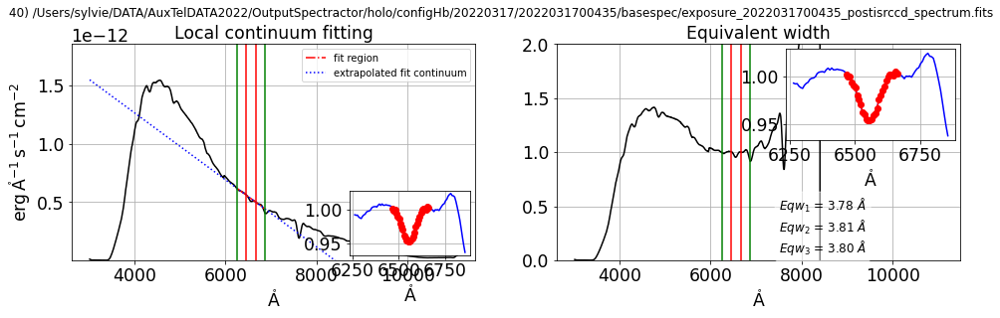

40 ) eqw_halpha= 3.798182674707515
set date_obs to 2022-03-18T03:17:39.779
set expo to 20.0
set airmass to 1.818418067455135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.08344429603447075
set dec to -32.3064444444444
set hour_angle to 67.56159248336594
set temperature to 7.7
set pressure to 743.4
set humidity to 63.0
set lambda_ref to 632.4252252976918
set parallactic_angle to 107.3521665962106
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_308 PM_ERR_MINA_308 PM_ERR_ANGLE_308 Z_VALUE_308 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:32:47  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


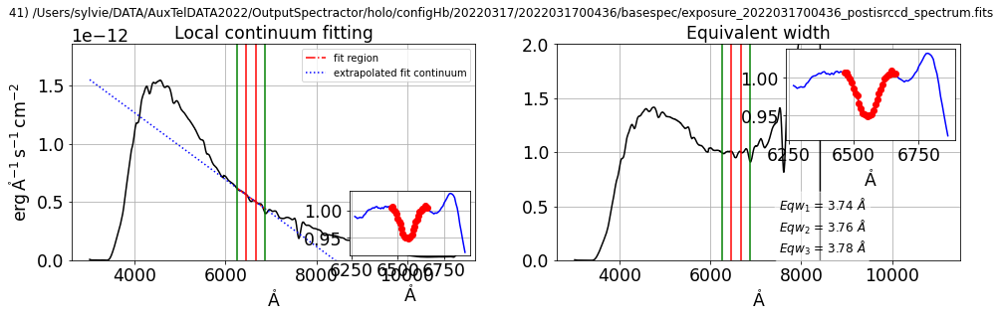

41 ) eqw_halpha= 3.779065247008167
set date_obs to 2022-03-18T03:21:26.873
set expo to 20.0
set airmass to 1.856070090955285
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.06347269052355019
set dec to -32.3064444444444
set hour_angle to 68.51099093135984
set temperature to 7.8
set pressure to 743.4
set humidity to 62.0
set lambda_ref to 630.0633085655397
set parallactic_angle to 107.7035936917225
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_309 PM_ERR_MINA_309 PM_ERR_ANGLE_309 Z_VALUE_309 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:32:56  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


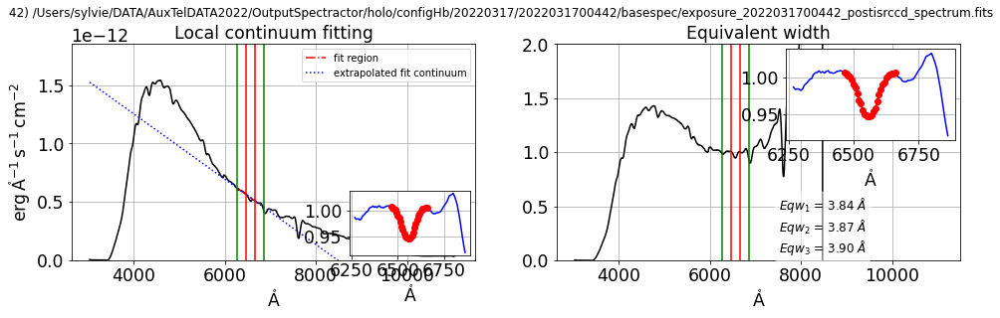

42 ) eqw_halpha= 3.895759968414594
set date_obs to 2022-03-18T03:21:59.878
set expo to 20.0
set airmass to 1.861691550345225
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.0769189759908508
set dec to -32.3064444444444
set hour_angle to 68.64883074724754
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 633.3015467495994
set parallactic_angle to 107.7547458765076
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_310 PM_ERR_MINA_310 PM_ERR_ANGLE_310 Z_VALUE_310 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:33:06  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


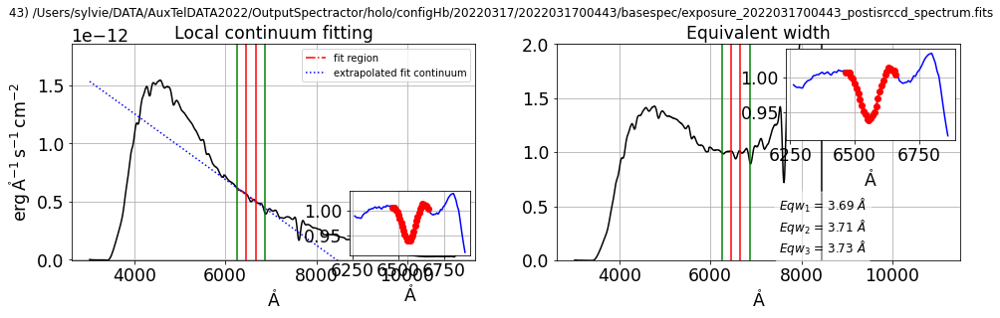

43 ) eqw_halpha= 3.727267049491427


In [125]:
WLMIN=300
WLMAX=1000
lambdas = np.arange(WLMIN,WLMAX,1)
fwhm_func = interp1d(lambdas, 0.01 * lambdas)
parameters.DISPLAY=False


for IDXSEL in np.arange(0,NN):
    filename_SEL=all_good_spectra_spectrum_files[IDXSEL]
    filename_spectrogram_SEL=filename_SEL.replace("_spectrum","_spectrogram")
    fullfilename_SEL = os.path.join(dir_spectra,filename_SEL)
    fullfilename_spectrogram_SEL = fullfilename_SEL.replace("_spectrum","_spectrogram")
    
    # load the spectrum
    s=Spectrum(fullfilename_SEL, config=config)
    s.load_spectrogram(fullfilename_spectrogram_SEL) 
    
    
    lamb = 10*s.lambdas * u.AA 
    flux = s.data * u.Unit('erg cm-2 s-1 AA-1')/10 
    spec = Spectrum1D(spectral_axis=lamb, flux=flux) 
    fluxerr = s.err * u.Unit('erg cm-2 s-1 AA-1')/10. 
    specerr = Spectrum1D(spectral_axis=lamb, flux=fluxerr)
    
    # H2O line
    
    #wlmin=10*(H2O_1.wavelength-30)*u.AA
    #wlmax=10*(H2O_2.wavelength+30)*u.AA
    #wlminline=10*(H2O_1.wavelength-12)*u.AA
    #wlmaxline=10*(H2O_2.wavelength+10)*u.AA
    
    wlmin = wlmin_halpha
    wlmax = wlmax_halpha
    wlminline = wlminline_halpha
    wlmaxline = wlmaxline_halpha
    
    
    fig=plt.figure(figsize=(16,4))
    ax1 = fig.add_subplot(1, 2, 1)
    ax2 = fig.add_subplot(1, 2, 2)
    #eqw1,eqw2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    eqw1,eqw2,eqw3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    #eqw10,eqw20,eq1_set,eq2_set=ComputeEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=20,flag_plot=True,ax1=ax1,ax2=ax2)
    thetitle=str(IDXSEL)+") "+filename_SEL
    plt.suptitle(thetitle,y=1.01)
    plt.show() 
    
    print(IDXSEL,") eqw_halpha=",eqw3)
    
    df_infos.at[IDXSEL,"eqw_halpha"] =  eqw3


## LOOP on H_beta

set date_obs to 2022-03-18T00:51:22.049
set expo to 20.0
set airmass to 1.11557476948966
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1753951396614214
set dec to -32.3064444444444
set hour_angle to 30.8762989508295
set temperature to 8.9
set pressure to 743.45
set humidity to 48.0
set lambda_ref to 626.6801216985461
set parallactic_angle to 93.8012496664173
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_311 PM_ERR_MINA_311 PM_ERR_ANGLE_311 Z_VALUE_311 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110               90   0.0003640     

2022-04-09 19:33:16  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


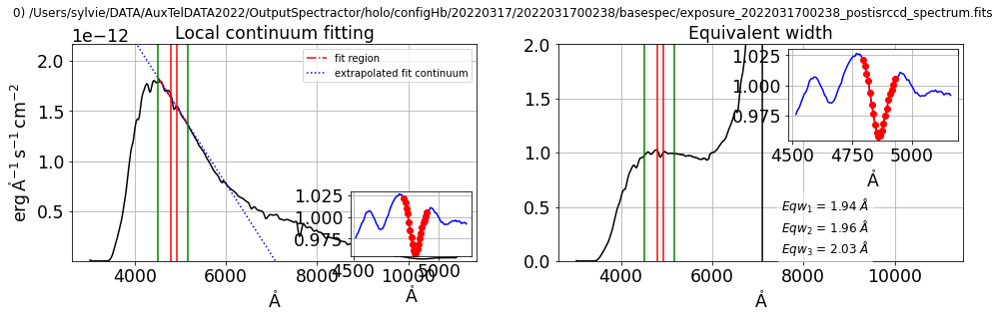

0 ) eqw_hbeta= 2.033180955818282
set date_obs to 2022-03-18T00:54:16.312
set expo to 20.0
set airmass to 1.121576965054115
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1741806116248446
set dec to -32.3064444444444
set hour_angle to 31.60492174100415
set temperature to 8.9
set pressure to 743.45
set humidity to 49.0
set lambda_ref to 626.883564656571
set parallactic_angle to 94.10618686949074
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_312 PM_ERR_MINA_312 PM_ERR_ANGLE_312 Z_VALUE_312 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:33:25  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


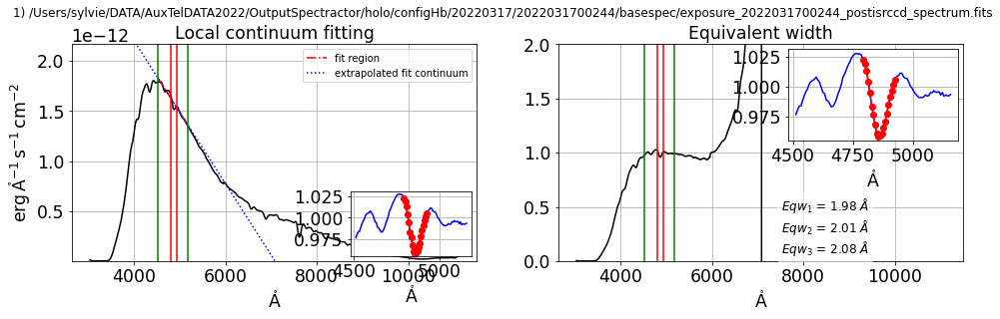

1 ) eqw_hbeta= 2.0823109138896614
set date_obs to 2022-03-18T00:54:49.235
set expo to 20.0
set airmass to 1.12272698054768
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1736210434249555
set dec to -32.3064444444444
set hour_angle to 31.7419273199217
set temperature to 8.8
set pressure to 743.4
set humidity to 49.0
set lambda_ref to 626.0378655266279
set parallactic_angle to 94.16305953909519
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_313 PM_ERR_MINA_313 PM_ERR_ANGLE_313 Z_VALUE_313 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:33:36  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


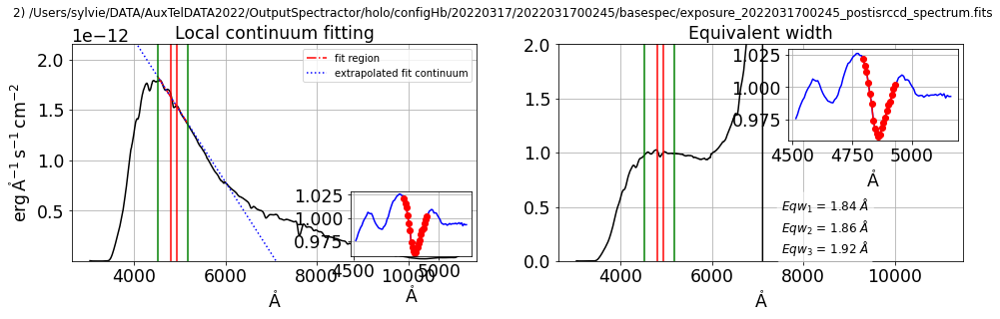

2 ) eqw_hbeta= 1.918249854956245
set date_obs to 2022-03-18T00:57:47.565
set expo to 20.0
set airmass to 1.12910731186445
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1713060449152569
set dec to -32.3064444444444
set hour_angle to 32.4876824869983
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.4911208542796
set parallactic_angle to 94.47019502924495
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_314 PM_ERR_MINA_314 PM_ERR_ANGLE_314 Z_VALUE_314 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:33:46  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


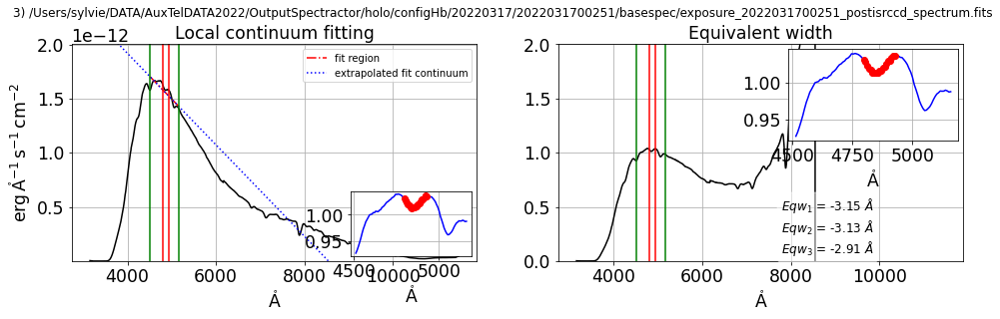

3 ) eqw_hbeta= -2.914305518720707
set date_obs to 2022-03-18T00:58:20.709
set expo to 20.0
set airmass to 1.130309156823195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.169943439836599
set dec to -32.3064444444444
set hour_angle to 32.6255240863161
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.2751365569749
set parallactic_angle to 94.52653019757676
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_315 PM_ERR_MINA_315 PM_ERR_ANGLE_315 Z_VALUE_315 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:33:55  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


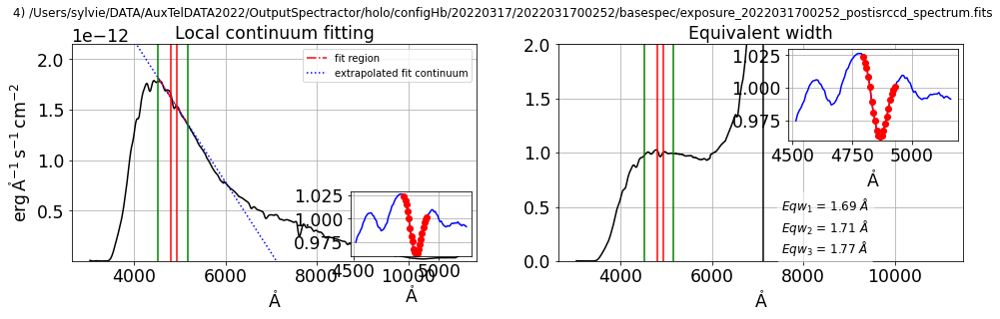

4 ) eqw_hbeta= 1.7745536841056107
set date_obs to 2022-03-18T01:04:49.716
set expo to 20.0
set airmass to 1.14502998698828
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1680537967029804
set dec to -32.3064444444444
set hour_angle to 34.25103021292454
set temperature to 8.9
set pressure to 743.3
set humidity to 53.0
set lambda_ref to 626.5383418087131
set parallactic_angle to 95.18153718788132
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_316 PM_ERR_MINA_316 PM_ERR_ANGLE_316 Z_VALUE_316 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:34:06  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


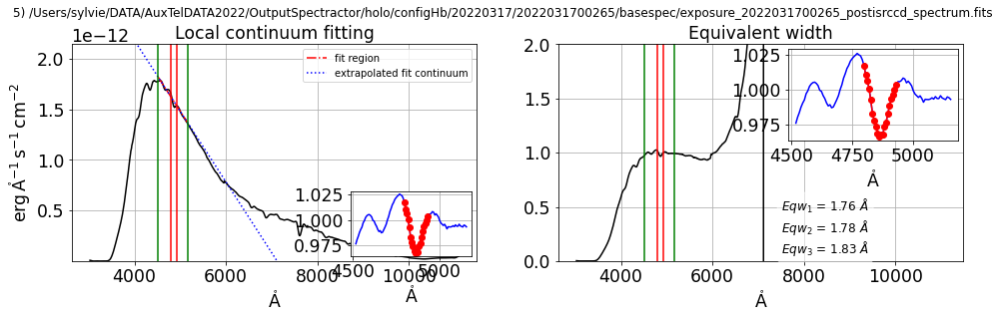

5 ) eqw_hbeta= 1.8294600638439624
set date_obs to 2022-03-18T01:08:18.080
set expo to 20.0
set airmass to 1.1533391050821
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.165620392992809
set dec to -32.3064444444444
set hour_angle to 35.12228883044955
set temperature to 8.9
set pressure to 743.3
set humidity to 51.0
set lambda_ref to 626.067912732114
set parallactic_angle to 95.52618006847594
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_317 PM_ERR_MINA_317 PM_ERR_ANGLE_317 Z_VALUE_317 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110  

2022-04-09 19:34:17  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


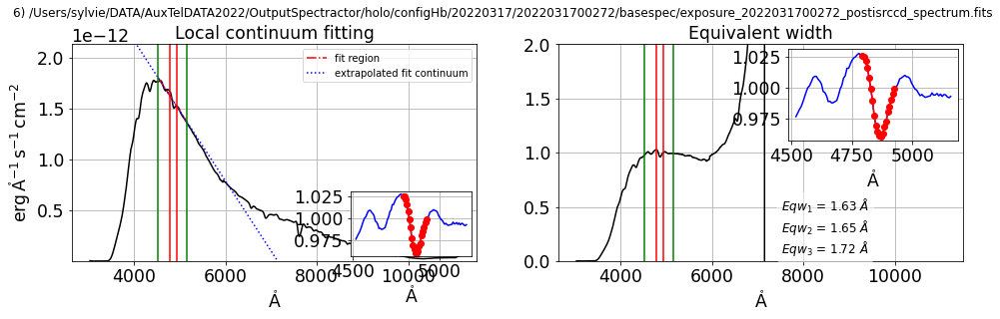

6 ) eqw_hbeta= 1.7163500502883078
set date_obs to 2022-03-18T01:08:50.992
set expo to 20.0
set airmass to 1.154683255421995
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1687630065527601
set dec to -32.3064444444444
set hour_angle to 35.26034049072464
set temperature to 8.9
set pressure to 743.35
set humidity to 51.0
set lambda_ref to 626.2488273411835
set parallactic_angle to 95.58041503368928
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_318 PM_ERR_MINA_318 PM_ERR_ANGLE_318 Z_VALUE_318 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:34:27  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


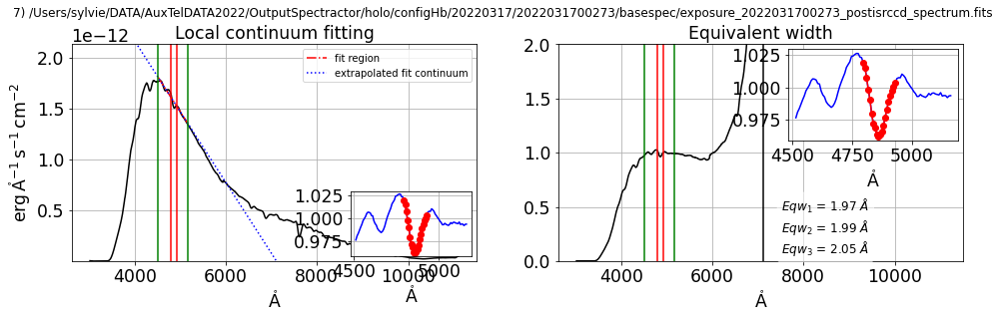

7 ) eqw_hbeta= 2.0473681815324865
set date_obs to 2022-03-18T01:11:46.031
set expo to 20.0
set airmass to 1.16193866550813
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1650200479066801
set dec to -32.3064444444444
set hour_angle to 35.99118130784399
set temperature to 8.9
set pressure to 743.4
set humidity to 53.0
set lambda_ref to 625.9517855761172
set parallactic_angle to 95.86593376321808
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_319 PM_ERR_MINA_319 PM_ERR_ANGLE_319 Z_VALUE_319 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:34:36  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


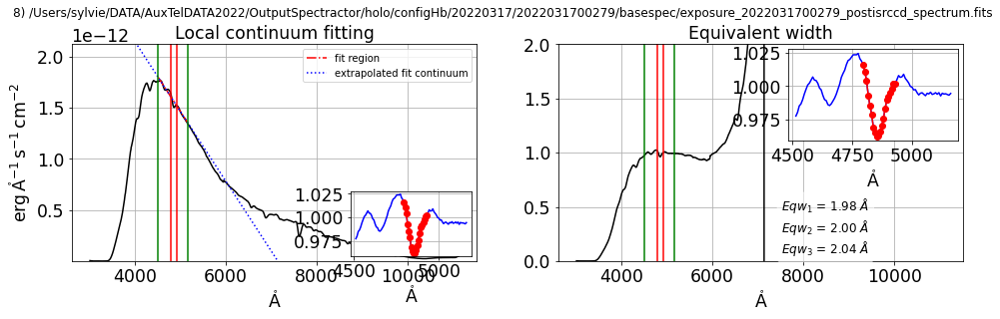

8 ) eqw_hbeta= 2.0430664309649704
set date_obs to 2022-03-18T01:15:18.583
set expo to 20.0
set airmass to 1.17105276018288
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1604530597215738
set dec to -32.3064444444444
set hour_angle to 36.87993052247099
set temperature to 8.9
set pressure to 743.45
set humidity to 54.0
set lambda_ref to 626.415954438991
set parallactic_angle to 96.20974235390722
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_320 PM_ERR_MINA_320 PM_ERR_ANGLE_320 Z_VALUE_320 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:34:46  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


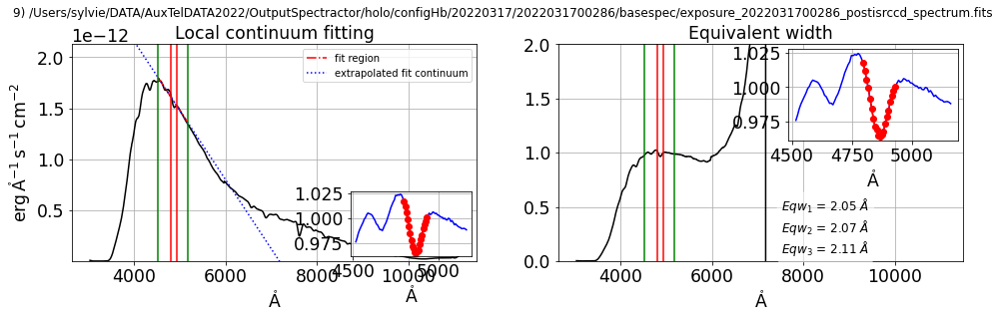

9 ) eqw_hbeta= 2.1126323479014
set date_obs to 2022-03-18T01:18:45.526
set expo to 20.0
set airmass to 1.18024864471996
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.161506254140246
set dec to -32.3064444444444
set hour_angle to 37.74449227926539
set temperature to 9.0
set pressure to 743.45
set humidity to 53.0
set lambda_ref to 626.2661772674467
set parallactic_angle to 96.54092631927332
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_321 PM_ERR_MINA_321 PM_ERR_ANGLE_321 Z_VALUE_321 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110  

2022-04-09 19:34:56  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


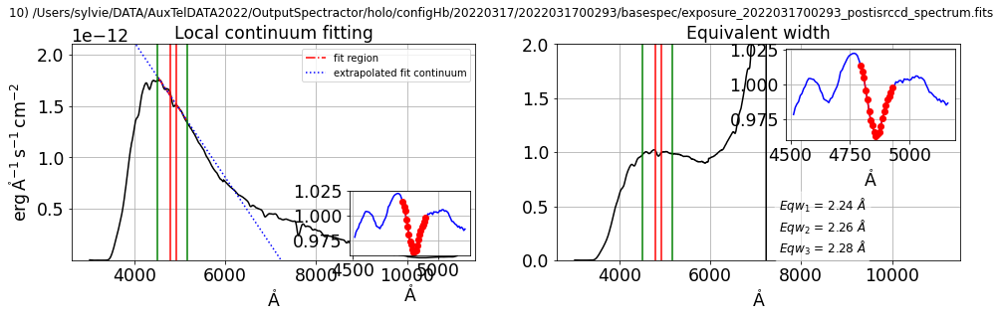

10 ) eqw_hbeta= 2.278576524314753
set date_obs to 2022-03-18T01:22:16.238
set expo to 20.0
set airmass to 1.189962402398665
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1600582040885921
set dec to -32.3064444444444
set hour_angle to 38.6257061937975
set temperature to 8.9
set pressure to 743.4
set humidity to 56.0
set lambda_ref to 626.2915574183227
set parallactic_angle to 96.875483029922
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_322 PM_ERR_MINA_322 PM_ERR_ANGLE_322 Z_VALUE_322 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110 

2022-04-09 19:35:06  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


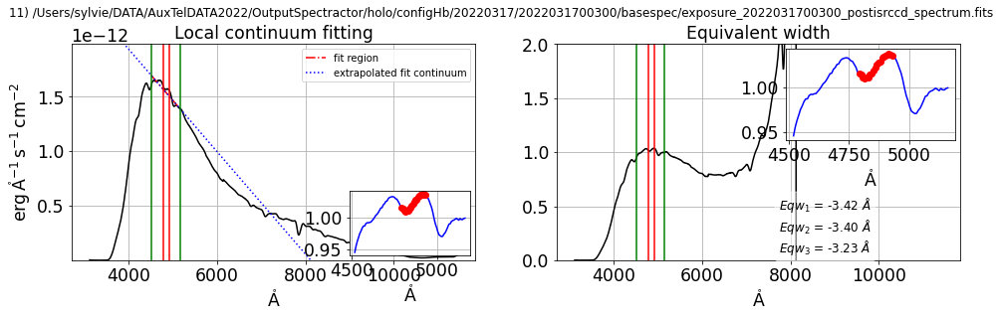

11 ) eqw_hbeta= -3.23260164874768
set date_obs to 2022-03-18T01:22:49.144
set expo to 20.0
set airmass to 1.191505368069865
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1585750124351514
set dec to -32.3064444444444
set hour_angle to 38.76271209839639
set temperature to 9.0
set pressure to 743.45
set humidity to 56.0
set lambda_ref to 626.4868452630084
set parallactic_angle to 96.92724413418016
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_323 PM_ERR_MINA_323 PM_ERR_ANGLE_323 Z_VALUE_323 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:35:16  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


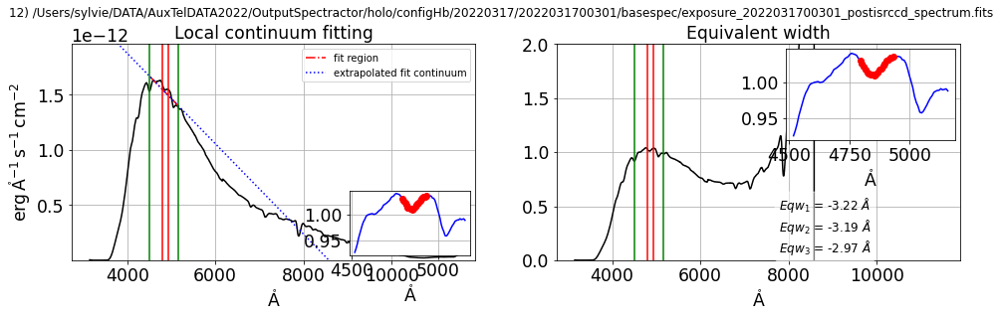

12 ) eqw_hbeta= -2.970115982051481
set date_obs to 2022-03-18T01:43:57.837
set expo to 20.0
set airmass to 1.25822658979951
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476502374643685
set dec to -32.3064444444444
set hour_angle to 44.06414790775874
set temperature to 8.8
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 626.6251269515418
set parallactic_angle to 98.88882683561982
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_324 PM_ERR_MINA_324 PM_ERR_ANGLE_324 Z_VALUE_324 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:35:25  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


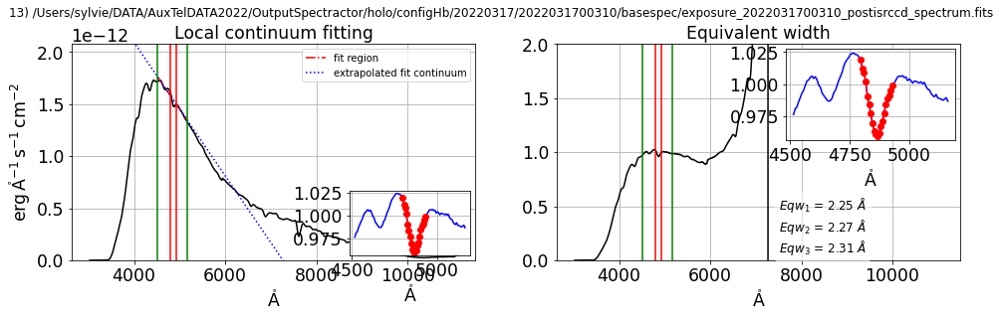

13 ) eqw_hbeta= 2.3086841647288736
set date_obs to 2022-03-18T01:46:52.361
set expo to 20.0
set airmass to 1.26858445121286
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476350630254128
set dec to -32.3064444444444
set hour_angle to 44.79438636254909
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 627.6256863262817
set parallactic_angle to 99.15414320783184
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_325 PM_ERR_MINA_325 PM_ERR_ANGLE_325 Z_VALUE_325 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:35:35  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


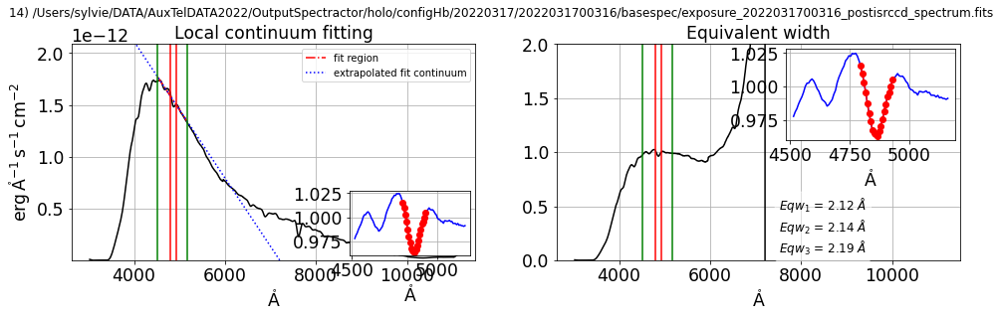

14 ) eqw_hbeta= 2.1933059267594834
set date_obs to 2022-03-18T01:47:25.256
set expo to 20.0
set airmass to 1.27056341471374
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1466645118411156
set dec to -32.3064444444444
set hour_angle to 44.9315970155517
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 625.7408027741238
set parallactic_angle to 99.2038979478238
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_326 PM_ERR_MINA_326 PM_ERR_ANGLE_326 Z_VALUE_326 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:35:46  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


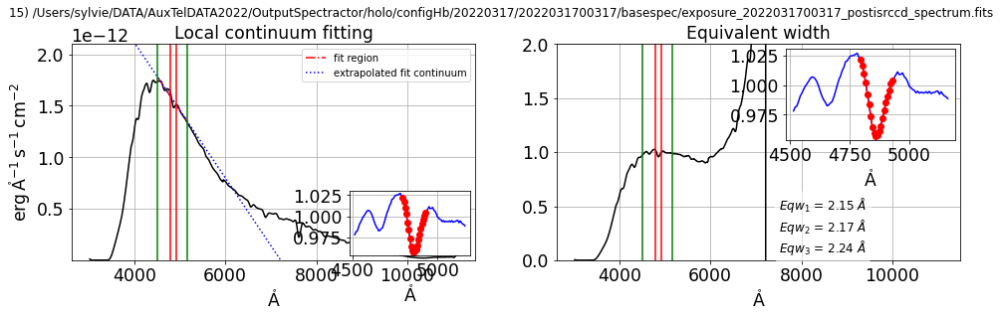

15 ) eqw_hbeta= 2.240620472896334
set date_obs to 2022-03-18T01:53:46.736
set expo to 20.0
set airmass to 1.294394244363805
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1444547716136137
set dec to -32.3064444444444
set hour_angle to 46.52581667330039
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.9120383005036
set parallactic_angle to 99.77999069166285
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_327 PM_ERR_MINA_327 PM_ERR_ANGLE_327 Z_VALUE_327 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:35:56  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


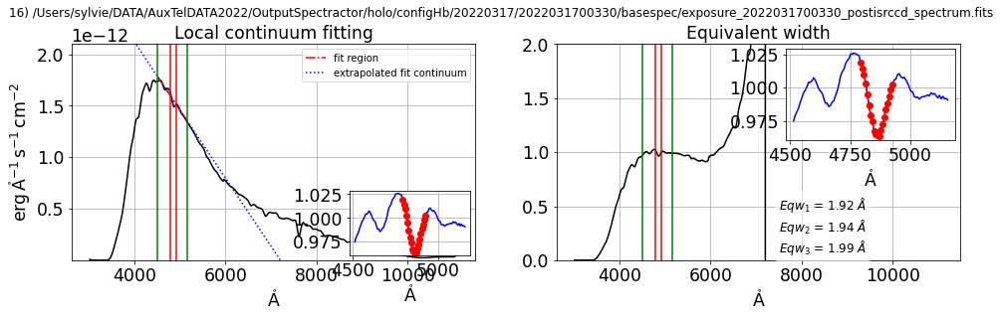

16 ) eqw_hbeta= 1.9922903785607906
set date_obs to 2022-03-18T01:54:19.724
set expo to 20.0
set airmass to 1.29652271576687
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1441648974084375
set dec to -32.3064444444444
set hour_angle to 46.6628171725209
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.7462807078947
set parallactic_angle to 99.82934304254884
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_328 PM_ERR_MINA_328 PM_ERR_ANGLE_328 Z_VALUE_328 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:36:05  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


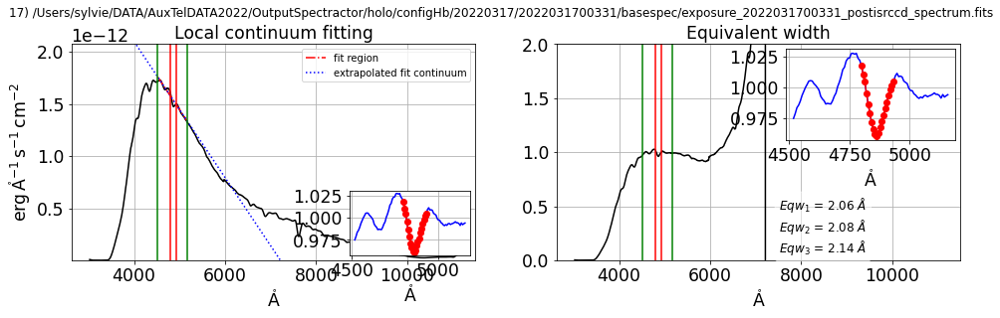

17 ) eqw_hbeta= 2.1424202130388537
set date_obs to 2022-03-18T01:57:49.306
set expo to 20.0
set airmass to 1.31035777011874
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1437462230173573
set dec to -32.3064444444444
set hour_angle to 47.53898537176394
set temperature to 8.7
set pressure to 743.45
set humidity to 57.0
set lambda_ref to 628.9551099539515
set parallactic_angle to 100.14447493807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_329 PM_ERR_MINA_329 PM_ERR_ANGLE_329 Z_VALUE_329 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:36:16  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


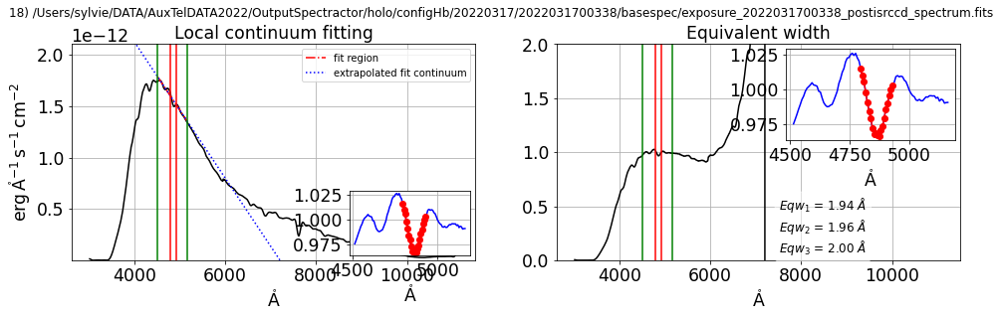

18 ) eqw_hbeta= 2.0001078012253406
set date_obs to 2022-03-18T02:01:19.196
set expo to 20.0
set airmass to 1.324716687989025
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1392710710370809
set dec to -32.3064444444444
set hour_angle to 48.4163008821963
set temperature to 8.6
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 626.8625000130343
set parallactic_angle to 100.4592627484374
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_330 PM_ERR_MINA_330 PM_ERR_ANGLE_330 Z_VALUE_330 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:36:27  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


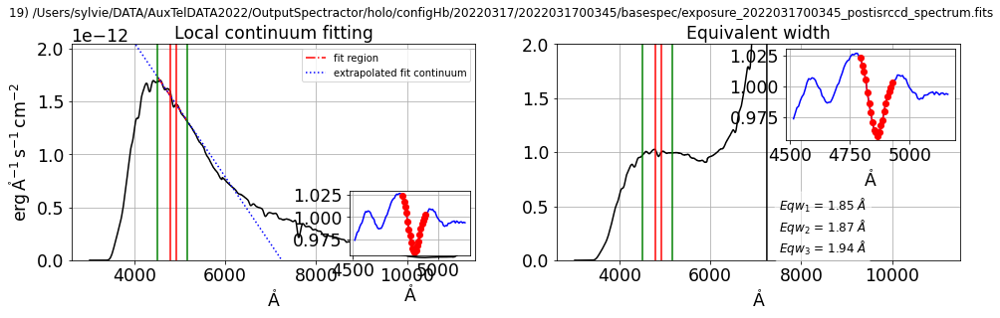

19 ) eqw_hbeta= 1.9437710857936092
set date_obs to 2022-03-18T02:04:16.794
set expo to 20.0
set airmass to 1.33727547076682
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1388486262435704
set dec to -32.3064444444444
set hour_angle to 49.15879882143194
set temperature to 8.5
set pressure to 743.45
set humidity to 58.0
set lambda_ref to 628.5424256920012
set parallactic_angle to 100.7251843777299
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_331 PM_ERR_MINA_331 PM_ERR_ANGLE_331 Z_VALUE_331 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:36:39  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


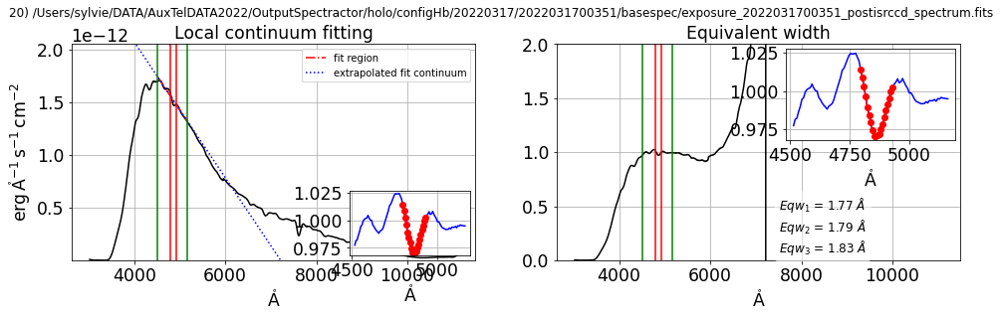

20 ) eqw_hbeta= 1.825776465485484
set date_obs to 2022-03-18T02:04:49.712
set expo to 20.0
set airmass to 1.33963651479802
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1368681187146323
set dec to -32.3064444444444
set hour_angle to 49.29580448438519
set temperature to 8.5
set pressure to 743.35
set humidity to 58.0
set lambda_ref to 628.2086674961155
set parallactic_angle to 100.7742095756281
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_332 PM_ERR_MINA_332 PM_ERR_ANGLE_332 Z_VALUE_332 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:36:50  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


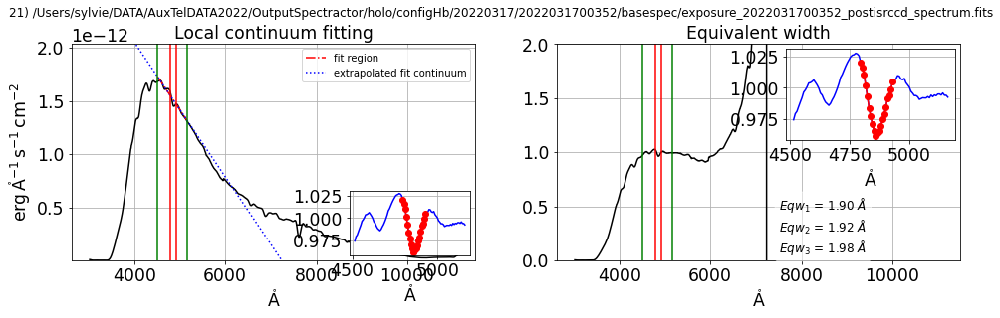

21 ) eqw_hbeta= 1.984308810712127
set date_obs to 2022-03-18T02:07:49.074
set expo to 20.0
set airmass to 1.352787300037425
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1331931685876357
set dec to -32.3064444444444
set hour_angle to 50.04587365708529
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 627.9591693143808
set parallactic_angle to 101.0424069948098
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_333 PM_ERR_MINA_333 PM_ERR_ANGLE_333 Z_VALUE_333 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:37:00  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


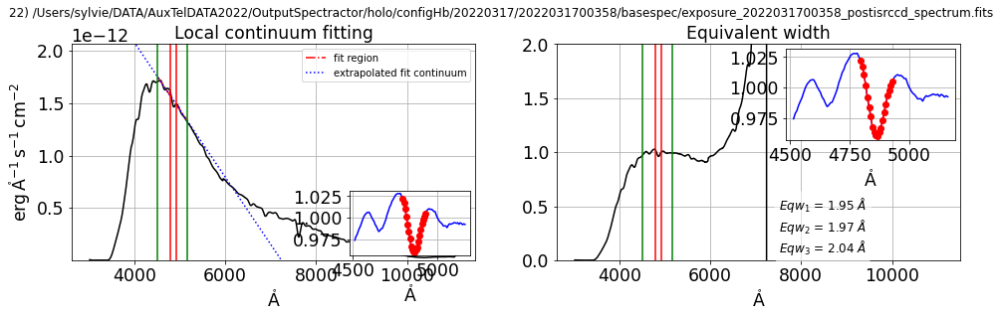

22 ) eqw_hbeta= 2.0420076273542636
set date_obs to 2022-03-18T02:11:20.051
set expo to 20.0
set airmass to 1.368765631503195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1336440841342464
set dec to -32.3064444444444
set hour_angle to 50.92719907664954
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 622.7051672626101
set parallactic_angle to 101.357174452077
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_334 PM_ERR_MINA_334 PM_ERR_ANGLE_334 Z_VALUE_334 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:37:11  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


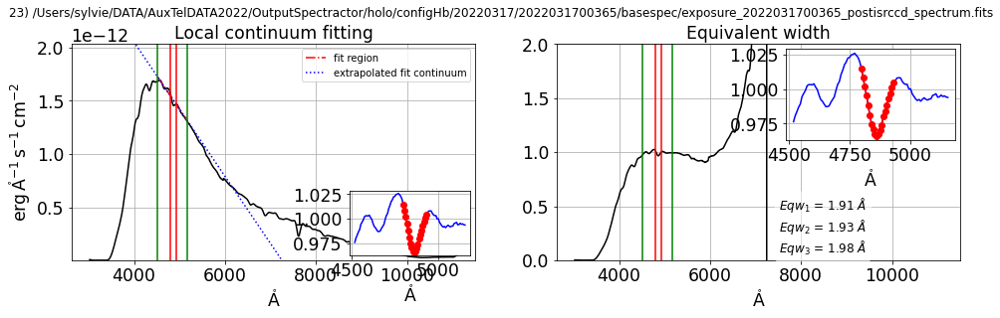

23 ) eqw_hbeta= 1.9791375525373802
set date_obs to 2022-03-18T02:11:53.006
set expo to 20.0
set airmass to 1.371319339871885
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1369079175197151
set dec to -32.3064444444444
set hour_angle to 51.06504024257939
set temperature to 8.4
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 629.1845159477502
set parallactic_angle to 101.4063764649771
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_335 PM_ERR_MINA_335 PM_ERR_ANGLE_335 Z_VALUE_335 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:37:21  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


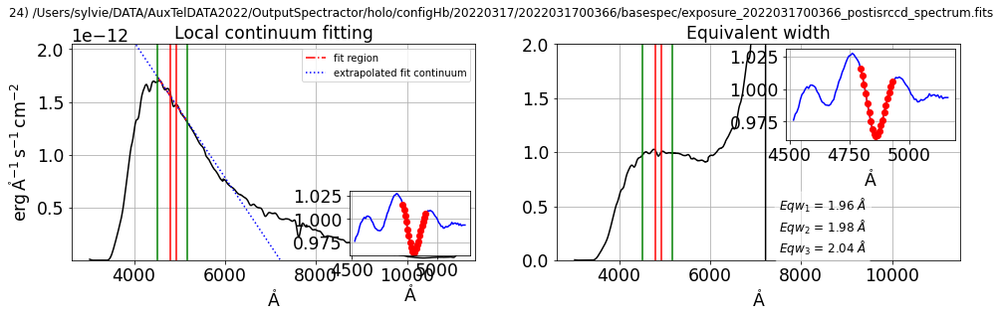

24 ) eqw_hbeta= 2.036849023560595
set date_obs to 2022-03-18T02:14:46.798
set expo to 20.0
set airmass to 1.38501167017706
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1310814762516916
set dec to -32.3064444444444
set hour_angle to 51.79156958975715
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.5245232921197
set parallactic_angle to 101.6656129875546
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_336 PM_ERR_MINA_336 PM_ERR_ANGLE_336 Z_VALUE_336 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:37:32  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


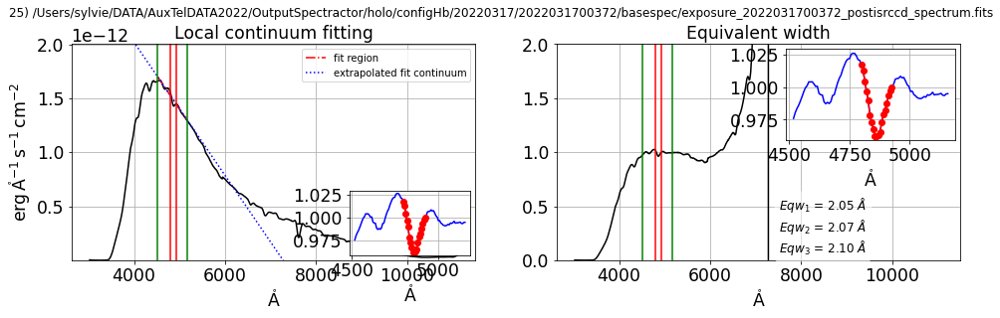

25 ) eqw_hbeta= 2.1042045157698
set date_obs to 2022-03-18T02:15:19.743
set expo to 20.0
set airmass to 1.387649936190795
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1317245037126307
set dec to -32.3064444444444
set hour_angle to 51.92878009828319
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.9968889639981
set parallactic_angle to 101.7145568247823
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_337 PM_ERR_MINA_337 PM_ERR_ANGLE_337 Z_VALUE_337 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:37:43  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


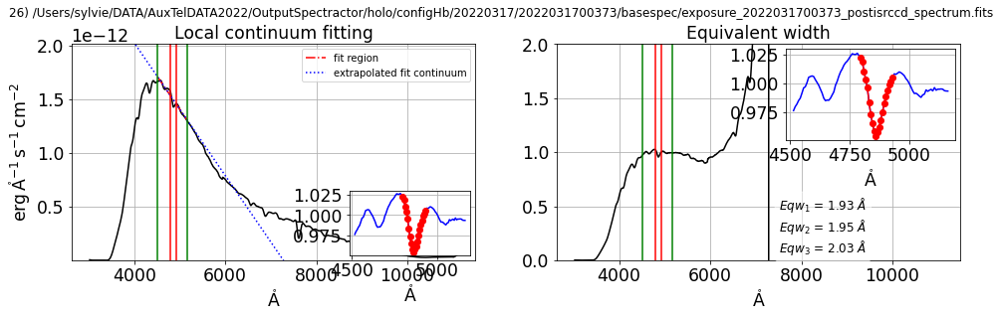

26 ) eqw_hbeta= 2.0266783179657812
set date_obs to 2022-03-18T02:33:33.012
set expo to 20.0
set airmass to 1.48452422171666
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1197628273916148
set dec to -32.3064444444444
set hour_angle to 56.49902324990354
set temperature to 8.0
set pressure to 743.35
set humidity to 63.0
set lambda_ref to 628.5888123380201
set parallactic_angle to 103.3450343494105
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_338 PM_ERR_MINA_338 PM_ERR_ANGLE_338 Z_VALUE_338 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:37:54  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


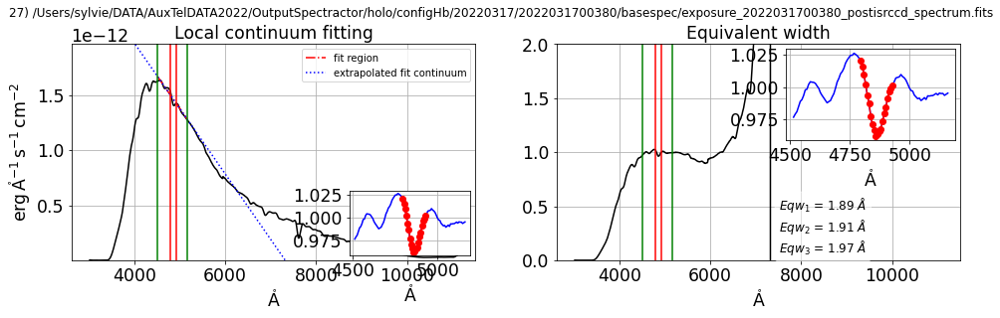

27 ) eqw_hbeta= 1.9679441286660533
set date_obs to 2022-03-18T02:36:30.874
set expo to 20.0
set airmass to 1.50213593383469
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1172584274998106
set dec to -32.3064444444444
set hour_angle to 57.24247377715349
set temperature to 8.1
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 633.8101508297243
set parallactic_angle to 103.6108187575918
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_339 PM_ERR_MINA_339 PM_ERR_ANGLE_339 Z_VALUE_339 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:38:05  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


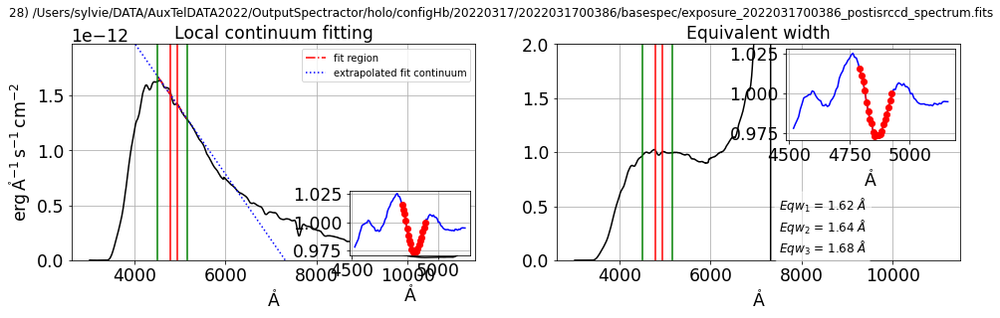

28 ) eqw_hbeta= 1.677063382655361
set date_obs to 2022-03-18T02:37:03.815
set expo to 20.0
set airmass to 1.50545657928364
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1211335036558286
set dec to -32.3064444444444
set hour_angle to 57.37947904087095
set temperature to 8.1
set pressure to 743.35
set humidity to 64.0
set lambda_ref to 628.2172036981787
set parallactic_angle to 103.6598297048832
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_340 PM_ERR_MINA_340 PM_ERR_ANGLE_340 Z_VALUE_340 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:38:16  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


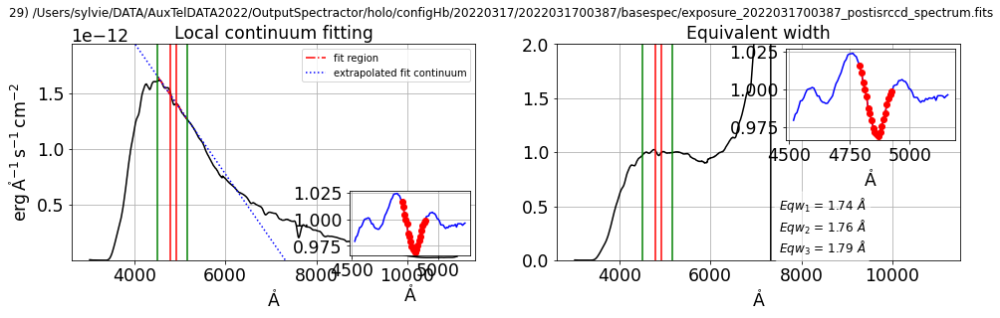

29 ) eqw_hbeta= 1.7948861866495727
set date_obs to 2022-03-18T02:40:00.839
set expo to 20.0
set airmass to 1.523657512515415
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1177429780701742
set dec to -32.3064444444444
set hour_angle to 58.11949120092164
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.3577400172557
set parallactic_angle to 103.9247454603291
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_341 PM_ERR_MINA_341 PM_ERR_ANGLE_341 Z_VALUE_341 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:38:27  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


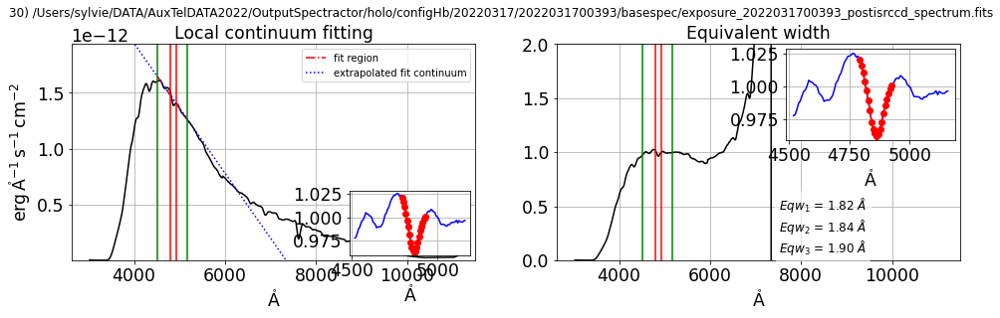

30 ) eqw_hbeta= 1.8991439301708788
set date_obs to 2022-03-18T02:40:33.787
set expo to 20.0
set airmass to 1.527114954027915
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1169167488860146
set dec to -32.3064444444444
set hour_angle to 58.25733391386269
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.7847433714671
set parallactic_angle to 103.9741296646409
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_342 PM_ERR_MINA_342 PM_ERR_ANGLE_342 Z_VALUE_342 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:38:38  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


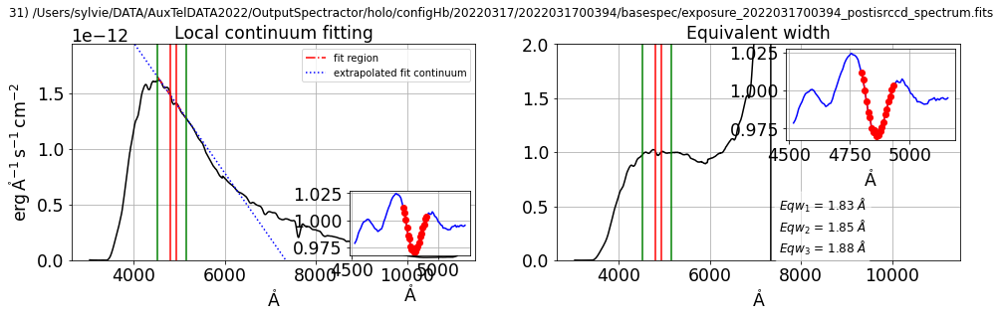

31 ) eqw_hbeta= 1.881970330075414
set date_obs to 2022-03-18T02:44:05.105
set expo to 20.0
set airmass to 1.54976447202586
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1144055844584487
set dec to -32.3064444444444
set hour_angle to 59.14046723526914
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 629.2826348266267
set parallactic_angle to 104.2908413745483
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_343 PM_ERR_MINA_343 PM_ERR_ANGLE_343 Z_VALUE_343 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:38:49  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


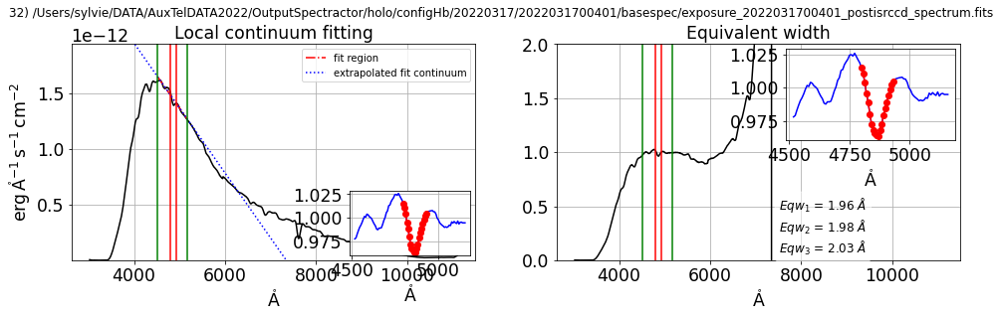

32 ) eqw_hbeta= 2.0256432137926943
set date_obs to 2022-03-18T02:47:02.835
set expo to 20.0
set airmass to 1.56951976624838
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.113192412444726
set dec to -32.3064444444444
set hour_angle to 59.88301895711849
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 623.392411114623
set parallactic_angle to 104.5576025273592
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_344 PM_ERR_MINA_344 PM_ERR_ANGLE_344 Z_VALUE_344 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:39:00  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


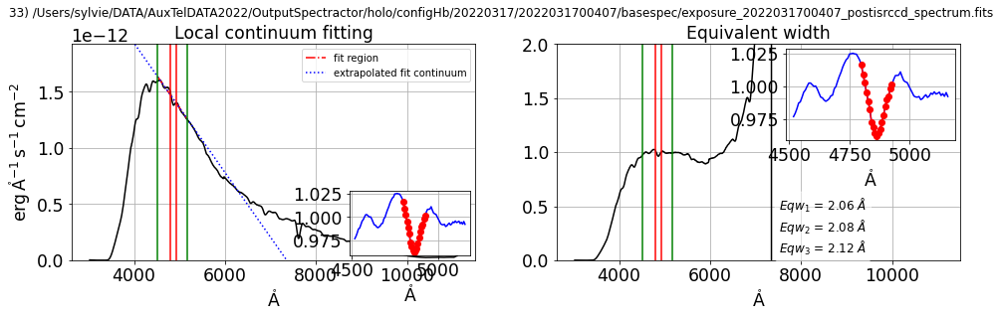

33 ) eqw_hbeta= 2.118816666521472
set date_obs to 2022-03-18T02:47:35.769
set expo to 20.0
set airmass to 1.573248011911855
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1127873058479127
set dec to -32.3064444444444
set hour_angle to 60.02106934614464
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 624.3168639615992
set parallactic_angle to 104.6072480488688
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_345 PM_ERR_MINA_345 PM_ERR_ANGLE_345 Z_VALUE_345 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:39:11  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


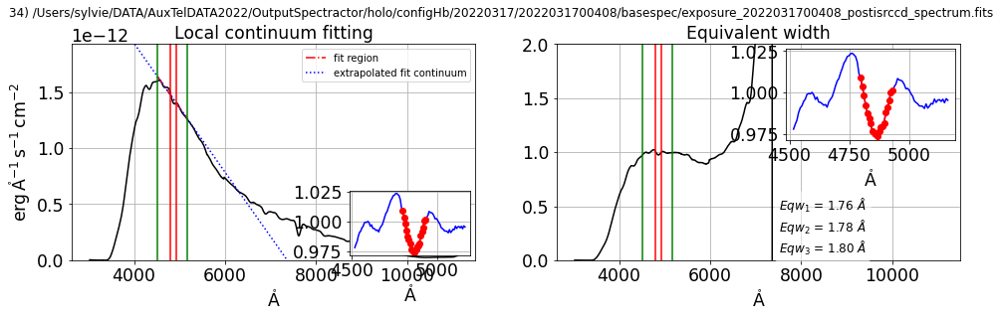

34 ) eqw_hbeta= 1.7985311229912764
set date_obs to 2022-03-18T02:50:38.306
set expo to 20.0
set airmass to 1.594345273370295
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1038057563272595
set dec to -32.3064444444444
set hour_angle to 60.78322641711044
set temperature to 8.0
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 625.6140852852044
set parallactic_angle to 104.8816435668321
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_346 PM_ERR_MINA_346 PM_ERR_ANGLE_346 Z_VALUE_346 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:39:23  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


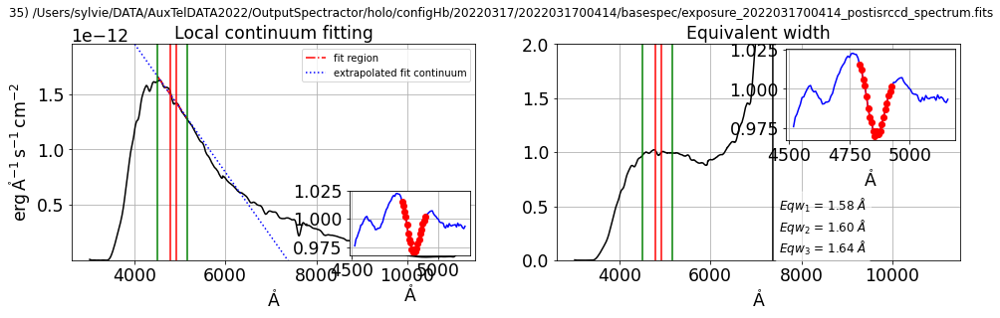

35 ) eqw_hbeta= 1.6372201811476184
set date_obs to 2022-03-18T03:08:41.573
set expo to 20.0
set airmass to 1.73594131895663
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09058150608401207
set dec to -32.3064444444444
set hour_angle to 65.3119392087705
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 631.9889212287092
set parallactic_angle to 106.5252810168807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_347 PM_ERR_MINA_347 PM_ERR_ANGLE_347 Z_VALUE_347 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:39:34  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


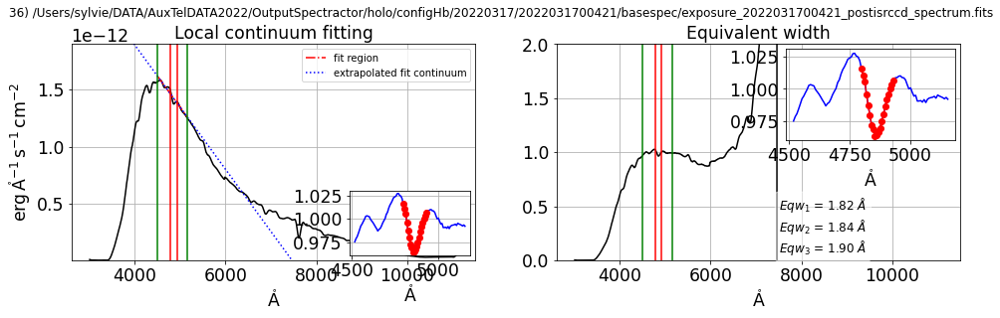

36 ) eqw_hbeta= 1.8992559698493363
set date_obs to 2022-03-18T03:09:14.484
set expo to 20.0
set airmass to 1.740715384660955
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09733707671582016
set dec to -32.3064444444444
set hour_angle to 65.44894264967655
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 625.9596270530473
set parallactic_angle to 106.5754178018598
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_348 PM_ERR_MINA_348 PM_ERR_ANGLE_348 Z_VALUE_348 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:39:46  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


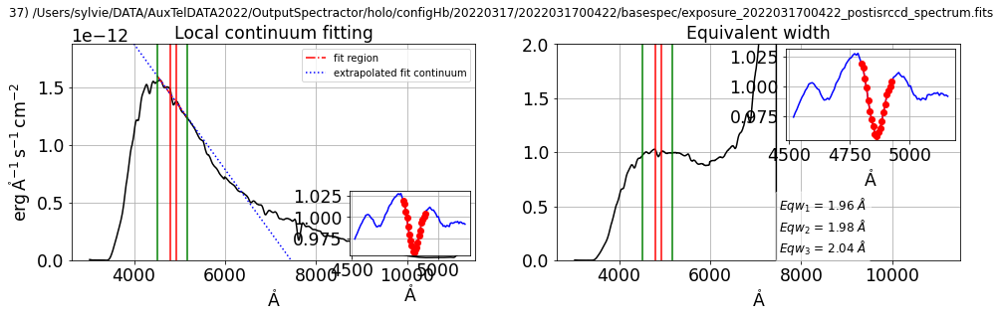

37 ) eqw_hbeta= 2.042957352152633
set date_obs to 2022-03-18T03:12:54.310
set expo to 20.0
set airmass to 2.129245852899135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.143944791309082
set dec to -87.4721944444444
set hour_angle to -155.5929780702915
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 686.0625390317258
set parallactic_angle to -156.1678055894986
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_349 PM_ERR_MINA_349 PM_ERR_ANGLE_349 Z_VALUE_349 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
HD 185975 20 28 18.7398 -87 28 19.937      14       14 ...           0.017          

2022-04-09 19:39:57  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


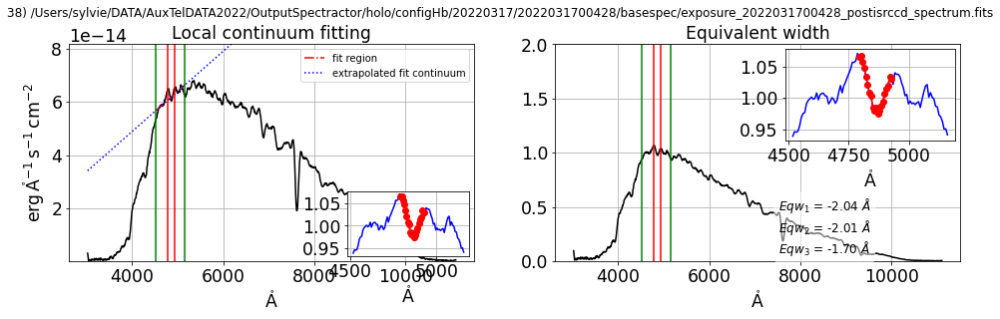

38 ) eqw_hbeta= -1.7007511158323958
set date_obs to 2022-03-18T03:13:27.208
set expo to 20.0
set airmass to 2.1290679262036
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09887590360164929
set dec to -87.4721944444444
set hour_angle to -155.455137691263
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 636.4362643500099
set parallactic_angle to -156.0330469936088
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_350 PM_ERR_MINA_350 PM_ERR_ANGLE_350 Z_VALUE_350 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
HD 185975 20 28 18.7398 -87 28 19.937      14       14 ...           0.017         

2022-04-09 19:40:09  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


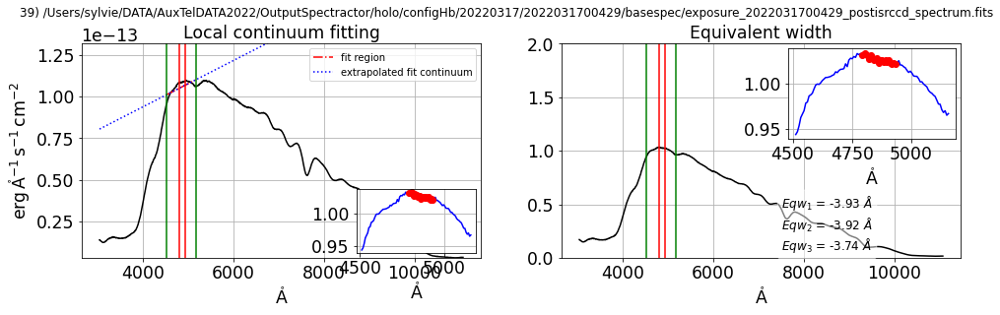

39 ) eqw_hbeta= -3.74150414011686
set date_obs to 2022-03-18T03:17:06.794
set expo to 20.0
set airmass to 1.81309435755974
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09210139501009447
set dec to -32.3064444444444
set hour_angle to 67.42354300312304
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 626.8738274489511
set parallactic_angle to 107.3011935159837
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_351 PM_ERR_MINA_351 PM_ERR_ANGLE_351 Z_VALUE_351 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:40:20  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


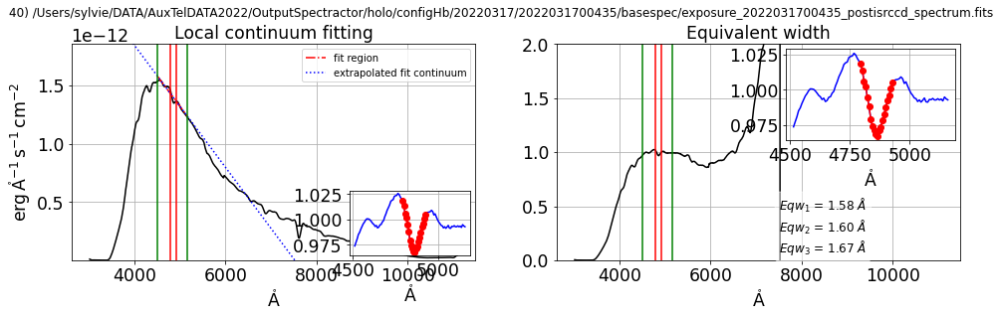

40 ) eqw_hbeta= 1.6657136825718886
set date_obs to 2022-03-18T03:17:39.779
set expo to 20.0
set airmass to 1.818418067455135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.08344429603447075
set dec to -32.3064444444444
set hour_angle to 67.56159248336594
set temperature to 7.7
set pressure to 743.4
set humidity to 63.0
set lambda_ref to 632.4252252976918
set parallactic_angle to 107.3521665962106
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_352 PM_ERR_MINA_352 PM_ERR_ANGLE_352 Z_VALUE_352 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:40:31  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


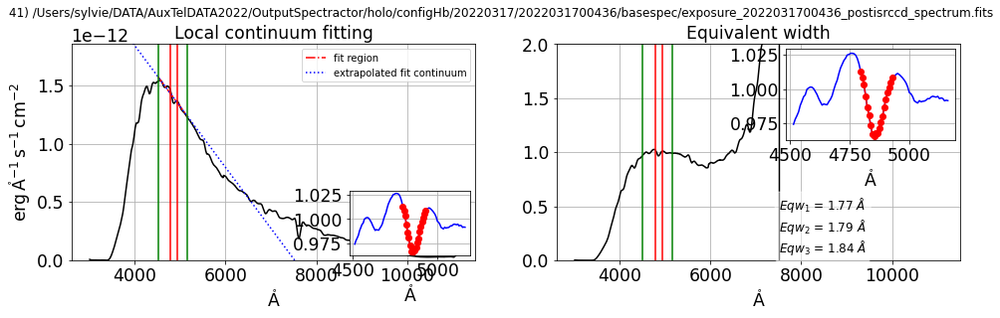

41 ) eqw_hbeta= 1.8397853587940043
set date_obs to 2022-03-18T03:21:26.873
set expo to 20.0
set airmass to 1.856070090955285
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.06347269052355019
set dec to -32.3064444444444
set hour_angle to 68.51099093135984
set temperature to 7.8
set pressure to 743.4
set humidity to 62.0
set lambda_ref to 630.0633085655397
set parallactic_angle to 107.7035936917225
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_353 PM_ERR_MINA_353 PM_ERR_ANGLE_353 Z_VALUE_353 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:40:43  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


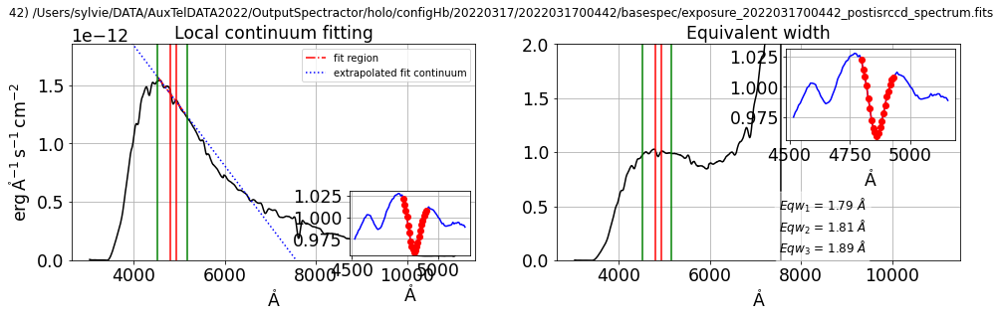

42 ) eqw_hbeta= 1.8944819285573429
set date_obs to 2022-03-18T03:21:59.878
set expo to 20.0
set airmass to 1.861691550345225
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.0769189759908508
set dec to -32.3064444444444
set hour_angle to 68.64883074724754
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 633.3015467495994
set parallactic_angle to 107.7547458765076
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_354 PM_ERR_MINA_354 PM_ERR_ANGLE_354 Z_VALUE_354 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:40:54  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


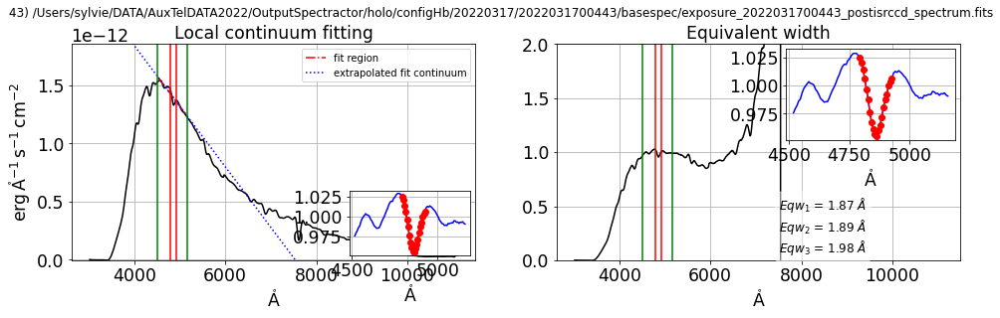

43 ) eqw_hbeta= 1.9777277745154103


In [126]:
WLMIN=300
WLMAX=1000
lambdas = np.arange(WLMIN,WLMAX,1)
fwhm_func = interp1d(lambdas, 0.01 * lambdas)
parameters.DISPLAY=False


for IDXSEL in np.arange(0,NN):
    filename_SEL=all_good_spectra_spectrum_files[IDXSEL]
    filename_spectrogram_SEL=filename_SEL.replace("_spectrum","_spectrogram")
    fullfilename_SEL = os.path.join(dir_spectra,filename_SEL)
    fullfilename_spectrogram_SEL = fullfilename_SEL.replace("_spectrum","_spectrogram")
    
    # load the spectrum
    s=Spectrum(fullfilename_SEL, config=config)
    s.load_spectrogram(fullfilename_spectrogram_SEL) 
    
    
    lamb = 10*s.lambdas * u.AA 
    flux = s.data * u.Unit('erg cm-2 s-1 AA-1')/10 
    spec = Spectrum1D(spectral_axis=lamb, flux=flux) 
    fluxerr = s.err * u.Unit('erg cm-2 s-1 AA-1')/10. 
    specerr = Spectrum1D(spectral_axis=lamb, flux=fluxerr)
    
    # H2O line
    
    #wlmin=10*(H2O_1.wavelength-30)*u.AA
    #wlmax=10*(H2O_2.wavelength+30)*u.AA
    #wlminline=10*(H2O_1.wavelength-12)*u.AA
    #wlmaxline=10*(H2O_2.wavelength+10)*u.AA
    
    wlmin = wlmin_hbeta
    wlmax = wlmax_hbeta
    wlminline = wlminline_hbeta
    wlmaxline = wlmaxline_hbeta
    
    
    fig=plt.figure(figsize=(16,4))
    ax1 = fig.add_subplot(1, 2, 1)
    ax2 = fig.add_subplot(1, 2, 2)
    #eqw1,eqw2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    eqw1,eqw2,eqw3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    #eqw10,eqw20,eq1_set,eq2_set=ComputeEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=20,flag_plot=True,ax1=ax1,ax2=ax2)
    thetitle=str(IDXSEL)+") "+filename_SEL
    plt.suptitle(thetitle,y=1.01)
    plt.show() 
    
    print(IDXSEL,") eqw_hbeta=",eqw3)
    
    df_infos.at[IDXSEL,"eqw_hbeta"] =  eqw3


## LOOP on H_gamma

set date_obs to 2022-03-18T00:51:22.049
set expo to 20.0
set airmass to 1.11557476948966
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1753951396614214
set dec to -32.3064444444444
set hour_angle to 30.8762989508295
set temperature to 8.9
set pressure to 743.45
set humidity to 48.0
set lambda_ref to 626.6801216985461
set parallactic_angle to 93.8012496664173
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_355 PM_ERR_MINA_355 PM_ERR_ANGLE_355 Z_VALUE_355 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110               90   0.0003640     

2022-04-09 19:41:07  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


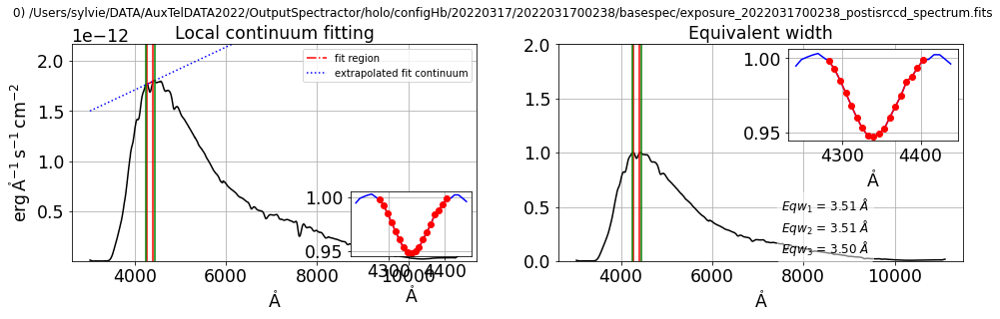

0 ) eqw_hgamma= 3.503224980764779
set date_obs to 2022-03-18T00:54:16.312
set expo to 20.0
set airmass to 1.121576965054115
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1741806116248446
set dec to -32.3064444444444
set hour_angle to 31.60492174100415
set temperature to 8.9
set pressure to 743.45
set humidity to 49.0
set lambda_ref to 626.883564656571
set parallactic_angle to 94.10618686949074
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_356 PM_ERR_MINA_356 PM_ERR_ANGLE_356 Z_VALUE_356 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:41:19  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


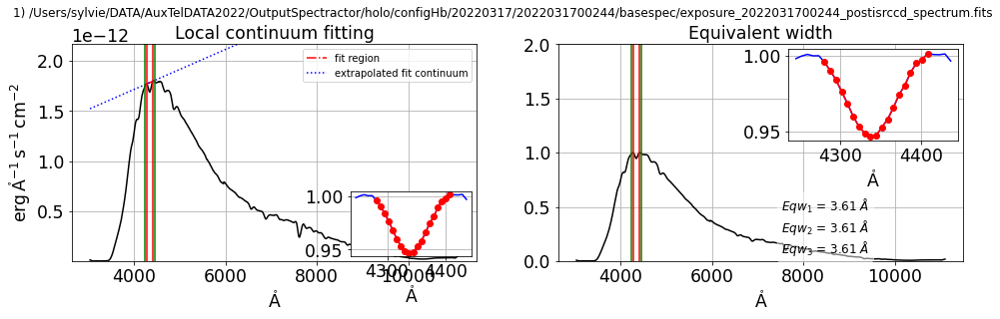

1 ) eqw_hgamma= 3.606313584172842
set date_obs to 2022-03-18T00:54:49.235
set expo to 20.0
set airmass to 1.12272698054768
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1736210434249555
set dec to -32.3064444444444
set hour_angle to 31.7419273199217
set temperature to 8.8
set pressure to 743.4
set humidity to 49.0
set lambda_ref to 626.0378655266279
set parallactic_angle to 94.16305953909519
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_357 PM_ERR_MINA_357 PM_ERR_ANGLE_357 Z_VALUE_357 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:41:31  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


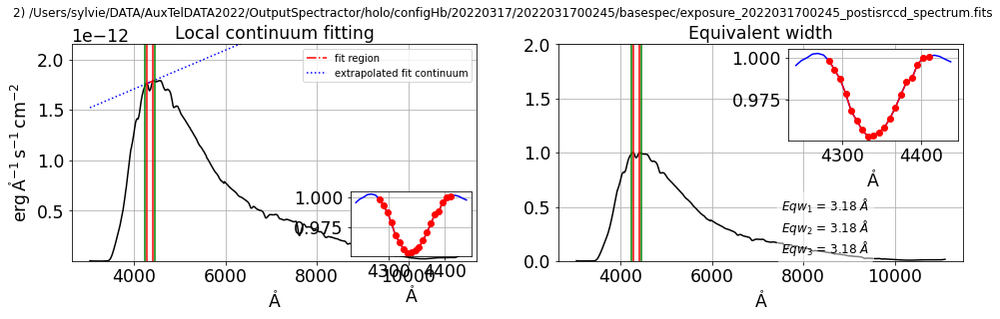

2 ) eqw_hgamma= 3.175584458147471
set date_obs to 2022-03-18T00:57:47.565
set expo to 20.0
set airmass to 1.12910731186445
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1713060449152569
set dec to -32.3064444444444
set hour_angle to 32.4876824869983
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.4911208542796
set parallactic_angle to 94.47019502924495
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_358 PM_ERR_MINA_358 PM_ERR_ANGLE_358 Z_VALUE_358 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:41:43  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


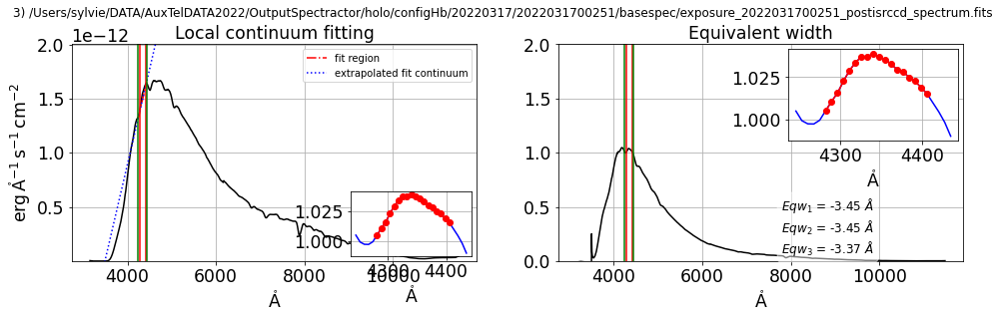

3 ) eqw_hgamma= -3.3730719033701946
set date_obs to 2022-03-18T00:58:20.709
set expo to 20.0
set airmass to 1.130309156823195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.169943439836599
set dec to -32.3064444444444
set hour_angle to 32.6255240863161
set temperature to 8.9
set pressure to 743.4
set humidity to 50.0
set lambda_ref to 626.2751365569749
set parallactic_angle to 94.52653019757676
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_359 PM_ERR_MINA_359 PM_ERR_ANGLE_359 Z_VALUE_359 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:41:54  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


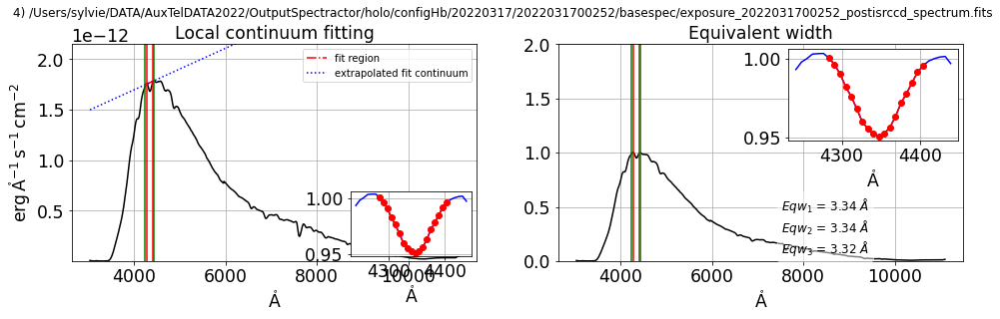

4 ) eqw_hgamma= 3.3235993628550644
set date_obs to 2022-03-18T01:04:49.716
set expo to 20.0
set airmass to 1.14502998698828
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1680537967029804
set dec to -32.3064444444444
set hour_angle to 34.25103021292454
set temperature to 8.9
set pressure to 743.3
set humidity to 53.0
set lambda_ref to 626.5383418087131
set parallactic_angle to 95.18153718788132
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_360 PM_ERR_MINA_360 PM_ERR_ANGLE_360 Z_VALUE_360 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:42:05  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


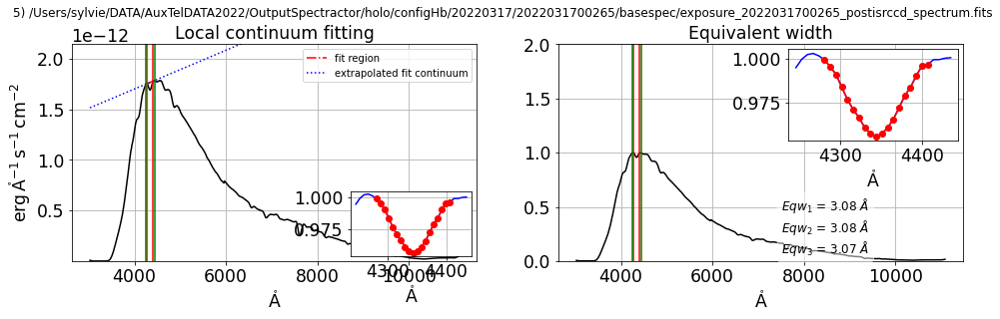

5 ) eqw_hgamma= 3.067518353767303
set date_obs to 2022-03-18T01:08:18.080
set expo to 20.0
set airmass to 1.1533391050821
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.165620392992809
set dec to -32.3064444444444
set hour_angle to 35.12228883044955
set temperature to 8.9
set pressure to 743.3
set humidity to 51.0
set lambda_ref to 626.067912732114
set parallactic_angle to 95.52618006847594
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_361 PM_ERR_MINA_361 PM_ERR_ANGLE_361 Z_VALUE_361 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110  

2022-04-09 19:42:17  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


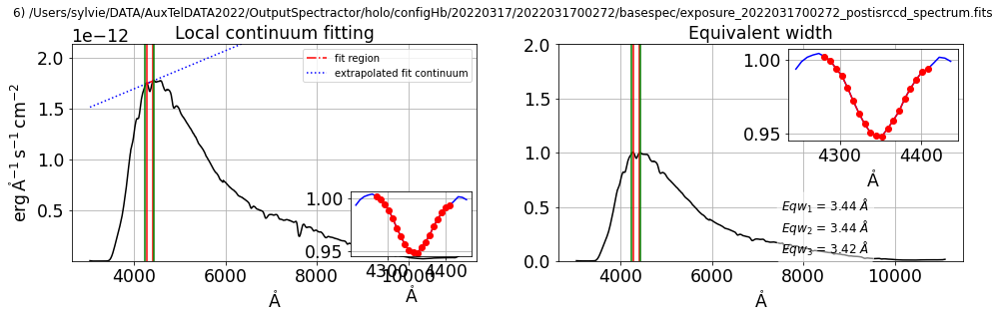

6 ) eqw_hgamma= 3.421513316407142
set date_obs to 2022-03-18T01:08:50.992
set expo to 20.0
set airmass to 1.154683255421995
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1687630065527601
set dec to -32.3064444444444
set hour_angle to 35.26034049072464
set temperature to 8.9
set pressure to 743.35
set humidity to 51.0
set lambda_ref to 626.2488273411835
set parallactic_angle to 95.58041503368928
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_362 PM_ERR_MINA_362 PM_ERR_ANGLE_362 Z_VALUE_362 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:42:29  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


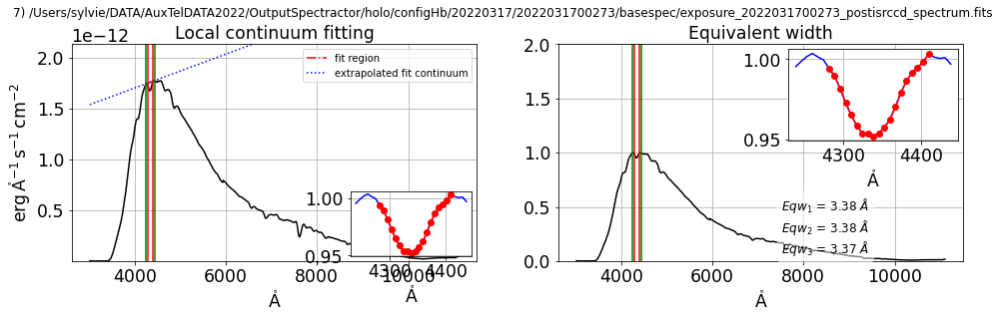

7 ) eqw_hgamma= 3.367458038277568
set date_obs to 2022-03-18T01:11:46.031
set expo to 20.0
set airmass to 1.16193866550813
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1650200479066801
set dec to -32.3064444444444
set hour_angle to 35.99118130784399
set temperature to 8.9
set pressure to 743.4
set humidity to 53.0
set lambda_ref to 625.9517855761172
set parallactic_angle to 95.86593376321808
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_363 PM_ERR_MINA_363 PM_ERR_ANGLE_363 Z_VALUE_363 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:42:41  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


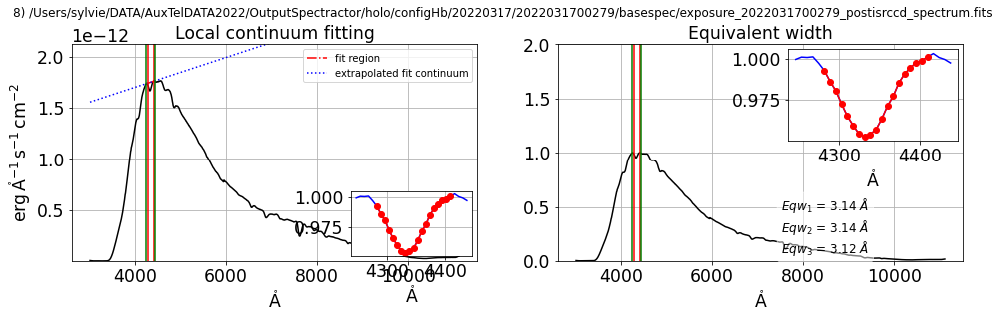

8 ) eqw_hgamma= 3.1213057950175855
set date_obs to 2022-03-18T01:15:18.583
set expo to 20.0
set airmass to 1.17105276018288
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1604530597215738
set dec to -32.3064444444444
set hour_angle to 36.87993052247099
set temperature to 8.9
set pressure to 743.45
set humidity to 54.0
set lambda_ref to 626.415954438991
set parallactic_angle to 96.20974235390722
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_364 PM_ERR_MINA_364 PM_ERR_ANGLE_364 Z_VALUE_364 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:42:53  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


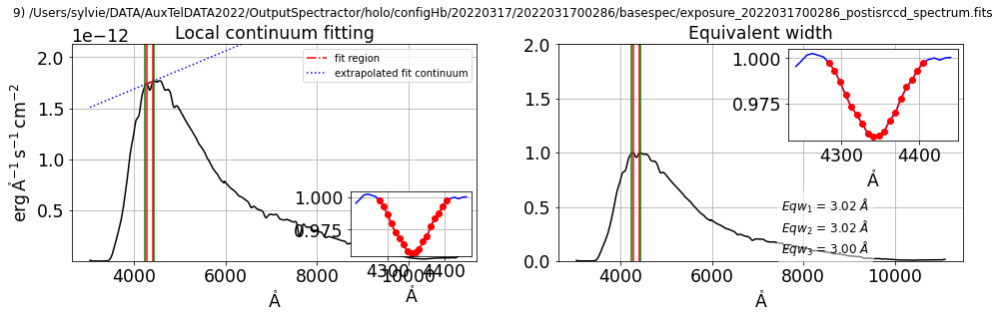

9 ) eqw_hgamma= 3.0001838382662607
set date_obs to 2022-03-18T01:18:45.526
set expo to 20.0
set airmass to 1.18024864471996
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.161506254140246
set dec to -32.3064444444444
set hour_angle to 37.74449227926539
set temperature to 9.0
set pressure to 743.45
set humidity to 53.0
set lambda_ref to 626.2661772674467
set parallactic_angle to 96.54092631927332
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_365 PM_ERR_MINA_365 PM_ERR_ANGLE_365 Z_VALUE_365 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:43:05  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


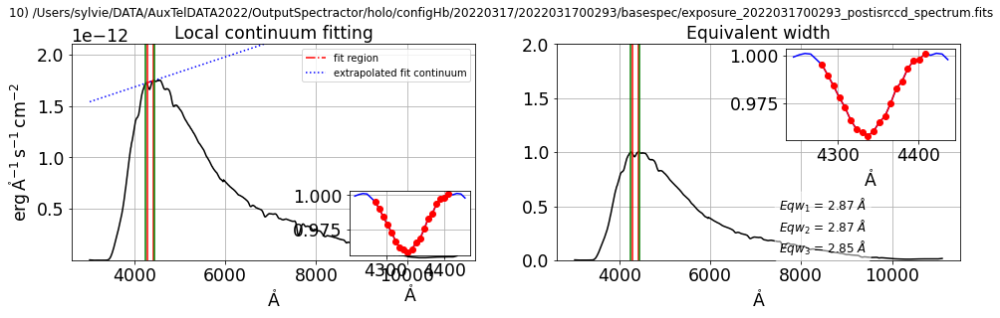

10 ) eqw_hgamma= 2.854102802520709
set date_obs to 2022-03-18T01:22:16.238
set expo to 20.0
set airmass to 1.189962402398665
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1600582040885921
set dec to -32.3064444444444
set hour_angle to 38.6257061937975
set temperature to 8.9
set pressure to 743.4
set humidity to 56.0
set lambda_ref to 626.2915574183227
set parallactic_angle to 96.875483029922
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_366 PM_ERR_MINA_366 PM_ERR_ANGLE_366 Z_VALUE_366 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.110

2022-04-09 19:43:17  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


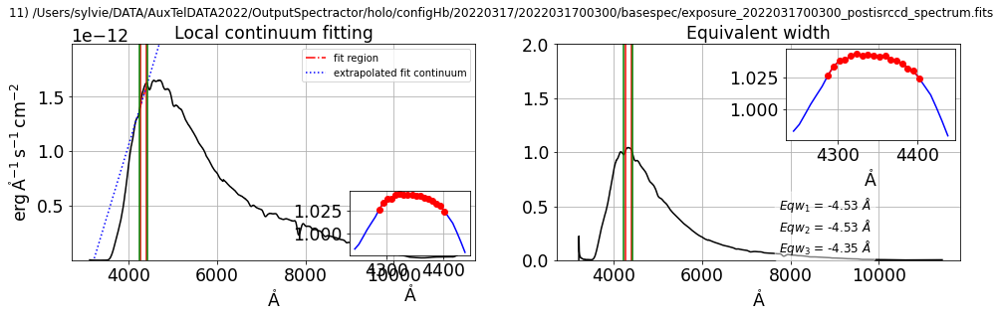

11 ) eqw_hgamma= -4.350683223425811
set date_obs to 2022-03-18T01:22:49.144
set expo to 20.0
set airmass to 1.191505368069865
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1585750124351514
set dec to -32.3064444444444
set hour_angle to 38.76271209839639
set temperature to 9.0
set pressure to 743.45
set humidity to 56.0
set lambda_ref to 626.4868452630084
set parallactic_angle to 96.92724413418016
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_367 PM_ERR_MINA_367 PM_ERR_ANGLE_367 Z_VALUE_367 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           

2022-04-09 19:43:29  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


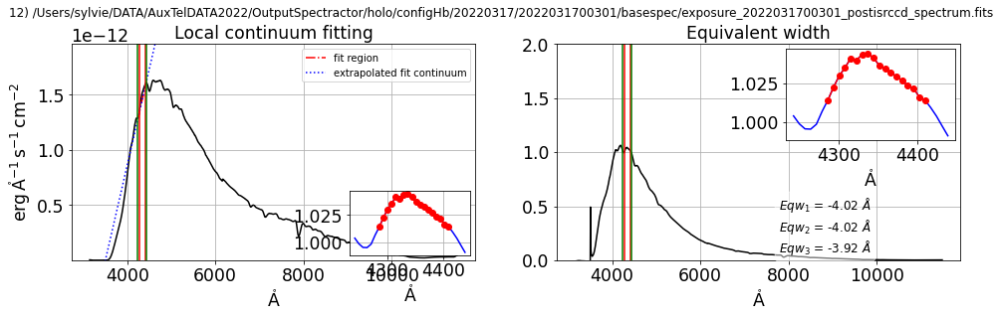

12 ) eqw_hgamma= -3.9169451697543862
set date_obs to 2022-03-18T01:43:57.837
set expo to 20.0
set airmass to 1.25822658979951
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476502374643685
set dec to -32.3064444444444
set hour_angle to 44.06414790775874
set temperature to 8.8
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 626.6251269515418
set parallactic_angle to 98.88882683561982
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_368 PM_ERR_MINA_368 PM_ERR_ANGLE_368 Z_VALUE_368 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           

2022-04-09 19:43:41  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


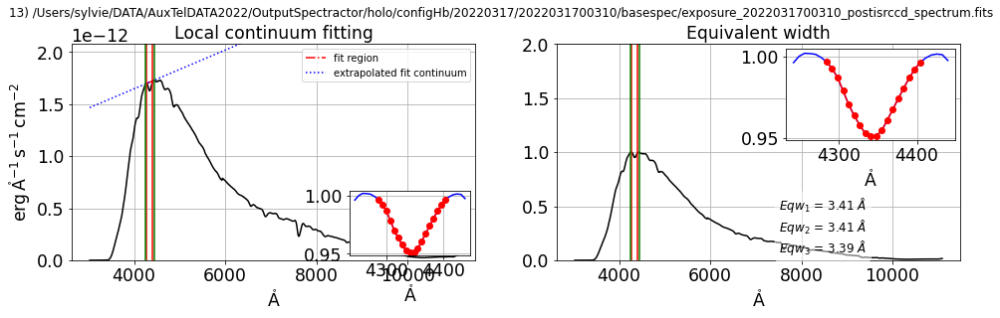

13 ) eqw_hgamma= 3.389562156106924
set date_obs to 2022-03-18T01:46:52.361
set expo to 20.0
set airmass to 1.26858445121286
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1476350630254128
set dec to -32.3064444444444
set hour_angle to 44.79438636254909
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 627.6256863262817
set parallactic_angle to 99.15414320783184
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_369 PM_ERR_MINA_369 PM_ERR_ANGLE_369 Z_VALUE_369 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:43:52  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


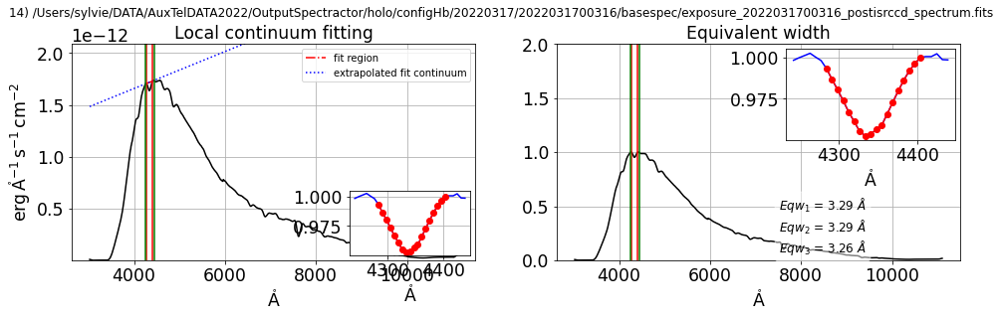

14 ) eqw_hgamma= 3.263482483817086
set date_obs to 2022-03-18T01:47:25.256
set expo to 20.0
set airmass to 1.27056341471374
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1466645118411156
set dec to -32.3064444444444
set hour_angle to 44.9315970155517
set temperature to 8.7
set pressure to 743.55
set humidity to 56.0
set lambda_ref to 625.7408027741238
set parallactic_angle to 99.2038979478238
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_370 PM_ERR_MINA_370 PM_ERR_ANGLE_370 Z_VALUE_370 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:44:04  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


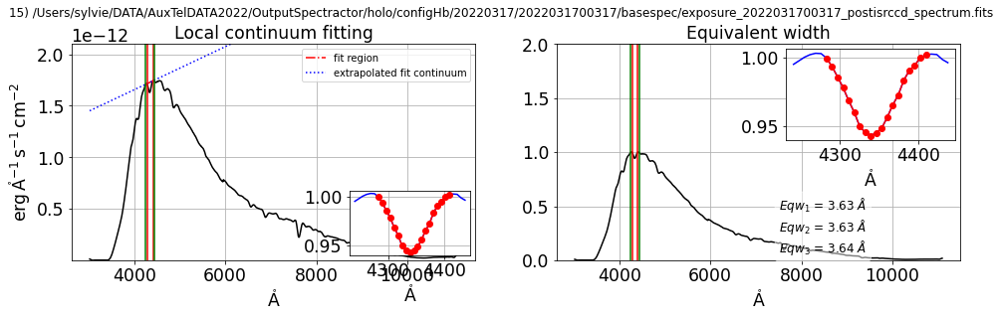

15 ) eqw_hgamma= 3.6355566719995656
set date_obs to 2022-03-18T01:53:46.736
set expo to 20.0
set airmass to 1.294394244363805
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1444547716136137
set dec to -32.3064444444444
set hour_angle to 46.52581667330039
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.9120383005036
set parallactic_angle to 99.77999069166285
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_371 PM_ERR_MINA_371 PM_ERR_ANGLE_371 Z_VALUE_371 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:44:17  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


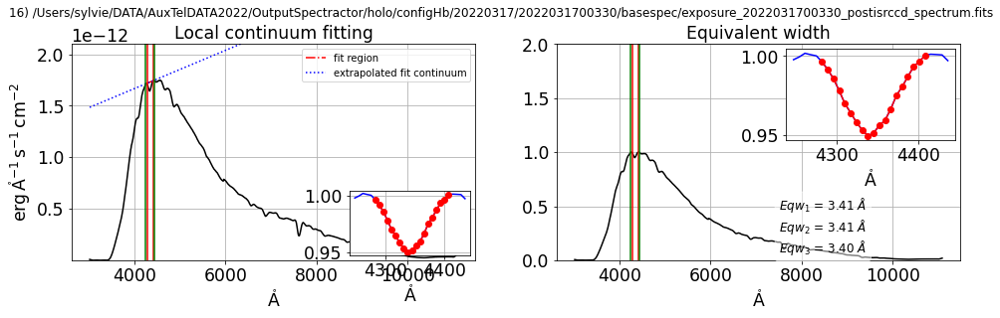

16 ) eqw_hgamma= 3.4031405695077424
set date_obs to 2022-03-18T01:54:19.724
set expo to 20.0
set airmass to 1.29652271576687
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1441648974084375
set dec to -32.3064444444444
set hour_angle to 46.6628171725209
set temperature to 8.6
set pressure to 743.5
set humidity to 56.0
set lambda_ref to 627.7462807078947
set parallactic_angle to 99.82934304254884
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_372 PM_ERR_MINA_372 PM_ERR_ANGLE_372 Z_VALUE_372 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:44:30  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


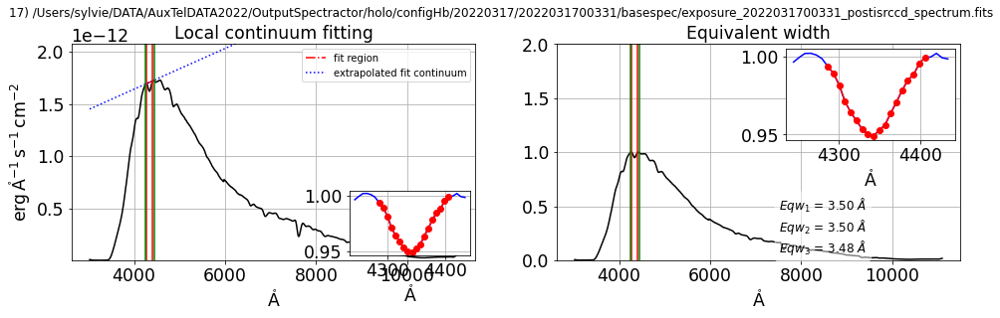

17 ) eqw_hgamma= 3.479544317217058
set date_obs to 2022-03-18T01:57:49.306
set expo to 20.0
set airmass to 1.31035777011874
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1437462230173573
set dec to -32.3064444444444
set hour_angle to 47.53898537176394
set temperature to 8.7
set pressure to 743.45
set humidity to 57.0
set lambda_ref to 628.9551099539515
set parallactic_angle to 100.14447493807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_373 PM_ERR_MINA_373 PM_ERR_ANGLE_373 Z_VALUE_373 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:44:42  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


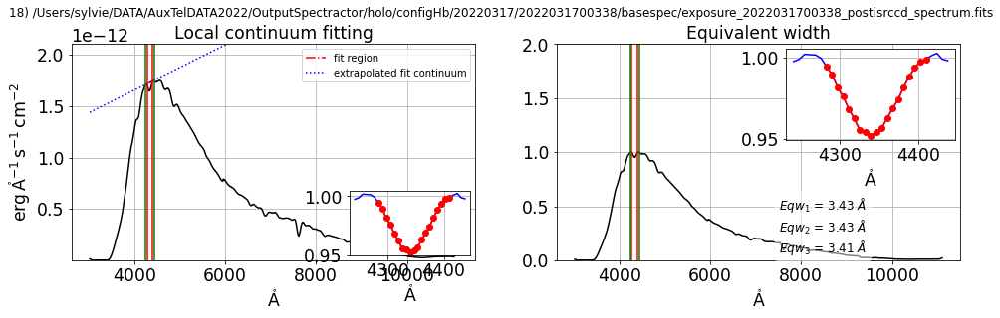

18 ) eqw_hgamma= 3.4087120588585136
set date_obs to 2022-03-18T02:01:19.196
set expo to 20.0
set airmass to 1.324716687989025
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1392710710370809
set dec to -32.3064444444444
set hour_angle to 48.4163008821963
set temperature to 8.6
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 626.8625000130343
set parallactic_angle to 100.4592627484374
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_374 PM_ERR_MINA_374 PM_ERR_ANGLE_374 Z_VALUE_374 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:44:55  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


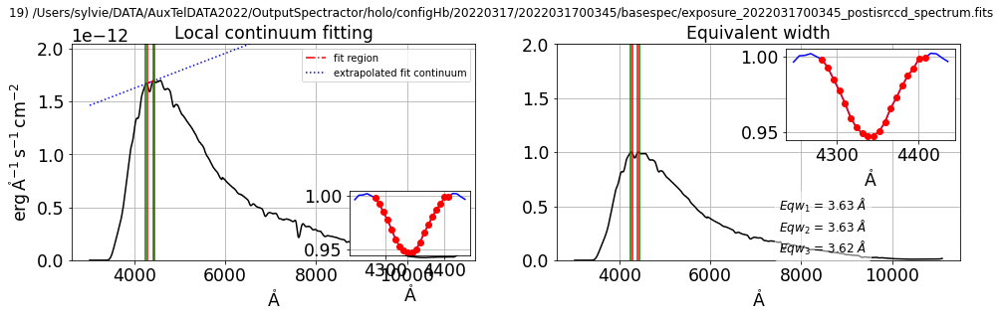

19 ) eqw_hgamma= 3.623324836338434
set date_obs to 2022-03-18T02:04:16.794
set expo to 20.0
set airmass to 1.33727547076682
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1388486262435704
set dec to -32.3064444444444
set hour_angle to 49.15879882143194
set temperature to 8.5
set pressure to 743.45
set humidity to 58.0
set lambda_ref to 628.5424256920012
set parallactic_angle to 100.7251843777299
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_375 PM_ERR_MINA_375 PM_ERR_ANGLE_375 Z_VALUE_375 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:45:07  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


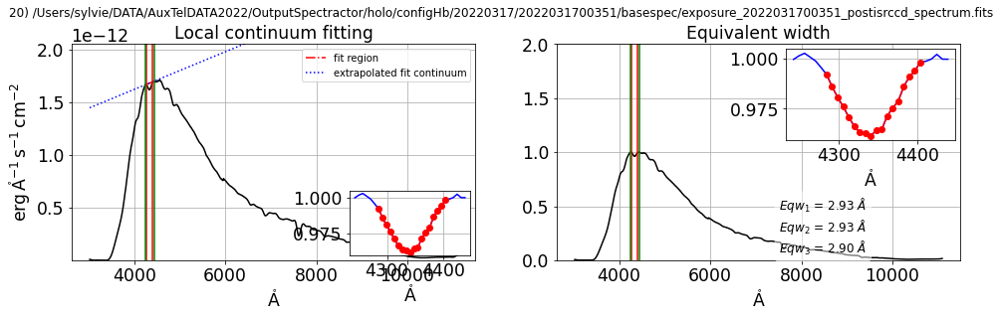

20 ) eqw_hgamma= 2.8965418195133137
set date_obs to 2022-03-18T02:04:49.712
set expo to 20.0
set airmass to 1.33963651479802
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1368681187146323
set dec to -32.3064444444444
set hour_angle to 49.29580448438519
set temperature to 8.5
set pressure to 743.35
set humidity to 58.0
set lambda_ref to 628.2086674961155
set parallactic_angle to 100.7742095756281
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_376 PM_ERR_MINA_376 PM_ERR_ANGLE_376 Z_VALUE_376 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:45:20  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


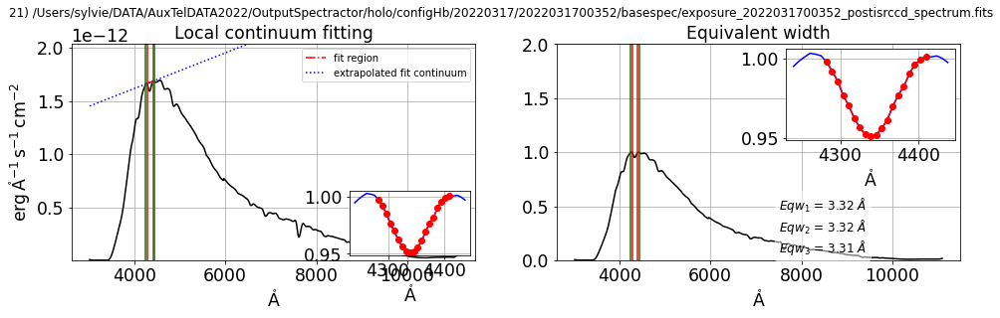

21 ) eqw_hgamma= 3.3124765722988263
set date_obs to 2022-03-18T02:07:49.074
set expo to 20.0
set airmass to 1.352787300037425
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1331931685876357
set dec to -32.3064444444444
set hour_angle to 50.04587365708529
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 627.9591693143808
set parallactic_angle to 101.0424069948098
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_377 PM_ERR_MINA_377 PM_ERR_ANGLE_377 Z_VALUE_377 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:45:32  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


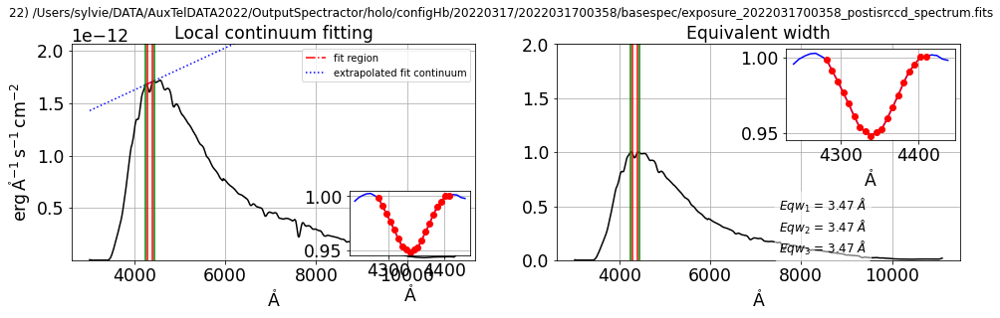

22 ) eqw_hgamma= 3.4651728869965535
set date_obs to 2022-03-18T02:11:20.051
set expo to 20.0
set airmass to 1.368765631503195
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1336440841342464
set dec to -32.3064444444444
set hour_angle to 50.92719907664954
set temperature to 8.4
set pressure to 743.4
set humidity to 59.0
set lambda_ref to 622.7051672626101
set parallactic_angle to 101.357174452077
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_378 PM_ERR_MINA_378 PM_ERR_ANGLE_378 Z_VALUE_378 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:45:44  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


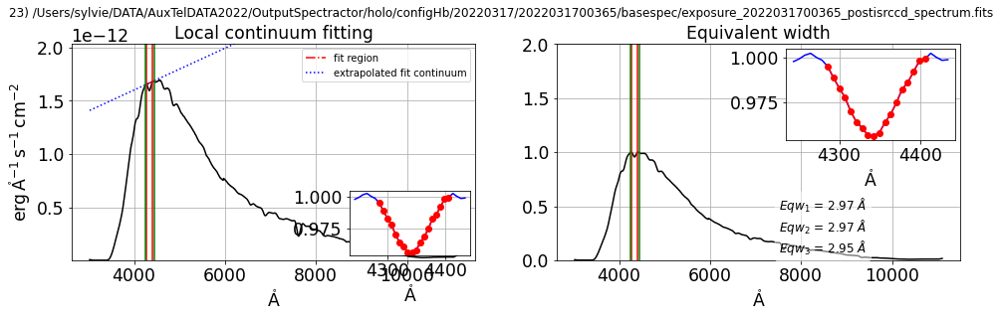

23 ) eqw_hgamma= 2.9507268270919917
set date_obs to 2022-03-18T02:11:53.006
set expo to 20.0
set airmass to 1.371319339871885
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1369079175197151
set dec to -32.3064444444444
set hour_angle to 51.06504024257939
set temperature to 8.4
set pressure to 743.45
set humidity to 59.0
set lambda_ref to 629.1845159477502
set parallactic_angle to 101.4063764649771
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_379 PM_ERR_MINA_379 PM_ERR_ANGLE_379 Z_VALUE_379 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           

2022-04-09 19:45:56  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


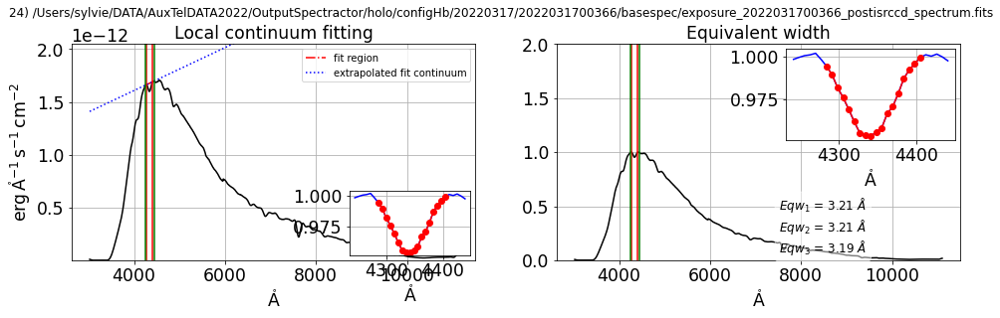

24 ) eqw_hgamma= 3.1867726798586933
set date_obs to 2022-03-18T02:14:46.798
set expo to 20.0
set airmass to 1.38501167017706
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1310814762516916
set dec to -32.3064444444444
set hour_angle to 51.79156958975715
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.5245232921197
set parallactic_angle to 101.6656129875546
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_380 PM_ERR_MINA_380 PM_ERR_ANGLE_380 Z_VALUE_380 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:46:09  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


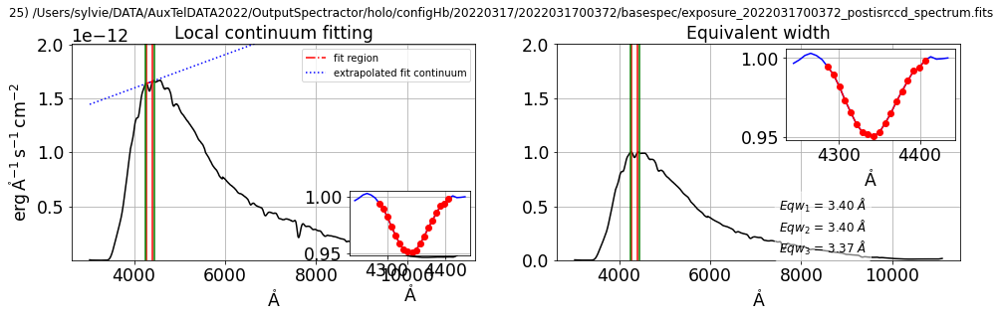

25 ) eqw_hgamma= 3.371384752759475
set date_obs to 2022-03-18T02:15:19.743
set expo to 20.0
set airmass to 1.387649936190795
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1317245037126307
set dec to -32.3064444444444
set hour_angle to 51.92878009828319
set temperature to 8.4
set pressure to 743.45
set humidity to 61.0
set lambda_ref to 627.9968889639981
set parallactic_angle to 101.7145568247823
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_381 PM_ERR_MINA_381 PM_ERR_ANGLE_381 Z_VALUE_381 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:46:22  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


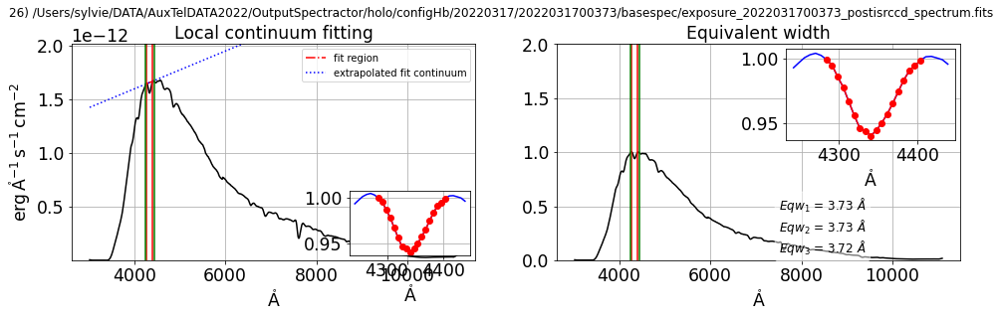

26 ) eqw_hgamma= 3.7191666664574483
set date_obs to 2022-03-18T02:33:33.012
set expo to 20.0
set airmass to 1.48452422171666
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1197628273916148
set dec to -32.3064444444444
set hour_angle to 56.49902324990354
set temperature to 8.0
set pressure to 743.35
set humidity to 63.0
set lambda_ref to 628.5888123380201
set parallactic_angle to 103.3450343494105
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_382 PM_ERR_MINA_382 PM_ERR_ANGLE_382 Z_VALUE_382 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:46:35  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


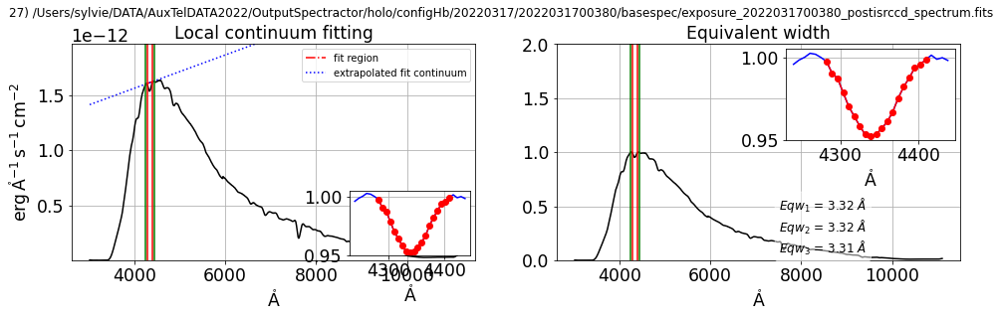

27 ) eqw_hgamma= 3.3094224601127626
set date_obs to 2022-03-18T02:36:30.874
set expo to 20.0
set airmass to 1.50213593383469
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1172584274998106
set dec to -32.3064444444444
set hour_angle to 57.24247377715349
set temperature to 8.1
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 633.8101508297243
set parallactic_angle to 103.6108187575918
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_383 PM_ERR_MINA_383 PM_ERR_ANGLE_383 Z_VALUE_383 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:46:48  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


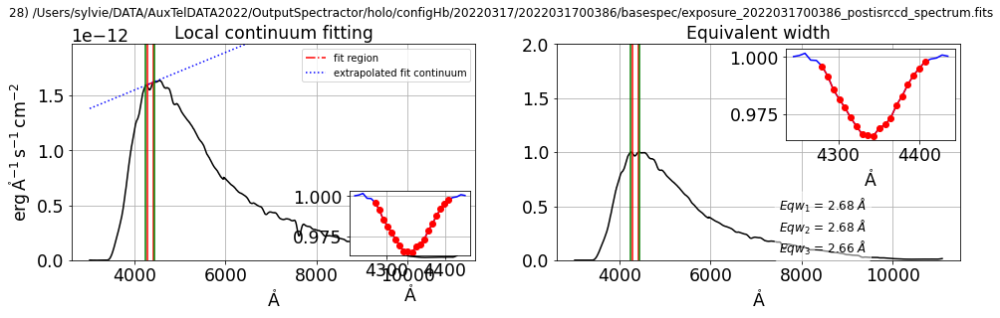

28 ) eqw_hgamma= 2.658050020868724
set date_obs to 2022-03-18T02:37:03.815
set expo to 20.0
set airmass to 1.50545657928364
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1211335036558286
set dec to -32.3064444444444
set hour_angle to 57.37947904087095
set temperature to 8.1
set pressure to 743.35
set humidity to 64.0
set lambda_ref to 628.2172036981787
set parallactic_angle to 103.6598297048832
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_384 PM_ERR_MINA_384 PM_ERR_ANGLE_384 Z_VALUE_384 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.

2022-04-09 19:47:01  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


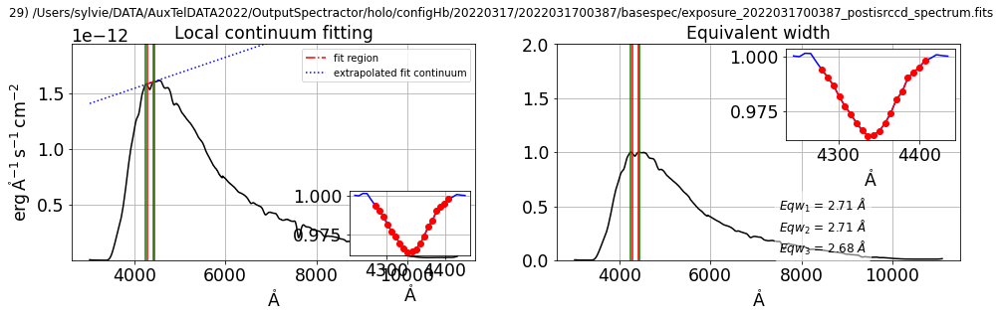

29 ) eqw_hgamma= 2.6811750040386912
set date_obs to 2022-03-18T02:40:00.839
set expo to 20.0
set airmass to 1.523657512515415
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1177429780701742
set dec to -32.3064444444444
set hour_angle to 58.11949120092164
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.3577400172557
set parallactic_angle to 103.9247454603291
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_385 PM_ERR_MINA_385 PM_ERR_ANGLE_385 Z_VALUE_385 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:47:14  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


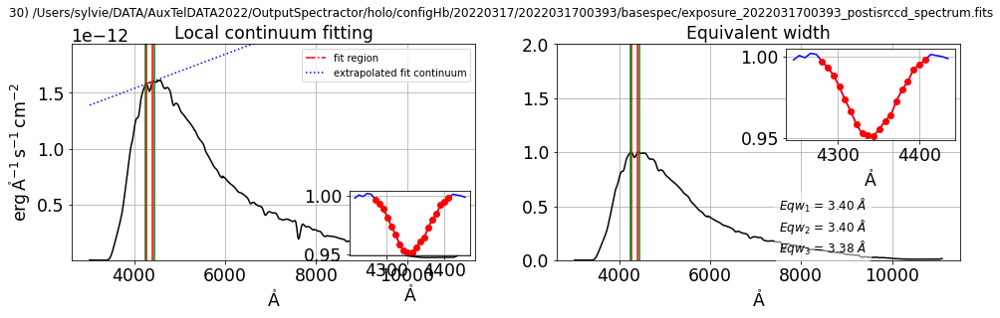

30 ) eqw_hgamma= 3.38361413619745
set date_obs to 2022-03-18T02:40:33.787
set expo to 20.0
set airmass to 1.527114954027915
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1169167488860146
set dec to -32.3064444444444
set hour_angle to 58.25733391386269
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 628.7847433714671
set parallactic_angle to 103.9741296646409
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_386 PM_ERR_MINA_386 PM_ERR_ANGLE_386 Z_VALUE_386 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.1

2022-04-09 19:47:27  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


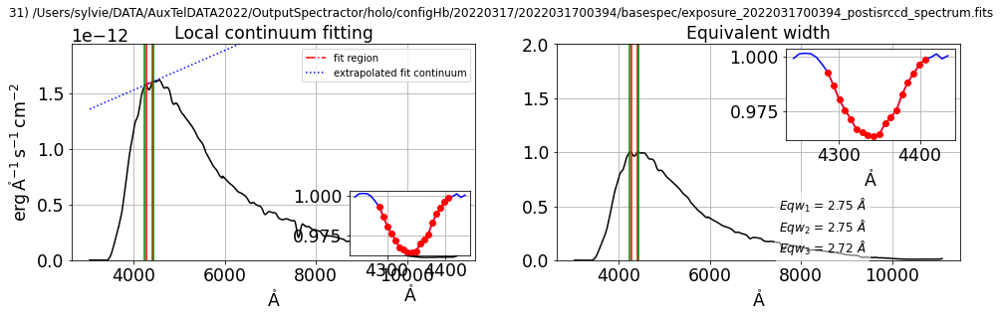

31 ) eqw_hgamma= 2.7182921145358914
set date_obs to 2022-03-18T02:44:05.105
set expo to 20.0
set airmass to 1.54976447202586
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1144055844584487
set dec to -32.3064444444444
set hour_angle to 59.14046723526914
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 629.2826348266267
set parallactic_angle to 104.2908413745483
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_387 PM_ERR_MINA_387 PM_ERR_ANGLE_387 Z_VALUE_387 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:47:40  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


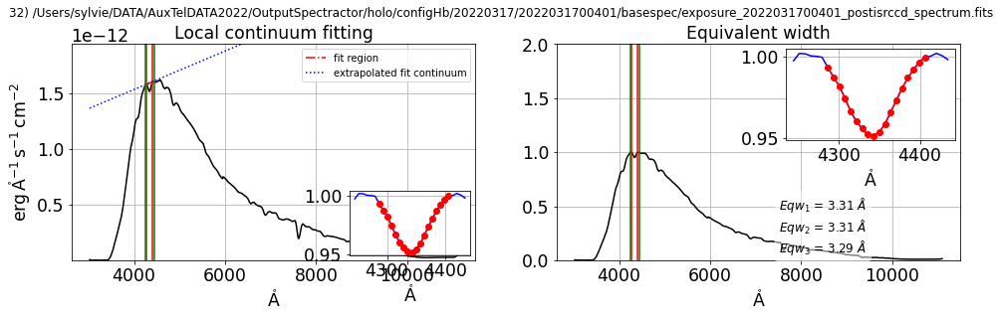

32 ) eqw_hgamma= 3.2868105495424653
set date_obs to 2022-03-18T02:47:02.835
set expo to 20.0
set airmass to 1.56951976624838
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.113192412444726
set dec to -32.3064444444444
set hour_angle to 59.88301895711849
set temperature to 8.0
set pressure to 743.4
set humidity to 64.0
set lambda_ref to 623.392411114623
set parallactic_angle to 104.5576025273592
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_388 PM_ERR_MINA_388 PM_ERR_ANGLE_388 Z_VALUE_388 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:47:52  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


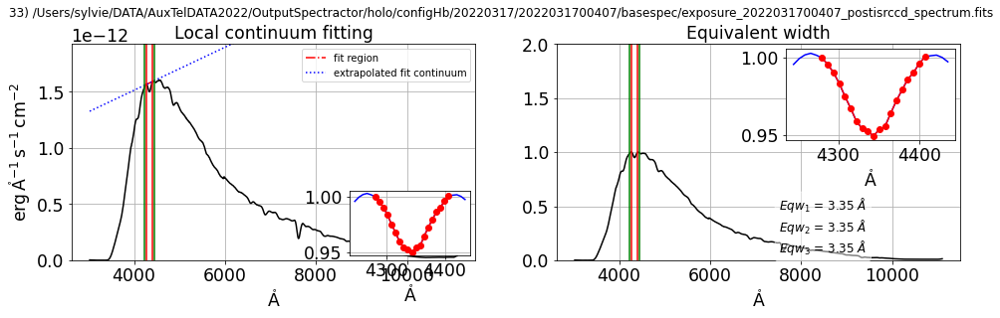

33 ) eqw_hgamma= 3.3491935005698097
set date_obs to 2022-03-18T02:47:35.769
set expo to 20.0
set airmass to 1.573248011911855
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1127873058479127
set dec to -32.3064444444444
set hour_angle to 60.02106934614464
set temperature to 8.0
set pressure to 743.45
set humidity to 64.0
set lambda_ref to 624.3168639615992
set parallactic_angle to 104.6072480488688
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_389 PM_ERR_MINA_389 PM_ERR_ANGLE_389 Z_VALUE_389 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           

2022-04-09 19:48:06  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


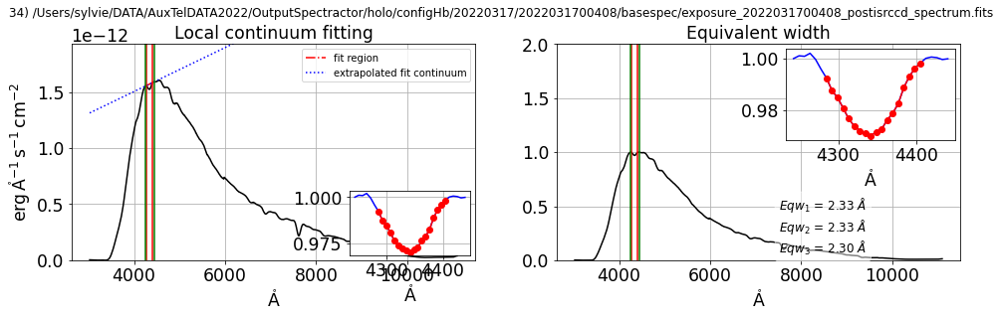

34 ) eqw_hgamma= 2.301199447715983
set date_obs to 2022-03-18T02:50:38.306
set expo to 20.0
set airmass to 1.594345273370295
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.1038057563272595
set dec to -32.3064444444444
set hour_angle to 60.78322641711044
set temperature to 8.0
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 625.6140852852044
set parallactic_angle to 104.8816435668321
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_390 PM_ERR_MINA_390 PM_ERR_ANGLE_390 Z_VALUE_390 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:48:19  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


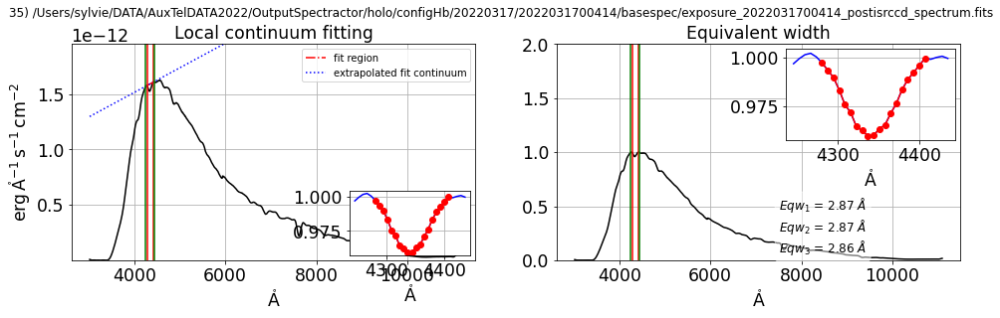

35 ) eqw_hgamma= 2.85839831931023
set date_obs to 2022-03-18T03:08:41.573
set expo to 20.0
set airmass to 1.73594131895663
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09058150608401207
set dec to -32.3064444444444
set hour_angle to 65.3119392087705
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 631.9889212287092
set parallactic_angle to 106.5252810168807
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_391 PM_ERR_MINA_391 PM_ERR_ANGLE_391 Z_VALUE_391 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0.11

2022-04-09 19:48:32  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


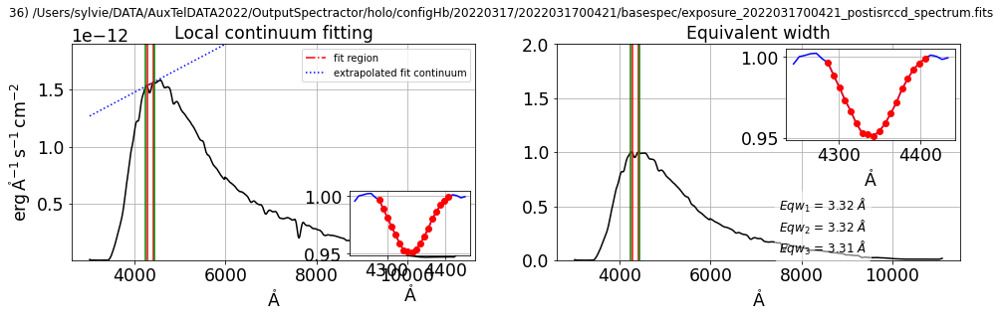

36 ) eqw_hgamma= 3.310271750082978
set date_obs to 2022-03-18T03:09:14.484
set expo to 20.0
set airmass to 1.740715384660955
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09733707671582016
set dec to -32.3064444444444
set hour_angle to 65.44894264967655
set temperature to 7.7
set pressure to 743.5
set humidity to 63.0
set lambda_ref to 625.9596270530473
set parallactic_angle to 106.5754178018598
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_392 PM_ERR_MINA_392 PM_ERR_ANGLE_392 Z_VALUE_392 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:48:45  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


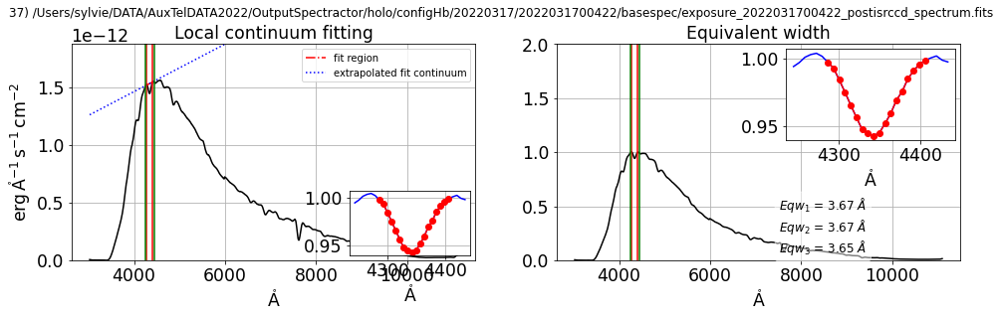

37 ) eqw_hgamma= 3.653783834084924
set date_obs to 2022-03-18T03:12:54.310
set expo to 20.0
set airmass to 2.129245852899135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.143944791309082
set dec to -87.4721944444444
set hour_angle to -155.5929780702915
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 686.0625390317258
set parallactic_angle to -156.1678055894986
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_393 PM_ERR_MINA_393 PM_ERR_ANGLE_393 Z_VALUE_393 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
HD 185975 20 28 18.7398 -87 28 19.937      14       14 ...           0.017         

2022-04-09 19:48:59  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


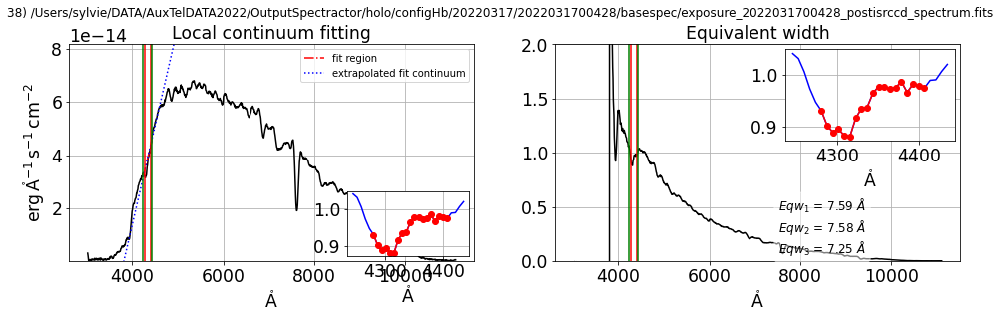

38 ) eqw_hgamma= 7.250537177580234
set date_obs to 2022-03-18T03:13:27.208
set expo to 20.0
set airmass to 2.1290679262036
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09887590360164929
set dec to -87.4721944444444
set hour_angle to -155.455137691263
set temperature to 7.8
set pressure to 743.5
set humidity to 62.0
set lambda_ref to 636.4362643500099
set parallactic_angle to -156.0330469936088
target_name = HD185975, Selected object name for Simbad : HD185975
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_394 PM_ERR_MINA_394 PM_ERR_ANGLE_394 Z_VALUE_394 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
HD 185975 20 28 18.7398 -87 28 19.937      14       14 ...           0.017          

2022-04-09 19:49:12  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


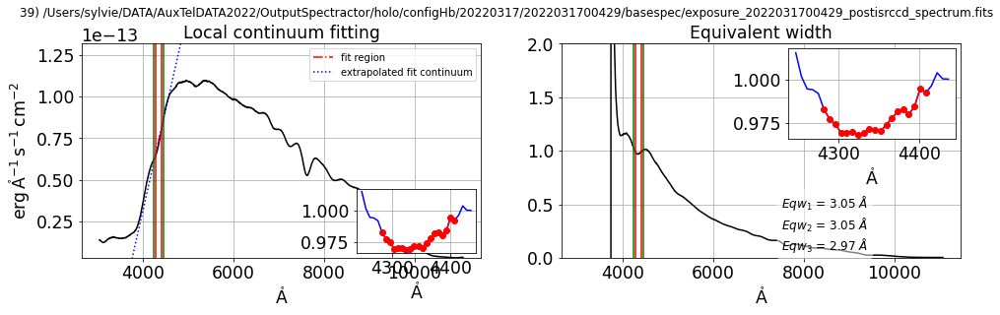

39 ) eqw_hgamma= 2.9668321372851234
set date_obs to 2022-03-18T03:17:06.794
set expo to 20.0
set airmass to 1.81309435755974
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.09210139501009447
set dec to -32.3064444444444
set hour_angle to 67.42354300312304
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 626.8738274489511
set parallactic_angle to 107.3011935159837
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_395 PM_ERR_MINA_395 PM_ERR_ANGLE_395 Z_VALUE_395 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           

2022-04-09 19:49:26  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


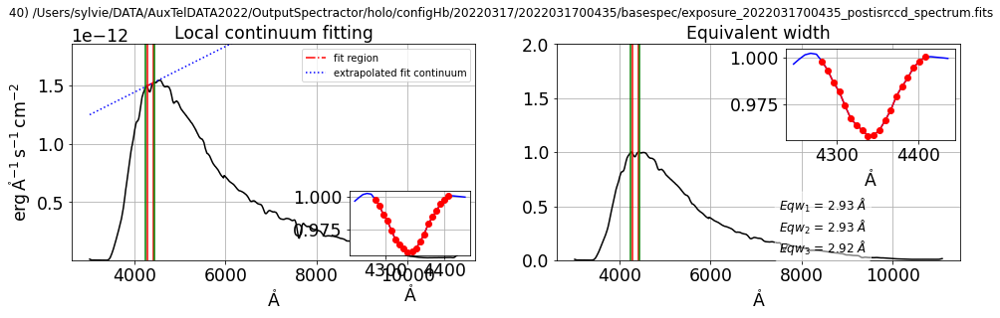

40 ) eqw_hgamma= 2.9181938289890716
set date_obs to 2022-03-18T03:17:39.779
set expo to 20.0
set airmass to 1.818418067455135
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.08344429603447075
set dec to -32.3064444444444
set hour_angle to 67.56159248336594
set temperature to 7.7
set pressure to 743.4
set humidity to 63.0
set lambda_ref to 632.4252252976918
set parallactic_angle to 107.3521665962106
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_396 PM_ERR_MINA_396 PM_ERR_ANGLE_396 Z_VALUE_396 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           

2022-04-09 19:49:39  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


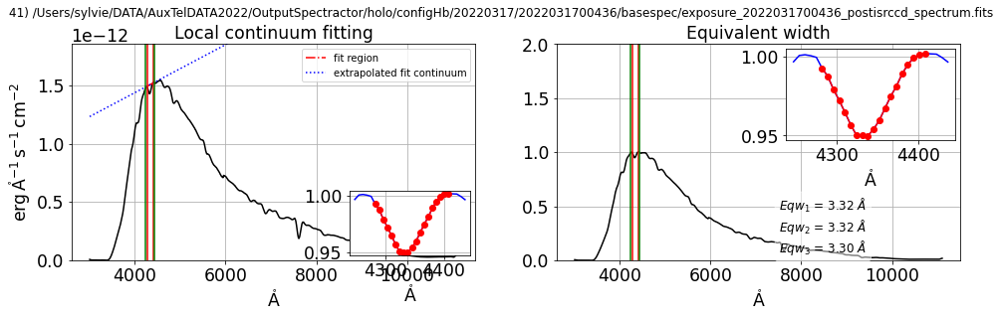

41 ) eqw_hgamma= 3.3000314794808507
set date_obs to 2022-03-18T03:21:26.873
set expo to 20.0
set airmass to 1.856070090955285
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.06347269052355019
set dec to -32.3064444444444
set hour_angle to 68.51099093135984
set temperature to 7.8
set pressure to 743.4
set humidity to 62.0
set lambda_ref to 630.0633085655397
set parallactic_angle to 107.7035936917225
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_397 PM_ERR_MINA_397 PM_ERR_ANGLE_397 Z_VALUE_397 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           

2022-04-09 19:49:53  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


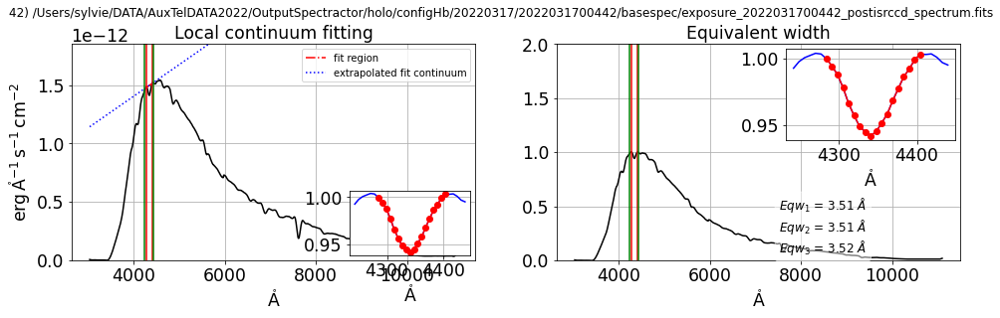

42 ) eqw_hgamma= 3.523917869934835
set date_obs to 2022-03-18T03:21:59.878
set expo to 20.0
set airmass to 1.861691550345225
set disperser_label to holo4_003
set units to erg/s/cm$^2$/nm
set rotation_angle to 0.0769189759908508
set dec to -32.3064444444444
set hour_angle to 68.64883074724754
set temperature to 7.7
set pressure to 743.45
set humidity to 63.0
set lambda_ref to 633.3015467495994
set parallactic_angle to 107.7547458765076
target_name = mu.col, Selected object name for Simbad : mu. Col
 MAIN_ID        RA           DEC      RA_PREC DEC_PREC ... PM_ERR_MAJA_398 PM_ERR_MINA_398 PM_ERR_ANGLE_398 Z_VALUE_398 SCRIPT_NUMBER_ID
             "h:m:s"       "d:m:s"                     ...     mas / yr        mas / yr          deg                                    
--------- ------------- ------------- ------- -------- ... --------------- --------------- ---------------- ----------- ----------------
* mu. Col 05 45 59.8950 -32 18 23.162      14       14 ...           0.095           0

2022-04-09 19:50:06  astroquery _showwarning         WARNING Model is linear in parameters; consider using linear fitting methods.


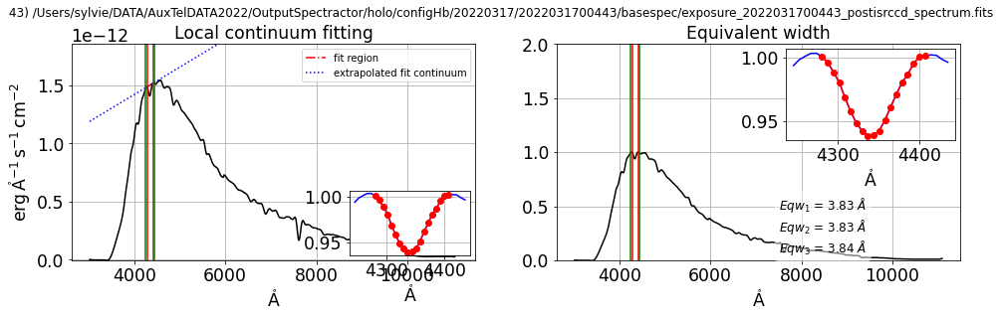

43 ) eqw_hgamma= 3.836778541734415


In [127]:
WLMIN=300
WLMAX=1000
lambdas = np.arange(WLMIN,WLMAX,1)
fwhm_func = interp1d(lambdas, 0.01 * lambdas)
parameters.DISPLAY=False


for IDXSEL in np.arange(0,NN):
    filename_SEL=all_good_spectra_spectrum_files[IDXSEL]
    filename_spectrogram_SEL=filename_SEL.replace("_spectrum","_spectrogram")
    fullfilename_SEL = os.path.join(dir_spectra,filename_SEL)
    fullfilename_spectrogram_SEL = fullfilename_SEL.replace("_spectrum","_spectrogram")
    
    # load the spectrum
    s=Spectrum(fullfilename_SEL, config=config)
    s.load_spectrogram(fullfilename_spectrogram_SEL) 
    
    
    lamb = 10*s.lambdas * u.AA 
    flux = s.data * u.Unit('erg cm-2 s-1 AA-1')/10 
    spec = Spectrum1D(spectral_axis=lamb, flux=flux) 
    fluxerr = s.err * u.Unit('erg cm-2 s-1 AA-1')/10. 
    specerr = Spectrum1D(spectral_axis=lamb, flux=fluxerr)
    
    # H2O line
    
    #wlmin=10*(H2O_1.wavelength-30)*u.AA
    #wlmax=10*(H2O_2.wavelength+30)*u.AA
    #wlminline=10*(H2O_1.wavelength-12)*u.AA
    #wlmaxline=10*(H2O_2.wavelength+10)*u.AA
    
    wlmin = wlmin_hgamma
    wlmax = wlmax_hgamma
    wlminline = wlminline_hgamma
    wlmaxline = wlmaxline_hgamma
    
    
    fig=plt.figure(figsize=(16,4))
    ax1 = fig.add_subplot(1, 2, 1)
    ax2 = fig.add_subplot(1, 2, 2)
    #eqw1,eqw2=ComputeEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    eqw1,eqw2,eqw3=ComputeMyEquivWidth(spec,wlmin,wlmax,wlminline,wlmaxline,flag_plot=True,ax1=ax1,ax2=ax2)
    #eqw10,eqw20,eq1_set,eq2_set=ComputeEquivWidth_bootstrap(spec,specerr,wlmin,wlmax,wlminline,wlmaxline,NN=20,flag_plot=True,ax1=ax1,ax2=ax2)
    thetitle=str(IDXSEL)+") "+filename_SEL
    plt.suptitle(thetitle,y=1.01)
    plt.show() 
    
    print(IDXSEL,") eqw_hgamma=",eqw3)
    
    df_infos.at[IDXSEL,"eqw_hgamma"] =  eqw3


# add equivalent width error

In [128]:
df_infos["eqw_h2o_err"] = eqw_h2o_err
df_infos["eqw_h2o_2_err"] = eqw_h2o_2_err
df_infos["eqw_h2o_3_err"] = eqw_h2o_3_err
df_infos["eqw_o2_err"] = eqw_o2_err
df_infos["eqw_o2b_err"] = eqw_o2b_err
df_infos["eqw_halpha_err"] = eqw_halpha_err
df_infos["eqw_hbeta_err"] = eqw_hbeta_err
df_infos["eqw_hgamma_err"] = eqw_hgamma_err

### Info on equivalent width summary

In [129]:
df_infos

,num,object,date_obs,airmass,temperature,pressure,humidity,reftime,eqw_h2o,eqw_h2o_2,...,eqw_hbeta,eqw_hgamma,eqw_h2o_err,eqw_h2o_2_err,eqw_h2o_3_err,eqw_o2_err,eqw_o2b_err,eqw_halpha_err,eqw_hbeta_err,eqw_hgamma_err
idx,,,,,,,,,,,,,,,,,,,,,
0,00238,mu. Col,2022-03-18T00:51:22.049,1.115575,8.9,743.45,48.0,0.000000,123.484478,8.800509,...,2.033181,3.503225,0.867574,0.132206,0.183609,0.073477,0.055829,0.060604,0.033767,0.049224
1,00244,mu. Col,2022-03-18T00:54:16.312,1.121577,8.9,743.45,49.0,0.048406,128.921038,8.847538,...,2.082311,3.606314,0.867574,0.132206,0.183609,0.073477,0.055829,0.060604,0.033767,0.049224
2,00245,mu. Col,2022-03-18T00:54:49.235,1.122727,8.8,743.40,49.0,0.057552,119.048378,8.736368,...,1.918250,3.175584,0.867574,0.132206,0.183609,0.073477,0.055829,0.060604,0.033767,0.049224
3,00251,mu. Col,2022-03-18T00:57:47.565,1.129107,8.9,743.40,50.0,0.107088,131.327724,-11.197552,...,-2.914306,-3.373072,0.867574,0.132206,0.183609,0.073477,0.055829,0.060604,0.033767,0.049224
4,00252,mu. Col,2022-03-18T00:58:20.709,1.130309,8.9,743.40,50.0,0.116294,120.235363,8.596751,...,1.774554,3.323599,0.867574,0.132206,0.183609,0.073477,0.055829,0.060604,0.033767,0.049224
5,00265,mu. Col,2022-03-18T01:04:49.716,1.145030,8.9,743.30,53.0,0.224352,125.620156,8.981148,...,1.829460,3.067518,0.867574,0.132206,0.183609,0.073477,0.055829,0.060604,0.033767,0.049224
6,00272,mu. Col,2022-03-18T01:08:18.080,1.153339,8.9,743.30,51.0,0.282231,116.998744,9.027777,...,1.716350,3.421513,0.867574,0.132206,0.183609,0.073477,0.055829,0.060604,0.033767,0.049224
7,00273,mu. Col,2022-03-18T01:08:50.992,1.154683,8.9,743.35,51.0,0.291373,118.299480,9.336137,...,2.047368,3.367458,0.867574,0.132206,0.183609,0.073477,0.055829,0.060604,0.033767,0.049224
8,00279,mu. Col,2022-03-18T01:11:46.031,1.161939,8.9,743.40,53.0,0.339995,111.361090,9.179091,...,2.043066,3.121306,0.867574,0.132206,0.183609,0.073477,0.055829,0.060604,0.033767,0.049224


In [130]:
summary_file = f"equivwidth_{DATE}_{configdir}.csv"
df_infos.to_csv(summary_file)

Text(0.5, 1.0, 'Equivalent Widths vs date')

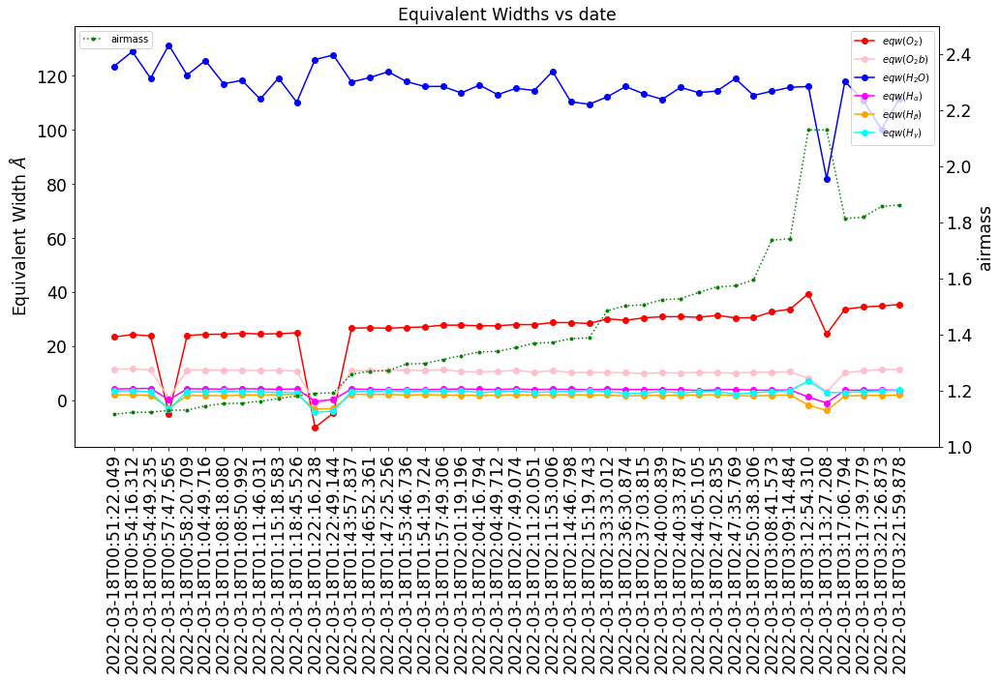

In [131]:
fig=plt.figure(figsize=(16,8))
#plt.xticks(rotation=90)
ax = fig.add_subplot(1, 1, 1)
ax.plot(df_infos['date_obs'], df_infos['eqw_o2'],marker="o",color="red",label="$eqw(O_2)$");
ax.plot(df_infos['date_obs'], df_infos['eqw_o2b'],marker="o",color="pink",label="$eqw(O_2b)$");
ax.plot(df_infos['date_obs'], df_infos['eqw_h2o'],marker="o",color="blue",label="$eqw(H_2O)$");
ax.plot(df_infos['date_obs'], df_infos['eqw_halpha'],marker="o",color="magenta",label="$eqw(H_{\\alpha})$");
ax.plot(df_infos['date_obs'], df_infos['eqw_hbeta'],marker="o",color="orange",label="$eqw(H_{\\beta})$");
ax.plot(df_infos['date_obs'], df_infos['eqw_hgamma'],marker="o",color="cyan",label="$eqw(H_{\\gamma})$");
#ax.set_xticks(rotation='vertical');
ax.xaxis.set_tick_params(rotation=90)
ax.legend(loc="upper right")
ax.set_ylabel("Equivalent Width $\AA$")
ax2 = ax.twinx()
ax2.plot(df_infos['date_obs'], df_infos['airmass'],linestyle='dotted', marker='.',color="green",label="airmass")
ax2.set_ylim(1,2.5)
ax2.legend(loc="upper left")
ax2.set_ylabel("airmass")
ax.set_title("Equivalent Widths vs date")

Text(0.5, 1.0, 'Equivalent Widths vs date')

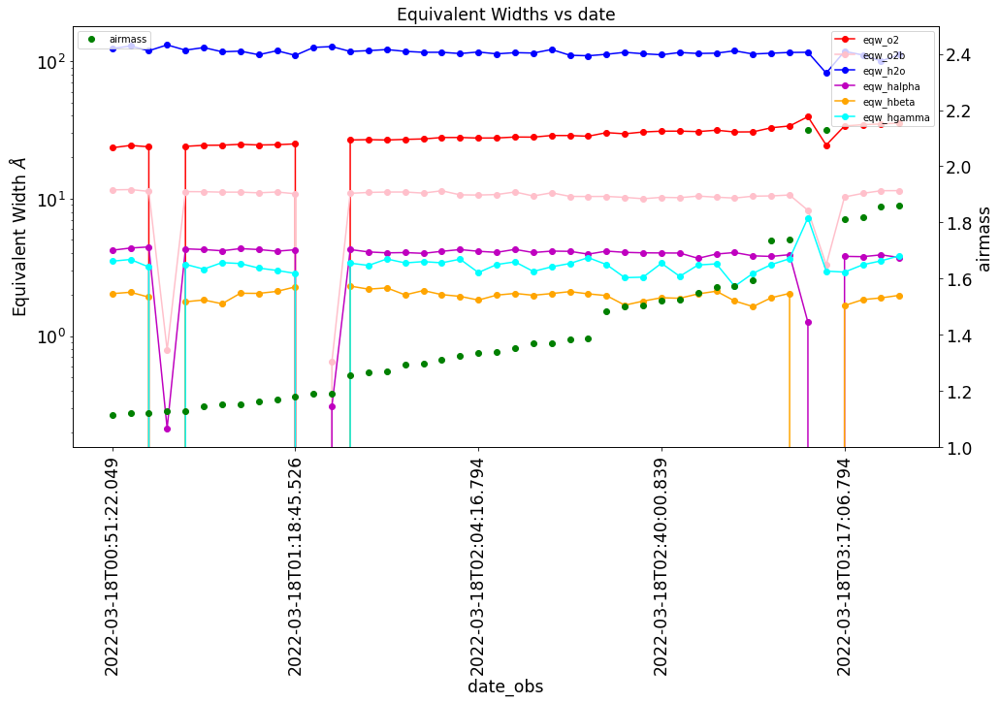

In [132]:
fig=plt.figure(figsize=(16,8))
#plt.xticks(rotation=90)
ax = fig.add_subplot(1, 1, 1)
df_infos.plot(ax=ax,x="date_obs", y=["eqw_o2","eqw_o2b","eqw_h2o","eqw_halpha","eqw_hbeta","eqw_hgamma"],color=["r","pink","b","m","orange","cyan"],marker="o");
#plt.gcf().autofmt_xdate(rotation=90) 
ax.xaxis.set_tick_params(rotation=90)
ax.legend(loc="upper right")
ax.set_ylabel("Equivalent Width $\AA$")
ax.set_yscale("log")

ax2 = ax.twinx()
df_infos.plot(ax=ax2,x="date_obs", y="airmass",color=["g"],marker="o",lw=0);
ax2.legend(loc="upper left")
ax2.set_ylabel("airmass")
ax2.set_ylim(1,2.5)
ax2.xaxis.set_tick_params(rotation=90)
ax.set_title("Equivalent Widths vs date")



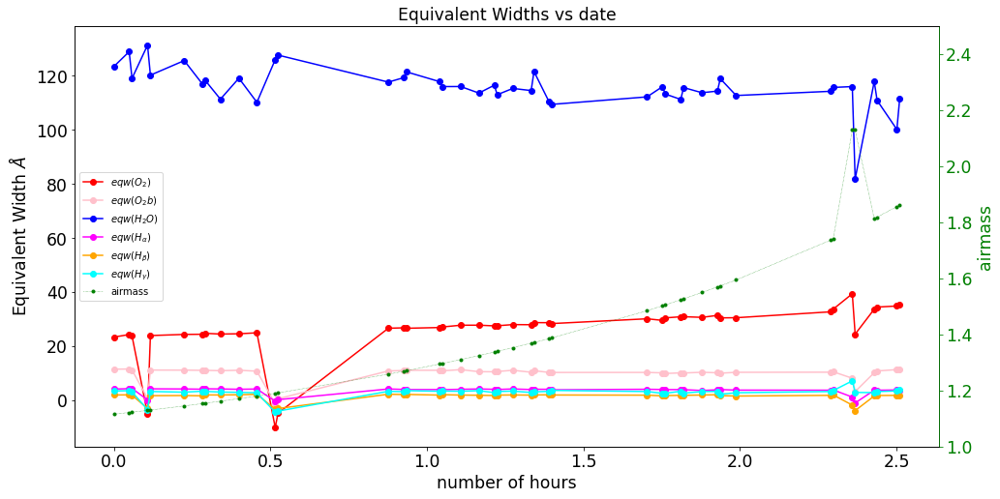

In [133]:
fig=plt.figure(figsize=(16,8))
#plt.xticks(rotation=90)
ax = fig.add_subplot(1, 1, 1)
p1, = ax.plot(df_infos['reftime'], df_infos['eqw_o2'],marker="o",color="red",label="$eqw(O_2)$");
p11, = ax.plot(df_infos['reftime'], df_infos['eqw_o2b'],marker="o",color="pink",label="$eqw(O_2b)$");
p2, = ax.plot(df_infos['reftime'], df_infos['eqw_h2o'],marker="o",color="blue",label="$eqw(H_2O)$");
p3, = ax.plot(df_infos['reftime'], df_infos['eqw_halpha'],marker="o",color="magenta",label="$eqw(H_{\\alpha})$");
p4, = ax.plot(df_infos['reftime'], df_infos['eqw_hbeta'],marker="o",color="orange",label="$eqw(H_{\\beta})$");
p5, = ax.plot(df_infos['reftime'], df_infos['eqw_hgamma'],marker="o",color="cyan",label="$eqw(H_{\\gamma})$");
#ax.set_xticks(rotation='vertical');
#ax.xaxis.set_tick_params(rotation=90)
ax.set_xlabel("number of hours")

ax.set_ylabel("Equivalent Width $\AA$")
ax2 = ax.twinx()
p6, = ax2.plot(df_infos['reftime'], df_infos['airmass'],linestyle='dotted', marker='.',color="green",label="airmass",lw=0.5)
ax2.set_ylim(1,2.5)

ax2.set_ylabel("airmass")
ax.set_title("Equivalent Widths vs date")

curves = [p1, p11,p2, p3, p4,p5,p6]
ax.legend(curves, [c.get_label() for c in curves])
ax2.yaxis.label.set_color(p6.get_color())
ax2.spines["right"].set_edgecolor(p6.get_color())
ax2.tick_params(axis='y', colors=p6.get_color())

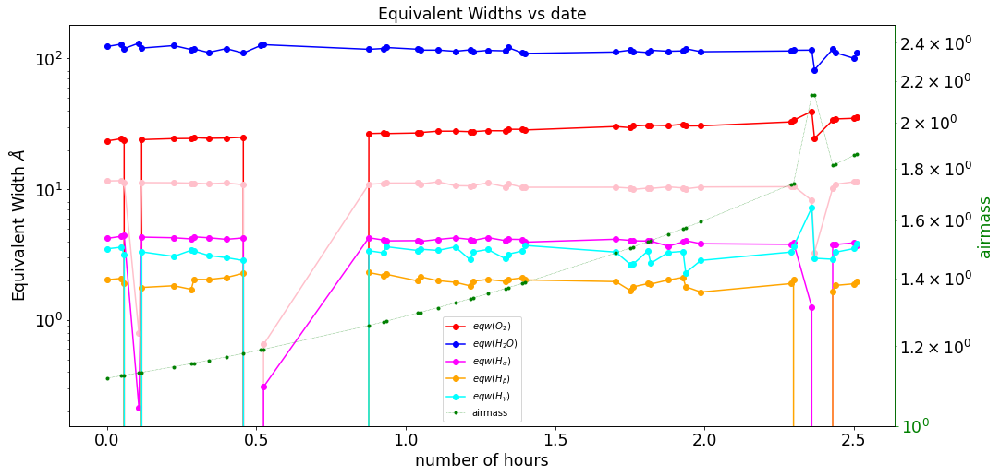

In [134]:
fig=plt.figure(figsize=(16,8))
#plt.xticks(rotation=90)
ax = fig.add_subplot(1, 1, 1)
p1, = ax.plot(df_infos['reftime'], df_infos['eqw_o2'],marker="o",color="red",label="$eqw(O_2)$");
p11, = ax.plot(df_infos['reftime'], df_infos['eqw_o2b'],marker="o",color="pink",label="$eqw(O_2b)$");
p2, = ax.plot(df_infos['reftime'], df_infos['eqw_h2o'],marker="o",color="blue",label="$eqw(H_2O)$");
p3, = ax.plot(df_infos['reftime'], df_infos['eqw_halpha'],marker="o",color="magenta",label="$eqw(H_{\\alpha})$");
p4, = ax.plot(df_infos['reftime'], df_infos['eqw_hbeta'],marker="o",color="orange",label="$eqw(H_{\\beta})$");
p5, = ax.plot(df_infos['reftime'], df_infos['eqw_hgamma'],marker="o",color="cyan",label="$eqw(H_{\\gamma})$");
#ax.set_xticks(rotation='vertical');
#ax.xaxis.set_tick_params(rotation=90)
ax.set_xlabel("number of hours")
ax.set_ylabel("Equivalent Width $\AA$")
ax.set_yscale('log')
ax2 = ax.twinx()
p6, = ax2.plot(df_infos['reftime'], df_infos['airmass'],linestyle='dotted', marker='.',color="green",label="airmass",lw=0.5)
ax2.set_ylim(1,2.5)

ax2.set_ylabel("airmass")
ax2.set_yscale('log')
ax.set_title("Equivalent Widths vs date")

curves = [p1, p2, p3, p4, p5, p6]
ax.legend(curves, [c.get_label() for c in curves])
ax2.yaxis.label.set_color(p6.get_color())
ax2.spines["right"].set_edgecolor(p6.get_color())
ax2.tick_params(axis='y', colors=p6.get_color())


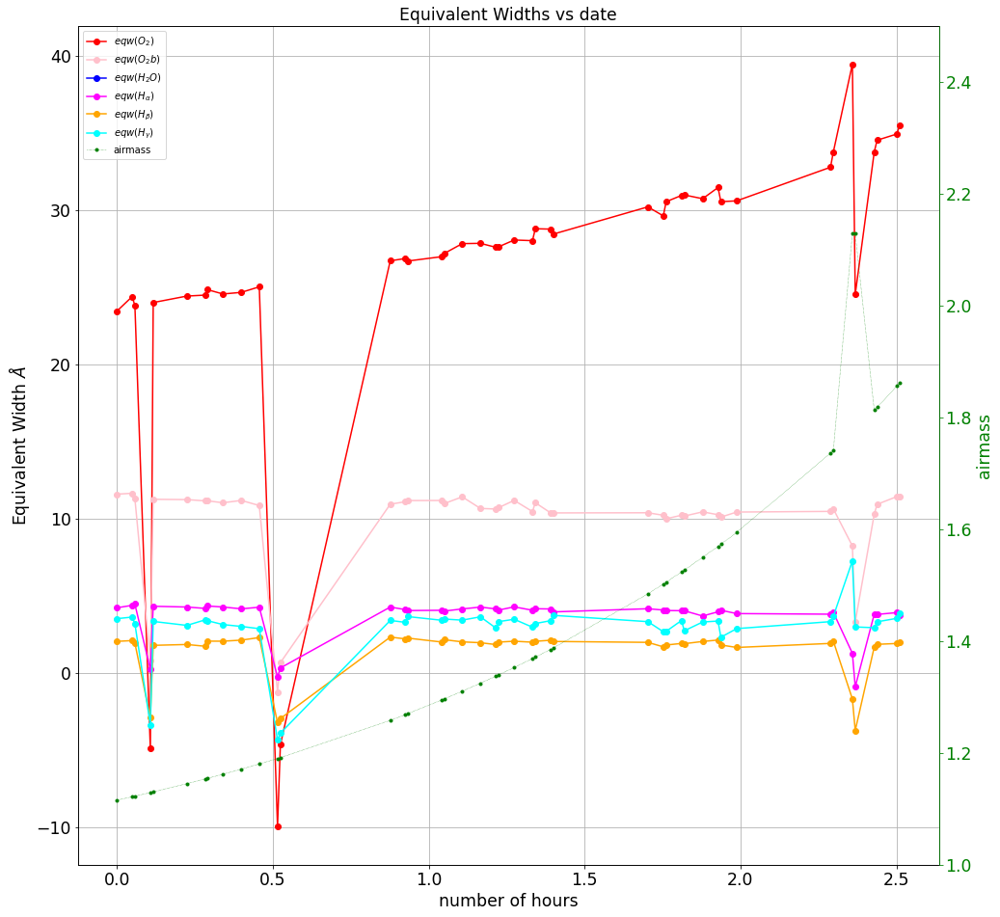

In [135]:
fig=plt.figure(figsize=(16,16))
#plt.xticks(rotation=90)
ax = fig.add_subplot(1, 1, 1)
p1, = ax.plot(df_infos['reftime'], df_infos['eqw_o2'],marker="o",color="red",label="$eqw(O_2)$");
p11, = ax.plot(df_infos['reftime'], df_infos['eqw_o2b'],marker="o",color="pink",label="$eqw(O_2b)$");
#p2, = ax.plot(df_infos['reftime'], df_infos['eqw_h2o'],marker="o",color="blue",label="$eqw(H_2O)$");
p3, = ax.plot(df_infos['reftime'], df_infos['eqw_halpha'],marker="o",color="magenta",label="$eqw(H_{\\alpha})$");
p4, = ax.plot(df_infos['reftime'], df_infos['eqw_hbeta'],marker="o",color="orange",label="$eqw(H_{\\beta})$");
p5, = ax.plot(df_infos['reftime'], df_infos['eqw_hgamma'],marker="o",color="cyan",label="$eqw(H_{\\gamma})$");
#ax.set_xticks(rotation='vertical');
#ax.xaxis.set_tick_params(rotation=90)
ax.set_xlabel("number of hours")
ax.grid()

ax.set_ylabel("Equivalent Width $\AA$")
ax2 = ax.twinx()
p6, = ax2.plot(df_infos['reftime'], df_infos['airmass'],linestyle='dotted', marker='.',color="green",label="airmass",lw=0.5)
ax2.set_ylim(1,2.5)

ax2.set_ylabel("airmass")
ax.set_title("Equivalent Widths vs date")

curves = [p1, p11,p2, p3, p4,p5,p6]
ax.legend(curves, [c.get_label() for c in curves])
ax2.yaxis.label.set_color(p6.get_color())
ax2.spines["right"].set_edgecolor(p6.get_color())
ax2.tick_params(axis='y', colors=p6.get_color())

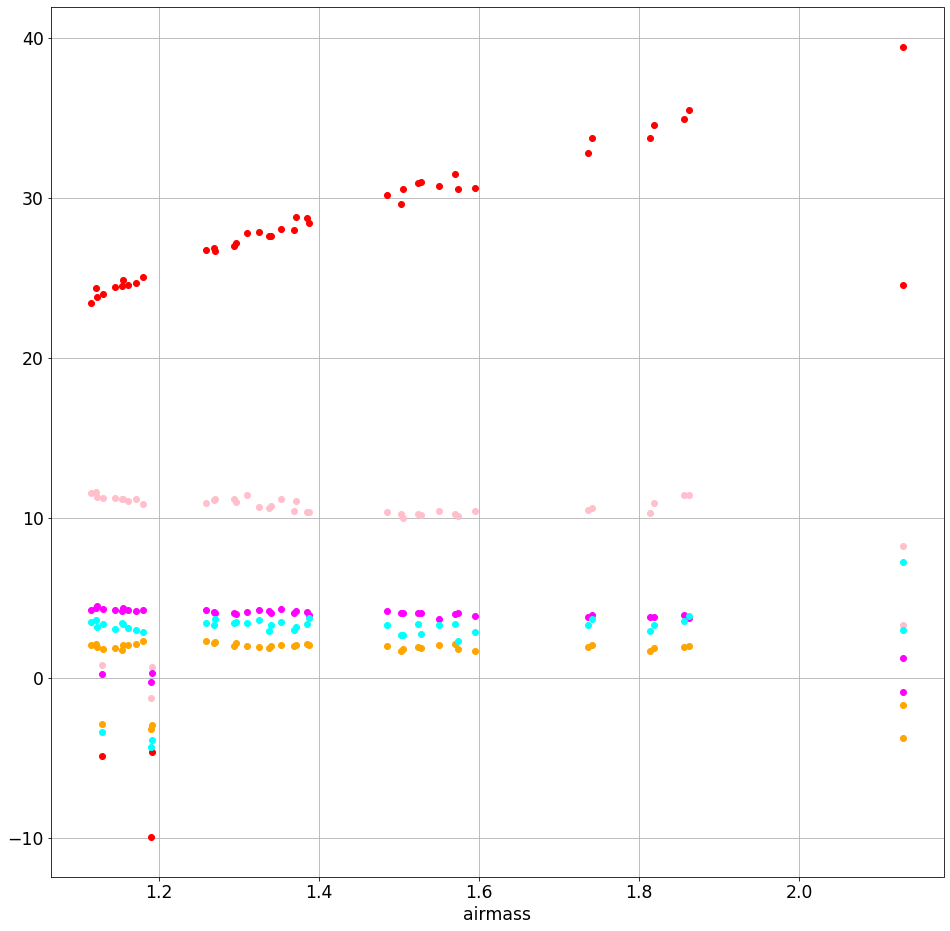

In [136]:
fig=plt.figure(figsize=(16,16))
#plt.xticks(rotation=90)
ax = fig.add_subplot(1, 1, 1)
p1, = ax.plot(df_infos['airmass'], df_infos['eqw_o2'],marker="o",color="red",lw=0,label="$eqw(O_2)$");
p11, = ax.plot(df_infos['airmass'], df_infos['eqw_o2b'],marker="o",color="pink",lw=0,label="$eqw(O_2b)$");
p3, = ax.plot(df_infos['airmass'], df_infos['eqw_halpha'],marker="o",color="magenta",lw=0,label="$eqw(H_{\\alpha})$");
p4, = ax.plot(df_infos['airmass'], df_infos['eqw_hbeta'],marker="o",color="orange",lw=0,label="$eqw(H_{\\beta})$");
p5, = ax.plot(df_infos['airmass'], df_infos['eqw_hgamma'],marker="o",color="cyan",lw=0,label="$eqw(H_{\\gamma})$");

ax.set_xlabel("airmass")
ax.grid()
